<a href="https://colab.research.google.com/github/msatkun/MSc_Project/blob/main/IP_Online_News_Popularity.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Individual Project (MSc) - Techniques for Compressing Pruned Feedforward Neural Networks: A Comparative Study

This file has the full code for the project.



## Importing Relevant Modules
Importing the relevant modules that are required for this notebook.

In [ ]:
#mount to google drive account
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
#import required modules
import os
import re
import copy
import time
import math
import torch
import json
import itertools

import numpy as np
import pandas as pd
from torch import nn
import seaborn as sns
from tqdm import tqdm


import torch.optim as optim
from torch.optim import Adam
from datetime import datetime
import matplotlib.pyplot as plt
import torch.nn.functional as F
import torch.nn.utils.prune as prune
from sklearn.model_selection import train_test_split
from torch.utils.data import TensorDataset, DataLoader, random_split
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import mean_absolute_error, mean_squared_error

from sklearn.decomposition import PCA
from sklearn.decomposition import FastICA
from sklearn.decomposition import SparsePCA
from sklearn.preprocessing import StandardScaler

## UC Irvine Machine Learning Repository Datasets

In this section, we are going to review/prepare the dataset for our dimensionality reduction task, and split it into training and testing sets.


The dataset was obtained from UC Irvine Machine Learning Repository:

*   Online News Popularity - https://archive.ics.uci.edu/dataset/332/online+news+popularity

### Review/Preprocessing of the Dataset
In this section, we are going to review and prepare the dataset for our analysis.

In [ ]:
#import csv file using pandas
#data_one = pd.read_csv('/content/gdrive/My Drive/Colab Notebooks/IP_MSC/UCI_code/datasets/OnlineNewsPopularity.csv', encoding='utf-8')
!wget "https://archive.ics.uci.edu/static/public/332/online+news+popularity.zip"
!unzip online+news+popularity.zip
!ls OnlineNewsPopularity
data_one = pd.read_csv('OnlineNewsPopularity/OnlineNewsPopularity.csv')

--2024-02-02 06:27:41--  https://archive.ics.uci.edu/static/public/332/online+news+popularity.zip
Resolving archive.ics.uci.edu (archive.ics.uci.edu)... 128.195.10.252
Connecting to archive.ics.uci.edu (archive.ics.uci.edu)|128.195.10.252|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified
Saving to: ‘online+news+popularity.zip’

online+news+popular     [     <=>            ]   7.13M  6.13MB/s    in 1.2s    

2024-02-02 06:27:43 (6.13 MB/s) - ‘online+news+popularity.zip’ saved [7476401]

Archive:  online+news+popularity.zip
   creating: OnlineNewsPopularity/
  inflating: OnlineNewsPopularity/OnlineNewsPopularity.names  
  inflating: OnlineNewsPopularity/OnlineNewsPopularity.csv  
OnlineNewsPopularity.csv  OnlineNewsPopularity.names


In [ ]:
# Displaying the first few rows of the DataFrame
data_one.head()

,url,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,http://mashable.com/2013/01/07/amazon-instant-...,731.0,12.0,219.0,0.663594,1.0,0.815385,4.0,2.0,1.0,...,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,http://mashable.com/2013/01/07/ap-samsung-spon...,731.0,9.0,255.0,0.604743,1.0,0.791946,3.0,1.0,1.0,...,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,http://mashable.com/2013/01/07/apple-40-billio...,731.0,9.0,211.0,0.575130,1.0,0.663866,3.0,1.0,1.0,...,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,http://mashable.com/2013/01/07/astronaut-notre...,731.0,9.0,531.0,0.503788,1.0,0.665635,9.0,0.0,1.0,...,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,http://mashable.com/2013/01/07/att-u-verse-apps/,731.0,13.0,1072.0,0.415646,1.0,0.540890,19.0,19.0,20.0,...,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505


In [ ]:
# Displaying the text representation of the DataFrame shape
print("Data_One Shape: ({} rows, {} columns)".format(data_one.shape[0],
                                                      data_one.shape[1]))

Data_One Shape: (39644 rows, 61 columns)


In [ ]:
# Display concise information about the Dataset
data_one.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39644 entries, 0 to 39643
Data columns (total 61 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   url                             39644 non-null  object 
 1    timedelta                      39644 non-null  float64
 2    n_tokens_title                 39644 non-null  float64
 3    n_tokens_content               39644 non-null  float64
 4    n_unique_tokens                39644 non-null  float64
 5    n_non_stop_words               39644 non-null  float64
 6    n_non_stop_unique_tokens       39644 non-null  float64
 7    num_hrefs                      39644 non-null  float64
 8    num_self_hrefs                 39644 non-null  float64
 9    num_imgs                       39644 non-null  float64
 10   num_videos                     39644 non-null  float64
 11   average_token_length           39644 non-null  float64
 12   num_keywords                   

Removing the leading spaces from the feature names as we can see output above that there are additional leading spaces in front of the feature names.

In [ ]:
# Checking and remoivng leading spaces from feature names
data_one.columns = data_one.columns.str.strip()

Here is a full list of feature attributes with details of this dataset:
1.   **url** -  URL of the article (non-predictive)
2.   **timedelta** - Days between the article publication and the dataset acquisition (non-predictive)
3.   **n_tokens_title** -  Number of words in the title
4.   **n_tokens_content** - Number of words in the content
5. **n_unique_tokens** - Rate of unique words in the content
6. **n_non_stop_words** - Rate of non-stop words in the content
7. **n_non_stop_unique_tokens** - Rate of unique non-stop words in the content
8. **num_hrefs** - Number of links
9. **num_self_hrefs** - Number of links to other articles published by Mashable
10. **num_imgs** - Number of images
11. **num_videos** - Number of videos
12. **average_token_length** - Average length of the words in the content
13. **num_keywords** - Number of keywords in the metadata
14. **data_channel_is_lifestyle** - Is data channel 'Lifestyle'?
15. **data_channel_is_entertainment** - Is data channel 'Entertainment'?
16. **data_channel_is_bus** - Is data channel 'Business'?
17. **data_channel_is_socmed** - Is data channel 'Social Media'?
18. **data_channel_is_tech** - Is data channel 'Tech'?
19. **data_channel_is_world** - Is data channel 'World'?
20. **kw_min_min** - Worst keyword (min. shares)
21. **kw_max_min** - Worst keyword (max. shares)
22. **kw_avg_min** - Worst keyword (avg. shares)
23. **kw_min_max** - Best keyword (min. shares)
24. **kw_max_max** - Best keyword (max. shares)
25. **kw_avg_max** - Best keyword (avg. shares)
26. **kw_min_avg** - Avg. keyword (min. shares)
27. **kw_max_avg** - Avg. keyword (max. shares)
28. **kw_avg_avg** - Avg. keyword (avg. shares)
29. **self_reference_min_shares** - Min. shares of referenced articles in Mashable
30. **self_reference_max_shares** - Max. shares of referenced articles in Mashable
31. **self_reference_avg_sharess** - Avg. shares of referenced articles in Mashable
32. **weekday_is_monday** - Was the article published on a Monday?
33. **weekday_is_tuesday** - Was the article published on a Tuesday?
34. **weekday_is_wednesday** - Was the article published on a Wednesday?
35. **weekday_is_thursday** - Was the article published on a Thursday?
36. **weekday_is_friday** - Was the article published on a Friday?
37. **weekday_is_saturday** - Was the article published on a Saturday?
38. **weekday_is_sunday** - Was the article published on a Sunday?
39. **is_weekend** - Was the article published on the weekend?
40. **LDA_00** - Closeness to LDA topic 0
41. **LDA_01** - Closeness to LDA topic 1
42. **LDA_02** - Closeness to LDA topic 2
43. **LDA_03** - Closeness to LDA topic 3
44. **LDA_04** - Closeness to LDA topic 4
45. **global_subjectivity** - Text subjectivity
46. **global_sentiment_polarity** - Text sentiment polarity
47. **global_rate_positive_words** - Rate of positive words in the content
48. **global_rate_negative_words** - Rate of negative words in the content
49. **rate_positive_words** - Rate of positive words among non-neutral tokens
50. **rate_negative_words** - Rate of negative words among non-neutral tokens
51. **avg_positive_polarity** - Avg. polarity of positive words
52. **min_positive_polarity** - Min. polarity of positive words
53. **max_positive_polarity** - Max. polarity of positive words
54. **avg_negative_polarity** - Avg. polarity of negative  words
55. **min_negative_polarity** - Min. polarity of negative  words
56. **max_negative_polarity** - Max. polarity of negative  words
57. **title_subjectivity** - Title subjectivity
58. **title_sentiment_polarity** - Title polarity
59. **abs_title_subjectivity** - Absolute subjectivity level
60. **abs_title_sentiment_polarity** - Absolute polarity level
61. **shares** - Number of shares (target)

Reference for obtaining feature attribute description:
https://archive.ics.uci.edu/dataset/332/online+news+popularity


In [ ]:
# Checking for missing values
missing_values = data_one.isnull().sum()

# Displaying the count of missing values for each column
print("Missing Values:\n", missing_values)

# Checking for duplicate rows
duplicate_rows = data_one.duplicated().sum()

# Displaying the count of duplicate rows
print("\nDuplicate Rows:", duplicate_rows)

Missing Values:
 url                             0
timedelta                       0
n_tokens_title                  0
n_tokens_content                0
n_unique_tokens                 0
                               ..
title_subjectivity              0
title_sentiment_polarity        0
abs_title_subjectivity          0
abs_title_sentiment_polarity    0
shares                          0
Length: 61, dtype: int64

Duplicate Rows: 0




*   No duplicate or missing values in this dataset

After reviewing the columns, it is ideal to drop the non-predictive attricbutes, which is in our case:
*   url
*   timedelta

The non-predictive attributes are listed here: https://archive.ics.uci.edu/dataset/332/online+news+popularity





In [ ]:
# Remove specified columns from the DataFrame
columns_to_drop = ['url', 'timedelta']
data_one.drop(columns=columns_to_drop, inplace=True)
data_one.head(n=4)

,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,12.0,219.0,0.663594,1.0,0.815385,4.0,2.0,1.0,0.0,4.680365,...,0.100000,0.7,-0.350000,-0.600,-0.200000,0.5,-0.1875,0.0,0.1875,593
1,9.0,255.0,0.604743,1.0,0.791946,3.0,1.0,1.0,0.0,4.913725,...,0.033333,0.7,-0.118750,-0.125,-0.100000,0.0,0.0000,0.5,0.0000,711
2,9.0,211.0,0.575130,1.0,0.663866,3.0,1.0,1.0,0.0,4.393365,...,0.100000,1.0,-0.466667,-0.800,-0.133333,0.0,0.0000,0.5,0.0000,1500
3,9.0,531.0,0.503788,1.0,0.665635,9.0,0.0,1.0,0.0,4.404896,...,0.136364,0.8,-0.369697,-0.600,-0.166667,0.0,0.0000,0.5,0.0000,1200


These are the binary columns in this dataset:
*   data_channel_is_lifestyle
*   data_channel_is_entertainment
*   data_channel_is_bus
*   data_channel_is_socmed
*   data_channel_is_tech
*   data_channel_is_world
*   weekday_is_monday
*   weekday_is_tuesday
*   weekday_is_wednesday
*   weekday_is_thursday
*   weekday_is_friday
*   weekday_is_saturday
*   weekday_is_sunday
*   is_weekend

We have changed the type from float to boolean, so it gives us a true or false output instead.

In [ ]:
# Identify binary columns
binary_columns = [col for col in data_one.columns if data_one[col].nunique() == 2]

# Display the binary columns
print("Binary Columns:")
print(binary_columns)

Binary Columns:
['data_channel_is_lifestyle', 'data_channel_is_entertainment', 'data_channel_is_bus', 'data_channel_is_socmed', 'data_channel_is_tech', 'data_channel_is_world', 'weekday_is_monday', 'weekday_is_tuesday', 'weekday_is_wednesday', 'weekday_is_thursday', 'weekday_is_friday', 'weekday_is_saturday', 'weekday_is_sunday', 'is_weekend']


In [ ]:
# Convert binary columns to boolean type
data_one[binary_columns] = data_one[binary_columns].astype(bool)

In [ ]:
# check if the changes have been applied in a random column
data_one['weekday_is_friday']

0        False
1        False
2        False
3        False
4        False
         ...  
39639    False
39640    False
39641    False
39642    False
39643    False
Name: weekday_is_friday, Length: 39644, dtype: bool

In [ ]:
# Display the first 4 rows of the modified DataFrame
data_one.head(n=4)

,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,12.0,219.0,0.663594,1.0,0.815385,4.0,2.0,1.0,0.0,4.680365,...,0.100000,0.7,-0.350000,-0.600,-0.200000,0.5,-0.1875,0.0,0.1875,593
1,9.0,255.0,0.604743,1.0,0.791946,3.0,1.0,1.0,0.0,4.913725,...,0.033333,0.7,-0.118750,-0.125,-0.100000,0.0,0.0000,0.5,0.0000,711
2,9.0,211.0,0.575130,1.0,0.663866,3.0,1.0,1.0,0.0,4.393365,...,0.100000,1.0,-0.466667,-0.800,-0.133333,0.0,0.0000,0.5,0.0000,1500
3,9.0,531.0,0.503788,1.0,0.665635,9.0,0.0,1.0,0.0,4.404896,...,0.136364,0.8,-0.369697,-0.600,-0.166667,0.0,0.0000,0.5,0.0000,1200


Reviewing the table above, you can see that the following features have discrete values:
*   n_tokens_title
*   n_tokens_content
*   num_hrefs
*   num_self_hrefs
*   num_imgs
*   num_videos
*   num_keywords

Instead of saving them as floats, we will convert them to an integer.

In [ ]:
# list of feature attributes that have discrete values
integer_features = ['n_tokens_title', 'n_tokens_content', 'num_hrefs',
                    'num_self_hrefs', 'num_imgs', 'num_videos', 'num_keywords']

# changing these features into integer values
data_one[integer_features] = data_one[integer_features].astype('int64')

In [ ]:
# checking the columns after amendents made
print(data_one.dtypes)

n_tokens_title                     int64
n_tokens_content                   int64
n_unique_tokens                  float64
n_non_stop_words                 float64
n_non_stop_unique_tokens         float64
num_hrefs                          int64
num_self_hrefs                     int64
num_imgs                           int64
num_videos                         int64
average_token_length             float64
num_keywords                       int64
data_channel_is_lifestyle           bool
data_channel_is_entertainment       bool
data_channel_is_bus                 bool
data_channel_is_socmed              bool
data_channel_is_tech                bool
data_channel_is_world               bool
kw_min_min                       float64
kw_max_min                       float64
kw_avg_min                       float64
kw_min_max                       float64
kw_max_max                       float64
kw_avg_max                       float64
kw_min_avg                       float64
kw_max_avg      

After we have made the changes for the feature types, and removed the two non-predictive columns. Let's look at the descriptive statistical measure for this dataset.

In [ ]:
# Displaying descriptive statistics of the DataFrame
data_one.describe()

,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
count,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,...,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000
mean,10.398749,546.514731,0.548216,0.996469,0.689175,10.883690,3.293638,4.544143,1.249874,4.548239,...,0.095446,0.756728,-0.259524,-0.521944,-0.107500,0.282353,0.071425,0.341843,0.156064,3395.380184
std,2.114037,471.107508,3.520708,5.231231,3.264816,11.332017,3.855141,8.309434,4.107855,0.844406,...,0.071315,0.247786,0.127726,0.290290,0.095373,0.324247,0.265450,0.188791,0.226294,11626.950749
min,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,-1.000000,-1.000000,-1.000000,0.000000,-1.000000,0.000000,0.000000,1.000000
25%,9.000000,246.000000,0.470870,1.000000,0.625739,4.000000,1.000000,1.000000,0.000000,4.478404,...,0.050000,0.600000,-0.328383,-0.700000,-0.125000,0.000000,0.000000,0.166667,0.000000,946.000000
50%,10.000000,409.000000,0.539226,1.000000,0.690476,8.000000,3.000000,1.000000,0.000000,4.664082,...,0.100000,0.800000,-0.253333,-0.500000,-0.100000,0.150000,0.000000,0.500000,0.000000,1400.000000
75%,12.000000,716.000000,0.608696,1.000000,0.754630,14.000000,4.000000,4.000000,1.000000,4.854839,...,0.100000,1.000000,-0.186905,-0.300000,-0.050000,0.500000,0.150000,0.500000,0.250000,2800.000000
max,23.000000,8474.000000,701.000000,1042.000000,650.000000,304.000000,116.000000,128.000000,91.000000,8.041534,...,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.500000,1.000000,843300.000000


In [ ]:
# Current DataFrame shape
print("Data_One Shape: ({} rows, {} columns)".format(data_one.shape[0],
                                                      data_one.shape[1]))

Data_One Shape: (39644 rows, 59 columns)


**'n_tokens_content'** represents the number of words in the news articles and some some articles have inputs with a minimum value of 0 indicate articles with no content which add no meaning for sharing activity of the article. So we are going to remove them.

In [ ]:
# Identify rows where 'n_tokens_content' is 0
no_words_indices = data_one[data_one['n_tokens_content'] == 0].index

# Print the number of news items with no words
print('Number of News Articles with no words:', no_words_indices.size)

# Drop rows where 'n_tokens_content' is 0
data_one = data_one[data_one['n_tokens_content'] != 0]

Number of News Articles with no words: 1181


In [ ]:
# Current DataFrame shape
print("Data_One Shape: ({} rows, {} columns)".format(data_one.shape[0],
                                                      data_one.shape[1]))

Data_One Shape: (38463 rows, 59 columns)


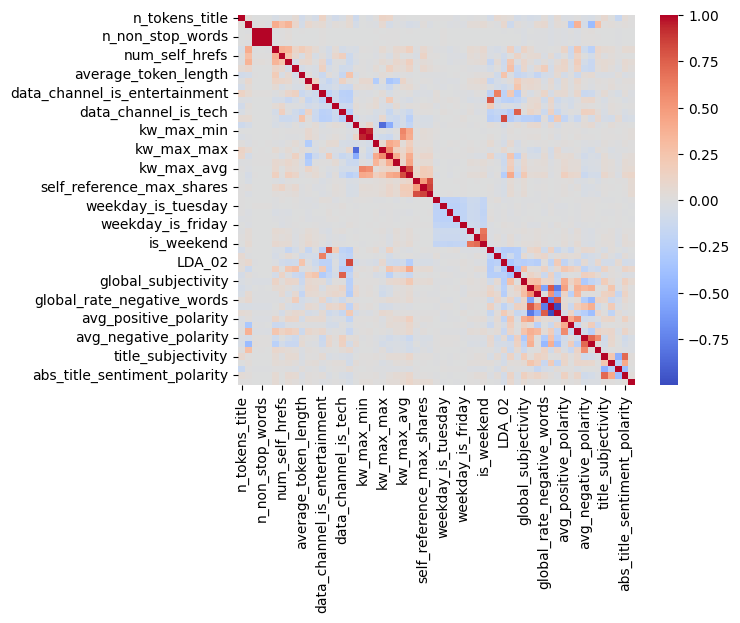

In [ ]:
# Calculate the correlation matrix
correlation_matrix = data_one.corr()

# Create a heatmap using seaborn to visualize the correlation matrix
sns.heatmap(correlation_matrix, cmap="coolwarm")

# Display the heatmap
plt.show()

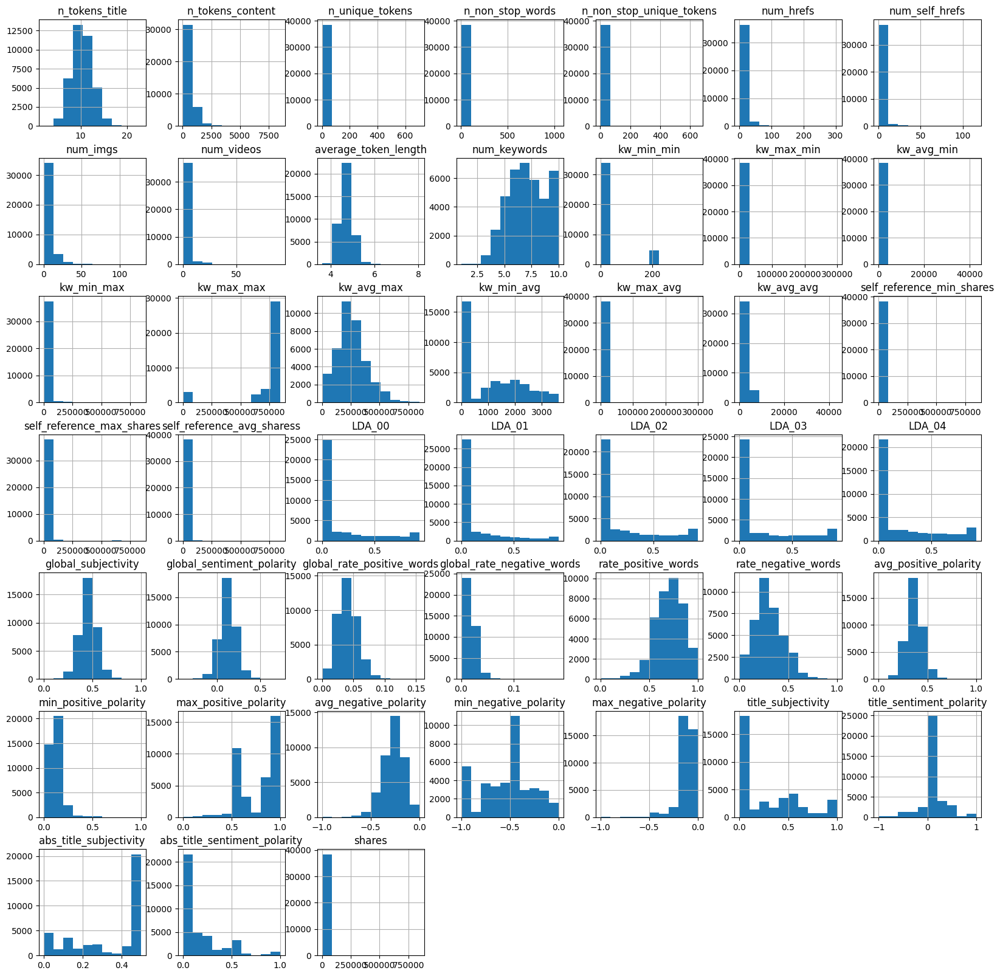

In [ ]:
# Displaying histograms for each numerical column in the DataFrame
data_one.hist(figsize=(20, 20))
plt.show()

**Target Value Distribution**


The target variable of this dataset is the 'shares' column, which is the number of shares.

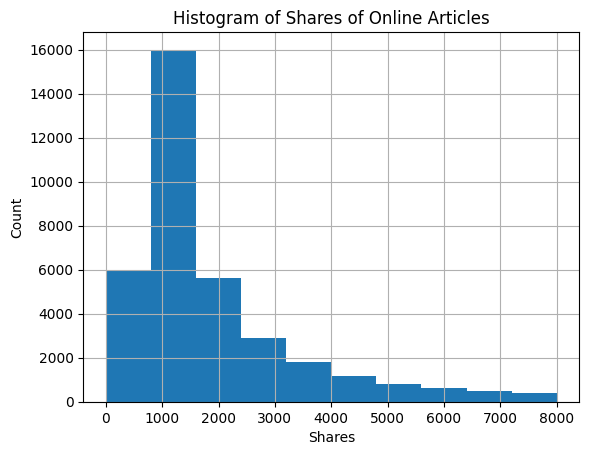

In [ ]:
plt.clf()

# Set the random seed for reproducibility
np.random.seed(1)

# Set the plotting style
plt.style.use('default')

# Create a subplot within the figure
plt.subplot()

# Plot a histogram for the 'shares' column
data_one['shares'].hist(bins=10, range=(1, 8000))

# Set the title and axis labels for the plot
plt.title('Histogram of Shares of Online Articles')
plt.xlabel('Shares')
plt.ylabel('Count')

plt.show()

In [ ]:
# output target variable distribution
data_one['shares'].describe()

count     38463.000000
mean       3355.360398
std       11585.968776
min           1.000000
25%         945.000000
50%        1400.000000
75%        2700.000000
max      843300.000000
Name: shares, dtype: float64

To determine if an article is popular, we look at how many times it has been shared online. Using the median number of shares in the dataset as a benchmark.

If an article has been shared 1400 or more times, it is considered popular.

If an article has been shared less than 1400 times, it is considered less popular.

We will create a new column, popularity, to determine the popularity of the article based on the number of shares, and then we can do that throughout the week.

Text(0.5, 0.98, 'Number of Words in Title against Content')

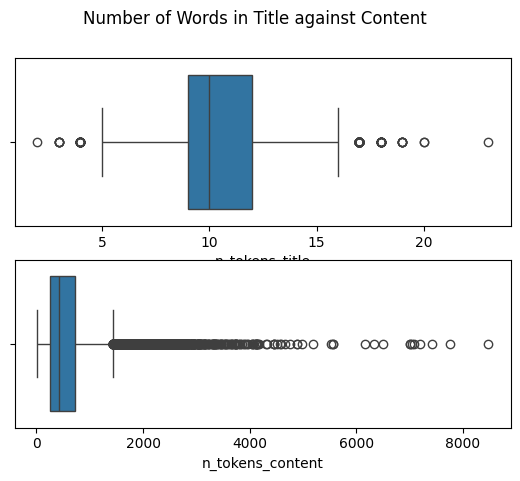

In [ ]:
# checking the numbers of words in the title and content of the article
# Create a figure with two subplots
fig, axs = plt.subplots(2)

# Plot a boxplot for 'n_tokens_title' in the first subplot
sns.boxplot(data=data_one, x='n_tokens_title', ax=axs[0])

# Plot a boxplot for 'n_tokens_content' in the second subplot
sns.boxplot(data=data_one, x='n_tokens_content', ax=axs[1])

# title
fig.suptitle('Number of Words in Title against Content')

#### Identifying and Removing Outliers

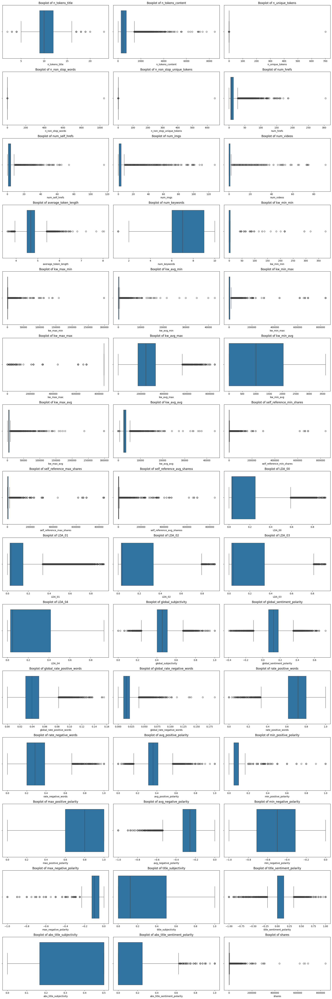

In [ ]:
# Get numerical columns within the dataset
num_cols = data_one.select_dtypes(['int64', 'float64']).columns

# Calculate the number of rows and columns for the grid
num_plots = len(num_cols)
num_rows = math.ceil(num_plots / 3)
num_cols_subplot = min(num_plots, 3)

# Set up the grid for boxplots
fig, axs = plt.subplots(num_rows, num_cols_subplot, figsize=(20, num_rows * 4))

# Flattening the grid
axs = axs.flatten()

# Plot boxplots in the grid
for i, column in enumerate(num_cols):
    sns.boxplot(x=data_one[column], ax=axs[i])
    axs[i].set_title(f'Boxplot of {column}')

# Hide empty subplots
for i in range(num_plots, len(axs)):
    axs[i].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
# Identify and print outliers for each numerical column
for column in num_cols:
    q1 = data_one[column].quantile(0.25)  # First Quartile
    q3 = data_one[column].quantile(0.75)  # Third Quartile
    IQR = q3 - q1  # Interquartile Range

    llimit = q1 - 1.5 * IQR  # Lower Limit
    ulimit = q3 + 1.5 * IQR  # Upper Limit

    # Identify outliers
    outliers = data_one[(data_one[column] < llimit) | (data_one[column] > ulimit)]

    # Print information about outliers
    print(f'Column: {column}')
    print(f'Number of outliers in "{column}": {len(outliers)}')
    print(f'Lower Limit: {llimit}')
    print(f'Upper Limit: {ulimit}')
    print(f'Interquartile Range (IQR): {IQR}')
    print('-' * 30)  # Separator

Column: n_tokens_title
Number of outliers in "n_tokens_title": 155
Lower Limit: 4.5
Upper Limit: 16.5
Interquartile Range (IQR): 3.0
------------------------------
Column: n_tokens_content
Number of outliers in "n_tokens_content": 1875
Lower Limit: -446.0
Upper Limit: 1434.0
Interquartile Range (IQR): 470.0
------------------------------
Column: n_unique_tokens
Number of outliers in "n_unique_tokens": 490
Lower Limit: 0.27688172230725006
Upper Limit: 0.8116487408852499
Interquartile Range (IQR): 0.13369175464449995
------------------------------
Column: n_non_stop_words
Number of outliers in "n_non_stop_words": 1889
Lower Limit: 0.999999987641
Upper Limit: 1.000000003721
Interquartile Range (IQR): 4.019999999549384e-09
------------------------------
Column: n_non_stop_unique_tokens
Number of outliers in "n_non_stop_unique_tokens": 657
Lower Limit: 0.4460529840195001
Upper Limit: 0.9434793143915
Interquartile Range (IQR): 0.12435658259299998
------------------------------
Column: num_hr

In [ ]:
# Createing a copy of the original dataset
data_one_no_outliers = data_one.copy()

# Identify and remove outliers for each numerical column
for column in num_cols:
    q1 = data_one[column].quantile(0.25)  # First Quartile
    q3 = data_one[column].quantile(0.75)  # Third Quartile
    IQR = q3 - q1  # Interquartile Range

    llimit = q1 - 1.5 * IQR  # Lower Limit
    ulimit = q3 + 1.5 * IQR  # Upper Limit

    # Remove outliers and update the copy
    data_one_no_outliers = data_one_no_outliers[
        (data_one_no_outliers[column] >= llimit) & (data_one_no_outliers[column] <= ulimit)
    ]

# Display the shape of the original and outlier-removed datasets
print("Original Dataset Shape:", data_one.shape)
print("Outlier-Removed Dataset Shape:", data_one_no_outliers.shape)

Original Dataset Shape: (38463, 59)
Outlier-Removed Dataset Shape: (4088, 59)


In [ ]:
# Current DataFrame shape after removing outliers
print("Data_One Shape after Removing Outliers: ({} rows, {} columns)".format(data_one_no_outliers.shape[0],
                                                                             data_one_no_outliers.shape[1]))

Data_One Shape after Removing Outliers: (4088 rows, 59 columns)


In [ ]:
data_one_no_outliers.describe()

,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
count,4088.00000,4088.000000,4088.000000,4.088000e+03,4088.000000,4088.000000,4088.000000,4088.000000,4088.000000,4088.000000,...,4088.000000,4088.000000,4088.000000,4088.000000,4088.000000,4088.000000,4088.000000,4088.000000,4088.000000,4088.000000
mean,10.52226,512.815313,0.537875,1.000000e+00,0.699947,8.155088,2.784002,1.573875,0.343689,4.707787,...,0.085298,0.741627,-0.235551,-0.498531,-0.091342,0.165572,0.029503,0.375245,0.052441,1516.055039
std,2.10351,275.286145,0.073820,2.242380e-09,0.073822,4.589796,2.059922,1.472668,0.581948,0.249998,...,0.034250,0.197754,0.090981,0.264373,0.043582,0.246510,0.095185,0.178308,0.084735,938.443302
min,5.00000,126.000000,0.330732,1.000000e+00,0.463889,0.000000,0.000000,0.000000,0.000000,3.950617,...,0.033333,0.200000,-0.531944,-1.000000,-0.230769,0.000000,-0.200000,0.000000,0.000000,22.000000
25%,9.00000,303.000000,0.486213,1.000000e+00,0.649527,5.000000,1.000000,1.000000,0.000000,4.537742,...,0.050000,0.600000,-0.291667,-0.700000,-0.125000,0.000000,0.000000,0.211111,0.000000,878.000000
50%,11.00000,436.000000,0.537680,1.000000e+00,0.699004,7.000000,3.000000,1.000000,0.000000,4.719131,...,0.100000,0.750000,-0.231250,-0.500000,-0.100000,0.000000,0.000000,0.500000,0.000000,1200.000000
75%,12.00000,660.000000,0.588004,1.000000e+00,0.751515,10.000000,4.000000,2.000000,1.000000,4.886519,...,0.100000,1.000000,-0.177488,-0.300000,-0.050000,0.333333,0.000000,0.500000,0.100000,1800.000000
max,16.00000,1433.000000,0.804348,1.000000e+00,0.941176,27.000000,8.000000,8.000000,2.000000,5.401587,...,0.166667,1.000000,0.000000,0.000000,0.000000,1.000000,0.337500,0.500000,0.337500,5300.000000


### Splitting into Training and Testing Set

**Dataset One with Outliers**

This is the original dataset including the outliers.

In [ ]:
# features are stored in X and the target ('shares') is stored in y
X0 = data_one.drop('shares', axis=1)  # Features
y0 = data_one['shares']  # Target variable

# Split the dataset into training and testing sets
X0_train, X0_test, y0_train, y0_test = train_test_split(X0, y0, test_size=0.2,
                                                        random_state=42)

# Print the shapes of the resulting sets
print("X0_train shape:", X0_train.shape)
print("X0_test shape:", X0_test.shape)
print("y0_train shape:", y0_train.shape)
print("y0_test shape:", y0_test.shape)

X0_train shape: (30770, 58)
X0_test shape: (7693, 58)
y0_train shape: (30770,)
y0_test shape: (7693,)


**Dataset_One without Outliers**

This is the original dataset excluding the outliers.

In [ ]:
# features are stored in X and the target ('shares') is stored in y
X = data_one_no_outliers.drop('shares', axis=1)  # Features
y = data_one_no_outliers['shares']  # Target variable

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=0.2,
                                                    random_state=42)

# Print the shapes of the resulting sets
print("X_train shape:", X_train.shape)
print("X_test shape:", X_test.shape)
print("y_train shape:", y_train.shape)
print("y_test shape:", y_test.shape)

X_train shape: (3270, 58)
X_test shape: (818, 58)
y_train shape: (3270,)
y_test shape: (818,)


## Feedforward Neural Network for Regression

Below we have defined the feedforward neural network

In [ ]:
class RegressionNN(nn.Module):
    def __init__(self, input_size, hidden_size1, hidden_size2, output_size):
        super(RegressionNN, self).__init__()

        # Define fully connected layers with ReLU activations
        self.fc1 = nn.Linear(input_size, hidden_size1)
        self.fc2 = nn.Linear(hidden_size1, hidden_size2)
        self.fc3 = nn.Linear(hidden_size2, output_size)

        # Initialize the weights using Xavier initialization
        self.init_weights()

    def init_weights(self):
        # Xavier initialization for each layer
        for layer in [self.fc1, self.fc2, self.fc3]:
            nn.init.xavier_normal_(layer.weight)

    def forward(self, x):
        # Forward pass through the network
        x = F.relu(self.fc1(x))
        #x = self.dropout(x)
        x = F.relu(self.fc2(x))
        #x = self.dropout(x)
        x = self.fc3(x)
        return x

# reference used: https://www.geeksforgeeks.org/select-the-right-weight-for-deep-neural-network-in-pytorch/
# https://pytorch.org/docs/stable/nn.init.html
# https://machinelearningmastery.com/choose-an-activation-function-for-deep-learning/#:~:text=If%20your%20problem%20is%20a,%3A%20One%20node%2C%20linear%20activation.
# https://medium.com/@gidim/part-2-selecting-the-right-weight-initialization-for-your-deep-neural-network-cc27cf2d5e56

**Moving the model to the specified device (GPU or CPU)**


In [ ]:
torch.cuda.is_available()
# ref: https://stackoverflow.com/questions/50560395/how-to-install-cuda-in-google-colab-gpus
# Output would be True if Pytorch is using GPU otherwise it would be False.

# defining training device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cpu


### Scaling the features

Before we train the RegressionNN network that we have defined above, we need to double check the types of our training and testing sets. So we can convert and scale them appropriately for our regression task.

In [ ]:
# Checking the type of training and testing set
print("Types for Dataset with outliers")
print(type(y0_test))
print(type(y0_train))
print(type(X0_train))
print(type(X0_test))
print()
print("Types for Dataset without outliers")
print(type(y_test))
print(type(y_train))
print(type(X_train))
print(type(X_test))

Types for Dataset with outliers
<class 'pandas.core.series.Series'>
<class 'pandas.core.series.Series'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>

Types for Dataset without outliers
<class 'pandas.core.series.Series'>
<class 'pandas.core.series.Series'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>


In [ ]:
def preprocess_data(X_train, X_test, y_train, y_test, batch_size=64, device='cpu'):
    # Step 1: Scale features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # Step 2: Converting to PyTorch tensors
    X_train_tensor = torch.FloatTensor(X_train_scaled).to(device)
    X_test_tensor = torch.FloatTensor(X_test_scaled).to(device)
    y_train_tensor = torch.FloatTensor(y_train.values).view(-1, 1).to(device)
    y_test_tensor = torch.FloatTensor(y_test.values).view(-1, 1).to(device)

    # Step 3: Createing DataLoader for training data
    train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

    # Step 4: Creating DataLoader for testing data
    test_dataset = TensorDataset(X_test_tensor, y_test_tensor)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

    return train_loader, test_loader

In [ ]:
# Using the preprocess_data function on the dataset with outliers
train_loader0, test_loader0 = preprocess_data(X0_train, X0_test,y0_train, y0_test,
                                              batch_size=64,
                                              device='cuda' if torch.cuda.is_available() else 'cpu')

# Print the shapes of tensors
for batch in train_loader0:
    X0_batch, y0_batch = batch
    print("X0_batch shape:", X0_batch.shape)
    print("y0_batch shape:", y0_batch.shape)
    break

X0_batch shape: torch.Size([64, 58])
y0_batch shape: torch.Size([64, 1])


In [ ]:
# Using the preprocess_data function on the dataset without outliers
train_loader, test_loader = preprocess_data(X_train, X_test, y_train, y_test,
                                            batch_size=64,
                                            device='cuda' if torch.cuda.is_available() else 'cpu')

# Print the shapes of tensors
for batch in train_loader:
    X_batch, y_batch = batch
    print("X_batch shape:", X_batch.shape)
    print("y_batch shape:", y_batch.shape)
    break

X_batch shape: torch.Size([64, 58])
y_batch shape: torch.Size([64, 1])


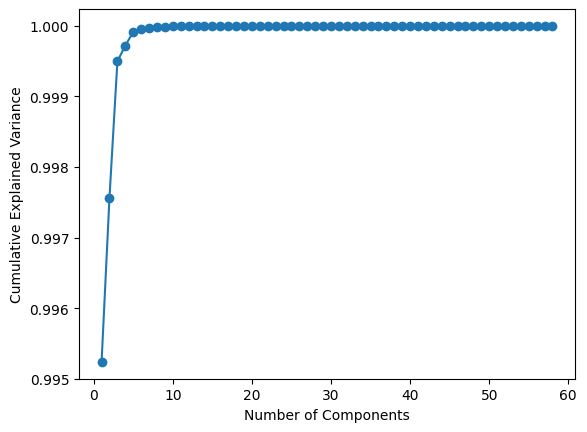

In [ ]:
# PCA on the dataset without outliers
pca = PCA()
pca.fit(X_train)
cumulative_variance = np.cumsum(pca.explained_variance_ratio_)
num_components = np.argmax(cumulative_variance >= 0.95) + 1  # 95% threshold

plt.plot(range(1, len(pca.explained_variance_ratio_) + 1),
         cumulative_variance, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.show()

## Training and Testing of the Feedford Neural Network

Before we train the RegressionNN network that we have defined above, we need to double check the types of our training and testing sets. So we can convert them appropriately for our regression task.

In [ ]:
# reference: https://discuss.pytorch.org/t/output-evaluation-loss-after-every-n-batches-instead-of-epochs-with-pytorch/116619
def OG_train_and_validate(train_loader, test_loader, input_size, hidden_size1, hidden_size2,
                       output_size, learning_rate, epochs):
    # Creating an object of the RegressionNN class
    regression_net = RegressionNN(input_size, hidden_size1,
                                  hidden_size2, output_size)

    # Move the model to CUDA if available
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    regression_net = regression_net.to(device)

    # Defining Mean Squared Error loss function
    criterion = nn.MSELoss()

    # Defining the Adam optimizer
    optimizer = torch.optim.Adam(regression_net.parameters(), lr=learning_rate)

    # List to store training and validation losses
    training_losses = []
    validation_losses = []

    # Training loop
    for epoch in range(epochs):
        # Set the model to training mode
        regression_net.train()

        # Initializing total loss and total MAE
        total_loss = 0.0
        total_mae = 0.0

        # List to store all outputs during training
        all_outputs = []

        # Iterating over training data in batches
        for batch in train_loader:
            inputs = batch[0].to(device)
            targets = batch[1].squeeze().to(device)

            # Forward pass
            outputs = regression_net(inputs)

            # Calculating the MSE loss
            mse_loss = criterion(outputs.view(-1), targets.view(-1))

            # Calculating the MAE loss
            mae_loss = nn.L1Loss()(outputs.view(-1), targets.view(-1))

            # Backward and optimize
            optimizer.zero_grad()
            mse_loss.backward()

            # Store outputs for later printing
            all_outputs.extend(outputs.view(-1).tolist())

            # Gradient Clipping
            # reference used: https://stackoverflow.com/questions/54716377/how-to-do-gradient-clipping-in-pytorch
            torch.nn.utils.clip_grad_norm_(regression_net.parameters(),
                                           max_norm=1.0)

            optimizer.step()

            # Update total loss
            total_loss += mse_loss.item()

            # Update total MAE
            total_mae += mae_loss.item()

        # Calculating average loss and MAE for the epoch
        average_loss = total_loss / len(train_loader)
        average_mae = total_mae / len(train_loader)

        # Storing training loss
        training_losses.append(average_loss)

        # Printing the metrics for each epoch
        print(f'Epoch [{epoch + 1}/{epochs}], MSE Loss (Train): {average_loss:.3f}, MAE Loss (Train): {average_mae:.3f}')

        # Validation
        regression_net.eval()
        with torch.no_grad():
            validation_loss, validation_mae = 0.0, 0.0

            # Iterate over validation data in batches
            for batch in test_loader:
                val_inputs = batch[0].to(device)
                val_targets = batch[1].squeeze().to(device)

                val_outputs = regression_net(val_inputs)
                validation_loss += criterion(val_outputs.view(-1),
                                             val_targets.view(-1)).item()
                validation_mae += nn.L1Loss()(val_outputs.view(-1),
                                              val_targets.view(-1)).item()

            # Calculate average validation loss and MAE
            average_validation_loss = validation_loss / len(test_loader)
            average_validation_mae = validation_mae / len(test_loader)

            # Store validation loss for later plotting
            validation_losses.append(average_validation_loss)

            # Print the validation metrics
            print(f'Validation Loss: {average_validation_loss:.3f}, Validation MAE: {average_validation_mae:.3f}')

    # Plotting
    epochs_range = range(1, epochs + 1)
    plt.plot(epochs_range, training_losses, label='Training Loss')
    plt.plot(epochs_range, validation_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

    return regression_net, training_losses, validation_losses

References used for the training and testing loop above:

https://discuss.pytorch.org/t/output-evaluation-loss-after-every-n-batches-instead-of-epochs-with-pytorch/116619

In [ ]:
# function to do grid search
# rerence: https://towardsdatascience.com/how-to-write-your-grid-search-function-in-python-43ad0da97522
def grid_search(train_loader, test_loader, input_size, output_size,
                learning_rates, batch_sizes, hidden_sizes1, hidden_sizes2, epochs):

    # Initialize variables to store the best model, its loss, and information
    best_model = None
    best_loss = float('inf')
    best_model_info = {}

    # Iterate over hyperparameter combinations
    for lr in learning_rates:
        for batch_size in batch_sizes:
            for hidden_size1 in hidden_sizes1:
                for hidden_size2 in hidden_sizes2:
                    print(f"\nTraining for lr={lr}, batch_size={batch_size}, hidden_size1={hidden_size1}, hidden_size2={hidden_size2}")

                    # Create and train the model
                    model, training_losses, validation_losses = OG_train_and_validate(
                        train_loader, test_loader, input_size,
                        hidden_size1, hidden_size2, output_size,
                        learning_rate=lr, epochs=epochs
                    )

                    # Checking if the current model has the lowest validation loss
                    if validation_losses[-1] < best_loss:
                        best_loss = validation_losses[-1]
                        best_model = model

                        # Save the best model's state_dict to a file
                        torch.save(best_model.state_dict(), 'best_model.pth')

                        # Save the hyperparameters of the best model
                        best_model_info = {
                            'input_size': input_size,
                            'hidden_size1': hidden_size1,
                            'hidden_size2': hidden_size2,
                            'output_size': output_size,
                            'learning_rate': lr,
                            'epochs': epochs,
                            'batch_size': batch_size
                        }

    # Displaying information about the best model
    print("\nBest Model Information:")
    print(f"Input Size: {best_model_info['input_size']}")
    print(f"Hidden Size 1: {best_model_info['hidden_size1']}")
    print(f"Hidden Size 2: {best_model_info['hidden_size2']}")
    print(f"Output Size: {best_model_info['output_size']}")
    print(f"Learning Rate: {best_model_info['learning_rate']}")
    print(f"Epochs: {best_model_info['epochs']}")
    print(f"Batch Size: {best_model_info['batch_size']}")
    print(f"Best Validation Loss: {best_loss:.3f}")

    # Return the best model and its information as a directory
    return  {'best_model': best_model, 'best_model_info': best_model_info}

#### Dataset One with Outliers

Epoch [1/200], MSE Loss (Train): 140061237.107, MAE Loss (Train): 3031.471
Validation Loss: 145271714.663, Validation MAE: 2494.309
Epoch [2/200], MSE Loss (Train): 130861681.396, MAE Loss (Train): 2653.817
Validation Loss: 141991301.702, Validation MAE: 2681.544
Epoch [3/200], MSE Loss (Train): 129751547.418, MAE Loss (Train): 2775.896
Validation Loss: 141715232.448, Validation MAE: 2719.792
Epoch [4/200], MSE Loss (Train): 129598328.355, MAE Loss (Train): 2780.779
Validation Loss: 141503731.401, Validation MAE: 2751.387
Epoch [5/200], MSE Loss (Train): 129418187.223, MAE Loss (Train): 2804.894
Validation Loss: 141389663.461, Validation MAE: 2737.772
Epoch [6/200], MSE Loss (Train): 129280832.078, MAE Loss (Train): 2798.551
Validation Loss: 141256458.769, Validation MAE: 2771.279
Epoch [7/200], MSE Loss (Train): 129266653.354, MAE Loss (Train): 2790.370
Validation Loss: 141253273.194, Validation MAE: 2726.039
Epoch [8/200], MSE Loss (Train): 129182780.849, MAE Loss (Train): 2775.762
V

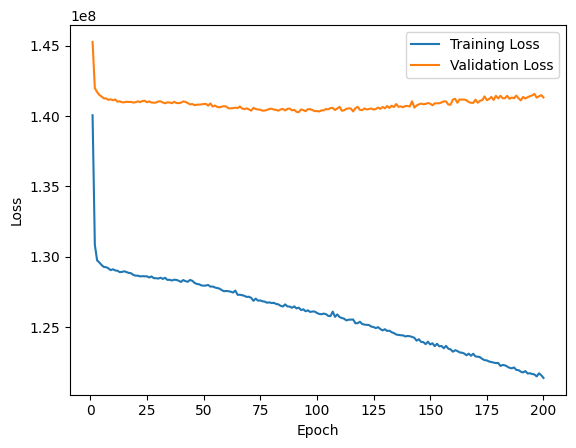

In [ ]:
# Set your input sizes
input_size = X0_train.shape[1]  # Number of input features
hidden_size1 = 128
hidden_size2 = 64
output_size = 1  # For regression
epochs = 200
batch_size = 64
learning_rate = 0.001

# Call train_and_validate function for the dataset with outliers
trained_model0, training_losses0, validation_losses0 = OG_train_and_validate(
    train_loader0, test_loader0, input_size, hidden_size1, hidden_size2,
    output_size,learning_rate=learning_rate, epochs=epochs
    )

#### Dataset One without Outliers

Epoch [1/200], MSE Loss (Train): 3182703.704, MAE Loss (Train): 1515.868
Validation Loss: 3086475.500, Validation MAE: 1483.998
Epoch [2/200], MSE Loss (Train): 3067054.377, MAE Loss (Train): 1481.711
Validation Loss: 2969004.865, Validation MAE: 1445.330
Epoch [3/200], MSE Loss (Train): 2930560.332, MAE Loss (Train): 1433.633
Validation Loss: 2759771.558, Validation MAE: 1374.594
Epoch [4/200], MSE Loss (Train): 2635672.183, MAE Loss (Train): 1335.955
Validation Loss: 2447151.269, Validation MAE: 1261.355
Epoch [5/200], MSE Loss (Train): 2313337.394, MAE Loss (Train): 1203.652
Validation Loss: 2045051.731, Validation MAE: 1098.187
Epoch [6/200], MSE Loss (Train): 1823485.753, MAE Loss (Train): 1006.084
Validation Loss: 1601586.221, Validation MAE: 899.471
Epoch [7/200], MSE Loss (Train): 1400132.448, MAE Loss (Train): 826.439
Validation Loss: 1208816.582, Validation MAE: 736.743
Epoch [8/200], MSE Loss (Train): 1078032.076, MAE Loss (Train): 712.826
Validation Loss: 983155.389, Valida

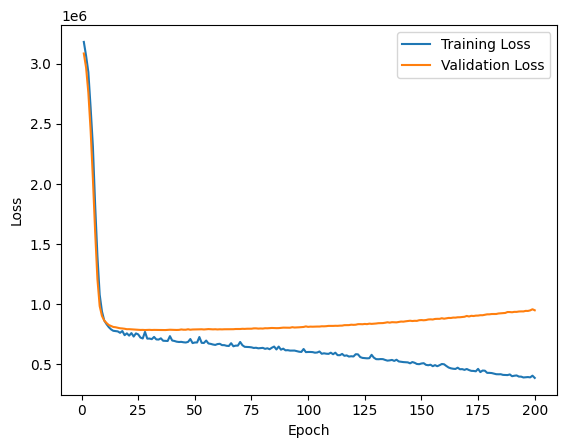

In [ ]:
# Set your input sizes
input_size = X_train.shape[1]  # Number of input features
hidden_size1 = 128
hidden_size2 = 64
output_size = 1  # For regression
epochs = 200
batch_size = 64
learning_rate = 0.001

# Call train_and_validate function for the dataset wihtout outliers
trained_model, training_losses, validation_losses = OG_train_and_validate(
    train_loader, test_loader, input_size, hidden_size1, hidden_size2,
    output_size,learning_rate=learning_rate, epochs=epochs
    )

##### Grid Search to find the best Model

From this point onwards, we will use the dataset without outliers, as shown in the training above. This dataset had better training and validation losses than the dataset with outliers.


Training for lr=0.001, batch_size=64, hidden_size1=64, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 3153970.012, MAE Loss (Train): 1510.665
Validation Loss: 3111014.788, Validation MAE: 1492.237
Epoch [2/200], MSE Loss (Train): 3125569.264, MAE Loss (Train): 1502.391
Validation Loss: 3057820.327, Validation MAE: 1474.853
Epoch [3/200], MSE Loss (Train): 3049398.517, MAE Loss (Train): 1477.480
Validation Loss: 2965876.885, Validation MAE: 1444.674
Epoch [4/200], MSE Loss (Train): 2914076.524, MAE Loss (Train): 1431.157
Validation Loss: 2826427.183, Validation MAE: 1397.814
Epoch [5/200], MSE Loss (Train): 2784837.868, MAE Loss (Train): 1385.625
Validation Loss: 2634010.048, Validation MAE: 1330.356
Epoch [6/200], MSE Loss (Train): 2527926.442, MAE Loss (Train): 1296.306
Validation Loss: 2389723.692, Validation MAE: 1239.057
Epoch [7/200], MSE Loss (Train): 2262576.772, MAE Loss (Train): 1193.272
Validation Loss: 2101728.817, Validation MAE: 1121.797
Epoch [8/200], MSE Loss (Train):

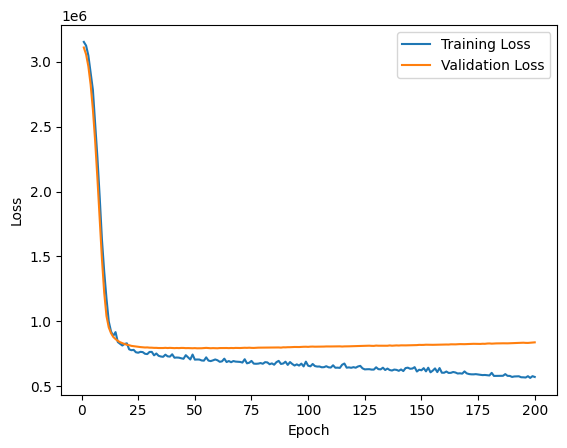


Training for lr=0.001, batch_size=64, hidden_size1=64, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 3174541.260, MAE Loss (Train): 1517.409
Validation Loss: 3105036.096, Validation MAE: 1490.261
Epoch [2/200], MSE Loss (Train): 3112204.639, MAE Loss (Train): 1497.509
Validation Loss: 3024033.538, Validation MAE: 1463.836
Epoch [3/200], MSE Loss (Train): 2975688.865, MAE Loss (Train): 1454.058
Validation Loss: 2873528.269, Validation MAE: 1413.846
Epoch [4/200], MSE Loss (Train): 2820289.714, MAE Loss (Train): 1399.005
Validation Loss: 2641427.346, Validation MAE: 1333.137
Epoch [5/200], MSE Loss (Train): 2596075.087, MAE Loss (Train): 1306.582
Validation Loss: 2330234.385, Validation MAE: 1215.684
Epoch [6/200], MSE Loss (Train): 2141999.147, MAE Loss (Train): 1145.893
Validation Loss: 1957971.683, Validation MAE: 1059.598
Epoch [7/200], MSE Loss (Train): 1747720.863, MAE Loss (Train): 982.846
Validation Loss: 1561410.885, Validation MAE: 880.357
Epoch [8/200], MSE Loss (Train): 1

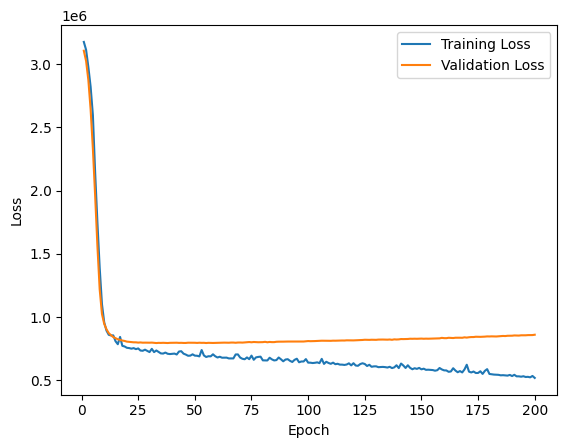


Training for lr=0.001, batch_size=64, hidden_size1=64, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 3202271.394, MAE Loss (Train): 1524.665
Validation Loss: 3088911.481, Validation MAE: 1485.129
Epoch [2/200], MSE Loss (Train): 3053650.752, MAE Loss (Train): 1478.722
Validation Loss: 2961719.712, Validation MAE: 1443.671
Epoch [3/200], MSE Loss (Train): 2875636.514, MAE Loss (Train): 1420.370
Validation Loss: 2723853.250, Validation MAE: 1363.543
Epoch [4/200], MSE Loss (Train): 2612390.817, MAE Loss (Train): 1322.911
Validation Loss: 2359610.481, Validation MAE: 1230.650
Epoch [5/200], MSE Loss (Train): 2133778.858, MAE Loss (Train): 1143.251
Validation Loss: 1892529.240, Validation MAE: 1035.581
Epoch [6/200], MSE Loss (Train): 1654605.038, MAE Loss (Train): 936.597
Validation Loss: 1406099.245, Validation MAE: 816.251
Epoch [7/200], MSE Loss (Train): 1266966.691, MAE Loss (Train): 776.756
Validation Loss: 1046415.361, Validation MAE: 687.879
Epoch [8/200], MSE Loss (Train): 98

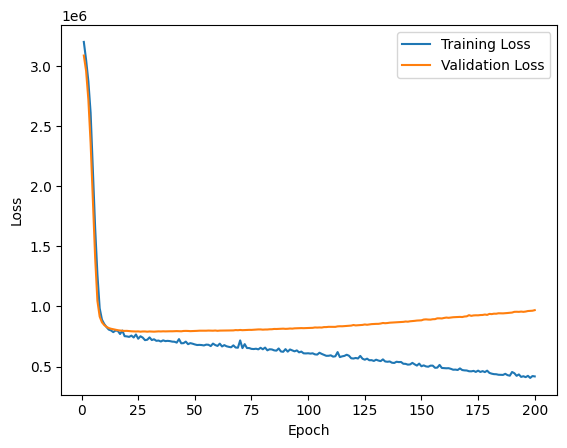


Training for lr=0.001, batch_size=64, hidden_size1=128, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 3220278.423, MAE Loss (Train): 1522.037
Validation Loss: 3097649.365, Validation MAE: 1487.884
Epoch [2/200], MSE Loss (Train): 3089566.079, MAE Loss (Train): 1491.096
Validation Loss: 3013521.481, Validation MAE: 1460.604
Epoch [3/200], MSE Loss (Train): 3024026.822, MAE Loss (Train): 1464.128
Validation Loss: 2868062.192, Validation MAE: 1412.484
Epoch [4/200], MSE Loss (Train): 2825068.692, MAE Loss (Train): 1396.369
Validation Loss: 2645786.327, Validation MAE: 1336.027
Epoch [5/200], MSE Loss (Train): 2555554.570, MAE Loss (Train): 1301.625
Validation Loss: 2352335.192, Validation MAE: 1227.022
Epoch [6/200], MSE Loss (Train): 2189881.130, MAE Loss (Train): 1165.998
Validation Loss: 2005807.683, Validation MAE: 1084.194
Epoch [7/200], MSE Loss (Train): 1847480.904, MAE Loss (Train): 1017.439
Validation Loss: 1639654.567, Validation MAE: 919.871
Epoch [8/200], MSE Loss (Train):

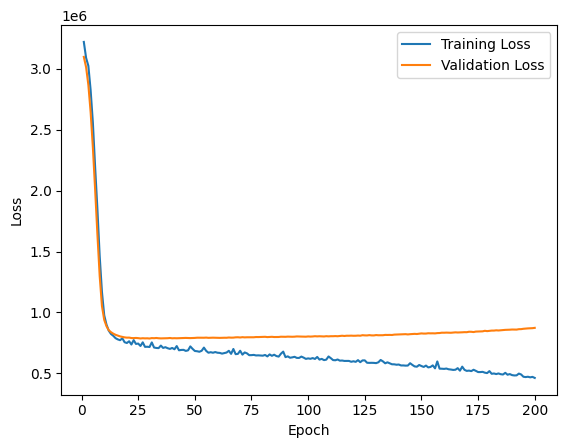


Training for lr=0.001, batch_size=64, hidden_size1=128, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 3166273.005, MAE Loss (Train): 1511.605
Validation Loss: 3080488.308, Validation MAE: 1482.514
Epoch [2/200], MSE Loss (Train): 3047594.740, MAE Loss (Train): 1478.527
Validation Loss: 2946411.712, Validation MAE: 1439.100
Epoch [3/200], MSE Loss (Train): 2847682.633, MAE Loss (Train): 1411.949
Validation Loss: 2700060.240, Validation MAE: 1356.054
Epoch [4/200], MSE Loss (Train): 2549588.312, MAE Loss (Train): 1306.096
Validation Loss: 2333604.856, Validation MAE: 1220.489
Epoch [5/200], MSE Loss (Train): 2138880.180, MAE Loss (Train): 1145.530
Validation Loss: 1878595.577, Validation MAE: 1030.462
Epoch [6/200], MSE Loss (Train): 1648335.911, MAE Loss (Train): 939.336
Validation Loss: 1409986.659, Validation MAE: 825.053
Epoch [7/200], MSE Loss (Train): 1213843.304, MAE Loss (Train): 760.367
Validation Loss: 1050462.399, Validation MAE: 689.289
Epoch [8/200], MSE Loss (Train): 10

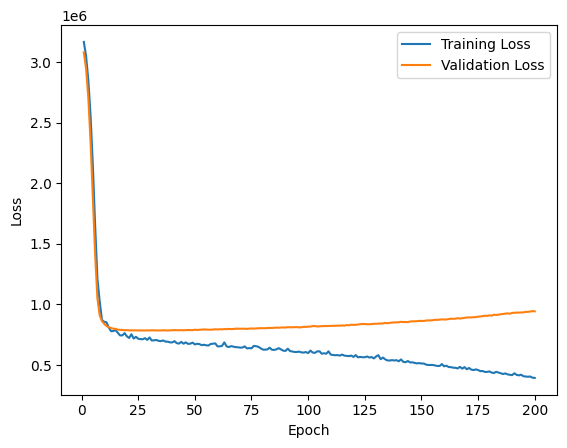


Training for lr=0.001, batch_size=64, hidden_size1=128, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 3123346.154, MAE Loss (Train): 1502.215
Validation Loss: 3043293.846, Validation MAE: 1470.307
Epoch [2/200], MSE Loss (Train): 2959974.603, MAE Loss (Train): 1449.071
Validation Loss: 2796512.250, Validation MAE: 1388.802
Epoch [3/200], MSE Loss (Train): 2640694.026, MAE Loss (Train): 1336.185
Validation Loss: 2357144.010, Validation MAE: 1230.746
Epoch [4/200], MSE Loss (Train): 2075168.426, MAE Loss (Train): 1120.000
Validation Loss: 1764706.971, Validation MAE: 978.830
Epoch [5/200], MSE Loss (Train): 1479852.562, MAE Loss (Train): 863.605
Validation Loss: 1192322.635, Validation MAE: 731.800
Epoch [6/200], MSE Loss (Train): 1025727.649, MAE Loss (Train): 691.805
Validation Loss: 922829.062, Validation MAE: 681.658
Epoch [7/200], MSE Loss (Train): 900557.279, MAE Loss (Train): 673.656
Validation Loss: 868553.762, Validation MAE: 668.619
Epoch [8/200], MSE Loss (Train): 863944.

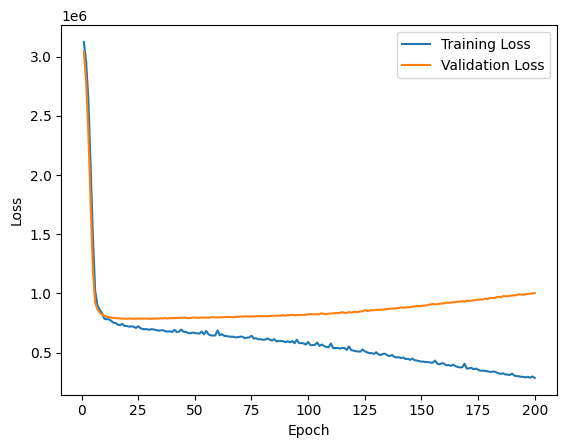


Training for lr=0.001, batch_size=64, hidden_size1=256, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 3142224.514, MAE Loss (Train): 1508.162
Validation Loss: 3086829.481, Validation MAE: 1484.506
Epoch [2/200], MSE Loss (Train): 3077053.800, MAE Loss (Train): 1487.080
Validation Loss: 2981704.288, Validation MAE: 1450.272
Epoch [3/200], MSE Loss (Train): 2975997.514, MAE Loss (Train): 1450.831
Validation Loss: 2797230.231, Validation MAE: 1389.077
Epoch [4/200], MSE Loss (Train): 2713526.899, MAE Loss (Train): 1361.281
Validation Loss: 2521956.894, Validation MAE: 1291.403
Epoch [5/200], MSE Loss (Train): 2366248.305, MAE Loss (Train): 1237.652
Validation Loss: 2162825.962, Validation MAE: 1150.932
Epoch [6/200], MSE Loss (Train): 1986619.255, MAE Loss (Train): 1079.140
Validation Loss: 1751894.471, Validation MAE: 970.027
Epoch [7/200], MSE Loss (Train): 1575515.462, MAE Loss (Train): 903.115
Validation Loss: 1355038.591, Validation MAE: 795.929
Epoch [8/200], MSE Loss (Train): 1

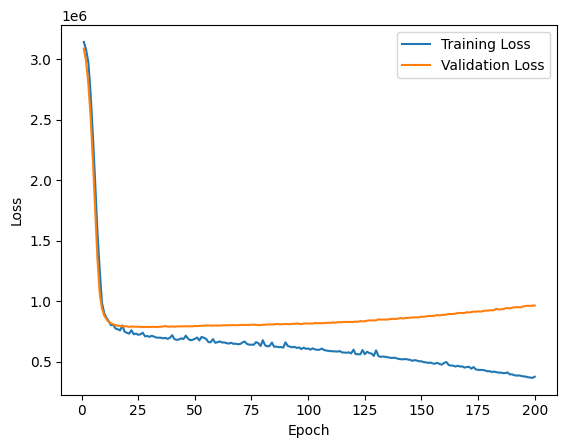


Training for lr=0.001, batch_size=64, hidden_size1=256, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 3263802.168, MAE Loss (Train): 1528.797
Validation Loss: 3060858.250, Validation MAE: 1475.987
Epoch [2/200], MSE Loss (Train): 3038616.375, MAE Loss (Train): 1472.789
Validation Loss: 2868119.269, Validation MAE: 1412.849
Epoch [3/200], MSE Loss (Train): 2736737.800, MAE Loss (Train): 1371.475
Validation Loss: 2511717.702, Validation MAE: 1287.886
Epoch [4/200], MSE Loss (Train): 2282307.659, MAE Loss (Train): 1203.934
Validation Loss: 2002472.865, Validation MAE: 1083.744
Epoch [5/200], MSE Loss (Train): 1729936.964, MAE Loss (Train): 974.785
Validation Loss: 1445641.894, Validation MAE: 836.928
Epoch [6/200], MSE Loss (Train): 1238583.918, MAE Loss (Train): 771.909
Validation Loss: 1032333.591, Validation MAE: 690.126
Epoch [7/200], MSE Loss (Train): 1035526.622, MAE Loss (Train): 709.305
Validation Loss: 902323.293, Validation MAE: 671.949
Epoch [8/200], MSE Loss (Train): 87073

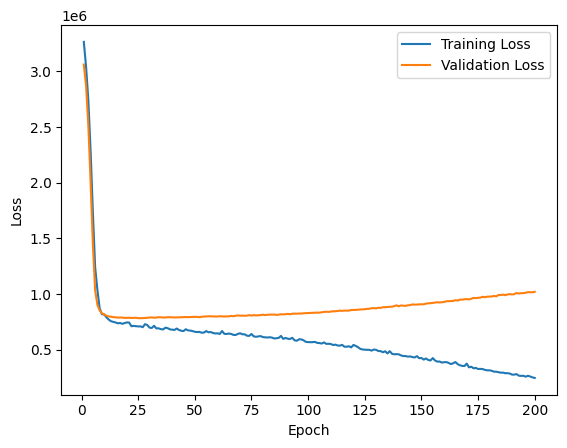


Training for lr=0.001, batch_size=64, hidden_size1=256, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 3160538.438, MAE Loss (Train): 1509.003
Validation Loss: 2989102.769, Validation MAE: 1451.755
Epoch [2/200], MSE Loss (Train): 2842128.025, MAE Loss (Train): 1406.543
Validation Loss: 2610698.000, Validation MAE: 1322.047
Epoch [3/200], MSE Loss (Train): 2373062.245, MAE Loss (Train): 1234.138
Validation Loss: 1971315.885, Validation MAE: 1068.523
Epoch [4/200], MSE Loss (Train): 1632138.721, MAE Loss (Train): 927.730
Validation Loss: 1262989.433, Validation MAE: 751.989
Epoch [5/200], MSE Loss (Train): 1040475.885, MAE Loss (Train): 697.994
Validation Loss: 915714.962, Validation MAE: 676.715
Epoch [6/200], MSE Loss (Train): 864707.091, MAE Loss (Train): 663.568
Validation Loss: 852440.966, Validation MAE: 661.392
Epoch [7/200], MSE Loss (Train): 811375.994, MAE Loss (Train): 649.964
Validation Loss: 828777.055, Validation MAE: 654.808
Epoch [8/200], MSE Loss (Train): 792934.962

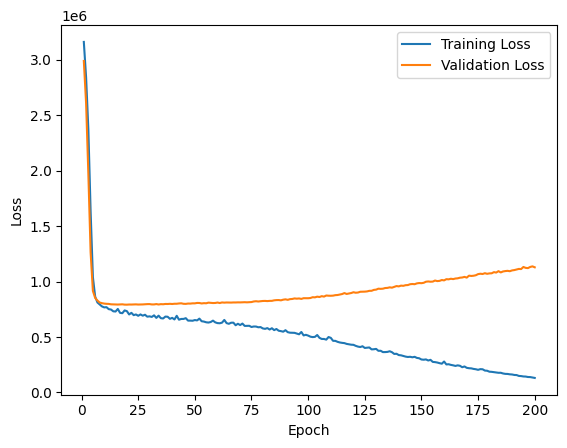


Training for lr=0.001, batch_size=128, hidden_size1=64, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 3203309.909, MAE Loss (Train): 1521.495
Validation Loss: 3121036.250, Validation MAE: 1495.584
Epoch [2/200], MSE Loss (Train): 3237436.322, MAE Loss (Train): 1525.081
Validation Loss: 3083951.519, Validation MAE: 1483.571
Epoch [3/200], MSE Loss (Train): 3109486.940, MAE Loss (Train): 1495.308
Validation Loss: 3017262.365, Validation MAE: 1461.819
Epoch [4/200], MSE Loss (Train): 3021086.017, MAE Loss (Train): 1465.890
Validation Loss: 2912015.308, Validation MAE: 1427.101
Epoch [5/200], MSE Loss (Train): 2855758.981, MAE Loss (Train): 1414.069
Validation Loss: 2761993.365, Validation MAE: 1375.991
Epoch [6/200], MSE Loss (Train): 2709711.183, MAE Loss (Train): 1360.032
Validation Loss: 2562522.212, Validation MAE: 1304.598
Epoch [7/200], MSE Loss (Train): 2500167.517, MAE Loss (Train): 1280.409
Validation Loss: 2311670.510, Validation MAE: 1207.744
Epoch [8/200], MSE Loss (Train)

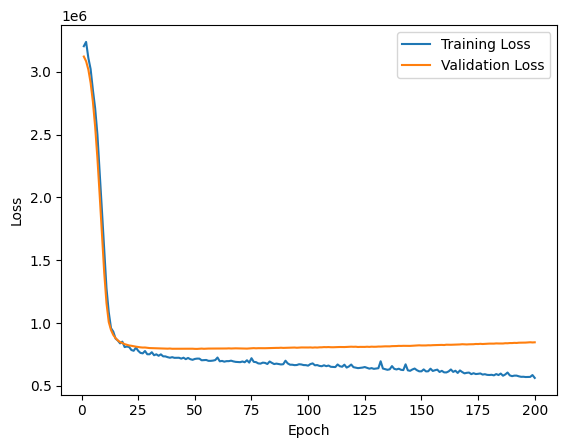


Training for lr=0.001, batch_size=128, hidden_size1=64, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 3168780.976, MAE Loss (Train): 1513.704
Validation Loss: 3102207.808, Validation MAE: 1489.281
Epoch [2/200], MSE Loss (Train): 3097049.454, MAE Loss (Train): 1492.175
Validation Loss: 3022331.481, Validation MAE: 1463.064
Epoch [3/200], MSE Loss (Train): 3012669.712, MAE Loss (Train): 1463.716
Validation Loss: 2884463.192, Validation MAE: 1417.151
Epoch [4/200], MSE Loss (Train): 2799222.166, MAE Loss (Train): 1392.262
Validation Loss: 2669154.721, Validation MAE: 1342.711
Epoch [5/200], MSE Loss (Train): 2538911.476, MAE Loss (Train): 1301.698
Validation Loss: 2372790.856, Validation MAE: 1232.413
Epoch [6/200], MSE Loss (Train): 2241845.046, MAE Loss (Train): 1182.559
Validation Loss: 2015730.163, Validation MAE: 1085.369
Epoch [7/200], MSE Loss (Train): 1827135.200, MAE Loss (Train): 1011.625
Validation Loss: 1632855.404, Validation MAE: 914.964
Epoch [8/200], MSE Loss (Train):

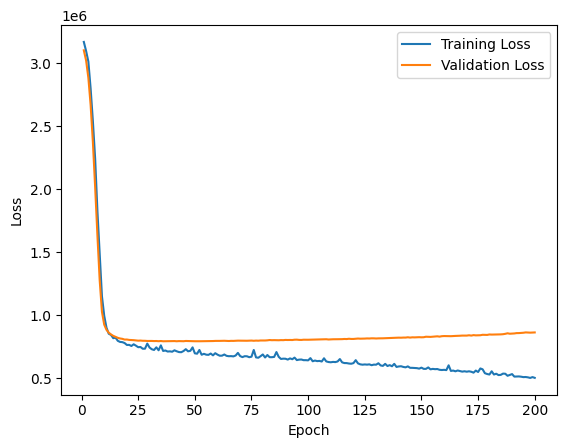


Training for lr=0.001, batch_size=128, hidden_size1=64, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 3150443.990, MAE Loss (Train): 1510.191
Validation Loss: 3088815.596, Validation MAE: 1485.104
Epoch [2/200], MSE Loss (Train): 3069634.812, MAE Loss (Train): 1482.436
Validation Loss: 2957283.769, Validation MAE: 1442.006
Epoch [3/200], MSE Loss (Train): 2855172.702, MAE Loss (Train): 1412.644
Validation Loss: 2709235.317, Validation MAE: 1357.370
Epoch [4/200], MSE Loss (Train): 2581763.784, MAE Loss (Train): 1309.769
Validation Loss: 2324872.827, Validation MAE: 1213.346
Epoch [5/200], MSE Loss (Train): 2084636.645, MAE Loss (Train): 1121.084
Validation Loss: 1843297.327, Validation MAE: 1007.756
Epoch [6/200], MSE Loss (Train): 1632163.602, MAE Loss (Train): 923.524
Validation Loss: 1361633.928, Validation MAE: 790.897
Epoch [7/200], MSE Loss (Train): 1202222.174, MAE Loss (Train): 753.400
Validation Loss: 1028181.981, Validation MAE: 683.862
Epoch [8/200], MSE Loss (Train): 9

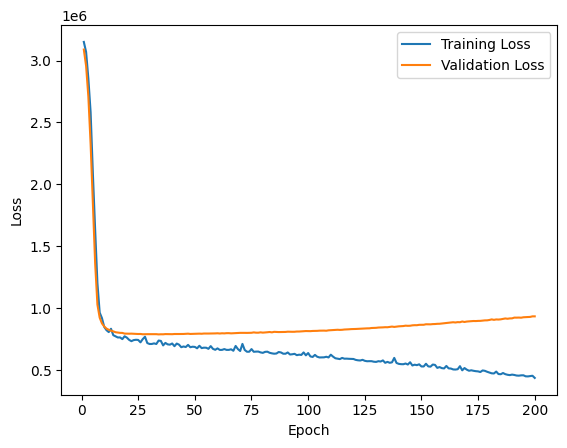


Training for lr=0.001, batch_size=128, hidden_size1=128, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 3162152.130, MAE Loss (Train): 1513.289
Validation Loss: 3094843.750, Validation MAE: 1487.208
Epoch [2/200], MSE Loss (Train): 3070353.946, MAE Loss (Train): 1484.904
Validation Loss: 3005409.442, Validation MAE: 1458.362
Epoch [3/200], MSE Loss (Train): 3003157.894, MAE Loss (Train): 1458.003
Validation Loss: 2850504.442, Validation MAE: 1407.372
Epoch [4/200], MSE Loss (Train): 2780735.014, MAE Loss (Train): 1389.304
Validation Loss: 2619220.788, Validation MAE: 1327.319
Epoch [5/200], MSE Loss (Train): 2523602.829, MAE Loss (Train): 1292.758
Validation Loss: 2308811.596, Validation MAE: 1210.476
Epoch [6/200], MSE Loss (Train): 2195815.623, MAE Loss (Train): 1152.760
Validation Loss: 1946069.692, Validation MAE: 1057.738
Epoch [7/200], MSE Loss (Train): 1778119.925, MAE Loss (Train): 990.126
Validation Loss: 1571583.207, Validation MAE: 888.642
Epoch [8/200], MSE Loss (Train):

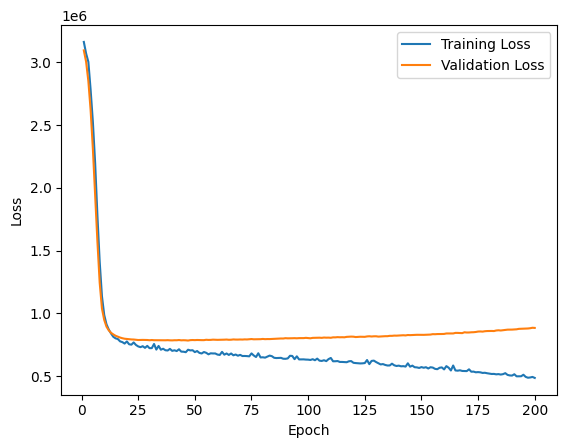


Training for lr=0.001, batch_size=128, hidden_size1=128, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 3164527.096, MAE Loss (Train): 1513.430
Validation Loss: 3097981.923, Validation MAE: 1487.802
Epoch [2/200], MSE Loss (Train): 3091897.933, MAE Loss (Train): 1491.827
Validation Loss: 2992249.096, Validation MAE: 1452.939
Epoch [3/200], MSE Loss (Train): 2931856.127, MAE Loss (Train): 1437.047
Validation Loss: 2788739.769, Validation MAE: 1384.322
Epoch [4/200], MSE Loss (Train): 2691435.421, MAE Loss (Train): 1351.090
Validation Loss: 2470300.202, Validation MAE: 1269.620
Epoch [5/200], MSE Loss (Train): 2295268.615, MAE Loss (Train): 1208.120
Validation Loss: 2051615.779, Validation MAE: 1101.210
Epoch [6/200], MSE Loss (Train): 1834937.114, MAE Loss (Train): 1014.827
Validation Loss: 1589905.865, Validation MAE: 893.950
Epoch [7/200], MSE Loss (Train): 1387020.462, MAE Loss (Train): 826.007
Validation Loss: 1186460.524, Validation MAE: 730.523
Epoch [8/200], MSE Loss (Train): 

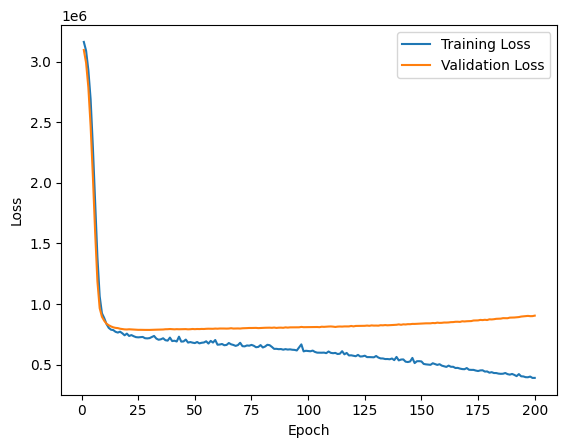


Training for lr=0.001, batch_size=128, hidden_size1=128, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 3150030.553, MAE Loss (Train): 1509.465
Validation Loss: 3055668.808, Validation MAE: 1473.984
Epoch [2/200], MSE Loss (Train): 3123156.776, MAE Loss (Train): 1484.475
Validation Loss: 2835452.538, Validation MAE: 1400.726
Epoch [3/200], MSE Loss (Train): 2719276.865, MAE Loss (Train): 1359.584
Validation Loss: 2424700.000, Validation MAE: 1253.742
Epoch [4/200], MSE Loss (Train): 2192318.017, MAE Loss (Train): 1164.559
Validation Loss: 1852071.702, Validation MAE: 1015.178
Epoch [5/200], MSE Loss (Train): 1571991.007, MAE Loss (Train): 901.074
Validation Loss: 1266512.928, Validation MAE: 754.965
Epoch [6/200], MSE Loss (Train): 1086326.333, MAE Loss (Train): 712.436
Validation Loss: 947243.375, Validation MAE: 671.556
Epoch [7/200], MSE Loss (Train): 913758.903, MAE Loss (Train): 678.076
Validation Loss: 877754.255, Validation MAE: 671.435
Epoch [8/200], MSE Loss (Train): 84047

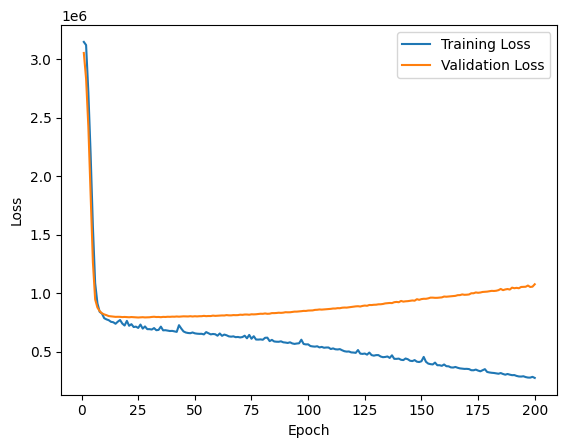


Training for lr=0.001, batch_size=128, hidden_size1=256, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 3184837.087, MAE Loss (Train): 1517.204
Validation Loss: 3086744.269, Validation MAE: 1484.036
Epoch [2/200], MSE Loss (Train): 3054239.851, MAE Loss (Train): 1477.509
Validation Loss: 2985871.038, Validation MAE: 1450.661
Epoch [3/200], MSE Loss (Train): 2922063.601, MAE Loss (Train): 1435.033
Validation Loss: 2814645.933, Validation MAE: 1393.106
Epoch [4/200], MSE Loss (Train): 2742860.935, MAE Loss (Train): 1369.302
Validation Loss: 2564991.481, Validation MAE: 1304.563
Epoch [5/200], MSE Loss (Train): 2447106.517, MAE Loss (Train): 1265.461
Validation Loss: 2242303.567, Validation MAE: 1179.922
Epoch [6/200], MSE Loss (Train): 2094733.445, MAE Loss (Train): 1119.075
Validation Loss: 1869772.202, Validation MAE: 1019.731
Epoch [7/200], MSE Loss (Train): 1675634.181, MAE Loss (Train): 944.077
Validation Loss: 1493043.231, Validation MAE: 848.944
Epoch [8/200], MSE Loss (Train):

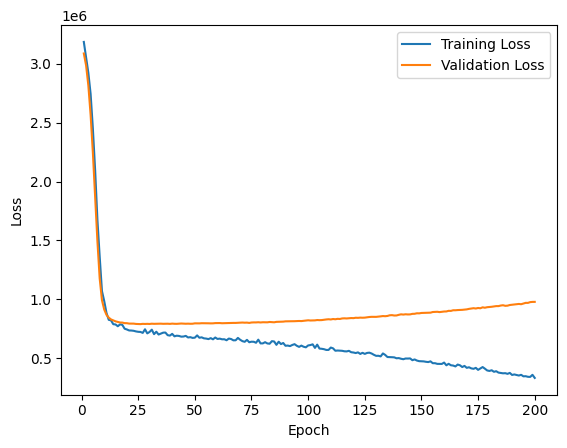


Training for lr=0.001, batch_size=128, hidden_size1=256, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 3200976.678, MAE Loss (Train): 1516.127
Validation Loss: 3038405.885, Validation MAE: 1468.897
Epoch [2/200], MSE Loss (Train): 2960043.793, MAE Loss (Train): 1448.029
Validation Loss: 2812529.048, Validation MAE: 1394.570
Epoch [3/200], MSE Loss (Train): 2645838.486, MAE Loss (Train): 1341.540
Validation Loss: 2421317.337, Validation MAE: 1255.149
Epoch [4/200], MSE Loss (Train): 2219768.837, MAE Loss (Train): 1175.152
Validation Loss: 1892257.817, Validation MAE: 1037.171
Epoch [5/200], MSE Loss (Train): 1620835.339, MAE Loss (Train): 924.352
Validation Loss: 1338769.356, Validation MAE: 790.102
Epoch [6/200], MSE Loss (Train): 1145438.660, MAE Loss (Train): 733.272
Validation Loss: 970850.817, Validation MAE: 671.454
Epoch [7/200], MSE Loss (Train): 921026.360, MAE Loss (Train): 678.696
Validation Loss: 868918.938, Validation MAE: 670.395
Epoch [8/200], MSE Loss (Train): 862396

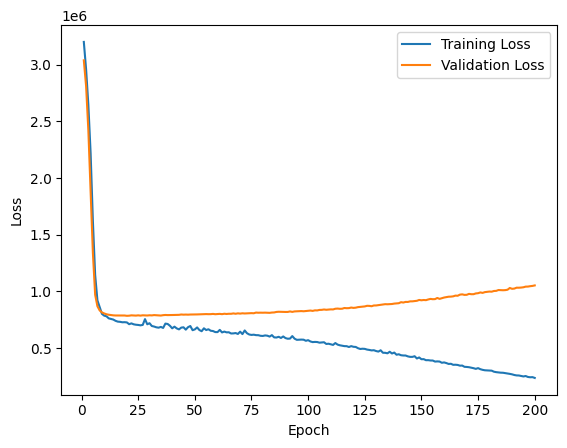


Training for lr=0.001, batch_size=128, hidden_size1=256, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 3106615.546, MAE Loss (Train): 1496.066
Validation Loss: 3015674.135, Validation MAE: 1460.510
Epoch [2/200], MSE Loss (Train): 2979290.981, MAE Loss (Train): 1443.039
Validation Loss: 2699491.596, Validation MAE: 1352.971
Epoch [3/200], MSE Loss (Train): 2505681.188, MAE Loss (Train): 1282.216
Validation Loss: 2144616.865, Validation MAE: 1139.812
Epoch [4/200], MSE Loss (Train): 1806903.984, MAE Loss (Train): 1001.318
Validation Loss: 1462339.264, Validation MAE: 835.267
Epoch [5/200], MSE Loss (Train): 1231405.364, MAE Loss (Train): 763.502
Validation Loss: 985878.067, Validation MAE: 681.769
Epoch [6/200], MSE Loss (Train): 956713.405, MAE Loss (Train): 689.457
Validation Loss: 881335.736, Validation MAE: 669.542
Epoch [7/200], MSE Loss (Train): 853553.742, MAE Loss (Train): 661.258
Validation Loss: 834347.639, Validation MAE: 661.089
Epoch [8/200], MSE Loss (Train): 820525.4

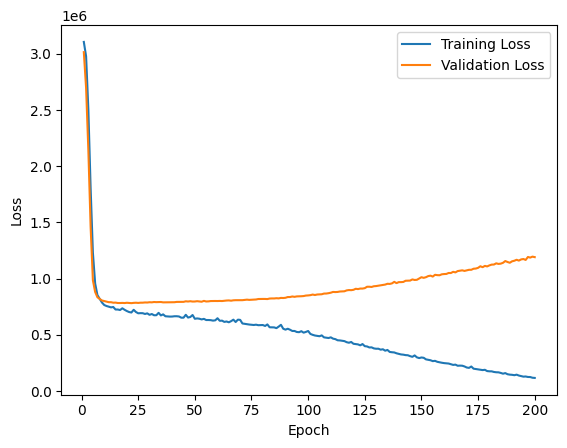


Training for lr=0.01, batch_size=64, hidden_size1=64, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 2626191.757, MAE Loss (Train): 1316.627
Validation Loss: 1360814.072, Validation MAE: 809.279
Epoch [2/200], MSE Loss (Train): 981832.501, MAE Loss (Train): 712.865
Validation Loss: 846587.038, Validation MAE: 682.319
Epoch [3/200], MSE Loss (Train): 795044.300, MAE Loss (Train): 652.820
Validation Loss: 796570.380, Validation MAE: 642.284
Epoch [4/200], MSE Loss (Train): 757147.772, MAE Loss (Train): 628.477
Validation Loss: 783516.618, Validation MAE: 632.511
Epoch [5/200], MSE Loss (Train): 735206.620, MAE Loss (Train): 623.656
Validation Loss: 796188.236, Validation MAE: 625.044
Epoch [6/200], MSE Loss (Train): 725856.869, MAE Loss (Train): 618.961
Validation Loss: 781726.904, Validation MAE: 640.791
Epoch [7/200], MSE Loss (Train): 708976.572, MAE Loss (Train): 614.383
Validation Loss: 813541.832, Validation MAE: 664.892
Epoch [8/200], MSE Loss (Train): 706651.836, MAE Loss (Tra

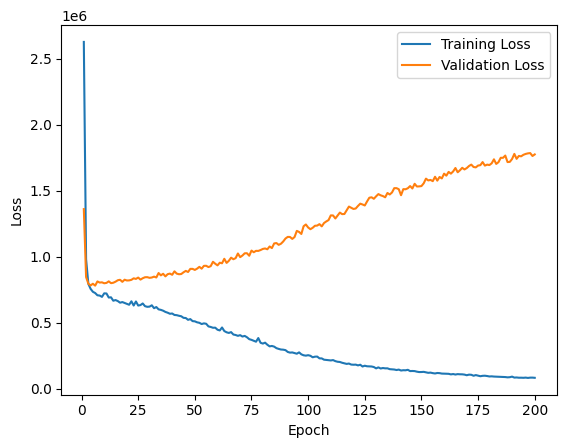


Training for lr=0.01, batch_size=64, hidden_size1=64, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 2337382.535, MAE Loss (Train): 1200.267
Validation Loss: 953777.880, Validation MAE: 693.032
Epoch [2/200], MSE Loss (Train): 876158.740, MAE Loss (Train): 683.452
Validation Loss: 817314.382, Validation MAE: 649.006
Epoch [3/200], MSE Loss (Train): 775463.879, MAE Loss (Train): 635.805
Validation Loss: 797773.940, Validation MAE: 656.797
Epoch [4/200], MSE Loss (Train): 747212.117, MAE Loss (Train): 629.236
Validation Loss: 792248.685, Validation MAE: 633.492
Epoch [5/200], MSE Loss (Train): 754802.081, MAE Loss (Train): 625.512
Validation Loss: 806436.031, Validation MAE: 647.000
Epoch [6/200], MSE Loss (Train): 737303.973, MAE Loss (Train): 626.263
Validation Loss: 796777.582, Validation MAE: 639.560
Epoch [7/200], MSE Loss (Train): 707676.256, MAE Loss (Train): 610.603
Validation Loss: 790883.147, Validation MAE: 634.196
Epoch [8/200], MSE Loss (Train): 707460.916, MAE Loss (Trai

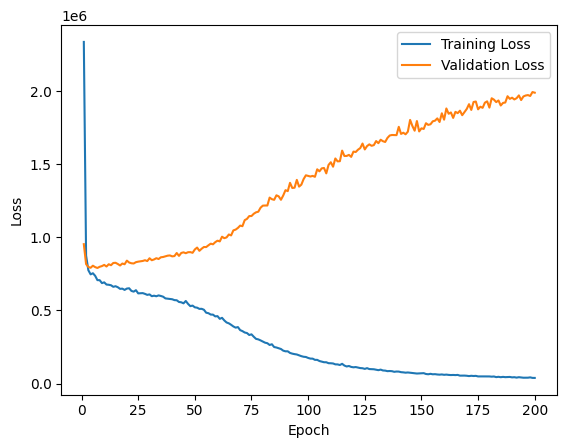


Training for lr=0.01, batch_size=64, hidden_size1=64, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 2128272.542, MAE Loss (Train): 1120.991
Validation Loss: 978434.591, Validation MAE: 752.213
Epoch [2/200], MSE Loss (Train): 865365.694, MAE Loss (Train): 664.664
Validation Loss: 807083.889, Validation MAE: 657.572
Epoch [3/200], MSE Loss (Train): 768460.566, MAE Loss (Train): 636.229
Validation Loss: 805021.856, Validation MAE: 644.251
Epoch [4/200], MSE Loss (Train): 748110.198, MAE Loss (Train): 626.835
Validation Loss: 802579.654, Validation MAE: 632.479
Epoch [5/200], MSE Loss (Train): 723509.916, MAE Loss (Train): 615.361
Validation Loss: 810184.490, Validation MAE: 642.067
Epoch [6/200], MSE Loss (Train): 711711.946, MAE Loss (Train): 611.448
Validation Loss: 796289.538, Validation MAE: 657.689
Epoch [7/200], MSE Loss (Train): 701237.137, MAE Loss (Train): 610.919
Validation Loss: 804522.257, Validation MAE: 635.907
Epoch [8/200], MSE Loss (Train): 737754.888, MAE Loss (Tra

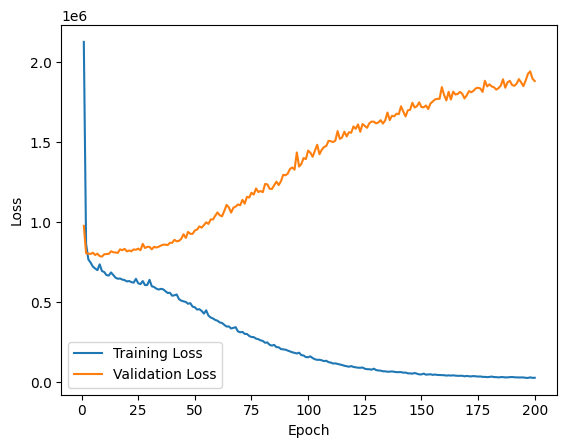


Training for lr=0.01, batch_size=64, hidden_size1=128, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 2380288.800, MAE Loss (Train): 1213.987
Validation Loss: 1025726.053, Validation MAE: 707.438
Epoch [2/200], MSE Loss (Train): 893561.293, MAE Loss (Train): 687.092
Validation Loss: 821390.421, Validation MAE: 638.384
Epoch [3/200], MSE Loss (Train): 790993.626, MAE Loss (Train): 645.005
Validation Loss: 801994.534, Validation MAE: 636.873
Epoch [4/200], MSE Loss (Train): 751539.671, MAE Loss (Train): 638.562
Validation Loss: 785965.490, Validation MAE: 619.918
Epoch [5/200], MSE Loss (Train): 735465.635, MAE Loss (Train): 619.689
Validation Loss: 811527.019, Validation MAE: 655.881
Epoch [6/200], MSE Loss (Train): 718419.034, MAE Loss (Train): 617.501
Validation Loss: 805380.171, Validation MAE: 621.146
Epoch [7/200], MSE Loss (Train): 710208.124, MAE Loss (Train): 607.032
Validation Loss: 807549.207, Validation MAE: 657.308
Epoch [8/200], MSE Loss (Train): 697142.901, MAE Loss (Tr

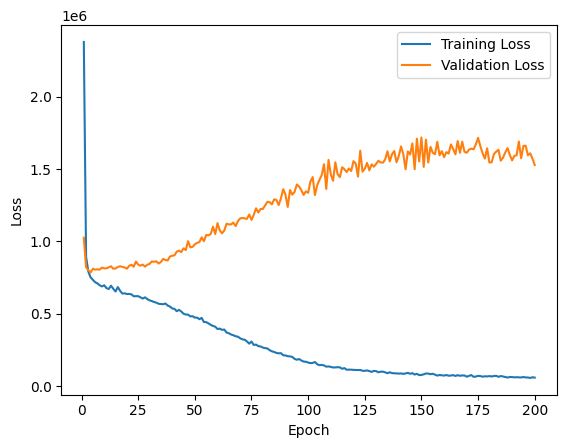


Training for lr=0.01, batch_size=64, hidden_size1=128, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 2054557.377, MAE Loss (Train): 1107.396
Validation Loss: 908405.731, Validation MAE: 709.344
Epoch [2/200], MSE Loss (Train): 824366.981, MAE Loss (Train): 654.616
Validation Loss: 789705.351, Validation MAE: 635.635
Epoch [3/200], MSE Loss (Train): 761262.256, MAE Loss (Train): 625.230
Validation Loss: 797960.418, Validation MAE: 653.835
Epoch [4/200], MSE Loss (Train): 742768.647, MAE Loss (Train): 626.991
Validation Loss: 797910.582, Validation MAE: 651.091
Epoch [5/200], MSE Loss (Train): 739955.694, MAE Loss (Train): 620.830
Validation Loss: 802151.577, Validation MAE: 632.311
Epoch [6/200], MSE Loss (Train): 714979.391, MAE Loss (Train): 615.564
Validation Loss: 794415.760, Validation MAE: 635.324
Epoch [7/200], MSE Loss (Train): 698738.116, MAE Loss (Train): 605.973
Validation Loss: 791080.462, Validation MAE: 642.784
Epoch [8/200], MSE Loss (Train): 692560.043, MAE Loss (Tra

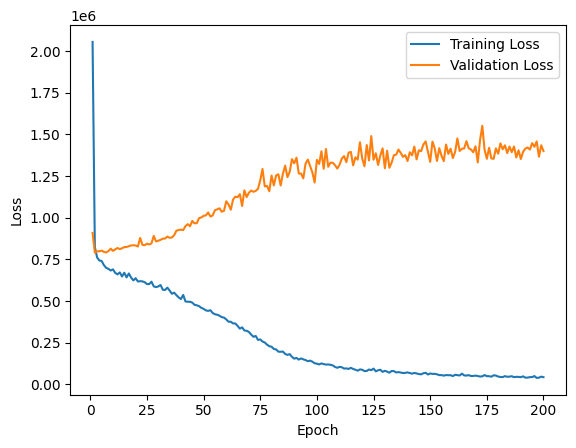


Training for lr=0.01, batch_size=64, hidden_size1=128, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 1759776.897, MAE Loss (Train): 1006.271
Validation Loss: 857703.322, Validation MAE: 660.192
Epoch [2/200], MSE Loss (Train): 838167.704, MAE Loss (Train): 658.620
Validation Loss: 803020.197, Validation MAE: 639.892
Epoch [3/200], MSE Loss (Train): 769524.390, MAE Loss (Train): 641.469
Validation Loss: 798571.812, Validation MAE: 649.904
Epoch [4/200], MSE Loss (Train): 729143.725, MAE Loss (Train): 622.151
Validation Loss: 807906.510, Validation MAE: 661.781
Epoch [5/200], MSE Loss (Train): 710278.955, MAE Loss (Train): 612.345
Validation Loss: 802957.435, Validation MAE: 626.993
Epoch [6/200], MSE Loss (Train): 701178.967, MAE Loss (Train): 609.111
Validation Loss: 819774.712, Validation MAE: 665.928
Epoch [7/200], MSE Loss (Train): 719955.785, MAE Loss (Train): 619.282
Validation Loss: 807377.851, Validation MAE: 640.711
Epoch [8/200], MSE Loss (Train): 673369.505, MAE Loss (Tr

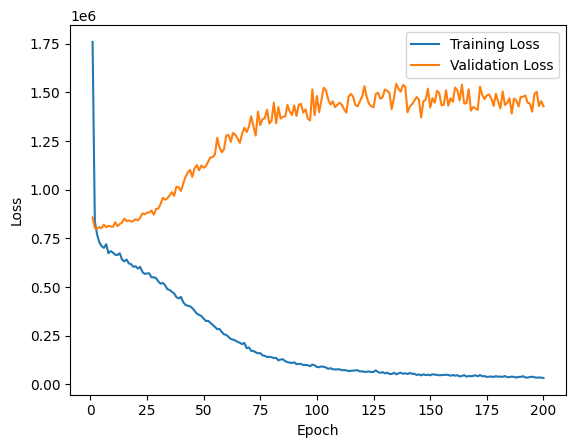


Training for lr=0.01, batch_size=64, hidden_size1=256, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 2238972.232, MAE Loss (Train): 1164.521
Validation Loss: 956129.274, Validation MAE: 733.317
Epoch [2/200], MSE Loss (Train): 879516.063, MAE Loss (Train): 674.949
Validation Loss: 801111.250, Validation MAE: 643.443
Epoch [3/200], MSE Loss (Train): 776251.141, MAE Loss (Train): 643.381
Validation Loss: 807645.062, Validation MAE: 632.320
Epoch [4/200], MSE Loss (Train): 752223.084, MAE Loss (Train): 627.985
Validation Loss: 795012.087, Validation MAE: 633.895
Epoch [5/200], MSE Loss (Train): 736522.583, MAE Loss (Train): 623.874
Validation Loss: 815555.322, Validation MAE: 650.298
Epoch [6/200], MSE Loss (Train): 721165.387, MAE Loss (Train): 621.779
Validation Loss: 788414.293, Validation MAE: 640.560
Epoch [7/200], MSE Loss (Train): 705976.195, MAE Loss (Train): 614.097
Validation Loss: 799937.582, Validation MAE: 656.346
Epoch [8/200], MSE Loss (Train): 693301.784, MAE Loss (Tra

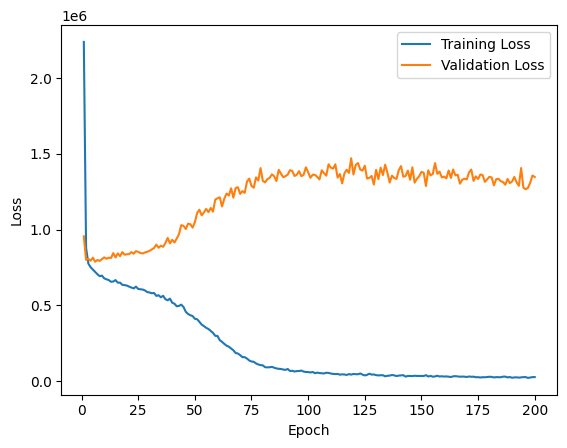


Training for lr=0.01, batch_size=64, hidden_size1=256, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 1814322.498, MAE Loss (Train): 1027.323
Validation Loss: 856371.490, Validation MAE: 679.746
Epoch [2/200], MSE Loss (Train): 801311.226, MAE Loss (Train): 645.879
Validation Loss: 792307.892, Validation MAE: 639.342
Epoch [3/200], MSE Loss (Train): 781701.282, MAE Loss (Train): 636.990
Validation Loss: 790272.046, Validation MAE: 638.977
Epoch [4/200], MSE Loss (Train): 742095.271, MAE Loss (Train): 629.747
Validation Loss: 797648.863, Validation MAE: 621.958
Epoch [5/200], MSE Loss (Train): 724152.176, MAE Loss (Train): 620.031
Validation Loss: 814333.587, Validation MAE: 655.503
Epoch [6/200], MSE Loss (Train): 705071.781, MAE Loss (Train): 610.435
Validation Loss: 819462.298, Validation MAE: 681.050
Epoch [7/200], MSE Loss (Train): 717846.897, MAE Loss (Train): 608.447
Validation Loss: 821081.933, Validation MAE: 656.532
Epoch [8/200], MSE Loss (Train): 724475.279, MAE Loss (Tra

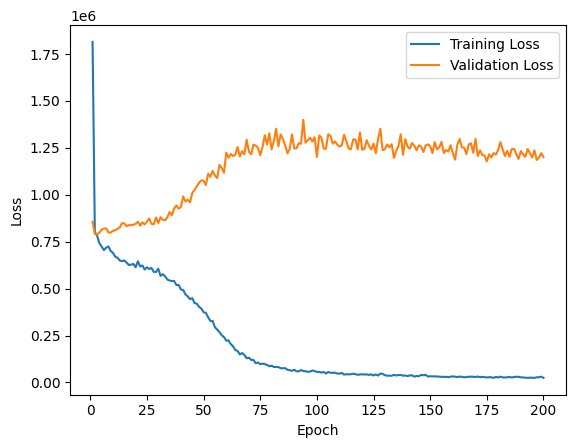


Training for lr=0.01, batch_size=64, hidden_size1=256, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 1607811.492, MAE Loss (Train): 958.140
Validation Loss: 820529.656, Validation MAE: 662.536
Epoch [2/200], MSE Loss (Train): 818650.879, MAE Loss (Train): 649.412
Validation Loss: 794161.346, Validation MAE: 668.854
Epoch [3/200], MSE Loss (Train): 745326.761, MAE Loss (Train): 630.684
Validation Loss: 804722.962, Validation MAE: 647.420
Epoch [4/200], MSE Loss (Train): 726338.663, MAE Loss (Train): 619.342
Validation Loss: 844800.560, Validation MAE: 621.189
Epoch [5/200], MSE Loss (Train): 717241.439, MAE Loss (Train): 609.533
Validation Loss: 824742.505, Validation MAE: 673.436
Epoch [6/200], MSE Loss (Train): 702697.950, MAE Loss (Train): 610.809
Validation Loss: 831440.822, Validation MAE: 671.945
Epoch [7/200], MSE Loss (Train): 689827.128, MAE Loss (Train): 607.784
Validation Loss: 805413.337, Validation MAE: 618.031
Epoch [8/200], MSE Loss (Train): 686404.029, MAE Loss (Tra

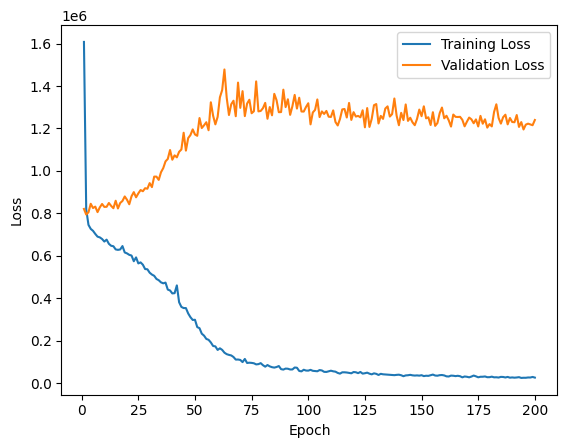


Training for lr=0.01, batch_size=128, hidden_size1=64, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 2653273.810, MAE Loss (Train): 1328.647
Validation Loss: 1517220.899, Validation MAE: 855.048
Epoch [2/200], MSE Loss (Train): 1011442.461, MAE Loss (Train): 717.326
Validation Loss: 847518.587, Validation MAE: 654.044
Epoch [3/200], MSE Loss (Train): 841274.339, MAE Loss (Train): 658.918
Validation Loss: 801095.236, Validation MAE: 626.910
Epoch [4/200], MSE Loss (Train): 764127.183, MAE Loss (Train): 632.100
Validation Loss: 790987.077, Validation MAE: 621.203
Epoch [5/200], MSE Loss (Train): 773517.457, MAE Loss (Train): 633.855
Validation Loss: 794786.137, Validation MAE: 639.114
Epoch [6/200], MSE Loss (Train): 737586.864, MAE Loss (Train): 623.496
Validation Loss: 805311.048, Validation MAE: 661.213
Epoch [7/200], MSE Loss (Train): 719937.420, MAE Loss (Train): 617.872
Validation Loss: 804226.938, Validation MAE: 656.265
Epoch [8/200], MSE Loss (Train): 709772.239, MAE Loss (T

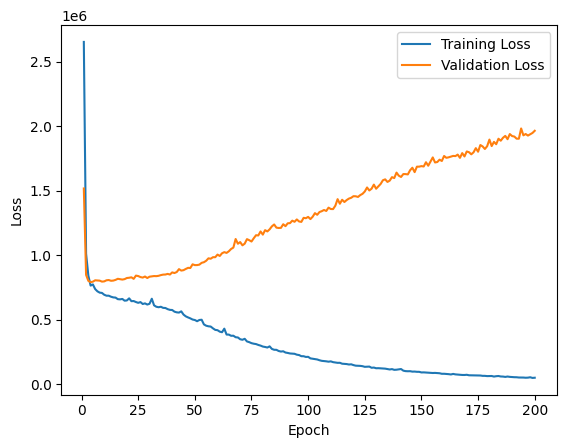


Training for lr=0.01, batch_size=128, hidden_size1=64, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 2342704.384, MAE Loss (Train): 1213.069
Validation Loss: 994989.981, Validation MAE: 694.253
Epoch [2/200], MSE Loss (Train): 911889.859, MAE Loss (Train): 688.624
Validation Loss: 818260.310, Validation MAE: 650.052
Epoch [3/200], MSE Loss (Train): 782868.806, MAE Loss (Train): 641.092
Validation Loss: 813038.214, Validation MAE: 652.839
Epoch [4/200], MSE Loss (Train): 767712.825, MAE Loss (Train): 639.188
Validation Loss: 801661.882, Validation MAE: 616.968
Epoch [5/200], MSE Loss (Train): 737109.221, MAE Loss (Train): 621.473
Validation Loss: 810999.394, Validation MAE: 646.488
Epoch [6/200], MSE Loss (Train): 724736.138, MAE Loss (Train): 614.792
Validation Loss: 813663.409, Validation MAE: 647.177
Epoch [7/200], MSE Loss (Train): 722801.657, MAE Loss (Train): 622.157
Validation Loss: 803289.637, Validation MAE: 631.929
Epoch [8/200], MSE Loss (Train): 713622.316, MAE Loss (Tra

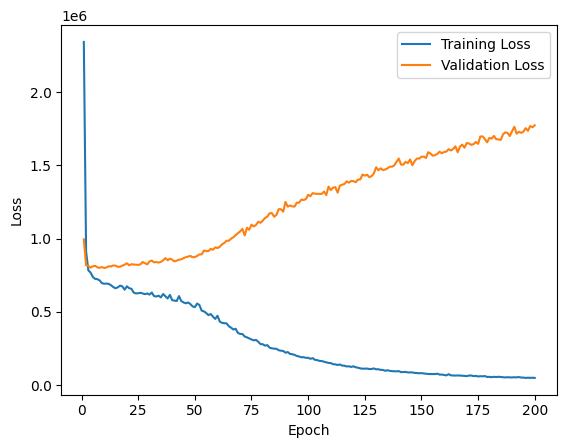


Training for lr=0.01, batch_size=128, hidden_size1=64, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 2014752.495, MAE Loss (Train): 1089.778
Validation Loss: 911933.894, Validation MAE: 713.376
Epoch [2/200], MSE Loss (Train): 841896.352, MAE Loss (Train): 662.469
Validation Loss: 810810.885, Validation MAE: 656.370
Epoch [3/200], MSE Loss (Train): 772272.190, MAE Loss (Train): 637.236
Validation Loss: 794410.642, Validation MAE: 633.615
Epoch [4/200], MSE Loss (Train): 751341.428, MAE Loss (Train): 626.632
Validation Loss: 817096.236, Validation MAE: 678.657
Epoch [5/200], MSE Loss (Train): 770862.549, MAE Loss (Train): 637.138
Validation Loss: 821281.173, Validation MAE: 626.072
Epoch [6/200], MSE Loss (Train): 708442.450, MAE Loss (Train): 607.483
Validation Loss: 802410.055, Validation MAE: 624.134
Epoch [7/200], MSE Loss (Train): 693173.212, MAE Loss (Train): 604.778
Validation Loss: 811591.762, Validation MAE: 626.751
Epoch [8/200], MSE Loss (Train): 696381.102, MAE Loss (Tr

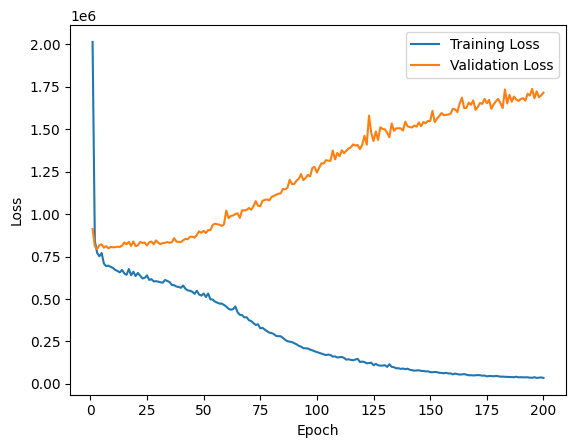


Training for lr=0.01, batch_size=128, hidden_size1=128, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 2435578.570, MAE Loss (Train): 1230.460
Validation Loss: 1011940.510, Validation MAE: 698.379
Epoch [2/200], MSE Loss (Train): 878658.086, MAE Loss (Train): 674.957
Validation Loss: 819245.418, Validation MAE: 657.495
Epoch [3/200], MSE Loss (Train): 778184.897, MAE Loss (Train): 636.851
Validation Loss: 802509.334, Validation MAE: 626.811
Epoch [4/200], MSE Loss (Train): 780464.612, MAE Loss (Train): 636.183
Validation Loss: 794644.178, Validation MAE: 644.692
Epoch [5/200], MSE Loss (Train): 759388.802, MAE Loss (Train): 628.903
Validation Loss: 798240.130, Validation MAE: 656.695
Epoch [6/200], MSE Loss (Train): 720768.477, MAE Loss (Train): 623.481
Validation Loss: 790366.812, Validation MAE: 638.204
Epoch [7/200], MSE Loss (Train): 711804.559, MAE Loss (Train): 616.415
Validation Loss: 798623.339, Validation MAE: 643.851
Epoch [8/200], MSE Loss (Train): 703451.307, MAE Loss (T

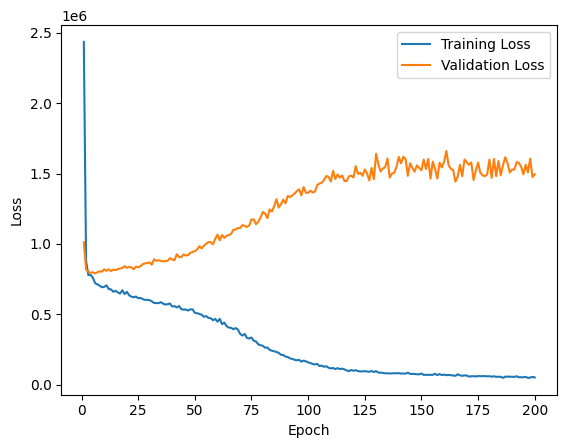


Training for lr=0.01, batch_size=128, hidden_size1=128, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 1994162.444, MAE Loss (Train): 1084.073
Validation Loss: 929134.183, Validation MAE: 743.160
Epoch [2/200], MSE Loss (Train): 830142.782, MAE Loss (Train): 661.040
Validation Loss: 802389.067, Validation MAE: 642.761
Epoch [3/200], MSE Loss (Train): 774026.785, MAE Loss (Train): 635.110
Validation Loss: 796692.599, Validation MAE: 646.268
Epoch [4/200], MSE Loss (Train): 745106.259, MAE Loss (Train): 631.407
Validation Loss: 789168.002, Validation MAE: 646.317
Epoch [5/200], MSE Loss (Train): 724596.830, MAE Loss (Train): 621.689
Validation Loss: 796845.784, Validation MAE: 628.882
Epoch [6/200], MSE Loss (Train): 706612.209, MAE Loss (Train): 609.428
Validation Loss: 813827.675, Validation MAE: 635.126
Epoch [7/200], MSE Loss (Train): 693948.608, MAE Loss (Train): 607.065
Validation Loss: 795953.394, Validation MAE: 634.965
Epoch [8/200], MSE Loss (Train): 688848.828, MAE Loss (Tr

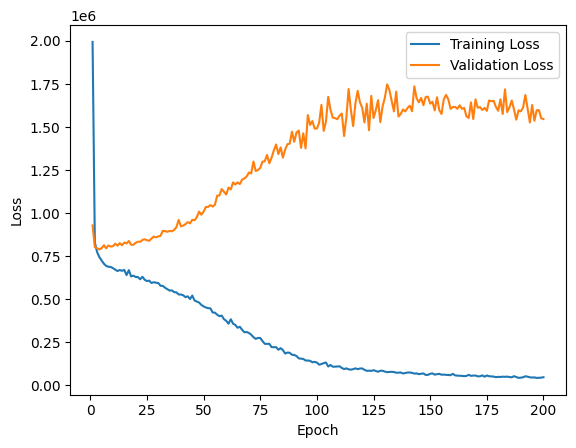


Training for lr=0.01, batch_size=128, hidden_size1=128, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 1872363.462, MAE Loss (Train): 1035.453
Validation Loss: 859681.214, Validation MAE: 652.301
Epoch [2/200], MSE Loss (Train): 842820.451, MAE Loss (Train): 653.181
Validation Loss: 808288.733, Validation MAE: 660.429
Epoch [3/200], MSE Loss (Train): 755292.680, MAE Loss (Train): 626.934
Validation Loss: 793039.180, Validation MAE: 627.934
Epoch [4/200], MSE Loss (Train): 736926.106, MAE Loss (Train): 627.743
Validation Loss: 795550.796, Validation MAE: 648.075
Epoch [5/200], MSE Loss (Train): 734463.880, MAE Loss (Train): 624.851
Validation Loss: 800637.752, Validation MAE: 653.909
Epoch [6/200], MSE Loss (Train): 705366.333, MAE Loss (Train): 615.930
Validation Loss: 805775.118, Validation MAE: 632.253
Epoch [7/200], MSE Loss (Train): 691524.840, MAE Loss (Train): 604.096
Validation Loss: 806369.356, Validation MAE: 617.536
Epoch [8/200], MSE Loss (Train): 696146.413, MAE Loss (T

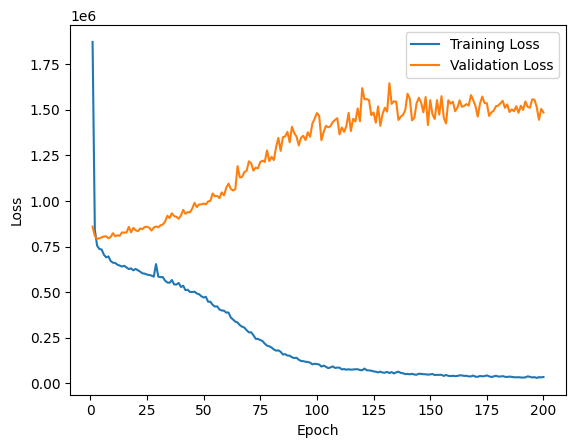


Training for lr=0.01, batch_size=128, hidden_size1=256, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 1970527.646, MAE Loss (Train): 1062.707
Validation Loss: 912984.731, Validation MAE: 706.150
Epoch [2/200], MSE Loss (Train): 824978.127, MAE Loss (Train): 651.869
Validation Loss: 804878.231, Validation MAE: 656.849
Epoch [3/200], MSE Loss (Train): 759779.453, MAE Loss (Train): 627.983
Validation Loss: 793517.719, Validation MAE: 624.863
Epoch [4/200], MSE Loss (Train): 735233.754, MAE Loss (Train): 627.422
Validation Loss: 787149.644, Validation MAE: 626.138
Epoch [5/200], MSE Loss (Train): 720978.746, MAE Loss (Train): 620.257
Validation Loss: 795820.755, Validation MAE: 634.380
Epoch [6/200], MSE Loss (Train): 710740.504, MAE Loss (Train): 620.501
Validation Loss: 806547.700, Validation MAE: 628.573
Epoch [7/200], MSE Loss (Train): 728763.773, MAE Loss (Train): 616.258
Validation Loss: 797524.510, Validation MAE: 650.480
Epoch [8/200], MSE Loss (Train): 687103.635, MAE Loss (Tr

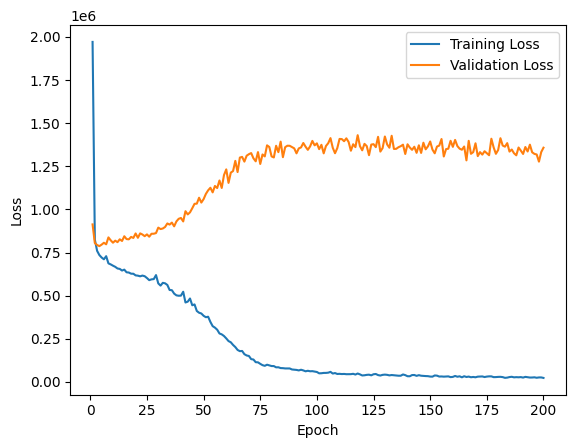


Training for lr=0.01, batch_size=128, hidden_size1=256, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 1875923.188, MAE Loss (Train): 1055.320
Validation Loss: 875000.029, Validation MAE: 681.125
Epoch [2/200], MSE Loss (Train): 817990.395, MAE Loss (Train): 650.619
Validation Loss: 809550.558, Validation MAE: 659.150
Epoch [3/200], MSE Loss (Train): 763617.007, MAE Loss (Train): 635.644
Validation Loss: 789999.587, Validation MAE: 627.681
Epoch [4/200], MSE Loss (Train): 737029.853, MAE Loss (Train): 622.724
Validation Loss: 811324.325, Validation MAE: 609.629
Epoch [5/200], MSE Loss (Train): 721644.126, MAE Loss (Train): 616.857
Validation Loss: 805715.127, Validation MAE: 641.758
Epoch [6/200], MSE Loss (Train): 708402.680, MAE Loss (Train): 613.366
Validation Loss: 812763.880, Validation MAE: 626.603
Epoch [7/200], MSE Loss (Train): 726190.194, MAE Loss (Train): 619.018
Validation Loss: 819400.228, Validation MAE: 644.055
Epoch [8/200], MSE Loss (Train): 686829.125, MAE Loss (Tr

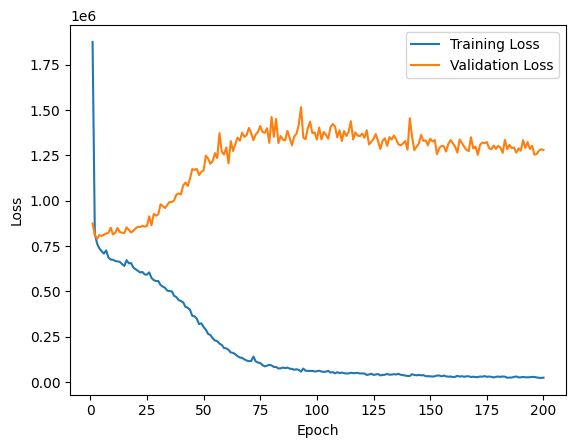


Training for lr=0.01, batch_size=128, hidden_size1=256, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 1663516.315, MAE Loss (Train): 970.429
Validation Loss: 844135.005, Validation MAE: 628.718
Epoch [2/200], MSE Loss (Train): 816302.207, MAE Loss (Train): 656.422
Validation Loss: 809075.442, Validation MAE: 647.809
Epoch [3/200], MSE Loss (Train): 756571.475, MAE Loss (Train): 633.468
Validation Loss: 789897.188, Validation MAE: 623.360
Epoch [4/200], MSE Loss (Train): 739558.329, MAE Loss (Train): 634.201
Validation Loss: 806002.733, Validation MAE: 620.252
Epoch [5/200], MSE Loss (Train): 706119.168, MAE Loss (Train): 609.778
Validation Loss: 810007.240, Validation MAE: 618.335
Epoch [6/200], MSE Loss (Train): 698222.145, MAE Loss (Train): 602.193
Validation Loss: 814852.784, Validation MAE: 646.993
Epoch [7/200], MSE Loss (Train): 684558.034, MAE Loss (Train): 600.888
Validation Loss: 826231.404, Validation MAE: 648.569
Epoch [8/200], MSE Loss (Train): 681670.931, MAE Loss (Tr

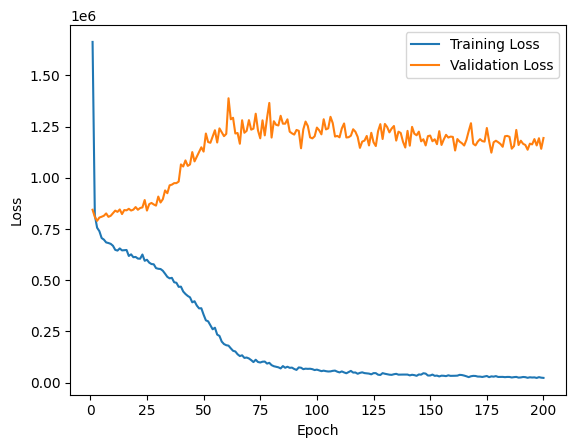


Training for lr=0.1, batch_size=64, hidden_size1=64, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 1297554.208, MAE Loss (Train): 835.250
Validation Loss: 855423.380, Validation MAE: 681.745
Epoch [2/200], MSE Loss (Train): 850392.104, MAE Loss (Train): 680.815
Validation Loss: 909475.252, Validation MAE: 623.312
Epoch [3/200], MSE Loss (Train): 817451.778, MAE Loss (Train): 656.736
Validation Loss: 967015.615, Validation MAE: 780.071
Epoch [4/200], MSE Loss (Train): 755459.093, MAE Loss (Train): 638.164
Validation Loss: 877768.695, Validation MAE: 631.078
Epoch [5/200], MSE Loss (Train): 748528.680, MAE Loss (Train): 625.799
Validation Loss: 848318.716, Validation MAE: 663.735
Epoch [6/200], MSE Loss (Train): 721480.789, MAE Loss (Train): 621.790
Validation Loss: 815459.507, Validation MAE: 610.564
Epoch [7/200], MSE Loss (Train): 727744.511, MAE Loss (Train): 618.265
Validation Loss: 957767.493, Validation MAE: 634.385
Epoch [8/200], MSE Loss (Train): 764201.749, MAE Loss (Train)

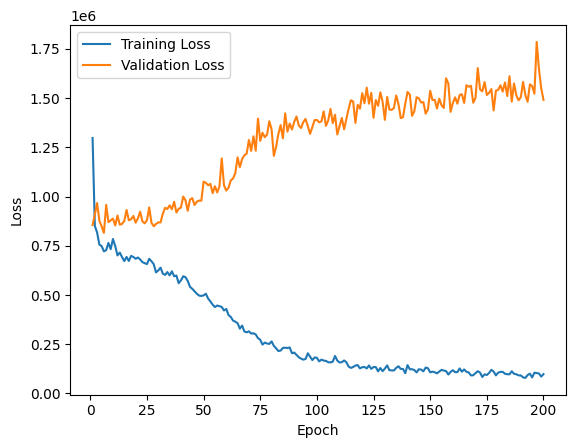


Training for lr=0.1, batch_size=64, hidden_size1=64, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 1415252.652, MAE Loss (Train): 861.865
Validation Loss: 947223.524, Validation MAE: 717.697
Epoch [2/200], MSE Loss (Train): 825763.834, MAE Loss (Train): 653.303
Validation Loss: 870817.918, Validation MAE: 667.997
Epoch [3/200], MSE Loss (Train): 811009.078, MAE Loss (Train): 653.706
Validation Loss: 847307.774, Validation MAE: 628.499
Epoch [4/200], MSE Loss (Train): 773249.502, MAE Loss (Train): 629.264
Validation Loss: 852406.817, Validation MAE: 651.688
Epoch [5/200], MSE Loss (Train): 776715.386, MAE Loss (Train): 642.023
Validation Loss: 849287.683, Validation MAE: 635.543
Epoch [6/200], MSE Loss (Train): 728718.729, MAE Loss (Train): 618.788
Validation Loss: 863090.190, Validation MAE: 643.124
Epoch [7/200], MSE Loss (Train): 758067.960, MAE Loss (Train): 637.408
Validation Loss: 890137.724, Validation MAE: 627.611
Epoch [8/200], MSE Loss (Train): 737946.161, MAE Loss (Train)

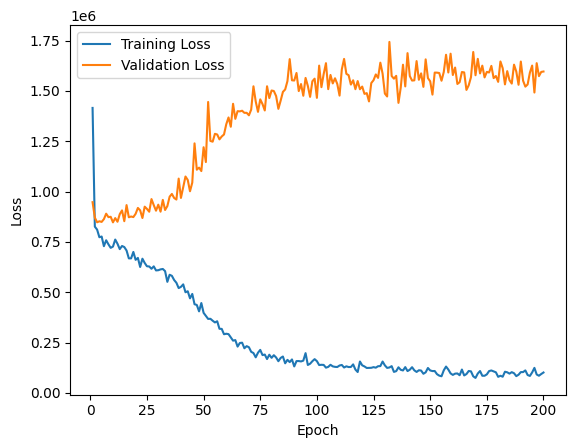


Training for lr=0.1, batch_size=64, hidden_size1=64, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 1253851.652, MAE Loss (Train): 807.776
Validation Loss: 980546.327, Validation MAE: 639.519
Epoch [2/200], MSE Loss (Train): 865522.655, MAE Loss (Train): 673.833
Validation Loss: 967584.635, Validation MAE: 794.200
Epoch [3/200], MSE Loss (Train): 818692.420, MAE Loss (Train): 648.493
Validation Loss: 830556.947, Validation MAE: 668.076
Epoch [4/200], MSE Loss (Train): 762707.221, MAE Loss (Train): 635.351
Validation Loss: 937029.279, Validation MAE: 636.091
Epoch [5/200], MSE Loss (Train): 776947.777, MAE Loss (Train): 635.112
Validation Loss: 860497.207, Validation MAE: 691.047
Epoch [6/200], MSE Loss (Train): 758321.752, MAE Loss (Train): 634.387
Validation Loss: 870377.084, Validation MAE: 639.566
Epoch [7/200], MSE Loss (Train): 720547.515, MAE Loss (Train): 608.540
Validation Loss: 890691.062, Validation MAE: 643.963
Epoch [8/200], MSE Loss (Train): 733658.755, MAE Loss (Train

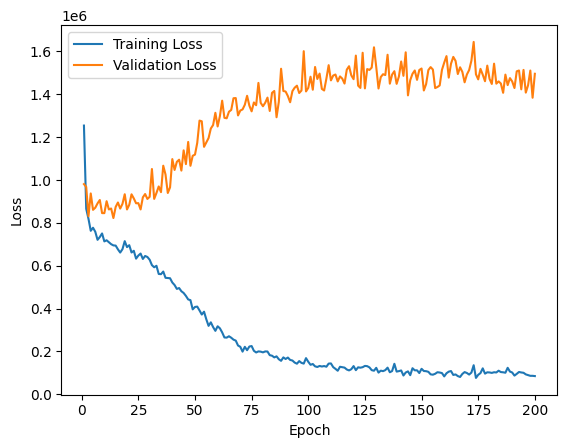


Training for lr=0.1, batch_size=64, hidden_size1=128, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 1522204.572, MAE Loss (Train): 913.371
Validation Loss: 895997.200, Validation MAE: 701.111
Epoch [2/200], MSE Loss (Train): 842959.224, MAE Loss (Train): 652.525
Validation Loss: 920260.820, Validation MAE: 712.209
Epoch [3/200], MSE Loss (Train): 847928.042, MAE Loss (Train): 669.675
Validation Loss: 920800.084, Validation MAE: 620.832
Epoch [4/200], MSE Loss (Train): 792311.934, MAE Loss (Train): 642.439
Validation Loss: 937128.500, Validation MAE: 781.204
Epoch [5/200], MSE Loss (Train): 758069.623, MAE Loss (Train): 636.174
Validation Loss: 847707.769, Validation MAE: 697.739
Epoch [6/200], MSE Loss (Train): 758475.063, MAE Loss (Train): 633.143
Validation Loss: 874079.584, Validation MAE: 651.098
Epoch [7/200], MSE Loss (Train): 736373.169, MAE Loss (Train): 617.451
Validation Loss: 828252.579, Validation MAE: 665.263
Epoch [8/200], MSE Loss (Train): 725337.439, MAE Loss (Train

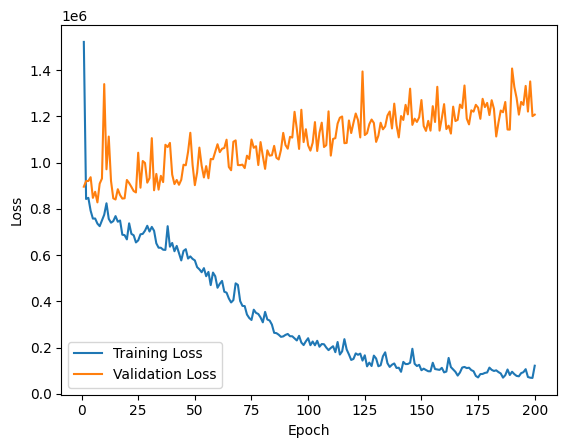


Training for lr=0.1, batch_size=64, hidden_size1=128, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 1388405.992, MAE Loss (Train): 865.182
Validation Loss: 834702.562, Validation MAE: 623.580
Epoch [2/200], MSE Loss (Train): 865894.516, MAE Loss (Train): 675.163
Validation Loss: 951186.505, Validation MAE: 754.399
Epoch [3/200], MSE Loss (Train): 801917.026, MAE Loss (Train): 649.134
Validation Loss: 974980.462, Validation MAE: 787.179
Epoch [4/200], MSE Loss (Train): 823390.091, MAE Loss (Train): 649.859
Validation Loss: 840155.010, Validation MAE: 685.940
Epoch [5/200], MSE Loss (Train): 755029.363, MAE Loss (Train): 622.864
Validation Loss: 1025385.971, Validation MAE: 647.667
Epoch [6/200], MSE Loss (Train): 824209.380, MAE Loss (Train): 661.852
Validation Loss: 903132.647, Validation MAE: 682.531
Epoch [7/200], MSE Loss (Train): 771870.933, MAE Loss (Train): 632.272
Validation Loss: 1089328.500, Validation MAE: 861.438
Epoch [8/200], MSE Loss (Train): 771613.191, MAE Loss (Tra

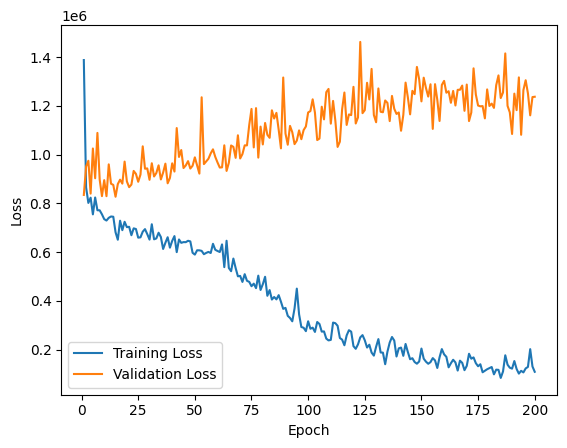


Training for lr=0.1, batch_size=64, hidden_size1=128, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 1499568.478, MAE Loss (Train): 887.845
Validation Loss: 1108744.260, Validation MAE: 682.538
Epoch [2/200], MSE Loss (Train): 910612.614, MAE Loss (Train): 691.016
Validation Loss: 1081475.760, Validation MAE: 674.627
Epoch [3/200], MSE Loss (Train): 842828.944, MAE Loss (Train): 660.603
Validation Loss: 887973.195, Validation MAE: 713.704
Epoch [4/200], MSE Loss (Train): 812740.680, MAE Loss (Train): 646.546
Validation Loss: 939136.127, Validation MAE: 730.856
Epoch [5/200], MSE Loss (Train): 759369.055, MAE Loss (Train): 625.326
Validation Loss: 888213.493, Validation MAE: 709.301
Epoch [6/200], MSE Loss (Train): 812497.099, MAE Loss (Train): 652.832
Validation Loss: 880005.471, Validation MAE: 688.398
Epoch [7/200], MSE Loss (Train): 790973.371, MAE Loss (Train): 644.828
Validation Loss: 881467.906, Validation MAE: 710.614
Epoch [8/200], MSE Loss (Train): 726846.636, MAE Loss (Tr

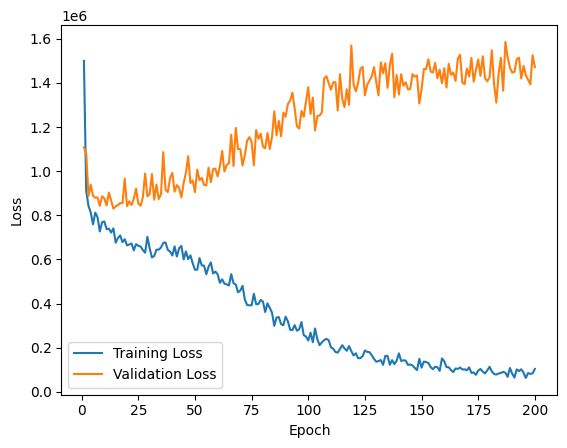


Training for lr=0.1, batch_size=64, hidden_size1=256, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 1353084.628, MAE Loss (Train): 847.296
Validation Loss: 965388.221, Validation MAE: 739.107
Epoch [2/200], MSE Loss (Train): 854282.529, MAE Loss (Train): 677.389
Validation Loss: 903033.325, Validation MAE: 620.131
Epoch [3/200], MSE Loss (Train): 811318.102, MAE Loss (Train): 648.355
Validation Loss: 900993.966, Validation MAE: 749.330
Epoch [4/200], MSE Loss (Train): 849425.108, MAE Loss (Train): 669.837
Validation Loss: 1303191.567, Validation MAE: 977.372
Epoch [5/200], MSE Loss (Train): 805985.325, MAE Loss (Train): 651.209
Validation Loss: 917645.620, Validation MAE: 694.055
Epoch [6/200], MSE Loss (Train): 865218.734, MAE Loss (Train): 676.005
Validation Loss: 1008705.524, Validation MAE: 770.975
Epoch [7/200], MSE Loss (Train): 820809.105, MAE Loss (Train): 647.037
Validation Loss: 922709.014, Validation MAE: 702.327
Epoch [8/200], MSE Loss (Train): 795362.166, MAE Loss (Tra

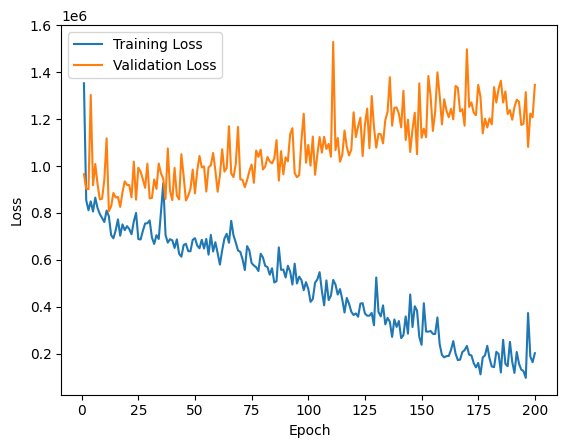


Training for lr=0.1, batch_size=64, hidden_size1=256, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 1608946.077, MAE Loss (Train): 928.951
Validation Loss: 827766.279, Validation MAE: 662.919
Epoch [2/200], MSE Loss (Train): 887746.376, MAE Loss (Train): 672.264
Validation Loss: 911397.880, Validation MAE: 653.558
Epoch [3/200], MSE Loss (Train): 854786.119, MAE Loss (Train): 667.642
Validation Loss: 929584.228, Validation MAE: 628.818
Epoch [4/200], MSE Loss (Train): 824715.541, MAE Loss (Train): 658.801
Validation Loss: 1037139.087, Validation MAE: 813.503
Epoch [5/200], MSE Loss (Train): 791856.109, MAE Loss (Train): 662.341
Validation Loss: 987652.207, Validation MAE: 763.937
Epoch [6/200], MSE Loss (Train): 835957.199, MAE Loss (Train): 662.936
Validation Loss: 832602.897, Validation MAE: 654.557
Epoch [7/200], MSE Loss (Train): 755238.743, MAE Loss (Train): 622.710
Validation Loss: 871773.147, Validation MAE: 674.006
Epoch [8/200], MSE Loss (Train): 743221.970, MAE Loss (Trai

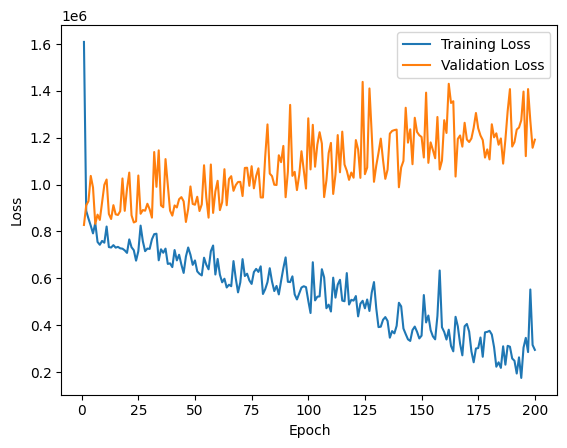


Training for lr=0.1, batch_size=64, hidden_size1=256, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 1783756.459, MAE Loss (Train): 965.058
Validation Loss: 889042.219, Validation MAE: 655.532
Epoch [2/200], MSE Loss (Train): 918382.714, MAE Loss (Train): 681.867
Validation Loss: 963632.053, Validation MAE: 713.826
Epoch [3/200], MSE Loss (Train): 873240.069, MAE Loss (Train): 672.364
Validation Loss: 877349.464, Validation MAE: 616.997
Epoch [4/200], MSE Loss (Train): 810730.462, MAE Loss (Train): 656.028
Validation Loss: 848776.483, Validation MAE: 626.605
Epoch [5/200], MSE Loss (Train): 863179.235, MAE Loss (Train): 663.953
Validation Loss: 1153491.279, Validation MAE: 707.343
Epoch [6/200], MSE Loss (Train): 806718.047, MAE Loss (Train): 649.343
Validation Loss: 828827.591, Validation MAE: 628.133
Epoch [7/200], MSE Loss (Train): 836678.967, MAE Loss (Train): 649.334
Validation Loss: 876430.168, Validation MAE: 678.950
Epoch [8/200], MSE Loss (Train): 737035.622, MAE Loss (Tra

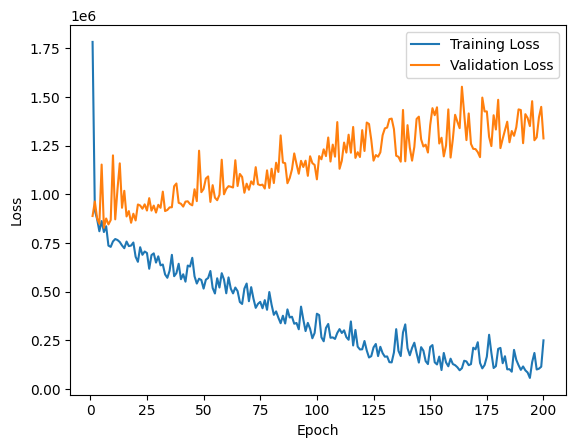


Training for lr=0.1, batch_size=128, hidden_size1=64, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 1310687.790, MAE Loss (Train): 831.021
Validation Loss: 825623.913, Validation MAE: 664.044
Epoch [2/200], MSE Loss (Train): 831256.967, MAE Loss (Train): 657.718
Validation Loss: 862429.983, Validation MAE: 697.840
Epoch [3/200], MSE Loss (Train): 774396.136, MAE Loss (Train): 642.587
Validation Loss: 833676.837, Validation MAE: 634.608
Epoch [4/200], MSE Loss (Train): 802642.989, MAE Loss (Train): 641.989
Validation Loss: 863464.466, Validation MAE: 677.375
Epoch [5/200], MSE Loss (Train): 797893.343, MAE Loss (Train): 654.956
Validation Loss: 952093.591, Validation MAE: 768.507
Epoch [6/200], MSE Loss (Train): 769444.765, MAE Loss (Train): 623.810
Validation Loss: 846274.346, Validation MAE: 697.824
Epoch [7/200], MSE Loss (Train): 748025.583, MAE Loss (Train): 633.255
Validation Loss: 841052.594, Validation MAE: 667.410
Epoch [8/200], MSE Loss (Train): 759424.012, MAE Loss (Train

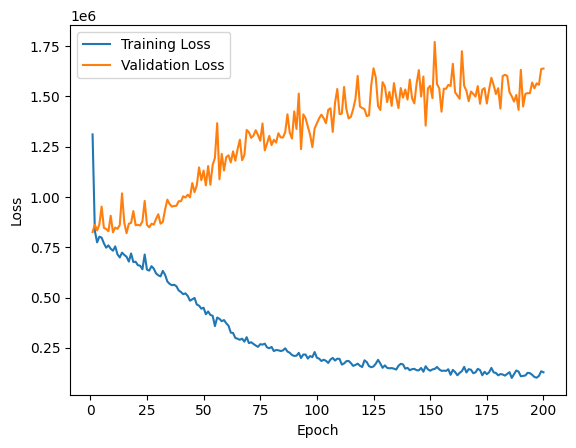


Training for lr=0.1, batch_size=128, hidden_size1=64, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 1218283.597, MAE Loss (Train): 813.888
Validation Loss: 880041.202, Validation MAE: 656.551
Epoch [2/200], MSE Loss (Train): 820270.637, MAE Loss (Train): 653.739
Validation Loss: 864948.200, Validation MAE: 660.798
Epoch [3/200], MSE Loss (Train): 811739.131, MAE Loss (Train): 657.289
Validation Loss: 982190.130, Validation MAE: 787.982
Epoch [4/200], MSE Loss (Train): 813435.962, MAE Loss (Train): 655.076
Validation Loss: 895472.925, Validation MAE: 632.502
Epoch [5/200], MSE Loss (Train): 766493.776, MAE Loss (Train): 632.142
Validation Loss: 842906.589, Validation MAE: 628.729
Epoch [6/200], MSE Loss (Train): 772412.279, MAE Loss (Train): 631.538
Validation Loss: 908588.019, Validation MAE: 620.465
Epoch [7/200], MSE Loss (Train): 761626.043, MAE Loss (Train): 645.099
Validation Loss: 898054.971, Validation MAE: 635.640
Epoch [8/200], MSE Loss (Train): 783638.760, MAE Loss (Train

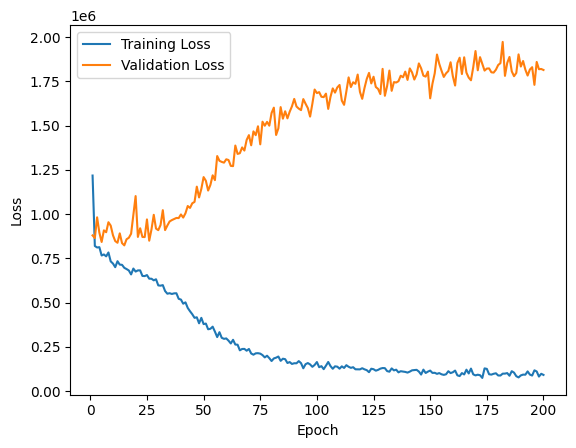


Training for lr=0.1, batch_size=128, hidden_size1=64, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 1272216.849, MAE Loss (Train): 819.830
Validation Loss: 925880.596, Validation MAE: 687.698
Epoch [2/200], MSE Loss (Train): 859254.961, MAE Loss (Train): 667.025
Validation Loss: 874154.947, Validation MAE: 665.389
Epoch [3/200], MSE Loss (Train): 818572.477, MAE Loss (Train): 658.422
Validation Loss: 886695.454, Validation MAE: 689.825
Epoch [4/200], MSE Loss (Train): 785806.921, MAE Loss (Train): 655.866
Validation Loss: 873497.452, Validation MAE: 665.826
Epoch [5/200], MSE Loss (Train): 783485.480, MAE Loss (Train): 644.596
Validation Loss: 895571.079, Validation MAE: 698.990
Epoch [6/200], MSE Loss (Train): 768975.695, MAE Loss (Train): 637.761
Validation Loss: 932621.325, Validation MAE: 645.319
Epoch [7/200], MSE Loss (Train): 765446.418, MAE Loss (Train): 641.610
Validation Loss: 861529.082, Validation MAE: 688.246
Epoch [8/200], MSE Loss (Train): 730301.962, MAE Loss (Trai

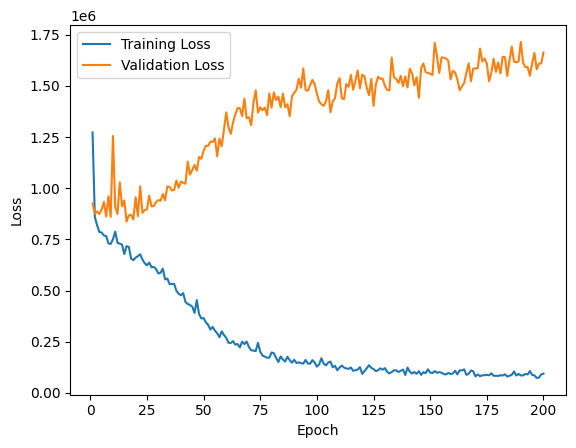


Training for lr=0.1, batch_size=128, hidden_size1=128, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 1376660.844, MAE Loss (Train): 858.614
Validation Loss: 888501.245, Validation MAE: 671.022
Epoch [2/200], MSE Loss (Train): 850552.371, MAE Loss (Train): 663.828
Validation Loss: 846513.788, Validation MAE: 621.532
Epoch [3/200], MSE Loss (Train): 772834.776, MAE Loss (Train): 643.200
Validation Loss: 836884.038, Validation MAE: 651.979
Epoch [4/200], MSE Loss (Train): 788604.864, MAE Loss (Train): 639.972
Validation Loss: 965382.284, Validation MAE: 777.262
Epoch [5/200], MSE Loss (Train): 778111.219, MAE Loss (Train): 646.304
Validation Loss: 831285.320, Validation MAE: 669.976
Epoch [6/200], MSE Loss (Train): 742217.443, MAE Loss (Train): 622.615
Validation Loss: 859348.899, Validation MAE: 660.817
Epoch [7/200], MSE Loss (Train): 746953.730, MAE Loss (Train): 634.558
Validation Loss: 865082.505, Validation MAE: 660.373
Epoch [8/200], MSE Loss (Train): 762939.570, MAE Loss (Trai

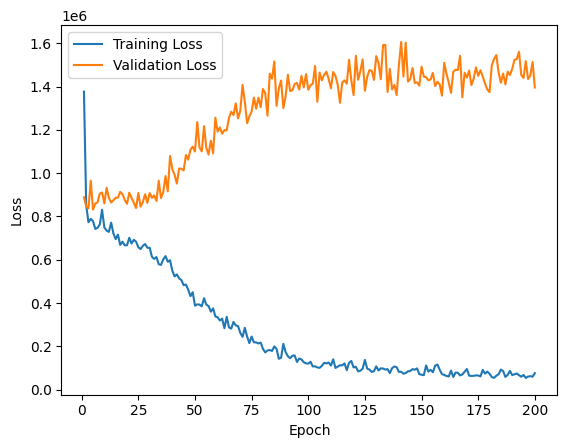


Training for lr=0.1, batch_size=128, hidden_size1=128, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 1613668.810, MAE Loss (Train): 927.739
Validation Loss: 873070.226, Validation MAE: 660.754
Epoch [2/200], MSE Loss (Train): 883849.208, MAE Loss (Train): 679.208
Validation Loss: 938857.120, Validation MAE: 741.008
Epoch [3/200], MSE Loss (Train): 790197.137, MAE Loss (Train): 645.518
Validation Loss: 875026.442, Validation MAE: 732.435
Epoch [4/200], MSE Loss (Train): 892381.151, MAE Loss (Train): 679.201
Validation Loss: 922082.808, Validation MAE: 757.614
Epoch [5/200], MSE Loss (Train): 814936.878, MAE Loss (Train): 647.016
Validation Loss: 994828.207, Validation MAE: 672.637
Epoch [6/200], MSE Loss (Train): 805878.323, MAE Loss (Train): 646.847
Validation Loss: 830977.536, Validation MAE: 641.905
Epoch [7/200], MSE Loss (Train): 770616.210, MAE Loss (Train): 636.185
Validation Loss: 1057048.630, Validation MAE: 839.692
Epoch [8/200], MSE Loss (Train): 794482.086, MAE Loss (Tra

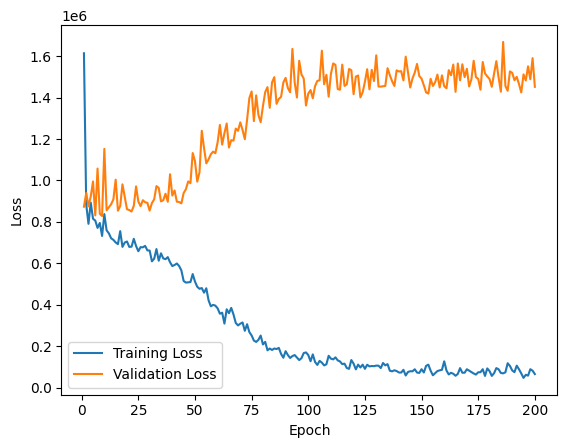


Training for lr=0.1, batch_size=128, hidden_size1=128, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 1189151.793, MAE Loss (Train): 786.407
Validation Loss: 969105.846, Validation MAE: 717.797
Epoch [2/200], MSE Loss (Train): 892235.476, MAE Loss (Train): 689.468
Validation Loss: 923086.173, Validation MAE: 714.153
Epoch [3/200], MSE Loss (Train): 834617.272, MAE Loss (Train): 673.170
Validation Loss: 848494.837, Validation MAE: 642.847
Epoch [4/200], MSE Loss (Train): 885432.247, MAE Loss (Train): 687.571
Validation Loss: 921927.716, Validation MAE: 631.062
Epoch [5/200], MSE Loss (Train): 839261.606, MAE Loss (Train): 668.215
Validation Loss: 925519.142, Validation MAE: 648.766
Epoch [6/200], MSE Loss (Train): 789412.063, MAE Loss (Train): 639.052
Validation Loss: 866004.925, Validation MAE: 658.354
Epoch [7/200], MSE Loss (Train): 774448.430, MAE Loss (Train): 634.496
Validation Loss: 875305.776, Validation MAE: 639.221
Epoch [8/200], MSE Loss (Train): 757128.071, MAE Loss (Tra

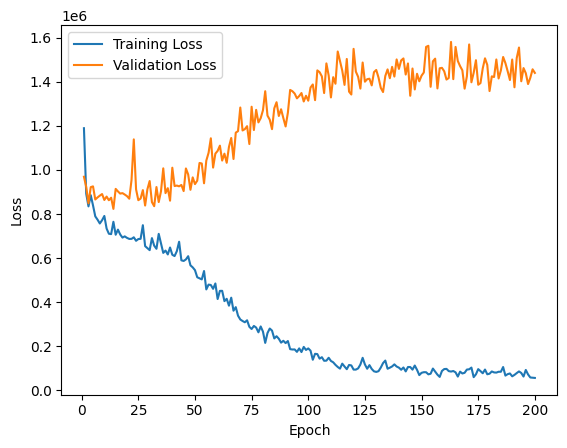


Training for lr=0.1, batch_size=128, hidden_size1=256, hidden_size2=32
Epoch [1/200], MSE Loss (Train): 1347488.392, MAE Loss (Train): 848.048
Validation Loss: 987452.106, Validation MAE: 763.533
Epoch [2/200], MSE Loss (Train): 837718.097, MAE Loss (Train): 670.053
Validation Loss: 919969.216, Validation MAE: 673.149
Epoch [3/200], MSE Loss (Train): 823382.560, MAE Loss (Train): 661.983
Validation Loss: 1005086.034, Validation MAE: 639.921
Epoch [4/200], MSE Loss (Train): 817882.017, MAE Loss (Train): 644.532
Validation Loss: 833228.356, Validation MAE: 631.148
Epoch [5/200], MSE Loss (Train): 766216.186, MAE Loss (Train): 644.311
Validation Loss: 830953.438, Validation MAE: 651.163
Epoch [6/200], MSE Loss (Train): 794027.749, MAE Loss (Train): 649.980
Validation Loss: 846120.043, Validation MAE: 687.319
Epoch [7/200], MSE Loss (Train): 833653.267, MAE Loss (Train): 649.440
Validation Loss: 963582.351, Validation MAE: 762.413
Epoch [8/200], MSE Loss (Train): 761188.589, MAE Loss (Tra

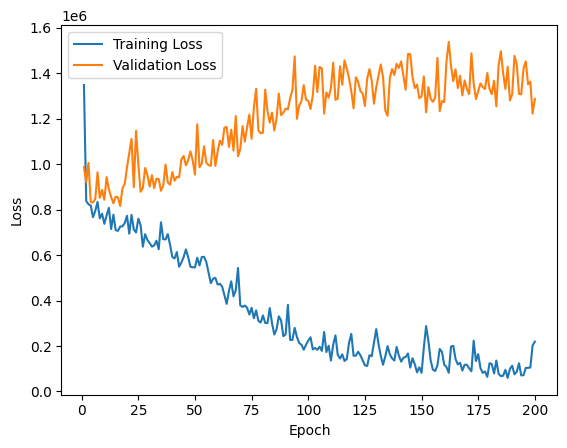


Training for lr=0.1, batch_size=128, hidden_size1=256, hidden_size2=64
Epoch [1/200], MSE Loss (Train): 1462918.208, MAE Loss (Train): 865.802
Validation Loss: 945360.236, Validation MAE: 721.082
Epoch [2/200], MSE Loss (Train): 931624.939, MAE Loss (Train): 699.799
Validation Loss: 931507.442, Validation MAE: 710.085
Epoch [3/200], MSE Loss (Train): 998841.053, MAE Loss (Train): 722.913
Validation Loss: 906935.096, Validation MAE: 694.402
Epoch [4/200], MSE Loss (Train): 881892.070, MAE Loss (Train): 685.375
Validation Loss: 861004.812, Validation MAE: 689.417
Epoch [5/200], MSE Loss (Train): 813033.175, MAE Loss (Train): 664.586
Validation Loss: 864415.690, Validation MAE: 627.952
Epoch [6/200], MSE Loss (Train): 772305.295, MAE Loss (Train): 632.032
Validation Loss: 900828.808, Validation MAE: 727.807
Epoch [7/200], MSE Loss (Train): 746917.951, MAE Loss (Train): 630.859
Validation Loss: 856461.702, Validation MAE: 668.859
Epoch [8/200], MSE Loss (Train): 726988.791, MAE Loss (Trai

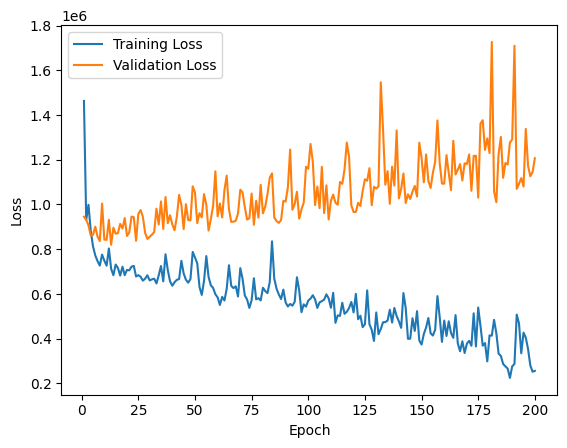


Training for lr=0.1, batch_size=128, hidden_size1=256, hidden_size2=128
Epoch [1/200], MSE Loss (Train): 1658815.454, MAE Loss (Train): 920.759
Validation Loss: 1553910.788, Validation MAE: 1050.713
Epoch [2/200], MSE Loss (Train): 1028609.771, MAE Loss (Train): 738.077
Validation Loss: 852144.046, Validation MAE: 639.253
Epoch [3/200], MSE Loss (Train): 869208.566, MAE Loss (Train): 681.015
Validation Loss: 843005.387, Validation MAE: 614.719
Epoch [4/200], MSE Loss (Train): 815191.525, MAE Loss (Train): 647.148
Validation Loss: 875899.815, Validation MAE: 686.670
Epoch [5/200], MSE Loss (Train): 810906.232, MAE Loss (Train): 658.010
Validation Loss: 1152906.490, Validation MAE: 717.415
Epoch [6/200], MSE Loss (Train): 863520.281, MAE Loss (Train): 682.289
Validation Loss: 903509.476, Validation MAE: 713.305
Epoch [7/200], MSE Loss (Train): 775082.508, MAE Loss (Train): 635.372
Validation Loss: 953695.365, Validation MAE: 729.378
Epoch [8/200], MSE Loss (Train): 867441.889, MAE Loss 

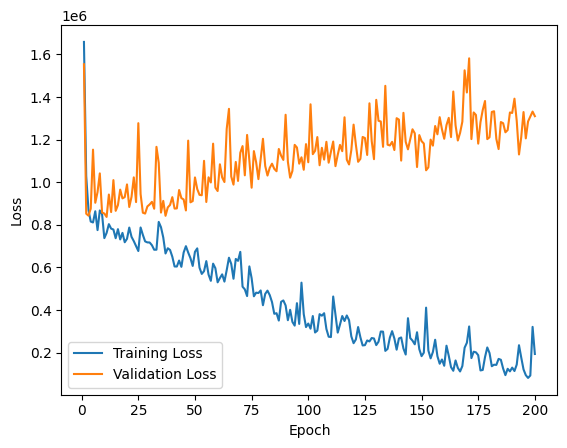


Best Model Information:
Input Size: 58
Hidden Size 1: 64
Hidden Size 2: 32
Output Size: 1
Learning Rate: 0.001
Epochs: 200
Batch Size: 64
Best Validation Loss: 838168.526


In [ ]:
# Hyperparameters for grid search
learning_rates = [0.001, 0.01, 0.1]
batch_sizes = [64, 128]
hidden_sizes1 = [64, 128, 256]
hidden_sizes2 = [32, 64, 128]
epochs = 200

# Perform grid search using the dataset without outliers
best_model, best_model_info = grid_search(train_loader, test_loader,
                                          input_size=X_train.shape[1],
                                          output_size=1,
                                          learning_rates=learning_rates,
                                          batch_sizes=batch_sizes,
                                          hidden_sizes1=hidden_sizes1,
                                          hidden_sizes2=hidden_sizes2,
                                          epochs=epochs)

#### Saving the Trained Model

In [ ]:
# Save the best model's state_dict to Google Drive
model_save_path_drive = '/content/gdrive/My Drive/Colab Notebooks/IP_MSC/UCI_code/best_model.pth'
best_model_path = '/content/best_model.pth'
!cp "$best_model_path" "$model_save_path_drive"

# Save the best model info to Google Drive
model_info_save_path_drive = '/content/gdrive/My Drive/Colab Notebooks/IP_MSC/UCI_code/best_model_info.json'
with open(model_info_save_path_drive, 'w') as json_file:
    json.dump(best_model_info, json_file)

In [ ]:
# hyperparameters for best model
input_size = X_train.shape[1]  # Number of input features
hidden_size1 = 64
hidden_size2 = 32
output_size = 1  # For regression
epochs = 200
batch_size = 64
learning_rate = 0.001

Epoch [1/200], MSE Loss (Train): 3174354.226, MAE Loss (Train): 1517.176
Validation Loss: 3114516.423, Validation MAE: 1493.488
Epoch [2/200], MSE Loss (Train): 3178529.286, MAE Loss (Train): 1512.437
Validation Loss: 3068353.615, Validation MAE: 1478.828
Epoch [3/200], MSE Loss (Train): 3148573.548, MAE Loss (Train): 1497.960
Validation Loss: 2990330.519, Validation MAE: 1453.870
Epoch [4/200], MSE Loss (Train): 2988686.971, MAE Loss (Train): 1456.419
Validation Loss: 2871885.058, Validation MAE: 1415.488
Epoch [5/200], MSE Loss (Train): 2815685.082, MAE Loss (Train): 1401.338
Validation Loss: 2709888.010, Validation MAE: 1360.898
Epoch [6/200], MSE Loss (Train): 2665989.870, MAE Loss (Train): 1345.360
Validation Loss: 2503088.913, Validation MAE: 1287.093
Epoch [7/200], MSE Loss (Train): 2456362.144, MAE Loss (Train): 1267.118
Validation Loss: 2257235.375, Validation MAE: 1192.230
Epoch [8/200], MSE Loss (Train): 2185945.791, MAE Loss (Train): 1154.485
Validation Loss: 1981624.673, V

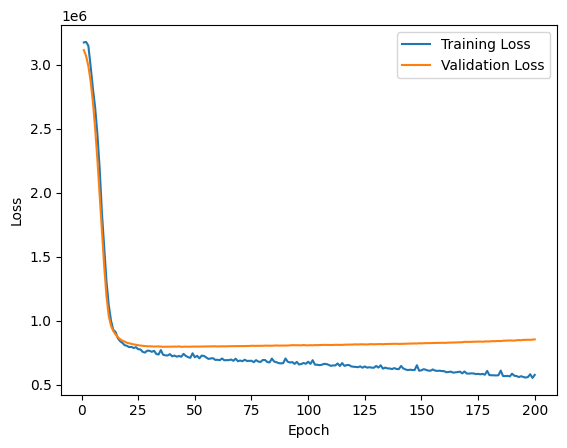

In [ ]:
# Call train_and_validate function to show the training of the best model
# This is not being used for anything else but just for visualisation
trained_model_b, training_losses_b, validation_losses_b = OG_train_and_validate(
    train_loader, test_loader, input_size, hidden_size1, hidden_size2,
    output_size,learning_rate=learning_rate, epochs=epochs
    )

## **Load the Trained Model**

In this section, we are going to load the trained model and review quickly the number of parameters and the structure of it.

In [ ]:
# hyperparameters for best model
input_size = 58  # Number of input features
hidden_size1 = 64
hidden_size2 = 32
output_size = 1  # For regression
epochs = 200
batch_size = 64
learning_rate = 0.001

In [ ]:
#Load the saved model from google drive
model = RegressionNN(input_size,hidden_size1, hidden_size2, output_size)
model_path = '/content/gdrive/My Drive/Colab Notebooks/IP_MSC/UCI_code/best_model.pth'
model.load_state_dict(torch.load(model_path, map_location=torch.device('cpu')))
model = model.to(device)

In [ ]:
# Apply training mode before applying pruning on the loaded model
#model.train()

In [ ]:
# Put the model in evaluation mode
#model.eval()

In [ ]:
#function to obtain the model size
# reference: https://discuss.pytorch.org/t/how-do-i-check-the-number-of-parameters-of-a-model/4325
# https://wandb.ai/wandb_fc/tips/reports/How-To-Calculate-Number-of-Model-Parameters-for-PyTorch-and-TensorFlow-Models--VmlldzoyMDYyNzIx
model_size = sum(p.numel() for p in model.parameters())
print(f"Loaded model size: {model_size} parameters")

Loaded model size: 5889 parameters


The funcation, `check_model_stats`, below takes in a neural network model as input. It checks the sparsity of specific layers within the model, calculating the ratio of zero-valued weights to the total number of weights in each parameter tensor. The function then prints the layer name, parameter name, sparsity value, shape, and original weights of the parameter tensor. This information helps assess the impact of pruning techniques on the model's parameters, particularly regarding the sparsity introduced after pruning.

In [ ]:
# defining a function to check model stats for the orignal and pruned model
def check_model_stats(model):
    # Define global variables for parameters to check
    parameters_to_check = [
        (model.fc1, 'weight'),
        (model.fc2, 'weight'),
        (model.fc3, 'weight'),
    ]

    # Print sparsity and other information
    print("Stats for each parameter:")
    for layer, parameter_name in parameters_to_check:
        parameter_tensor = getattr(layer, parameter_name)
        sparsity_value = torch.sum(parameter_tensor == 0).item() / parameter_tensor.numel()
        print(f"{layer.__class__.__name__}.{parameter_name}:")
        print(f"Sparsity: {sparsity_value:.4f}")
        print(f"Shape: {parameter_tensor.shape}")
        print(f"Original weights:")
        print(parameter_tensor)

In [ ]:
check_model_stats(model)

Stats for each parameter:
Linear.weight:
Sparsity: 0.0000
Shape: torch.Size([64, 58])
Original weights:
Parameter containing:
tensor([[-0.4623, -1.4513, -0.1083,  ...,  0.5385, -1.0113,  0.5448],
        [ 0.0832, -0.6250,  0.1954,  ..., -0.1716,  0.7286, -0.1230],
        [ 0.7247, -0.3441, -0.0198,  ...,  0.6236,  0.0607, -0.7370],
        ...,
        [ 0.6667, -0.3285, -0.3212,  ...,  0.4501, -0.3074,  0.1716],
        [-0.6382, -0.2043, -0.3533,  ..., -0.0639,  0.0771, -0.2206],
        [-0.3420, -0.9293,  0.2964,  ..., -0.7866,  0.0976,  0.1062]],
       requires_grad=True)
Linear.weight:
Sparsity: 0.0000
Shape: torch.Size([32, 64])
Original weights:
Parameter containing:
tensor([[ 0.6506,  0.7662,  0.5039,  ...,  0.6258,  0.4528,  0.8071],
        [ 0.1401,  0.0132,  0.5062,  ..., -0.8437, -0.9521, -0.3691],
        [ 0.7029,  0.8594,  0.5707,  ...,  0.5445,  0.4280,  0.8980],
        ...,
        [ 1.0074,  0.8817,  0.6774,  ...,  0.7059,  1.0361,  0.7647],
        [ 0.3813,  0

The function `get_zero_nonzero_values` analyzes the distribution of zero and non-zero values in the weight parameters of a neural network model. It extracts these values and updates counters, then prints the shape of each weight parameter and additional statistics such as minimum, maximum, mean, and standard deviation if there are non-zero values. Finally, the function prints the counts of zero and non-zero values and returns the lists containing these values.

In [ ]:
def get_zero_nonzero_values(model, epsilon=1e-8):
    zero_values = []
    nonzero_values = []

    zero_count = 0
    nonzero_count = 0

    for name, param in model.named_parameters():
        if 'weight' in name:  # Assuming you are interested in pruning weights
            # Convert the parameter tensor to a flat 1D tensor
            flat_param = param.flatten()

            # Use boolean masks to identify zero and non-zero values
            zero_mask = (torch.abs(flat_param) <= epsilon)
            nonzero_mask = ~zero_mask

            # Extract zero and non-zero values using boolean masks
            zero_values.extend(flat_param[zero_mask].tolist())
            nonzero_values.extend(flat_param[nonzero_mask].tolist())

            # Update counts
            zero_count += torch.sum(zero_mask).item()
            nonzero_count += torch.sum(nonzero_mask).item()

            # Print shape of the parameter tensor
            print(f"Parameter '{name}' Shape: {param.shape}")

            # Print additional information about non-zero values
            if torch.sum(nonzero_mask).item() > 0:
                print(f"Non-Zero Values ({name}):")
                print(f"  Min: {torch.min(flat_param[nonzero_mask]).item()}")
                print(f"  Max: {torch.max(flat_param[nonzero_mask]).item()}")
                print(f"  Mean: {torch.mean(flat_param[nonzero_mask]).item()}")
                print(f"  Std: {torch.std(flat_param[nonzero_mask]).item()}\n")

    print("\nCount of Zero Values:", zero_count)
    print("Count of Non-Zero Values:", nonzero_count)

    return zero_values, nonzero_values

In [ ]:
zero_values, nonzero_values = get_zero_nonzero_values(model)

Parameter 'fc1.weight' Shape: torch.Size([64, 58])
Non-Zero Values (fc1.weight):
  Min: -1.9868459701538086
  Max: 1.4423608779907227
  Mean: -0.017724253237247467
  Std: 0.4777468144893646

Parameter 'fc2.weight' Shape: torch.Size([32, 64])
Non-Zero Values (fc2.weight):
  Min: -2.3781912326812744
  Max: 1.7246243953704834
  Mean: 0.39340415596961975
  Std: 0.6035931706428528

Parameter 'fc3.weight' Shape: torch.Size([1, 32])
Non-Zero Values (fc3.weight):
  Min: -5.795782089233398
  Max: 2.9795875549316406
  Mean: -0.5373982191085815
  Std: 2.5314862728118896


Count of Zero Values: 0
Count of Non-Zero Values: 5792


## Pruning of the Trained Feedforward Neural Network

In this section, we are going to apply pruning on the already trained model and see how it affects the model when pruning is applied at different thresholds.

References used:

https://towardsdatascience.com/how-to-prune-neural-networks-with-pytorch-ebef60316b91

### Global Sparsity Function

The sparsity function calculates a PyTorch model's global sparsity by dividing the number of zero-valued parameters by the total number of parameters.

Here's a step-by-step explanation of the code:
1. **a, b = 0., 0.** - Set variables 'a' and 'b' to zero. Use 'a' to count total parameters and 'b' to count zero-valued parameters.
2. **for p in model.parameters()** - Iterating over the parameters of the provided model, which are the learnable weights and biases of its layers.
3. **a += p.numel()** - To add the number of elements in the parameter tensor 'p' to the variable 'a', use the numel() function.
4. **b += (p == 0).sum() ** - To count the number of zeros in a tensor called "p", use "p == 0" to create a binary tensor and then use the "sum()" function to count the True values. Add the result to the variable "b".
5. **return b / a** - Calculate the ratio of zero-valued parameters to the total number of parameters to determine the global sparsity of the model.

Code obtained for the global sparity function:
https://github.com/WongKinYiu/yolov7/blob/main/utils/torch_utils.py

Martin, M. Local and global processing: The role of sparsity. Memory & Cognition 7, 476–484 (1979). https://doi.org/10.3758/BF03198264

In [ ]:
# Code obtained from
# https://github.com/WongKinYiu/yolov7/blob/main/utils/torch_utils.py
def sparsity(model):
    # Return global model sparsity
    a, b = 0., 0.
    for p in model.parameters():
        a += p.numel()
        b += (p == 0).sum()
    return b / a

### Local Pruning of the Trained Model

This code below defines a local pruning function for a PyTorch neural network model. The function reduces the sparsity of the model by removing smaller connections.

It calculates the threshold for pruning and generates a binary mask to indicate which weights should be pruned. The actual pruning is performed using PyTorch's `prune.custom_from_mask` method, which applies the generated mask to the weights of the linear layer.  This mask is applied to the weights of the linear layer and the pruned model is saved.

Finally, the function prints the global sparsity of the pruned model and its new size.

Reference:
https://pytorch.org/docs/stable/generated/torch.nn.utils.prune.custom_from_mask.html

In [ ]:
# defining the local pruning function
def apply_local_prune(model,input_size, hidden_size1, hidden_size2,
                output_size, pruning_amount):
    # Create a new instance of the model
    pruned_model = RegressionNN(input_size, hidden_size1,
                                hidden_size2, output_size)

    # Load the parameters from the original model
    relevant_state_dict = {key: value for key, value in model.state_dict().items() if key in pruned_model.state_dict()}
    pruned_model.load_state_dict(model.state_dict())

    for name, module in pruned_model.named_children():
        if isinstance(module, nn.Linear):
            # Calculate the threshold for pruning based on the pruning amount
             # reference: https://stackoverflow.com/questions/61269052/remove-smallest-p-numbers-from-multiple-numpy-arrays
            threshold = np.percentile(np.abs(module.weight.cpu().detach().numpy()),
                                      100 * pruning_amount)

            # Generate a custom mask based on the threshold
            # Referemce: https://stackoverflow.com/questions/61629395/how-to-prune-weights-less-than-a-threshold-in-pytorch
            custom_mask = torch.abs(module.weight) > threshold
            custom_mask = custom_mask.to(torch.float32)

            # Apply pruning using the custom mask
            prune.custom_from_mask(module, name='weight', mask=custom_mask)

            # Calculate sparsity for this layer
            sparsity = torch.sum(custom_mask == 0).item() / custom_mask.numel()
            print(f"Sparsity in {name}: {sparsity:.2%}")

    # Save the pruned model with the pruning amount in the name
    pruning_amount_int = int(pruning_amount * 100)
    pruned_model_name = f'pruned_local_{pruning_amount_int}.pth'
    torch.save(pruned_model.state_dict(), pruned_model_name)

    return pruned_model


The function `compare_weights` compares weight matrices between an original model and a pruned model in the neural network. It iterates through the layers, ensuring that each linear layer's weight matrices match and prints a message if they don't.

In [ ]:
# comparing the weights of the trained and pruned model
def compare_weights(original_model, pruned_model):
    print("Comparing weights between original and pruned models:")

    # Iterate through the layers of the models
    for original_layer, pruned_layer in zip(original_model.children(), pruned_model.children()):
        if isinstance(original_layer, nn.Linear):
            original_weights = original_layer.weight.cpu().detach().numpy()
            pruned_weights = pruned_layer.weight.cpu().detach().numpy()

            # Check the shape of the weight matrices match
            assert original_weights.shape == pruned_weights.shape, "Shape mismatch in weight matrices"

            # Check the pruned weights are different from the original weights
            if not np.array_equal(original_weights, pruned_weights):
                layer_name = original_layer.__class__.__name__
                print(f"Weights in {layer_name} layer are different.")

**Pruning Amount 0.6**

In [ ]:
# Apply local pruning for pruning amount 0.5
pruning_amount = 0.6
pruned_local1 = apply_local_prune(model, input_size, hidden_size1,
                                  hidden_size2, output_size, pruning_amount)



# Compare the weights of the loaded and pruned model
compare_weights(model, pruned_local1)

Sparsity in fc1: 59.99%
Sparsity in fc2: 60.01%
Sparsity in fc3: 59.38%
Comparing weights between original and pruned models:
Weights in Linear layer are different.
Weights in Linear layer are different.
Weights in Linear layer are different.


**Pruning Amount 0.7**

In [ ]:
# Apply local pruning for pruning amount 0.7
pruning_amount = 0.7
pruned_local2 = apply_local_prune(model, input_size, hidden_size1,
                                  hidden_size2, output_size, pruning_amount)

# Compare the weights of the loaded and pruned model
compare_weights(model, pruned_local2)

Sparsity in fc1: 69.99%
Sparsity in fc2: 69.97%
Sparsity in fc3: 68.75%
Comparing weights between original and pruned models:
Weights in Linear layer are different.
Weights in Linear layer are different.
Weights in Linear layer are different.


**Pruning Amount 0.8**

In [ ]:
# Apply local pruning for pruning amount 0.8
pruning_amount = 0.8
pruned_local3 = apply_local_prune(model, input_size, hidden_size1,
                                  hidden_size2, output_size, pruning_amount)

# Compare the weights of the loaded and pruned model
compare_weights(model, pruned_local3)

Sparsity in fc1: 79.98%
Sparsity in fc2: 79.98%
Sparsity in fc3: 78.12%
Comparing weights between original and pruned models:
Weights in Linear layer are different.
Weights in Linear layer are different.
Weights in Linear layer are different.


**Pruning Amount 0.9**

In [ ]:
# Apply local pruning for pruning amount 0.9
pruning_amount = 0.9
pruned_local4 = apply_local_prune(model, input_size, hidden_size1,
                                  hidden_size2, output_size, pruning_amount)

# Compare the weights of the loaded and pruned model
compare_weights(model, pruned_local4)

Sparsity in fc1: 89.98%
Sparsity in fc2: 89.99%
Sparsity in fc3: 87.50%
Comparing weights between original and pruned models:
Weights in Linear layer are different.
Weights in Linear layer are different.
Weights in Linear layer are different.


In [ ]:
# Apply local pruning for pruning amount 0.8
pruning_amount = 0.95
pruned_local5 = apply_local_prune(model, input_size, hidden_size1,
                                  hidden_size2, output_size, pruning_amount)

# Compare the weights of the loaded and pruned model
compare_weights(model, pruned_local5)

Sparsity in fc1: 94.99%
Sparsity in fc2: 94.97%
Sparsity in fc3: 93.75%
Comparing weights between original and pruned models:
Weights in Linear layer are different.
Weights in Linear layer are different.
Weights in Linear layer are different.


### Layer-Specific Local Pruning

The code below defines a local pruning function that selectively prunes weights in fully-connected (linear) layers based on specified layer-wise sparsity values in the loaded model. The function prints a message indicating the start of the pruning process and iterates through each child module of the model, checking if the module is a linear layer. If a non-zero sparsity value is specified for the layer, the function proceeds with pruning. The function applies pruning to the linear layer using the prune.custom_from_mask method and prints the global sparsity of the pruned model and its new size.

Reference used:

https://towardsdatascience.com/how-to-prune-neural-networks-with-pytorch-ebef60316b91

In [ ]:
# function that removes characters that are not allowed in filenames
# reference: https://docs.python.org/3/library/re.html
def sanitize_for_filename(s):
    return re.sub(r'[^\w\-_.]', '_', s)

In [ ]:
# function for pruning per layer
# reference: https://leimao.github.io/blog/PyTorch-Pruning/
# defining the local pruning function with layer sparsity
def local_prune_layer_sparsity(model, layer_sparsity_dict):
    # Create a new instance of the model
    pruned_model = RegressionNN(input_size, hidden_size1, hidden_size2, output_size)

    # Load the parameters from the original model to the new model, filtering out irrelevant keys
    relevant_state_dict = {key: value for key, value in model.state_dict().items() if key in pruned_model.state_dict()}
    pruned_model.load_state_dict(model.state_dict())

    for name, module in pruned_model.named_children():
        if isinstance(module, nn.Linear) and name in layer_sparsity_dict:
            # Check if the layer has a specified sparsity in layer_sparsity_dict
            layer_sparsity = layer_sparsity_dict[name]

            if layer_sparsity > 0.0:
                # Calculate the threshold for pruning based on the layer sparsity
                # reference: https://stackoverflow.com/questions/63582590/why-do-we-call-detach-before-calling-numpy-on-a-pytorch-tensor
                threshold = np.percentile(np.abs(module.weight.cpu().detach().numpy()),
                                          100 * layer_sparsity)

                # Generate a custom mask based on the threshold
                custom_mask = torch.abs(module.weight) > threshold
                custom_mask = custom_mask.to(torch.float32)

                # Apply pruning using the custom mask
                prune.custom_from_mask(module, name='weight', mask=custom_mask)

    # Transfer the pruned model's state to the original model
    #model.load_state_dict(pruned_model.state_dict(), strict=False)

    # Convert layer sparsity values to integers for better readability in filenames
    layer_sparsity_int_dict = {k: int(v * 100) for k, v in layer_sparsity_dict.items()}

    # Generate a filename-friendly representation of the layer sparsity dictionary
    filename_friendly_repr = '_'.join(f'{sanitize_for_filename(k)}_{v}' for k, v in layer_sparsity_int_dict.items())

    # Save the pruned model with the layer sparsity values in the name
    pruned_model_name = f'pruned_local_layer_sparsity_{filename_friendly_repr}.pth'
    torch.save(pruned_model.state_dict(), pruned_model_name)

    return pruned_model

The `layer_sparsity_dict` allows you to set different levels of sparsity for each layer, which should add up to the desired overall sparsity of the model. The values for sparsity range from 0 (no pruning) to 1 (complete pruning).

For instance, let's say for the three layers in our model called *fc1*, *fc2*, and *fc3*, and we want to reduce the overall size of the trained model by 70%. To achieve this, we have to assign sparsity values of 0.2, 0.3, and 0.2 respectively to each of the three layers. The sum of these values (0.2 + 0.3 + 0.2) equals 0.7, which achieves the desired overall sparsity of 70% for the entire model. We can adjust these values based on specific requirements for each layer.

**Pruning Amount 0.6**

In [ ]:
# Specify layer-wise sparsity as a dictionary - resulting pruning amount 0.6
layer_sparsity_dict_06 = {'fc1': 0.2, 'fc2': 0.2, 'fc3': 0.2}

# Apply local pruning
pruned_sparse1 = local_prune_layer_sparsity(model, layer_sparsity_dict_06)

#compare weights of the pruned and loaded model
compare_weights(model, pruned_sparse1)

Comparing weights between original and pruned models:
Weights in Linear layer are different.
Weights in Linear layer are different.
Weights in Linear layer are different.


**Pruning Amount 0.7**

In [ ]:
# Specify layer-wise sparsity as a dictionary - resulting pruning amount 0.7
layer_sparsity_dict_07 = {'fc1': 0.2, 'fc2': 0.3, 'fc3': 0.2}

# Apply local pruning
pruned_sparse2 = local_prune_layer_sparsity(model, layer_sparsity_dict_07)

#compare weights of the pruned and loaded model
compare_weights(model, pruned_sparse2)

Comparing weights between original and pruned models:
Weights in Linear layer are different.
Weights in Linear layer are different.
Weights in Linear layer are different.


**Pruning Amount 0.8**

In [ ]:
# Specify layer-wise sparsity as a dictionary - resulting pruning amount 0.8
layer_sparsity_dict_08 = {'fc1': 0.25, 'fc2': 0.25, 'fc3': 0.3}

# Apply local pruning
pruned_sparse3 = local_prune_layer_sparsity(model, layer_sparsity_dict_08)

#compare weights of the pruned and loaded model
compare_weights(model, pruned_sparse3)

Comparing weights between original and pruned models:
Weights in Linear layer are different.
Weights in Linear layer are different.
Weights in Linear layer are different.


**Pruning Amount 0.9**

In [ ]:
# Specify layer-wise sparsity as a dictionary - resulting pruning amount 0.9
layer_sparsity_dict_09 = {'fc1': 0.3, 'fc2': 0.3, 'fc3': 0.3}

# Apply local pruning
pruned_sparse4 = local_prune_layer_sparsity(model, layer_sparsity_dict_09)

#compare weights of the pruned and loaded model
compare_weights(model, pruned_sparse4)

Comparing weights between original and pruned models:
Weights in Linear layer are different.
Weights in Linear layer are different.
Weights in Linear layer are different.


In [ ]:
# Specify layer-wise sparsity as a dictionary - resulting pruning amount 0.95
layer_sparsity_dict_095 = {'fc1': 0.31, 'fc2': 0.31, 'fc3': 0.33}

# Apply local pruning
pruned_sparse5 = local_prune_layer_sparsity(model, layer_sparsity_dict_095)

#compare weights of the pruned and loaded model
compare_weights(model, pruned_sparse5)

Comparing weights between original and pruned models:
Weights in Linear layer are different.
Weights in Linear layer are different.
Weights in Linear layer are different.


## Principal Component Analysis (PCA) on a Pruned Model

In this section, our goal is to reduce the number of input features on the first layer of the locally pruned model, fc1, by applying PCA compression. To achieve this, we will use a typical approach that involves applying PCA in a way that compresses the dimensionality of the input space while preserving the essence of the transformation that the original weights provided. This approach modifies the architecture of the neural network differently from reducing the number of input features across the layers.

Reference:
https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html

In [ ]:
# Define the apply_pca_and_reshape function
def apply_pca_and_reshape(weights, n_components):
  # apply PCA
    pca = PCA(n_components=n_components)
    # reducing the output featurures and transforming them
    transformed_weights = pca.fit_transform(weights.T).T
    return transformed_weights

In [ ]:
# Modifying the RegressionNN to accommodate the reduced dimensions
class CompressedRegressionNN(nn.Module):
    def __init__(self, input_size, pca_fc1_out_features,
                 pca_fc2_out_features, output_size):
        super(CompressedRegressionNN, self).__init__()

        # Adjusted first layer with reduced output features
        self.fc1 = nn.Linear(input_size, pca_fc1_out_features)

        # Adjusted second layer with reduced output features
        self.fc2 = nn.Linear(pca_fc1_out_features, pca_fc2_out_features)

        # Third layer remains unchanged
        self.fc3 = nn.Linear(pca_fc2_out_features, output_size)

    def forward(self, x):
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x

In [ ]:
# Original models hidden_size1, hidden_size2, input and output sizes
input_size = X_train.shape[1] # input features = 58
output_size = 1  # Output features for the third layer
hidden_size1 = 64
hidden_size2 = 32

### Functions to Train and Validate Compressed Models

Testing the compressed model without training.

In [ ]:
# function to evaluate the model without training
# model - model to evaluate
# test_loader - DataLoader for the test dataset
# device (torch.device) - device to run the evaluation on ('cuda' or 'cpu')
def evaluate_model(model, test_loader, device):

    model.to(device)
    model.eval()  # Set the model to evaluation mode

    criterion = nn.MSELoss()  # Initialize the loss function

    total_loss = 0.0
    total_mae = 0.0
    samples = 0

    with torch.no_grad():  # No gradient calculations needed
        for inputs, targets in test_loader:
            inputs, targets = inputs.to(device), targets.to(device)

            outputs = model(inputs)  # Make predictions

            loss = criterion(outputs, targets)
            total_loss += loss.item() * inputs.size(0)  # Accumulate loss

            mae = torch.mean(torch.abs(outputs - targets)).item()
            total_mae += mae * inputs.size(0)  # Accumulate MAE

            samples += inputs.size(0)  # Keep track of total samples

    average_loss = total_loss / samples
    average_mae = total_mae / samples

    return average_loss, average_mae



```
average_loss, average_mae = evaluate_model(PCA_local_05, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')
```



Training and Validating the PCA compressed model.

In [ ]:
# Function to train and validate the model
# Reference: https://discuss.pytorch.org/t/output-evaluation-loss-after-every-n-batches-instead-of-epochs-with-pytorch/116619
def train_and_validate(model, train_loader, test_loader, learning_rate,
                       epochs, max_grad_norm=None):

    # Move the model to CUDA if available
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)

    # Defining Mean Squared Error loss function and optimizer
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

    # Lists to store losses
    training_losses = []
    validation_losses = []

    # Training loop
    for epoch in range(epochs):
        model.train()  # Set the model to training mode

        total_loss = 0.0
        total_mae = 0.0

        # Training
        for inputs, targets in train_loader:
            inputs, targets = inputs.to(device), targets.squeeze().to(device)

            # Forward pass
            outputs = model(inputs)
            mse_loss = criterion(outputs.view(-1), targets.view(-1))
            mae_loss = nn.L1Loss()(outputs.view(-1), targets.view(-1))

            # Backward and optimize
            optimizer.zero_grad()
            mse_loss.backward()

            # Gradient Clipping
            if max_grad_norm is not None:
                torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=max_grad_norm)

            optimizer.step()

            total_loss += mse_loss.item()
            total_mae += mae_loss.item()

        average_loss = total_loss / len(train_loader)
        average_mae = total_mae / len(train_loader)
        training_losses.append(average_loss)
        print(f'Epoch [{epoch + 1}/{epochs}], MSE Loss (Train): {average_loss:.3f}, MAE Loss (Train): {average_mae:.3f}')

        # Validation
        model.eval()
        validation_loss, validation_mae = 0.0, 0.0
        with torch.no_grad():
            for inputs, targets in test_loader:
                inputs, targets = inputs.to(device), targets.squeeze().to(device)
                outputs = model(inputs)
                validation_loss += criterion(outputs.view(-1), targets.view(-1)).item()
                validation_mae += nn.L1Loss()(outputs.view(-1), targets.view(-1)).item()

        average_validation_loss = validation_loss / len(test_loader)
        average_validation_mae = validation_mae / len(test_loader)
        validation_losses.append(average_validation_loss)
        print(f'Validation Loss: {average_validation_loss:.3f}, Validation MAE: {average_validation_mae:.3f}')

    # Plotting losses
    plt.plot(range(1, epochs + 1), training_losses, label='Training Loss')
    plt.plot(range(1, epochs + 1), validation_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

    return model, training_losses, validation_losses



```
trained_model, training_losses, validation_losses = train_and_validate(
    model=PCA_local_05, train_loader=train_loader,
    test_loader=test_loader, learning_rate=0.001, epochs=200
)
```



This function transfers weights (and biases) from a pruned model to another. It takes the source model (pruned model) and the target model as arguments. It applies existing masks to the weights, computes pruned weights, and updates corresponding layers in the target model.

In [ ]:
# Copying pruned weights (and biases) from a source model to a target model
# source_model (torch.nn.Module): The model from which to transfer weights.
# target_model (torch.nn.Module): The model to which weights will be transferred.
# reference: https://jimmy-shen.medium.com/pytorch-freeze-part-of-the-layers-4554105e03a6
def transfer_pruned_weights(source_model, target_model):
    for name, module in source_model.named_children():
        if isinstance(module, nn.Linear):
            # Retrieve the original weight and mask
            orig_weight = module.weight_orig if hasattr(module, 'weight_orig') else module.weight
            mask = module.weight_mask if hasattr(module, 'weight_mask') else torch.ones_like(module.weight)

            # Apply the mask to get the pruned weight
            # https://stackoverflow.com/questions/69311857/why-doesnt-torch-pruning-actually-remove-filters-or-weights
            pruned_weight = orig_weight * mask

            # Manually update the weights in the target model
            target_layer = getattr(target_model, name)
            target_layer.weight = nn.Parameter(pruned_weight)

            # Transfer the bias if it exists
            if module.bias is not None:
              # https://stackoverflow.com/questions/73228490/how-to-set-specific-values-for-the-weight-and-bias-in-a-neural-net
                target_layer.bias = nn.Parameter(module.bias.data)

**Checking the weight shape of the model**

In [ ]:
# weight shape of the loaded model
print("fc1 weight shape:", model.fc1.weight.shape)
print("fc2 weight shape:", model.fc2.weight.shape)
print("fc3 weight shape:", model.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


### PCA on Locally Pruned Models

#### PCA on the Pruned Model, `pruned_local1`, with Pruning Amount=0.6

###### fc1 out_features=50 and fc2 out_features=30

In [ ]:
# create copy of the locally pruned model
temp_l1_5030 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local1, temp_l1_5030)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l1_5030.fc1.weight.shape)
print("fc2 weight shape:", temp_l1_5030.fc2.weight.shape)
print("fc3 weight shape:", temp_l1_5030.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights = temp_l1_5030.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l1_5030 = apply_pca_and_reshape(original_fc1_weights, 50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l1_5030.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights = temp_l1_5030.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l1_5030 = apply_pca_and_reshape(original_fc2_weights, 30)

# Instantiate the compressed model
PCA_local1_5030 = CompressedRegressionNN(58, 50, 30, 1)

# Assign the PCA-transformed weights
PCA_local1_5030.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l1_5030).float().view(50, 58)
PCA_local1_5030.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l1_5030).float().view(30, 50)

# Reset biases
PCA_local1_5030.fc1.bias.data.fill_(0)
PCA_local1_5030.fc2.bias.data.fill_(0)
PCA_local1_5030.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local1_5030.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local1_5030.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local1_5030.fc3.weight.shape)
print()
print(PCA_local1_5030)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([30, 50])
Transformed fc3 weight shape: torch.Size([1, 30])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=30, bias=True)
  (fc3): Linear(in_features=30, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local1_5030, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3129250.0293, Average MAE: 1498.3025


Epoch [1/200], MSE Loss (Train): 3175097.774, MAE Loss (Train): 1515.479
Validation Loss: 3099470.462, Validation MAE: 1488.671
Epoch [2/200], MSE Loss (Train): 3080036.060, MAE Loss (Train): 1486.884
Validation Loss: 2989386.231, Validation MAE: 1453.089
Epoch [3/200], MSE Loss (Train): 2930971.673, MAE Loss (Train): 1439.390
Validation Loss: 2759842.077, Validation MAE: 1376.608
Epoch [4/200], MSE Loss (Train): 2661386.445, MAE Loss (Train): 1340.058
Validation Loss: 2378754.308, Validation MAE: 1239.653
Epoch [5/200], MSE Loss (Train): 2139989.483, MAE Loss (Train): 1149.916
Validation Loss: 1870254.135, Validation MAE: 1031.286
Epoch [6/200], MSE Loss (Train): 1629963.905, MAE Loss (Train): 932.671
Validation Loss: 1388987.312, Validation MAE: 811.512
Epoch [7/200], MSE Loss (Train): 1217589.234, MAE Loss (Train): 758.479
Validation Loss: 1071586.226, Validation MAE: 684.189
Epoch [8/200], MSE Loss (Train): 1008504.890, MAE Loss (Train): 682.692
Validation Loss: 938088.514, Validat

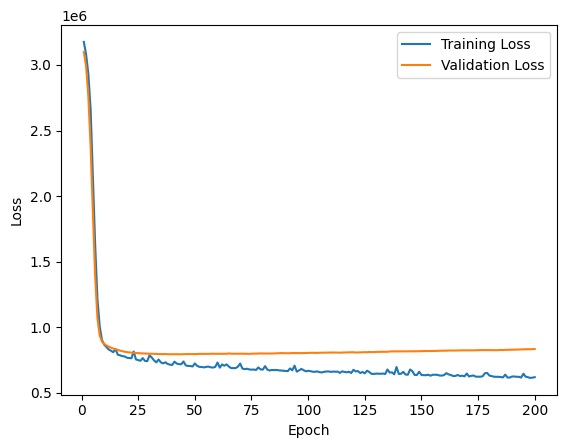

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local1_5030, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_l1_5010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local1, temp_l1_5010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l1_5010.fc1.weight.shape)
print("fc2 weight shape:", temp_l1_5010.fc2.weight.shape)
print("fc3 weight shape:", temp_l1_5010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l1_5010 = temp_l1_5010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l1_5010 = apply_pca_and_reshape(original_fc1_weights_l1_5010,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l1_5010.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l1_5010 = temp_l1_5010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l1_5010 = apply_pca_and_reshape(original_fc2_weights_l1_5010,
                                                        10)

# Instantiate the compressed model
PCA_local1_5010 = CompressedRegressionNN(58, 50, 10, 1)

# Assign the PCA-transformed weights
PCA_local1_5010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l1_5010).float().view(50, 58)
PCA_local1_5010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l1_5010).float().view(10, 50)

# Reset biases
PCA_local1_5010.fc1.bias.data.fill_(0)
PCA_local1_5010.fc2.bias.data.fill_(0)
PCA_local1_5010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local1_5010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local1_5010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local1_5010.fc3.weight.shape)
print()
print(PCA_local1_5010)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([10, 50])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local1_5010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130101.6161, Average MAE: 1498.6408


Epoch [1/200], MSE Loss (Train): 3179908.418, MAE Loss (Train): 1518.944
Validation Loss: 3124316.404, Validation MAE: 1496.767
Epoch [2/200], MSE Loss (Train): 3176831.952, MAE Loss (Train): 1514.771
Validation Loss: 3092811.385, Validation MAE: 1486.801
Epoch [3/200], MSE Loss (Train): 3092329.810, MAE Loss (Train): 1490.195
Validation Loss: 3028051.962, Validation MAE: 1466.201
Epoch [4/200], MSE Loss (Train): 3042016.567, MAE Loss (Train): 1467.638
Validation Loss: 2913023.423, Validation MAE: 1429.023
Epoch [5/200], MSE Loss (Train): 2848653.260, MAE Loss (Train): 1412.760
Validation Loss: 2731181.567, Validation MAE: 1368.117
Epoch [6/200], MSE Loss (Train): 2700541.387, MAE Loss (Train): 1349.853
Validation Loss: 2464876.308, Validation MAE: 1273.091
Epoch [7/200], MSE Loss (Train): 2421045.601, MAE Loss (Train): 1241.105
Validation Loss: 2135410.712, Validation MAE: 1144.273
Epoch [8/200], MSE Loss (Train): 1959428.742, MAE Loss (Train): 1077.973
Validation Loss: 1793452.798, V

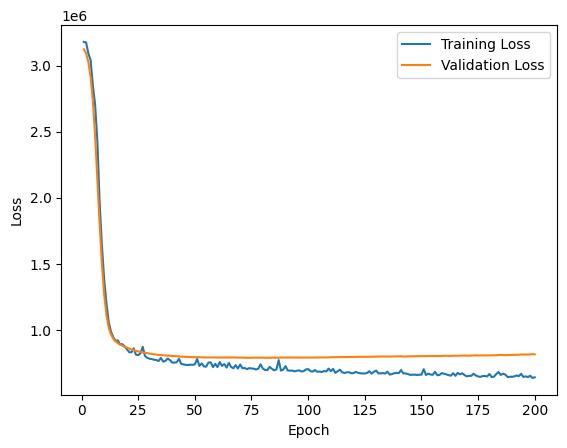

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local1_5010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_l1_505 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local1, temp_l1_505)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l1_505.fc1.weight.shape)
print("fc2 weight shape:", temp_l1_505.fc2.weight.shape)
print("fc3 weight shape:", temp_l1_505.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l1_505 = temp_l1_505.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l1_505 = apply_pca_and_reshape(original_fc1_weights_l1_505,
                                                       50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l1_505.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l1_505 = temp_l1_505.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l1_505 = apply_pca_and_reshape(original_fc2_weights_l1_505,
                                                       5)

# Instantiate the compressed model
PCA_local1_505 = CompressedRegressionNN(58, 50, 5, 1)

# Assign the PCA-transformed weights
PCA_local1_505.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l1_505).float().view(50, 58)
PCA_local1_505.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l1_505).float().view(5, 50)

# Reset biases
PCA_local1_505.fc1.bias.data.fill_(0)
PCA_local1_505.fc2.bias.data.fill_(0)
PCA_local1_505.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local1_505.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local1_505.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local1_505.fc3.weight.shape)
print()
print(PCA_local1_505)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([5, 50])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local1_505, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132115.9921, Average MAE: 1499.3058


Epoch [1/200], MSE Loss (Train): 3201381.212, MAE Loss (Train): 1525.775
Validation Loss: 3130013.462, Validation MAE: 1498.567
Epoch [2/200], MSE Loss (Train): 3151446.954, MAE Loss (Train): 1511.596
Validation Loss: 3113870.019, Validation MAE: 1493.461
Epoch [3/200], MSE Loss (Train): 3121531.906, MAE Loss (Train): 1500.633
Validation Loss: 3084997.423, Validation MAE: 1484.364
Epoch [4/200], MSE Loss (Train): 3091819.252, MAE Loss (Train): 1492.789
Validation Loss: 3035859.250, Validation MAE: 1468.827
Epoch [5/200], MSE Loss (Train): 3024677.084, MAE Loss (Train): 1470.941
Validation Loss: 2958388.231, Validation MAE: 1444.064
Epoch [6/200], MSE Loss (Train): 2950445.978, MAE Loss (Train): 1445.136
Validation Loss: 2846838.433, Validation MAE: 1407.640
Epoch [7/200], MSE Loss (Train): 2823716.800, MAE Loss (Train): 1406.424
Validation Loss: 2697170.894, Validation MAE: 1357.130
Epoch [8/200], MSE Loss (Train): 2612356.679, MAE Loss (Train): 1332.574
Validation Loss: 2513165.885, V

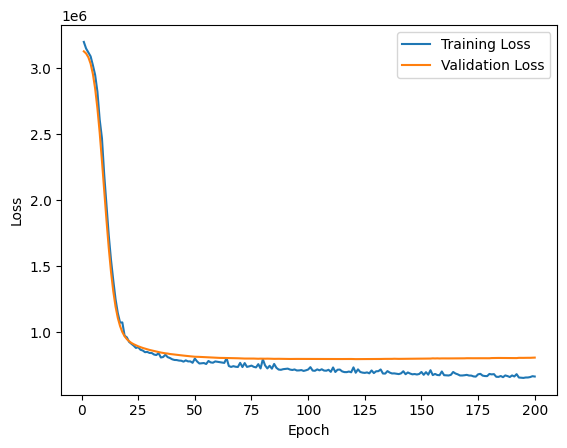

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local1_505, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_l1_3010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local1, temp_l1_3010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l1_3010.fc1.weight.shape)
print("fc2 weight shape:", temp_l1_3010.fc2.weight.shape)
print("fc3 weight shape:", temp_l1_3010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l1_3010 = temp_l1_3010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l1_3010 = apply_pca_and_reshape(original_fc1_weights_l1_3010,
                                                        30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l1_3010.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l1_3010 = temp_l1_3010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l1_3010 = apply_pca_and_reshape(original_fc2_weights_l1_3010,
                                                        10)

# Instantiate the compressed model
PCA_local1_3010 = CompressedRegressionNN(58, 30, 10, 1)

# Assign the PCA-transformed weights
PCA_local1_3010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l1_3010).float().view(30, 58)
PCA_local1_3010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l1_3010).float().view(10, 30)

# Reset biases
PCA_local1_3010.fc1.bias.data.fill_(0)
PCA_local1_3010.fc2.bias.data.fill_(0)
PCA_local1_3010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local1_3010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local1_3010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local1_3010.fc3.weight.shape)
print()
print(PCA_local1_3010)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([10, 30])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local1_3010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3129693.6663, Average MAE: 1498.4858


Epoch [1/200], MSE Loss (Train): 3194273.413, MAE Loss (Train): 1519.763
Validation Loss: 3123336.538, Validation MAE: 1496.333
Epoch [2/200], MSE Loss (Train): 3141514.750, MAE Loss (Train): 1506.553
Validation Loss: 3088463.519, Validation MAE: 1485.086
Epoch [3/200], MSE Loss (Train): 3074677.502, MAE Loss (Train): 1486.883
Validation Loss: 3011606.558, Validation MAE: 1460.232
Epoch [4/200], MSE Loss (Train): 3010709.416, MAE Loss (Train): 1463.206
Validation Loss: 2875773.635, Validation MAE: 1415.546
Epoch [5/200], MSE Loss (Train): 2820103.748, MAE Loss (Train): 1399.946
Validation Loss: 2675191.990, Validation MAE: 1347.204
Epoch [6/200], MSE Loss (Train): 2598944.661, MAE Loss (Train): 1324.814
Validation Loss: 2413178.933, Validation MAE: 1252.615
Epoch [7/200], MSE Loss (Train): 2279412.591, MAE Loss (Train): 1208.093
Validation Loss: 2106708.125, Validation MAE: 1132.349
Epoch [8/200], MSE Loss (Train): 1941977.306, MAE Loss (Train): 1070.280
Validation Loss: 1782641.106, V

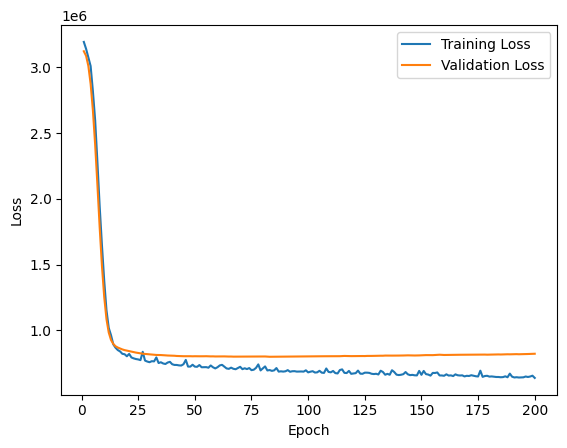

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local1_3010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_l1_305 = RegressionNN(input_size, hidden_size1,
                           hidden_size2, output_size)
transfer_pruned_weights(pruned_local1, temp_l1_305)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l1_305.fc1.weight.shape)
print("fc2 weight shape:", temp_l1_305.fc2.weight.shape)
print("fc3 weight shape:", temp_l1_305.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l1_305 = temp_l1_305.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l1_305 = apply_pca_and_reshape(original_fc1_weights_l1_305,
                                                       30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l1_305.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l1_305 = temp_l1_305.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l1_305 = apply_pca_and_reshape(original_fc2_weights_l1_305,
                                                        5)

# Instantiate the compressed model
PCA_local1_305 = CompressedRegressionNN(58, 30, 5, 1)

# Assign the PCA-transformed weights
PCA_local1_305.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l1_305).float().view(30, 58)
PCA_local1_305.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l1_305).float().view(5, 30)

# Reset biases
PCA_local1_305.fc1.bias.data.fill_(0)
PCA_local1_305.fc2.bias.data.fill_(0)
PCA_local1_305.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local1_305.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local1_305.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local1_305.fc3.weight.shape)
print()
print(PCA_local1_305)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([5, 30])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local1_305, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132851.2335, Average MAE: 1499.4310


Epoch [1/200], MSE Loss (Train): 3195318.899, MAE Loss (Train): 1524.389
Validation Loss: 3131276.865, Validation MAE: 1498.821
Epoch [2/200], MSE Loss (Train): 3153219.327, MAE Loss (Train): 1508.738
Validation Loss: 3116830.750, Validation MAE: 1494.184
Epoch [3/200], MSE Loss (Train): 3118343.794, MAE Loss (Train): 1500.188
Validation Loss: 3090581.135, Validation MAE: 1485.756
Epoch [4/200], MSE Loss (Train): 3159034.534, MAE Loss (Train): 1502.163
Validation Loss: 3046647.327, Validation MAE: 1471.620
Epoch [5/200], MSE Loss (Train): 3041134.159, MAE Loss (Train): 1475.744
Validation Loss: 2978996.654, Validation MAE: 1449.693
Epoch [6/200], MSE Loss (Train): 2961740.115, MAE Loss (Train): 1449.294
Validation Loss: 2883235.981, Validation MAE: 1418.265
Epoch [7/200], MSE Loss (Train): 2846841.332, MAE Loss (Train): 1414.043
Validation Loss: 2753751.192, Validation MAE: 1374.811
Epoch [8/200], MSE Loss (Train): 2704817.038, MAE Loss (Train): 1364.420
Validation Loss: 2591456.606, V

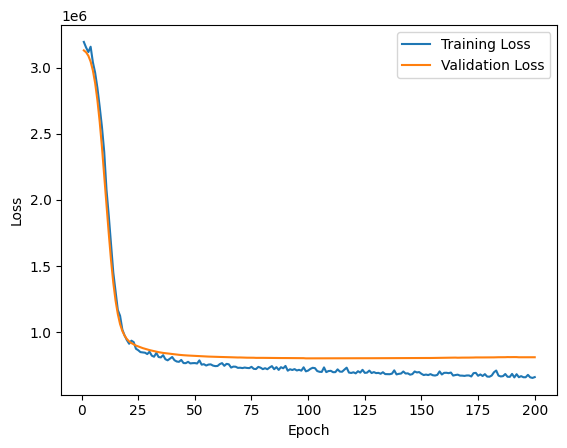

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local1_305, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=10 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_l1_105 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local1, temp_l1_105)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l1_105.fc1.weight.shape)
print("fc2 weight shape:", temp_l1_105.fc2.weight.shape)
print("fc3 weight shape:", temp_l1_105.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l1_105 = temp_l1_105.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l1_105 = apply_pca_and_reshape(original_fc1_weights_l1_105,
                                                       10)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l1_105.fc2 = nn.Linear(10, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l1_105 = temp_l1_105.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l1_105 = apply_pca_and_reshape(original_fc2_weights_l1_105,
                                                        5)

# Instantiate the compressed model
PCA_local1_105 = CompressedRegressionNN(58, 10, 5, 1)

# Assign the PCA-transformed weights
PCA_local1_105.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l1_105).float().view(10, 58)
PCA_local1_105.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l1_105).float().view(5, 10)

# Reset biases
PCA_local1_105.fc1.bias.data.fill_(0)
PCA_local1_105.fc2.bias.data.fill_(0)
PCA_local1_105.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local1_105.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local1_105.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local1_105.fc3.weight.shape)
print()
print(PCA_local1_105)

Transformed fc1 weight shape: torch.Size([10, 58])
Transformed fc2 weight shape: torch.Size([5, 10])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=10, bias=True)
  (fc2): Linear(in_features=10, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local1_105, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130389.1296, Average MAE: 1498.7016


Epoch [1/200], MSE Loss (Train): 3220237.654, MAE Loss (Train): 1522.917
Validation Loss: 3132145.385, Validation MAE: 1499.224
Epoch [2/200], MSE Loss (Train): 3207017.262, MAE Loss (Train): 1524.375
Validation Loss: 3124359.269, Validation MAE: 1496.779
Epoch [3/200], MSE Loss (Train): 3156649.168, MAE Loss (Train): 1512.744
Validation Loss: 3111254.788, Validation MAE: 1492.652
Epoch [4/200], MSE Loss (Train): 3215009.361, MAE Loss (Train): 1522.609
Validation Loss: 3088933.154, Validation MAE: 1485.594
Epoch [5/200], MSE Loss (Train): 3176168.017, MAE Loss (Train): 1512.732
Validation Loss: 3054273.269, Validation MAE: 1474.611
Epoch [6/200], MSE Loss (Train): 3139484.644, MAE Loss (Train): 1498.788
Validation Loss: 3006039.981, Validation MAE: 1459.284
Epoch [7/200], MSE Loss (Train): 2994631.983, MAE Loss (Train): 1463.825
Validation Loss: 2942741.115, Validation MAE: 1438.957
Epoch [8/200], MSE Loss (Train): 2908432.440, MAE Loss (Train): 1436.762
Validation Loss: 2863757.942, V

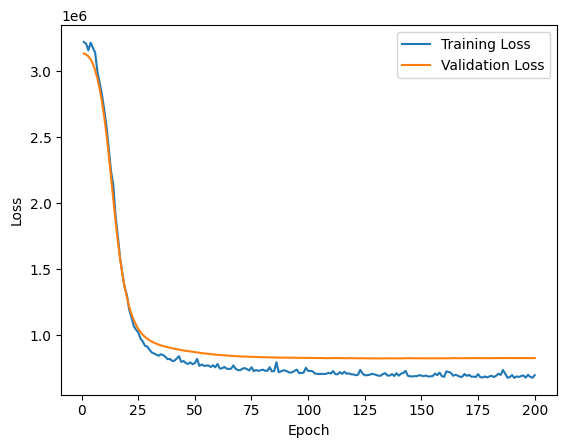

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local1_105, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### PCA on the Pruned Model, `pruned_local2`, with Pruning Amount=0.7

###### fc1 out_features=50 and fc2 out_features=30

In [ ]:
# create copy of the locally pruned model
temp_l2_5030 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local2, temp_l2_5030)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l2_5030.fc1.weight.shape)
print("fc2 weight shape:", temp_l2_5030.fc2.weight.shape)
print("fc3 weight shape:", temp_l2_5030.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l2_5030 = temp_l2_5030.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l2_5030 = apply_pca_and_reshape(original_fc1_weights_l2_5030,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l2_5030.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l2_5030 = temp_l2_5030.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l2_5030 = apply_pca_and_reshape(original_fc2_weights_l2_5030,
                                                        30)

# Instantiate the compressed model
PCA_local2_5030 = CompressedRegressionNN(58, 50, 30, 1)

# Assign the PCA-transformed weights
PCA_local2_5030.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l2_5030).float().view(50, 58)
PCA_local2_5030.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l2_5030).float().view(30, 50)

# Reset biases
PCA_local2_5030.fc1.bias.data.fill_(0)
PCA_local2_5030.fc2.bias.data.fill_(0)
PCA_local2_5030.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local2_5030.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local2_5030.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local2_5030.fc3.weight.shape)
print()
print(PCA_local2_5030)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([30, 50])
Transformed fc3 weight shape: torch.Size([1, 30])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=30, bias=True)
  (fc3): Linear(in_features=30, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local2_5030, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3129263.2787, Average MAE: 1498.3550


Epoch [1/200], MSE Loss (Train): 3184860.087, MAE Loss (Train): 1519.351
Validation Loss: 3098419.923, Validation MAE: 1488.411
Epoch [2/200], MSE Loss (Train): 3076140.007, MAE Loss (Train): 1484.551
Validation Loss: 2981315.096, Validation MAE: 1450.662
Epoch [3/200], MSE Loss (Train): 2970973.442, MAE Loss (Train): 1445.854
Validation Loss: 2730100.798, Validation MAE: 1367.051
Epoch [4/200], MSE Loss (Train): 2614182.959, MAE Loss (Train): 1328.011
Validation Loss: 2329618.548, Validation MAE: 1221.992
Epoch [5/200], MSE Loss (Train): 2093710.716, MAE Loss (Train): 1132.676
Validation Loss: 1834401.846, Validation MAE: 1018.644
Epoch [6/200], MSE Loss (Train): 1641789.400, MAE Loss (Train): 938.910
Validation Loss: 1387715.769, Validation MAE: 823.776
Epoch [7/200], MSE Loss (Train): 1225775.822, MAE Loss (Train): 772.747
Validation Loss: 1093595.817, Validation MAE: 703.672
Epoch [8/200], MSE Loss (Train): 1016698.090, MAE Loss (Train): 692.063
Validation Loss: 941696.226, Validat

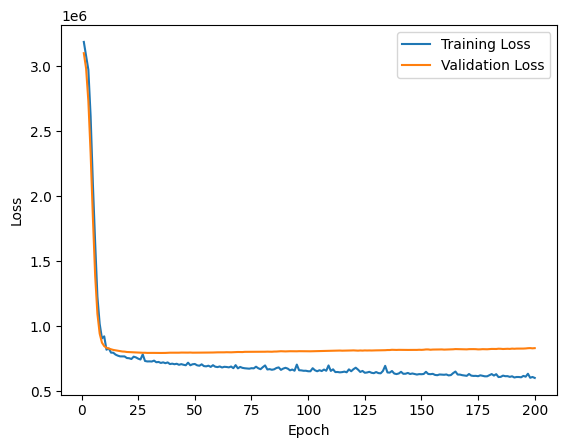

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local2_5030, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_l2_5010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local2, temp_l2_5010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l2_5010.fc1.weight.shape)
print("fc2 weight shape:", temp_l2_5010.fc2.weight.shape)
print("fc3 weight shape:", temp_l2_5010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l2_5010 = temp_l2_5010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l2_5010 = apply_pca_and_reshape(original_fc1_weights_l2_5010,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l2_5010.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l2_5010 = temp_l2_5010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l2_5010 = apply_pca_and_reshape(original_fc2_weights_l2_5010,
                                                        10)

# Instantiate the compressed model
PCA_local2_5010 = CompressedRegressionNN(58, 50, 10, 1)

# Assign the PCA-transformed weights
PCA_local2_5010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l2_5010).float().view(50, 58)
PCA_local2_5010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l2_5010).float().view(10, 50)

# Reset biases
PCA_local2_5010.fc1.bias.data.fill_(0)
PCA_local2_5010.fc2.bias.data.fill_(0)
PCA_local2_5010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local2_5010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local2_5010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local2_5010.fc3.weight.shape)
print()
print(PCA_local2_5010)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([10, 50])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local2_5010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132481.7090, Average MAE: 1499.3448


Epoch [1/200], MSE Loss (Train): 3170830.048, MAE Loss (Train): 1517.275
Validation Loss: 3126690.385, Validation MAE: 1497.327
Epoch [2/200], MSE Loss (Train): 3214745.356, MAE Loss (Train): 1522.885
Validation Loss: 3092075.577, Validation MAE: 1486.215
Epoch [3/200], MSE Loss (Train): 3100730.106, MAE Loss (Train): 1491.790
Validation Loss: 3023712.038, Validation MAE: 1464.319
Epoch [4/200], MSE Loss (Train): 3087795.630, MAE Loss (Train): 1480.029
Validation Loss: 2906593.481, Validation MAE: 1426.355
Epoch [5/200], MSE Loss (Train): 2841987.478, MAE Loss (Train): 1410.972
Validation Loss: 2726815.837, Validation MAE: 1366.079
Epoch [6/200], MSE Loss (Train): 2622764.179, MAE Loss (Train): 1335.651
Validation Loss: 2487318.644, Validation MAE: 1281.432
Epoch [7/200], MSE Loss (Train): 2346460.850, MAE Loss (Train): 1232.863
Validation Loss: 2199711.846, Validation MAE: 1171.244
Epoch [8/200], MSE Loss (Train): 2058125.625, MAE Loss (Train): 1118.880
Validation Loss: 1892685.019, V

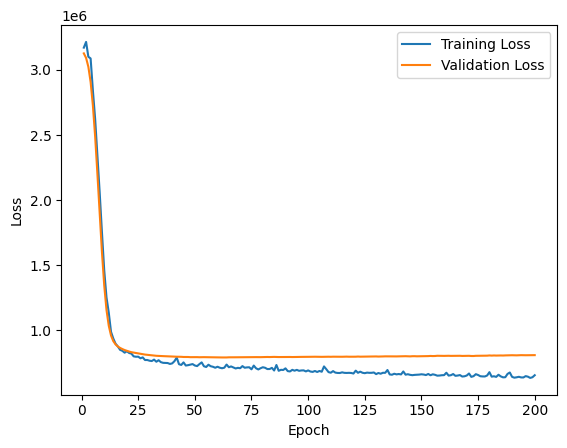

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local2_5010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_l2_505 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local2, temp_l2_505)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l2_505.fc1.weight.shape)
print("fc2 weight shape:", temp_l2_505.fc2.weight.shape)
print("fc3 weight shape:", temp_l2_505.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l2_505 = temp_l2_505.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l2_505 = apply_pca_and_reshape(original_fc1_weights_l2_505,
                                                       50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l2_505.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l2_505 = temp_l2_505.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l2_505 = apply_pca_and_reshape(original_fc2_weights_l2_505,
                                                       5)

# Instantiate the compressed model
PCA_local2_505 = CompressedRegressionNN(58, 50, 5, 1)

# Assign the PCA-transformed weights
PCA_local2_505.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l2_505).float().view(50, 58)
PCA_local2_505.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l2_505).float().view(5, 50)

# Reset biases
PCA_local2_505.fc1.bias.data.fill_(0)
PCA_local2_505.fc2.bias.data.fill_(0)
PCA_local2_505.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local2_505.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local2_505.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local2_505.fc3.weight.shape)
print()
print(PCA_local2_505)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([5, 50])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local2_505, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3135387.8496, Average MAE: 1500.2271


Epoch [1/200], MSE Loss (Train): 3161336.651, MAE Loss (Train): 1514.532
Validation Loss: 3133540.519, Validation MAE: 1499.664
Epoch [2/200], MSE Loss (Train): 3174066.839, MAE Loss (Train): 1512.682
Validation Loss: 3124275.442, Validation MAE: 1496.759
Epoch [3/200], MSE Loss (Train): 3207858.315, MAE Loss (Train): 1519.408
Validation Loss: 3109671.308, Validation MAE: 1492.193
Epoch [4/200], MSE Loss (Train): 3171678.721, MAE Loss (Train): 1510.519
Validation Loss: 3086034.885, Validation MAE: 1484.843
Epoch [5/200], MSE Loss (Train): 3114540.899, MAE Loss (Train): 1499.647
Validation Loss: 3049626.327, Validation MAE: 1473.521
Epoch [6/200], MSE Loss (Train): 3122606.019, MAE Loss (Train): 1489.871
Validation Loss: 2995741.058, Validation MAE: 1456.619
Epoch [7/200], MSE Loss (Train): 2972773.743, MAE Loss (Train): 1454.698
Validation Loss: 2921498.058, Validation MAE: 1432.922
Epoch [8/200], MSE Loss (Train): 2898759.058, MAE Loss (Train): 1430.748
Validation Loss: 2824490.923, V

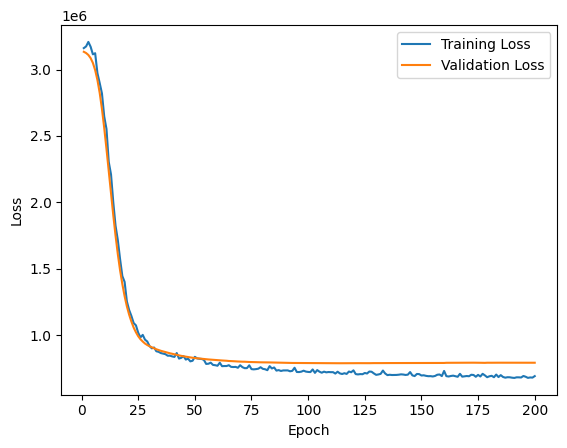

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local2_505, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_l2_3010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local2, temp_l2_3010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l2_3010.fc1.weight.shape)
print("fc2 weight shape:", temp_l2_3010.fc2.weight.shape)
print("fc3 weight shape:", temp_l2_3010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l2_3010 = temp_l2_3010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l2_3010 = apply_pca_and_reshape(original_fc1_weights_l2_3010,
                                                        30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l2_3010.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l2_3010 = temp_l2_3010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l2_3010 = apply_pca_and_reshape(original_fc2_weights_l2_3010,
                                                        10)

# Instantiate the compressed model
PCA_local2_3010 = CompressedRegressionNN(58, 30, 10, 1)

# Assign the PCA-transformed weights
PCA_local2_3010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l2_3010).float().view(30, 58)
PCA_local2_3010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l2_3010).float().view(10, 30)

# Reset biases
PCA_local2_3010.fc1.bias.data.fill_(0)
PCA_local2_3010.fc2.bias.data.fill_(0)
PCA_local2_3010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local2_3010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local2_3010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local2_3010.fc3.weight.shape)
print()
print(PCA_local2_3010)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([10, 30])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local2_3010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3129038.3417, Average MAE: 1498.2591


Epoch [1/200], MSE Loss (Train): 3255002.587, MAE Loss (Train): 1530.209
Validation Loss: 3122141.654, Validation MAE: 1495.984
Epoch [2/200], MSE Loss (Train): 3173062.880, MAE Loss (Train): 1512.470
Validation Loss: 3090837.231, Validation MAE: 1485.967
Epoch [3/200], MSE Loss (Train): 3164389.812, MAE Loss (Train): 1504.137
Validation Loss: 3030871.577, Validation MAE: 1466.712
Epoch [4/200], MSE Loss (Train): 3058212.505, MAE Loss (Train): 1479.938
Validation Loss: 2929052.404, Validation MAE: 1433.736
Epoch [5/200], MSE Loss (Train): 2944896.877, MAE Loss (Train): 1436.145
Validation Loss: 2775839.452, Validation MAE: 1382.984
Epoch [6/200], MSE Loss (Train): 2715313.368, MAE Loss (Train): 1367.759
Validation Loss: 2567579.308, Validation MAE: 1311.270
Epoch [7/200], MSE Loss (Train): 2536545.471, MAE Loss (Train): 1293.610
Validation Loss: 2316191.212, Validation MAE: 1218.620
Epoch [8/200], MSE Loss (Train): 2185641.433, MAE Loss (Train): 1173.228
Validation Loss: 2025552.827, V

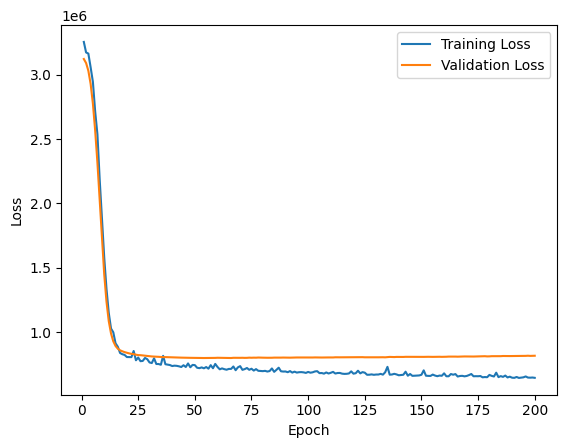

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local2_3010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_l2_305 = RegressionNN(input_size, hidden_size1,
                           hidden_size2, output_size)
transfer_pruned_weights(pruned_local2, temp_l2_305)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l2_305.fc1.weight.shape)
print("fc2 weight shape:", temp_l2_305.fc2.weight.shape)
print("fc3 weight shape:", temp_l2_305.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l2_305 = temp_l2_305.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l2_305 = apply_pca_and_reshape(original_fc1_weights_l2_305,
                                                       30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l2_305.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l2_305 = temp_l2_305.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l2_305 = apply_pca_and_reshape(original_fc2_weights_l2_305,
                                                        5)

# Instantiate the compressed model
PCA_local2_305 = CompressedRegressionNN(58, 30, 5, 1)

# Assign the PCA-transformed weights
PCA_local2_305.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l2_305).float().view(30, 58)
PCA_local2_305.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l2_305).float().view(5, 30)

# Reset biases
PCA_local2_305.fc1.bias.data.fill_(0)
PCA_local2_305.fc2.bias.data.fill_(0)
PCA_local2_305.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local2_305.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local2_305.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local2_305.fc3.weight.shape)
print()
print(PCA_local2_305)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([5, 30])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local2_305, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3128262.2396, Average MAE: 1498.0443


Epoch [1/200], MSE Loss (Train): 3190959.957, MAE Loss (Train): 1517.542
Validation Loss: 3125918.654, Validation MAE: 1497.264
Epoch [2/200], MSE Loss (Train): 3216217.207, MAE Loss (Train): 1521.179
Validation Loss: 3101304.462, Validation MAE: 1489.455
Epoch [3/200], MSE Loss (Train): 3098503.541, MAE Loss (Train): 1493.575
Validation Loss: 3054356.519, Validation MAE: 1474.505
Epoch [4/200], MSE Loss (Train): 3072587.988, MAE Loss (Train): 1485.001
Validation Loss: 2976864.558, Validation MAE: 1449.633
Epoch [5/200], MSE Loss (Train): 3032612.909, MAE Loss (Train): 1462.076
Validation Loss: 2860182.808, Validation MAE: 1411.573
Epoch [6/200], MSE Loss (Train): 2847237.565, MAE Loss (Train): 1409.198
Validation Loss: 2700730.606, Validation MAE: 1357.854
Epoch [7/200], MSE Loss (Train): 2645675.952, MAE Loss (Train): 1342.373
Validation Loss: 2499159.452, Validation MAE: 1286.840
Epoch [8/200], MSE Loss (Train): 2441841.315, MAE Loss (Train): 1268.224
Validation Loss: 2263412.788, V

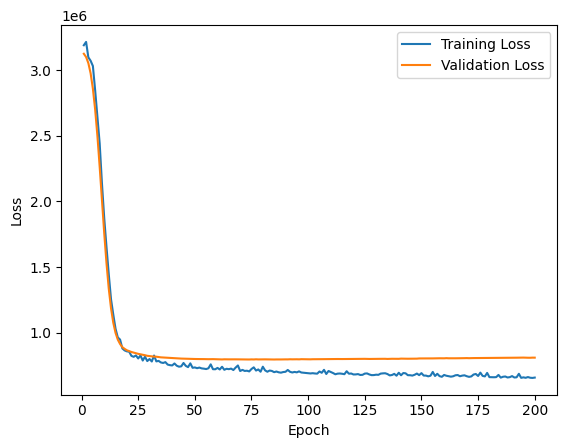

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local2_305, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=10 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_l2_105 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local2, temp_l2_105)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l2_105.fc1.weight.shape)
print("fc2 weight shape:", temp_l2_105.fc2.weight.shape)
print("fc3 weight shape:", temp_l2_105.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l2_105 = temp_l2_105.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l2_105 = apply_pca_and_reshape(original_fc1_weights_l2_105,
                                                       10)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l2_105.fc2 = nn.Linear(10, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l1_105 = temp_l2_105.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l2_105 = apply_pca_and_reshape(original_fc2_weights_l1_105,
                                                        5)

# Instantiate the compressed model
PCA_local2_105 = CompressedRegressionNN(58, 10, 5, 1)

# Assign the PCA-transformed weights
PCA_local2_105.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l2_105).float().view(10, 58)
PCA_local2_105.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l2_105).float().view(5, 10)

# Reset biases
PCA_local2_105.fc1.bias.data.fill_(0)
PCA_local2_105.fc2.bias.data.fill_(0)
PCA_local2_105.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local2_105.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local2_105.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local2_105.fc3.weight.shape)
print()
print(PCA_local2_105)

Transformed fc1 weight shape: torch.Size([10, 58])
Transformed fc2 weight shape: torch.Size([5, 10])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=10, bias=True)
  (fc2): Linear(in_features=10, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local2_105, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3123680.9438, Average MAE: 1496.5765


Epoch [1/200], MSE Loss (Train): 3147554.483, MAE Loss (Train): 1507.860
Validation Loss: 3124029.346, Validation MAE: 1496.623
Epoch [2/200], MSE Loss (Train): 3142473.531, MAE Loss (Train): 1508.626
Validation Loss: 3111651.000, Validation MAE: 1492.658
Epoch [3/200], MSE Loss (Train): 3149781.279, MAE Loss (Train): 1509.315
Validation Loss: 3089890.269, Validation MAE: 1485.684
Epoch [4/200], MSE Loss (Train): 3148873.675, MAE Loss (Train): 1506.397
Validation Loss: 3054972.231, Validation MAE: 1474.423
Epoch [5/200], MSE Loss (Train): 3106462.716, MAE Loss (Train): 1493.083
Validation Loss: 3005157.750, Validation MAE: 1458.277
Epoch [6/200], MSE Loss (Train): 2982731.050, MAE Loss (Train): 1456.637
Validation Loss: 2938690.423, Validation MAE: 1436.519
Epoch [7/200], MSE Loss (Train): 2927327.135, MAE Loss (Train): 1441.877
Validation Loss: 2854305.788, Validation MAE: 1408.431
Epoch [8/200], MSE Loss (Train): 2803511.364, MAE Loss (Train): 1400.283
Validation Loss: 2750362.163, V

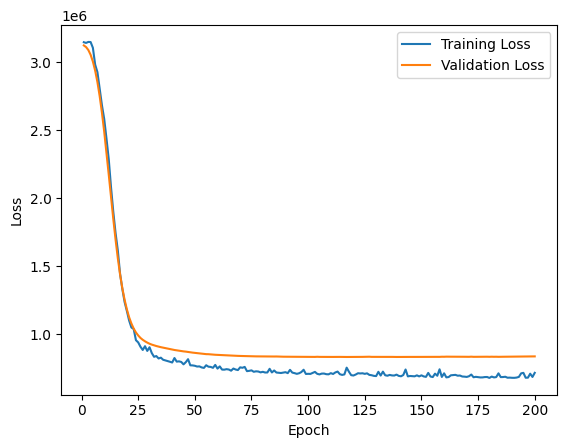

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local2_105, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### PCA on the Pruned Model, `pruned_local3`, with Pruning Amount=0.8

###### fc1 out_features=50 and fc2 out_features=30

In [ ]:
# create copy of the locally pruned model
temp_l3_5030 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local3, temp_l3_5030)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l3_5030.fc1.weight.shape)
print("fc2 weight shape:", temp_l3_5030.fc2.weight.shape)
print("fc3 weight shape:", temp_l3_5030.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l3_5030 = temp_l2_5030.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l2_5030 = apply_pca_and_reshape(original_fc1_weights_l3_5030,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l2_5030.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l3_5030 = temp_l2_5030.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l2_5030 = apply_pca_and_reshape(original_fc2_weights_l3_5030,
                                                        30)

# Instantiate the compressed model
PCA_local3_5030 = CompressedRegressionNN(58, 50, 30, 1)

# Assign the PCA-transformed weights
PCA_local3_5030.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l2_5030).float().view(50, 58)
PCA_local3_5030.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l2_5030).float().view(30, 50)

# Reset biases
PCA_local3_5030.fc1.bias.data.fill_(0)
PCA_local3_5030.fc2.bias.data.fill_(0)
PCA_local3_5030.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local3_5030.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local3_5030.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local3_5030.fc3.weight.shape)
print()
print(PCA_local3_5030)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([30, 50])
Transformed fc3 weight shape: torch.Size([1, 30])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=30, bias=True)
  (fc3): Linear(in_features=30, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local3_5030, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132890.7164, Average MAE: 1499.4805


Epoch [1/200], MSE Loss (Train): 3197537.846, MAE Loss (Train): 1522.320
Validation Loss: 3117313.712, Validation MAE: 1494.397
Epoch [2/200], MSE Loss (Train): 3166090.034, MAE Loss (Train): 1510.960
Validation Loss: 3052710.654, Validation MAE: 1473.734
Epoch [3/200], MSE Loss (Train): 3020109.296, MAE Loss (Train): 1466.668
Validation Loss: 2906851.769, Validation MAE: 1426.489
Epoch [4/200], MSE Loss (Train): 2837411.327, MAE Loss (Train): 1406.447
Validation Loss: 2648861.356, Validation MAE: 1338.990
Epoch [5/200], MSE Loss (Train): 2483573.118, MAE Loss (Train): 1284.571
Validation Loss: 2275644.510, Validation MAE: 1200.879
Epoch [6/200], MSE Loss (Train): 2069532.544, MAE Loss (Train): 1120.683
Validation Loss: 1849281.577, Validation MAE: 1024.435
Epoch [7/200], MSE Loss (Train): 1645421.914, MAE Loss (Train): 949.435
Validation Loss: 1469857.120, Validation MAE: 860.019
Epoch [8/200], MSE Loss (Train): 1329252.663, MAE Loss (Train): 819.370
Validation Loss: 1200738.279, Vali

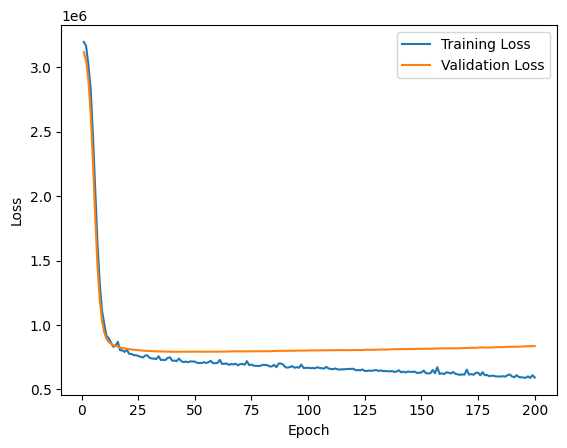

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local3_5030, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_l3_5010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local3, temp_l3_5010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l3_5010.fc1.weight.shape)
print("fc2 weight shape:", temp_l3_5010.fc2.weight.shape)
print("fc3 weight shape:", temp_l3_5010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l3_5010 = temp_l3_5010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l3_5010 = apply_pca_and_reshape(original_fc1_weights_l3_5010,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l3_5010.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l3_5010 = temp_l3_5010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l3_5010 = apply_pca_and_reshape(original_fc2_weights_l3_5010,
                                                        10)

# Instantiate the compressed model
PCA_local3_5010 = CompressedRegressionNN(58, 50, 10, 1)

# Assign the PCA-transformed weights
PCA_local3_5010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l3_5010).float().view(50, 58)
PCA_local3_5010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l3_5010).float().view(10, 50)

# Reset biases
PCA_local3_5010.fc1.bias.data.fill_(0)
PCA_local3_5010.fc2.bias.data.fill_(0)
PCA_local3_5010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local3_5010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local3_5010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local3_5010.fc3.weight.shape)
print()
print(PCA_local3_5010)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([10, 50])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local3_5010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3133965.0049, Average MAE: 1499.9212


Epoch [1/200], MSE Loss (Train): 3175643.048, MAE Loss (Train): 1519.611
Validation Loss: 3131342.885, Validation MAE: 1498.881
Epoch [2/200], MSE Loss (Train): 3187946.411, MAE Loss (Train): 1519.929
Validation Loss: 3117867.558, Validation MAE: 1494.480
Epoch [3/200], MSE Loss (Train): 3124971.022, MAE Loss (Train): 1500.259
Validation Loss: 3092694.846, Validation MAE: 1486.338
Epoch [4/200], MSE Loss (Train): 3102225.692, MAE Loss (Train): 1494.271
Validation Loss: 3048055.577, Validation MAE: 1471.946
Epoch [5/200], MSE Loss (Train): 3038803.853, MAE Loss (Train): 1474.083
Validation Loss: 2975791.673, Validation MAE: 1448.406
Epoch [6/200], MSE Loss (Train): 2998598.728, MAE Loss (Train): 1452.928
Validation Loss: 2867941.000, Validation MAE: 1412.827
Epoch [7/200], MSE Loss (Train): 2890054.111, MAE Loss (Train): 1419.143
Validation Loss: 2721781.462, Validation MAE: 1363.200
Epoch [8/200], MSE Loss (Train): 2676789.214, MAE Loss (Train): 1350.996
Validation Loss: 2538402.346, V

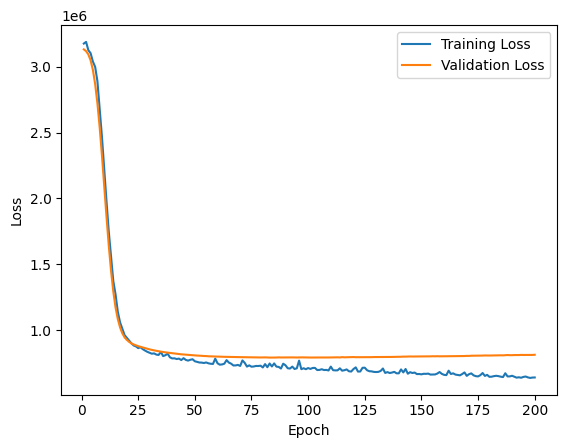

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local3_5010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_l3_505 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local3, temp_l3_505)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l3_505.fc1.weight.shape)
print("fc2 weight shape:", temp_l3_505.fc2.weight.shape)
print("fc3 weight shape:", temp_l3_505.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l3_505 = temp_l3_505.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l3_505 = apply_pca_and_reshape(original_fc1_weights_l3_505,
                                                       50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l3_505.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l3_505 = temp_l3_505.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l3_505 = apply_pca_and_reshape(original_fc2_weights_l3_505,
                                                       5)

# Instantiate the compressed model
PCA_local3_505 = CompressedRegressionNN(58, 50, 5, 1)

# Assign the PCA-transformed weights
PCA_local3_505.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l3_505).float().view(50, 58)
PCA_local3_505.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l3_505).float().view(5, 50)

# Reset biases
PCA_local3_505.fc1.bias.data.fill_(0)
PCA_local3_505.fc2.bias.data.fill_(0)
PCA_local3_505.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local3_505.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local3_505.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local3_505.fc3.weight.shape)
print()
print(PCA_local3_505)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([5, 50])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local3_505, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131845.1993, Average MAE: 1499.1770


Epoch [1/200], MSE Loss (Train): 3154227.243, MAE Loss (Train): 1510.471
Validation Loss: 3133794.654, Validation MAE: 1499.734
Epoch [2/200], MSE Loss (Train): 3178332.159, MAE Loss (Train): 1514.190
Validation Loss: 3120593.577, Validation MAE: 1495.497
Epoch [3/200], MSE Loss (Train): 3183744.894, MAE Loss (Train): 1514.921
Validation Loss: 3094458.942, Validation MAE: 1487.154
Epoch [4/200], MSE Loss (Train): 3120583.183, MAE Loss (Train): 1500.171
Validation Loss: 3047335.000, Validation MAE: 1472.120
Epoch [5/200], MSE Loss (Train): 3029151.450, MAE Loss (Train): 1470.872
Validation Loss: 2971222.538, Validation MAE: 1447.626
Epoch [6/200], MSE Loss (Train): 2937406.404, MAE Loss (Train): 1442.010
Validation Loss: 2859920.962, Validation MAE: 1411.160
Epoch [7/200], MSE Loss (Train): 2807139.731, MAE Loss (Train): 1398.741
Validation Loss: 2708258.529, Validation MAE: 1359.815
Epoch [8/200], MSE Loss (Train): 2632587.772, MAE Loss (Train): 1338.930
Validation Loss: 2520197.058, V

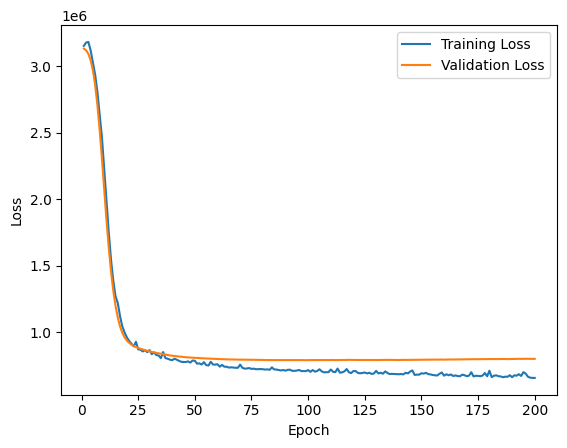

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local3_505, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_l3_3010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local3, temp_l3_3010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l3_3010.fc1.weight.shape)
print("fc2 weight shape:", temp_l3_3010.fc2.weight.shape)
print("fc3 weight shape:", temp_l3_3010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l3_3010 = temp_l3_3010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l3_3010 = apply_pca_and_reshape(original_fc1_weights_l3_3010,
                                                        30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l3_3010.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l3_3010 = temp_l3_3010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l3_3010 = apply_pca_and_reshape(original_fc2_weights_l3_3010,
                                                        10)

# Instantiate the compressed model
PCA_local3_3010 = CompressedRegressionNN(58, 30, 10, 1)

# Assign the PCA-transformed weights
PCA_local3_3010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l3_3010).float().view(30, 58)
PCA_local3_3010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l3_3010).float().view(10, 30)

# Reset biases
PCA_local3_3010.fc1.bias.data.fill_(0)
PCA_local3_3010.fc2.bias.data.fill_(0)
PCA_local3_3010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local3_3010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local3_3010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local3_3010.fc3.weight.shape)
print()
print(PCA_local3_3010)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([10, 30])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local3_3010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3129623.4566, Average MAE: 1498.3756


Epoch [1/200], MSE Loss (Train): 3205185.284, MAE Loss (Train): 1522.926
Validation Loss: 3122546.558, Validation MAE: 1495.858
Epoch [2/200], MSE Loss (Train): 3190997.841, MAE Loss (Train): 1517.857
Validation Loss: 3092193.673, Validation MAE: 1485.793
Epoch [3/200], MSE Loss (Train): 3123338.885, MAE Loss (Train): 1498.876
Validation Loss: 3038157.269, Validation MAE: 1467.864
Epoch [4/200], MSE Loss (Train): 3034164.255, MAE Loss (Train): 1472.211
Validation Loss: 2950156.942, Validation MAE: 1438.644
Epoch [5/200], MSE Loss (Train): 2927900.303, MAE Loss (Train): 1435.079
Validation Loss: 2818580.433, Validation MAE: 1394.167
Epoch [6/200], MSE Loss (Train): 2751011.993, MAE Loss (Train): 1376.651
Validation Loss: 2637898.337, Validation MAE: 1330.960
Epoch [7/200], MSE Loss (Train): 2532722.415, MAE Loss (Train): 1299.499
Validation Loss: 2409553.567, Validation MAE: 1247.050
Epoch [8/200], MSE Loss (Train): 2306118.022, MAE Loss (Train): 1212.855
Validation Loss: 2135736.019, V

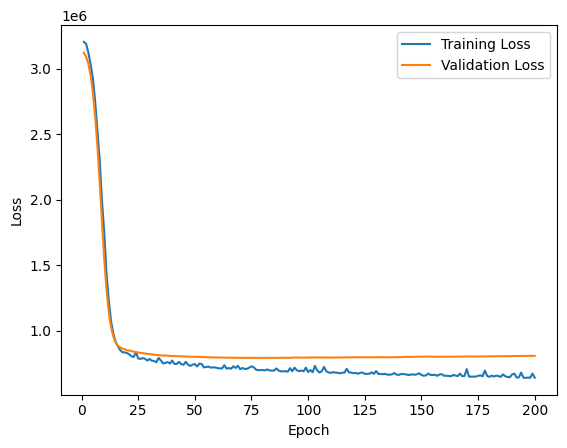

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local3_3010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_l3_305 = RegressionNN(input_size, hidden_size1,
                           hidden_size2, output_size)
transfer_pruned_weights(pruned_local3, temp_l3_305)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l3_305.fc1.weight.shape)
print("fc2 weight shape:", temp_l3_305.fc2.weight.shape)
print("fc3 weight shape:", temp_l3_305.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l3_305 = temp_l3_305.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l3_305 = apply_pca_and_reshape(original_fc1_weights_l3_305,
                                                       30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l3_305.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l3_305 = temp_l3_305.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l3_305 = apply_pca_and_reshape(original_fc2_weights_l3_305,
                                                        5)

# Instantiate the compressed model
PCA_local3_305 = CompressedRegressionNN(58, 30, 5, 1)

# Assign the PCA-transformed weights
PCA_local3_305.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l3_305).float().view(30, 58)
PCA_local3_305.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l3_305).float().view(5, 30)

# Reset biases
PCA_local3_305.fc1.bias.data.fill_(0)
PCA_local3_305.fc2.bias.data.fill_(0)
PCA_local3_305.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local3_305.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local3_305.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local3_305.fc3.weight.shape)
print()
print(PCA_local3_305)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([5, 30])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local3_305, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131092.1724, Average MAE: 1498.8951


Epoch [1/200], MSE Loss (Train): 3186836.103, MAE Loss (Train): 1519.420
Validation Loss: 3131755.596, Validation MAE: 1498.976
Epoch [2/200], MSE Loss (Train): 3158246.601, MAE Loss (Train): 1513.901
Validation Loss: 3117863.096, Validation MAE: 1494.411
Epoch [3/200], MSE Loss (Train): 3159588.428, MAE Loss (Train): 1513.295
Validation Loss: 3092591.923, Validation MAE: 1486.155
Epoch [4/200], MSE Loss (Train): 3099121.226, MAE Loss (Train): 1493.273
Validation Loss: 3050195.692, Validation MAE: 1472.373
Epoch [5/200], MSE Loss (Train): 3046434.156, MAE Loss (Train): 1477.774
Validation Loss: 2984512.942, Validation MAE: 1450.988
Epoch [6/200], MSE Loss (Train): 2945617.244, MAE Loss (Train): 1442.625
Validation Loss: 2889872.827, Validation MAE: 1419.877
Epoch [7/200], MSE Loss (Train): 2842758.798, MAE Loss (Train): 1409.202
Validation Loss: 2762497.683, Validation MAE: 1376.861
Epoch [8/200], MSE Loss (Train): 2730234.325, MAE Loss (Train): 1365.121
Validation Loss: 2602565.490, V

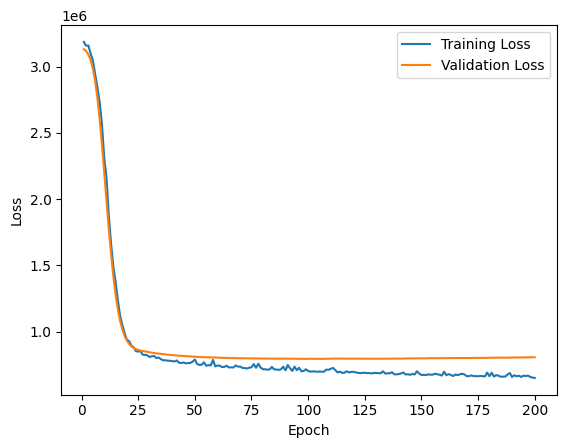

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local3_305, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=10 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_l3_105 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local3, temp_l3_105)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l3_105.fc1.weight.shape)
print("fc2 weight shape:", temp_l3_105.fc2.weight.shape)
print("fc3 weight shape:", temp_l3_105.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l3_105 = temp_l3_105.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l3_105 = apply_pca_and_reshape(original_fc1_weights_l3_105,
                                                       10)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l3_105.fc2 = nn.Linear(10, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l3_105 = temp_l3_105.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l3_105 = apply_pca_and_reshape(original_fc2_weights_l3_105,
                                                        5)

# Instantiate the compressed model
PCA_local3_105 = CompressedRegressionNN(58, 10, 5, 1)

# Assign the PCA-transformed weights
PCA_local3_105.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l3_105).float().view(10, 58)
PCA_local3_105.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l3_105).float().view(5, 10)

# Reset biases
PCA_local3_105.fc1.bias.data.fill_(0)
PCA_local3_105.fc2.bias.data.fill_(0)
PCA_local3_105.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local3_105.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local3_105.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local3_105.fc3.weight.shape)
print()
print(PCA_local3_105)

Transformed fc1 weight shape: torch.Size([10, 58])
Transformed fc2 weight shape: torch.Size([5, 10])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=10, bias=True)
  (fc2): Linear(in_features=10, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local3_105, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3137985.0892, Average MAE: 1501.2155


Epoch [1/200], MSE Loss (Train): 3222428.534, MAE Loss (Train): 1530.298
Validation Loss: 3140487.654, Validation MAE: 1501.879
Epoch [2/200], MSE Loss (Train): 3194015.466, MAE Loss (Train): 1520.681
Validation Loss: 3136608.000, Validation MAE: 1500.580
Epoch [3/200], MSE Loss (Train): 3177197.072, MAE Loss (Train): 1518.399
Validation Loss: 3132007.288, Validation MAE: 1499.047
Epoch [4/200], MSE Loss (Train): 3208082.861, MAE Loss (Train): 1521.271
Validation Loss: 3125482.288, Validation MAE: 1496.868
Epoch [5/200], MSE Loss (Train): 3186608.226, MAE Loss (Train): 1518.981
Validation Loss: 3116484.904, Validation MAE: 1493.864
Epoch [6/200], MSE Loss (Train): 3149999.038, MAE Loss (Train): 1510.754
Validation Loss: 3104838.038, Validation MAE: 1489.987
Epoch [7/200], MSE Loss (Train): 3123029.512, MAE Loss (Train): 1503.212
Validation Loss: 3089808.442, Validation MAE: 1484.996
Epoch [8/200], MSE Loss (Train): 3148482.351, MAE Loss (Train): 1503.887
Validation Loss: 3070439.904, V

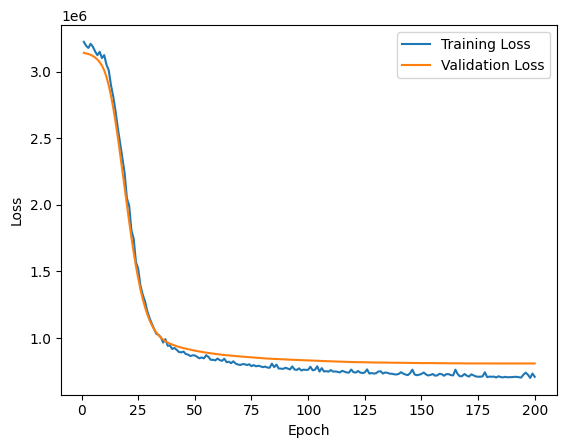

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local3_105, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### PCA on the Pruned Model, `pruned_local4`, with Pruning Amount=0.9

###### fc1 out_features=50 and fc2 out_features=30

In [ ]:
# create copy of the locally pruned model
temp_l4_5030 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local4, temp_l4_5030)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l4_5030.fc1.weight.shape)
print("fc2 weight shape:", temp_l4_5030.fc2.weight.shape)
print("fc3 weight shape:", temp_l4_5030.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l4_5030 = temp_l4_5030.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l4_5030 = apply_pca_and_reshape(original_fc1_weights_l4_5030,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l4_5030.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l4_5030 = temp_l4_5030.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l4_5030 = apply_pca_and_reshape(original_fc2_weights_l4_5030,
                                                        30)

# Instantiate the compressed model
PCA_local4_5030 = CompressedRegressionNN(58, 50, 30, 1)

# Assign the PCA-transformed weights
PCA_local4_5030.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l4_5030).float().view(50, 58)
PCA_local4_5030.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l4_5030).float().view(30, 50)

# Reset biases
PCA_local4_5030.fc1.bias.data.fill_(0)
PCA_local4_5030.fc2.bias.data.fill_(0)
PCA_local4_5030.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local4_5030.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local4_5030.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local4_5030.fc3.weight.shape)
print()
print(PCA_local4_5030)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([30, 50])
Transformed fc3 weight shape: torch.Size([1, 30])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=30, bias=True)
  (fc3): Linear(in_features=30, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local4_5030, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130959.8441, Average MAE: 1498.8236


Epoch [1/200], MSE Loss (Train): 3161377.060, MAE Loss (Train): 1514.582
Validation Loss: 3112046.115, Validation MAE: 1492.536
Epoch [2/200], MSE Loss (Train): 3102795.195, MAE Loss (Train): 1495.157
Validation Loss: 3024968.385, Validation MAE: 1464.272
Epoch [3/200], MSE Loss (Train): 2968145.293, MAE Loss (Train): 1450.068
Validation Loss: 2821794.577, Validation MAE: 1396.866
Epoch [4/200], MSE Loss (Train): 2672957.212, MAE Loss (Train): 1352.822
Validation Loss: 2458942.712, Validation MAE: 1267.949
Epoch [5/200], MSE Loss (Train): 2239861.428, MAE Loss (Train): 1190.512
Validation Loss: 1973650.567, Validation MAE: 1071.378
Epoch [6/200], MSE Loss (Train): 1732594.852, MAE Loss (Train): 974.678
Validation Loss: 1499922.995, Validation MAE: 861.973
Epoch [7/200], MSE Loss (Train): 1356401.903, MAE Loss (Train): 813.564
Validation Loss: 1176666.668, Validation MAE: 725.430
Epoch [8/200], MSE Loss (Train): 1137326.285, MAE Loss (Train): 726.138
Validation Loss: 1012574.312, Valida

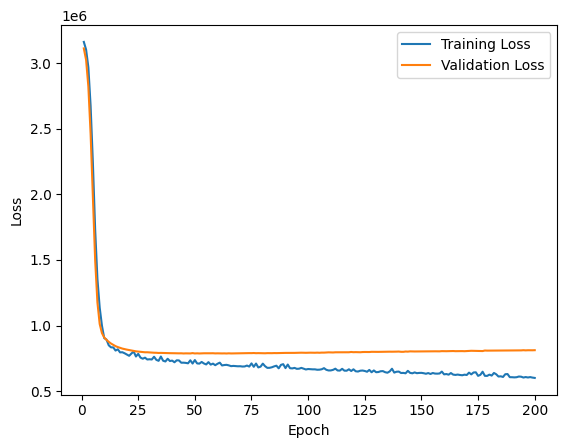

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local4_5030, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_l4_5010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local4, temp_l4_5010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l4_5010.fc1.weight.shape)
print("fc2 weight shape:", temp_l4_5010.fc2.weight.shape)
print("fc3 weight shape:", temp_l4_5010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l4_5010 = temp_l4_5010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l4_5010 = apply_pca_and_reshape(original_fc1_weights_l4_5010,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l4_5010.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l4_5010 = temp_l4_5010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l4_5010 = apply_pca_and_reshape(original_fc2_weights_l4_5010,
                                                        10)

# Instantiate the compressed model
PCA_local4_5010 = CompressedRegressionNN(58, 50, 10, 1)

# Assign the PCA-transformed weights
PCA_local4_5010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l4_5010).float().view(50, 58)
PCA_local4_5010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l4_5010).float().view(10, 50)

# Reset biases
PCA_local4_5010.fc1.bias.data.fill_(0)
PCA_local4_5010.fc2.bias.data.fill_(0)
PCA_local4_5010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local4_5010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local4_5010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local4_5010.fc3.weight.shape)
print()
print(PCA_local4_5010)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([10, 50])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local4_5010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131076.7677, Average MAE: 1498.9338


Epoch [1/200], MSE Loss (Train): 3277117.769, MAE Loss (Train): 1538.531
Validation Loss: 3127376.308, Validation MAE: 1497.660
Epoch [2/200], MSE Loss (Train): 3172801.007, MAE Loss (Train): 1510.562
Validation Loss: 3101395.769, Validation MAE: 1489.344
Epoch [3/200], MSE Loss (Train): 3119278.334, MAE Loss (Train): 1498.744
Validation Loss: 3044446.865, Validation MAE: 1471.183
Epoch [4/200], MSE Loss (Train): 3041011.901, MAE Loss (Train): 1474.235
Validation Loss: 2935822.250, Validation MAE: 1436.215
Epoch [5/200], MSE Loss (Train): 2910168.952, MAE Loss (Train): 1432.380
Validation Loss: 2748683.154, Validation MAE: 1373.828
Epoch [6/200], MSE Loss (Train): 2640527.690, MAE Loss (Train): 1341.864
Validation Loss: 2479919.327, Validation MAE: 1278.494
Epoch [7/200], MSE Loss (Train): 2436199.659, MAE Loss (Train): 1250.892
Validation Loss: 2156066.846, Validation MAE: 1151.965
Epoch [8/200], MSE Loss (Train): 1976987.067, MAE Loss (Train): 1083.220
Validation Loss: 1818643.269, V

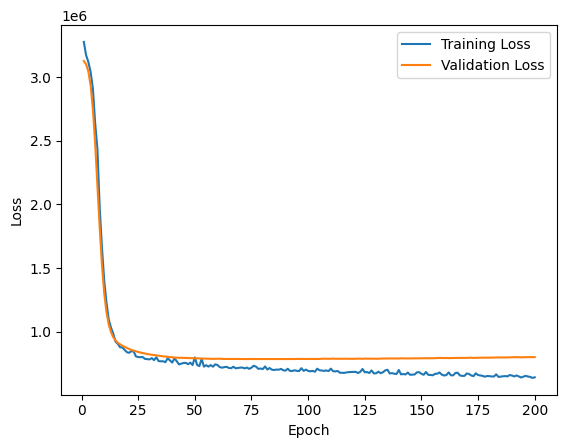

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local4_5010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_l4_505 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local4, temp_l4_505)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l4_505.fc1.weight.shape)
print("fc2 weight shape:", temp_l4_505.fc2.weight.shape)
print("fc3 weight shape:", temp_l4_505.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l4_505 = temp_l4_505.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l4_505 = apply_pca_and_reshape(original_fc1_weights_l4_505,
                                                       50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l4_505.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l4_505 = temp_l4_505.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l4_505 = apply_pca_and_reshape(original_fc2_weights_l4_505,
                                                       5)

# Instantiate the compressed model
PCA_local4_505 = CompressedRegressionNN(58, 50, 5, 1)

# Assign the PCA-transformed weights
PCA_local4_505.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l4_505).float().view(50, 58)
PCA_local4_505.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l4_505).float().view(5, 50)

# Reset biases
PCA_local4_505.fc1.bias.data.fill_(0)
PCA_local4_505.fc2.bias.data.fill_(0)
PCA_local4_505.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local4_505.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local4_505.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local4_505.fc3.weight.shape)
print()
print(PCA_local4_505)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([5, 50])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local4_505, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3129261.0721, Average MAE: 1498.3217


Epoch [1/200], MSE Loss (Train): 3225413.663, MAE Loss (Train): 1529.838
Validation Loss: 3124589.077, Validation MAE: 1496.680
Epoch [2/200], MSE Loss (Train): 3195571.389, MAE Loss (Train): 1521.138
Validation Loss: 3098976.077, Validation MAE: 1488.354
Epoch [3/200], MSE Loss (Train): 3114612.159, MAE Loss (Train): 1499.083
Validation Loss: 3048137.596, Validation MAE: 1471.817
Epoch [4/200], MSE Loss (Train): 3167951.490, MAE Loss (Train): 1496.236
Validation Loss: 2957345.904, Validation MAE: 1442.098
Epoch [5/200], MSE Loss (Train): 2913366.817, MAE Loss (Train): 1431.948
Validation Loss: 2815217.500, Validation MAE: 1394.574
Epoch [6/200], MSE Loss (Train): 2735286.637, MAE Loss (Train): 1374.071
Validation Loss: 2614469.125, Validation MAE: 1324.493
Epoch [7/200], MSE Loss (Train): 2520928.471, MAE Loss (Train): 1296.450
Validation Loss: 2359036.971, Validation MAE: 1229.386
Epoch [8/200], MSE Loss (Train): 2217312.835, MAE Loss (Train): 1180.904
Validation Loss: 2069231.577, V

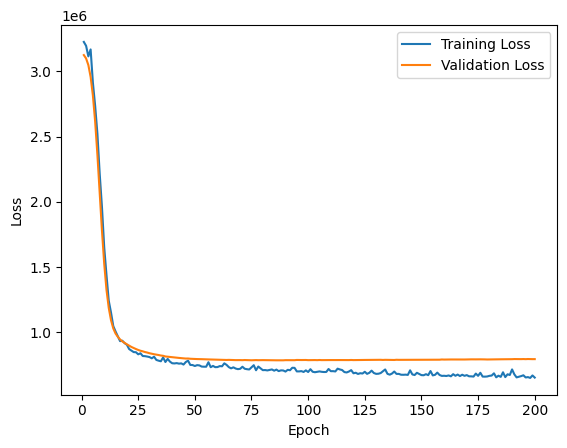

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local4_505, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_l4_3010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local4, temp_l4_3010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l4_3010.fc1.weight.shape)
print("fc2 weight shape:", temp_l4_3010.fc2.weight.shape)
print("fc3 weight shape:", temp_l4_3010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l4_3010 = temp_l4_3010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l4_3010 = apply_pca_and_reshape(original_fc1_weights_l4_3010,
                                                        30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l4_3010.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l4_3010 = temp_l4_3010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l4_3010 = apply_pca_and_reshape(original_fc2_weights_l4_3010,
                                                        10)

# Instantiate the compressed model
PCA_local4_3010 = CompressedRegressionNN(58, 30, 10, 1)

# Assign the PCA-transformed weights
PCA_local4_3010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l4_3010).float().view(30, 58)
PCA_local4_3010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l4_3010).float().view(10, 30)

# Reset biases
PCA_local4_3010.fc1.bias.data.fill_(0)
PCA_local4_3010.fc2.bias.data.fill_(0)
PCA_local4_3010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local4_3010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local4_3010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local4_3010.fc3.weight.shape)
print()
print(PCA_local4_3010)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([10, 30])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local4_3010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131138.6644, Average MAE: 1498.9541


Epoch [1/200], MSE Loss (Train): 3156041.858, MAE Loss (Train): 1510.367
Validation Loss: 3125518.865, Validation MAE: 1497.026
Epoch [2/200], MSE Loss (Train): 3170284.851, MAE Loss (Train): 1513.928
Validation Loss: 3096203.654, Validation MAE: 1487.543
Epoch [3/200], MSE Loss (Train): 3114610.466, MAE Loss (Train): 1496.962
Validation Loss: 3038958.058, Validation MAE: 1469.035
Epoch [4/200], MSE Loss (Train): 3030135.135, MAE Loss (Train): 1470.791
Validation Loss: 2940128.173, Validation MAE: 1436.737
Epoch [5/200], MSE Loss (Train): 2885643.964, MAE Loss (Train): 1424.497
Validation Loss: 2789240.779, Validation MAE: 1386.035
Epoch [6/200], MSE Loss (Train): 2773594.930, MAE Loss (Train): 1381.169
Validation Loss: 2579902.962, Validation MAE: 1312.700
Epoch [7/200], MSE Loss (Train): 2479525.649, MAE Loss (Train): 1282.834
Validation Loss: 2319713.308, Validation MAE: 1214.855
Epoch [8/200], MSE Loss (Train): 2186186.990, MAE Loss (Train): 1167.991
Validation Loss: 2029159.087, V

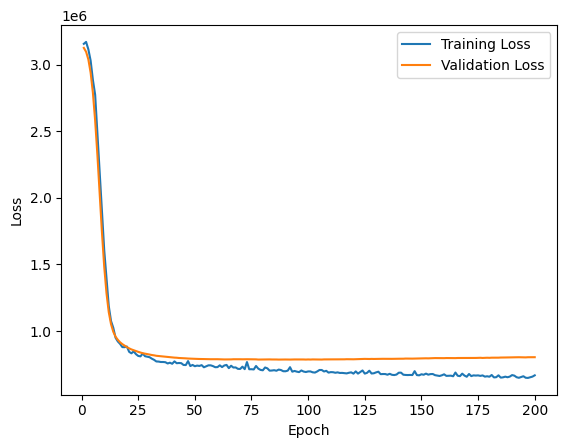

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local4_3010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_l4_305 = RegressionNN(input_size, hidden_size1,
                           hidden_size2, output_size)
transfer_pruned_weights(pruned_local4, temp_l4_305)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l4_305.fc1.weight.shape)
print("fc2 weight shape:", temp_l4_305.fc2.weight.shape)
print("fc3 weight shape:", temp_l4_305.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l4_305 = temp_l4_305.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l4_305 = apply_pca_and_reshape(original_fc1_weights_l4_305,
                                                       30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l4_305.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l4_305 = temp_l4_305.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l4_305 = apply_pca_and_reshape(original_fc2_weights_l4_305,
                                                        5)

# Instantiate the compressed model
PCA_local4_305 = CompressedRegressionNN(58, 30, 5, 1)

# Assign the PCA-transformed weights
PCA_local4_305.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l4_305).float().view(30, 58)
PCA_local4_305.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l4_305).float().view(5, 30)

# Reset biases
PCA_local4_305.fc1.bias.data.fill_(0)
PCA_local4_305.fc2.bias.data.fill_(0)
PCA_local4_305.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local4_305.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local4_305.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local4_305.fc3.weight.shape)
print()
print(PCA_local4_305)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([5, 30])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local4_305, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3133257.3435, Average MAE: 1499.5923


Epoch [1/200], MSE Loss (Train): 3217693.322, MAE Loss (Train): 1521.948
Validation Loss: 3136256.462, Validation MAE: 1500.491
Epoch [2/200], MSE Loss (Train): 3178471.356, MAE Loss (Train): 1519.073
Validation Loss: 3129518.058, Validation MAE: 1498.334
Epoch [3/200], MSE Loss (Train): 3208947.240, MAE Loss (Train): 1522.513
Validation Loss: 3116454.769, Validation MAE: 1494.150
Epoch [4/200], MSE Loss (Train): 3143841.781, MAE Loss (Train): 1509.734
Validation Loss: 3093124.135, Validation MAE: 1486.690
Epoch [5/200], MSE Loss (Train): 3111986.562, MAE Loss (Train): 1496.937
Validation Loss: 3054450.077, Validation MAE: 1474.269
Epoch [6/200], MSE Loss (Train): 3077198.721, MAE Loss (Train): 1484.422
Validation Loss: 2994992.942, Validation MAE: 1455.042
Epoch [7/200], MSE Loss (Train): 2967607.298, MAE Loss (Train): 1452.173
Validation Loss: 2910168.981, Validation MAE: 1427.237
Epoch [8/200], MSE Loss (Train): 2882549.450, MAE Loss (Train): 1424.855
Validation Loss: 2799166.183, V

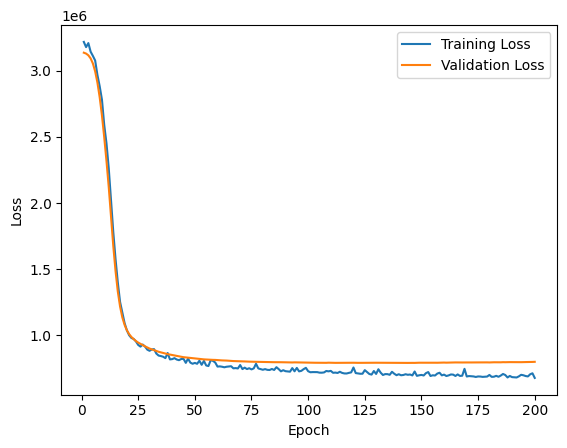

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local4_305, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=10 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_l4_105 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local4, temp_l4_105)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l4_105.fc1.weight.shape)
print("fc2 weight shape:", temp_l4_105.fc2.weight.shape)
print("fc3 weight shape:", temp_l4_105.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l4_105 = temp_l4_105.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l4_105 = apply_pca_and_reshape(original_fc1_weights_l4_105,
                                                       10)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l4_105.fc2 = nn.Linear(10, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l4_105 = temp_l4_105.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l4_105 = apply_pca_and_reshape(original_fc2_weights_l4_105,
                                                        5)

# Instantiate the compressed model
PCA_local4_105 = CompressedRegressionNN(58, 10, 5, 1)

# Assign the PCA-transformed weights
PCA_local4_105.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l4_105).float().view(10, 58)
PCA_local4_105.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l4_105).float().view(5, 10)

# Reset biases
PCA_local4_105.fc1.bias.data.fill_(0)
PCA_local4_105.fc2.bias.data.fill_(0)
PCA_local4_105.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local4_105.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local4_105.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local4_105.fc3.weight.shape)
print()
print(PCA_local4_105)

Transformed fc1 weight shape: torch.Size([10, 58])
Transformed fc2 weight shape: torch.Size([5, 10])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=10, bias=True)
  (fc2): Linear(in_features=10, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local4_105, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3125998.6730, Average MAE: 1497.2373


Epoch [1/200], MSE Loss (Train): 3164327.457, MAE Loss (Train): 1512.757
Validation Loss: 3127647.981, Validation MAE: 1497.691
Epoch [2/200], MSE Loss (Train): 3139022.849, MAE Loss (Train): 1506.663
Validation Loss: 3118568.615, Validation MAE: 1494.800
Epoch [3/200], MSE Loss (Train): 3158342.844, MAE Loss (Train): 1512.487
Validation Loss: 3103696.500, Validation MAE: 1490.072
Epoch [4/200], MSE Loss (Train): 3153789.418, MAE Loss (Train): 1507.504
Validation Loss: 3080589.673, Validation MAE: 1482.740
Epoch [5/200], MSE Loss (Train): 3079705.459, MAE Loss (Train): 1488.001
Validation Loss: 3046643.904, Validation MAE: 1471.888
Epoch [6/200], MSE Loss (Train): 3039551.007, MAE Loss (Train): 1476.417
Validation Loss: 2995417.288, Validation MAE: 1455.428
Epoch [7/200], MSE Loss (Train): 2990580.192, MAE Loss (Train): 1462.055
Validation Loss: 2923079.808, Validation MAE: 1431.772
Epoch [8/200], MSE Loss (Train): 2940223.409, MAE Loss (Train): 1441.785
Validation Loss: 2827154.269, V

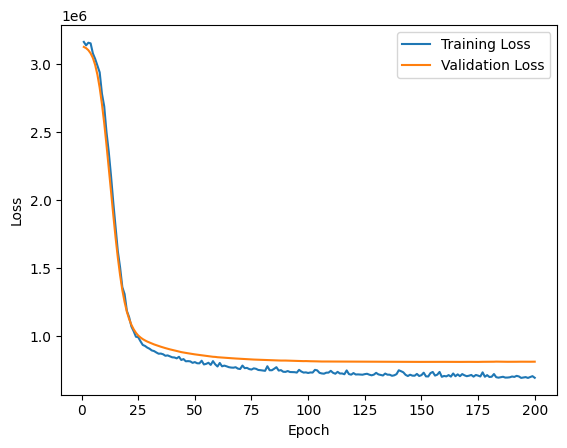

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local4_105, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### PCA on the Pruned Model, `pruned_local5`, with Pruning Amount=0.95

###### fc1 out_features=50 and fc2 out_features=30

In [ ]:
# create copy of the locally pruned model
temp_l5_5030 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local5, temp_l5_5030)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l5_5030.fc1.weight.shape)
print("fc2 weight shape:", temp_l5_5030.fc2.weight.shape)
print("fc3 weight shape:", temp_l5_5030.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l5_5030 = temp_l5_5030.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l5_5030 = apply_pca_and_reshape(original_fc1_weights_l5_5030,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l5_5030.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l5_5030 = temp_l5_5030.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l5_5030 = apply_pca_and_reshape(original_fc2_weights_l5_5030,
                                                        30)

# Instantiate the compressed model
PCA_local5_5030 = CompressedRegressionNN(58, 50, 30, 1)

# Assign the PCA-transformed weights
PCA_local5_5030.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l5_5030).float().view(50, 58)
PCA_local5_5030.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l5_5030).float().view(30, 50)

# Reset biases
PCA_local5_5030.fc1.bias.data.fill_(0)
PCA_local5_5030.fc2.bias.data.fill_(0)
PCA_local5_5030.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local5_5030.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local5_5030.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local5_5030.fc3.weight.shape)
print()
print(PCA_local5_5030)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([30, 50])
Transformed fc3 weight shape: torch.Size([1, 30])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=30, bias=True)
  (fc3): Linear(in_features=30, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local5_5030, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130647.5929, Average MAE: 1498.7536


Epoch [1/200], MSE Loss (Train): 3190505.962, MAE Loss (Train): 1517.682
Validation Loss: 3112505.212, Validation MAE: 1492.730
Epoch [2/200], MSE Loss (Train): 3125197.488, MAE Loss (Train): 1500.207
Validation Loss: 3028224.981, Validation MAE: 1465.169
Epoch [3/200], MSE Loss (Train): 3011812.135, MAE Loss (Train): 1456.531
Validation Loss: 2827190.673, Validation MAE: 1398.146
Epoch [4/200], MSE Loss (Train): 2684767.674, MAE Loss (Train): 1352.634
Validation Loss: 2472072.933, Validation MAE: 1271.762
Epoch [5/200], MSE Loss (Train): 2294908.130, MAE Loss (Train): 1199.388
Validation Loss: 1982659.615, Validation MAE: 1073.922
Epoch [6/200], MSE Loss (Train): 1766532.139, MAE Loss (Train): 979.651
Validation Loss: 1498830.351, Validation MAE: 855.857
Epoch [7/200], MSE Loss (Train): 1374897.278, MAE Loss (Train): 809.014
Validation Loss: 1166635.812, Validation MAE: 722.016
Epoch [8/200], MSE Loss (Train): 1086120.261, MAE Loss (Train): 709.466
Validation Loss: 1008793.558, Valida

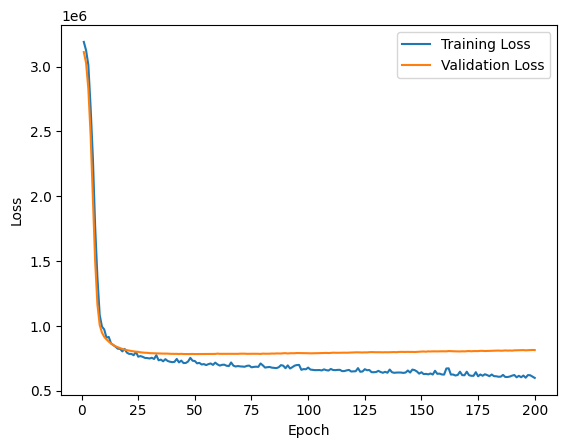

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local5_5030, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_l5_5010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local5, temp_l5_5010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l5_5010.fc1.weight.shape)
print("fc2 weight shape:", temp_l5_5010.fc2.weight.shape)
print("fc3 weight shape:", temp_l5_5010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l5_5010 = temp_l5_5010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l5_5010 = apply_pca_and_reshape(original_fc1_weights_l5_5010,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l5_5010.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l5_5010 = temp_l5_5010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l5_5010 = apply_pca_and_reshape(original_fc2_weights_l5_5010,
                                                        10)

# Instantiate the compressed model
PCA_local5_5010 = CompressedRegressionNN(58, 50, 10, 1)

# Assign the PCA-transformed weights
PCA_local5_5010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l5_5010).float().view(50, 58)
PCA_local5_5010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l5_5010).float().view(10, 50)

# Reset biases
PCA_local5_5010.fc1.bias.data.fill_(0)
PCA_local5_5010.fc2.bias.data.fill_(0)
PCA_local5_5010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local5_5010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local5_5010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local5_5010.fc3.weight.shape)
print()
print(PCA_local5_5010)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([10, 50])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local5_5010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130548.4156, Average MAE: 1498.7370


Epoch [1/200], MSE Loss (Train): 3177279.752, MAE Loss (Train): 1516.479
Validation Loss: 3126255.673, Validation MAE: 1497.302
Epoch [2/200], MSE Loss (Train): 3166281.659, MAE Loss (Train): 1514.565
Validation Loss: 3089210.269, Validation MAE: 1485.541
Epoch [3/200], MSE Loss (Train): 3131411.500, MAE Loss (Train): 1500.276
Validation Loss: 3001797.769, Validation MAE: 1457.667
Epoch [4/200], MSE Loss (Train): 3028772.111, MAE Loss (Train): 1464.309
Validation Loss: 2836811.702, Validation MAE: 1403.661
Epoch [5/200], MSE Loss (Train): 2756046.466, MAE Loss (Train): 1377.993
Validation Loss: 2579255.067, Validation MAE: 1314.389
Epoch [6/200], MSE Loss (Train): 2440200.829, MAE Loss (Train): 1267.176
Validation Loss: 2242169.558, Validation MAE: 1186.763
Epoch [7/200], MSE Loss (Train): 2074539.710, MAE Loss (Train): 1116.637
Validation Loss: 1869262.827, Validation MAE: 1030.181
Epoch [8/200], MSE Loss (Train): 1711414.897, MAE Loss (Train): 970.029
Validation Loss: 1531926.399, Va

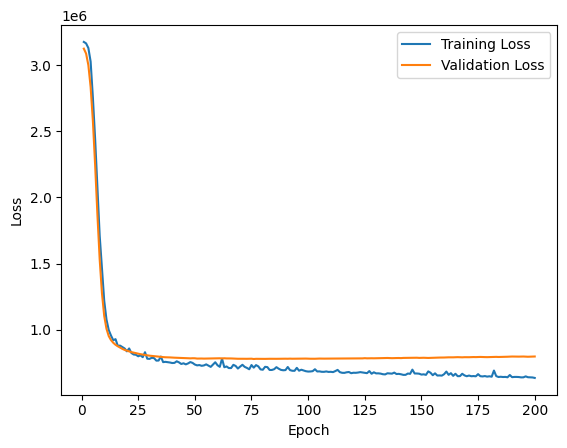

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local5_5010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_l5_505 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local5, temp_l5_505)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l5_505.fc1.weight.shape)
print("fc2 weight shape:", temp_l5_505.fc2.weight.shape)
print("fc3 weight shape:", temp_l5_505.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l5_505 = temp_l5_505.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l5_505 = apply_pca_and_reshape(original_fc1_weights_l5_505,
                                                       50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l5_505.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l5_505 = temp_l5_505.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l5_505 = apply_pca_and_reshape(original_fc2_weights_l5_505,
                                                       5)

# Instantiate the compressed model
PCA_local5_505 = CompressedRegressionNN(58, 50, 5, 1)

# Assign the PCA-transformed weights
PCA_local5_505.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l5_505).float().view(50, 58)
PCA_local5_505.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l5_505).float().view(5, 50)

# Reset biases
PCA_local5_505.fc1.bias.data.fill_(0)
PCA_local5_505.fc2.bias.data.fill_(0)
PCA_local5_505.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local5_505.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local5_505.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local5_505.fc3.weight.shape)
print()
print(PCA_local5_505)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([5, 50])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local5_505, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130621.7457, Average MAE: 1498.7405


Epoch [1/200], MSE Loss (Train): 3185738.553, MAE Loss (Train): 1520.567
Validation Loss: 3131453.596, Validation MAE: 1498.886
Epoch [2/200], MSE Loss (Train): 3276909.394, MAE Loss (Train): 1532.965
Validation Loss: 3109851.250, Validation MAE: 1491.876
Epoch [3/200], MSE Loss (Train): 3112797.209, MAE Loss (Train): 1498.808
Validation Loss: 3058273.250, Validation MAE: 1475.192
Epoch [4/200], MSE Loss (Train): 3034017.115, MAE Loss (Train): 1472.746
Validation Loss: 2956379.904, Validation MAE: 1441.863
Epoch [5/200], MSE Loss (Train): 2891326.614, MAE Loss (Train): 1423.550
Validation Loss: 2786963.760, Validation MAE: 1384.845
Epoch [6/200], MSE Loss (Train): 2688799.487, MAE Loss (Train): 1354.797
Validation Loss: 2544332.163, Validation MAE: 1298.703
Epoch [7/200], MSE Loss (Train): 2430560.500, MAE Loss (Train): 1257.119
Validation Loss: 2242388.990, Validation MAE: 1182.619
Epoch [8/200], MSE Loss (Train): 2104579.094, MAE Loss (Train): 1123.464
Validation Loss: 1916183.788, V

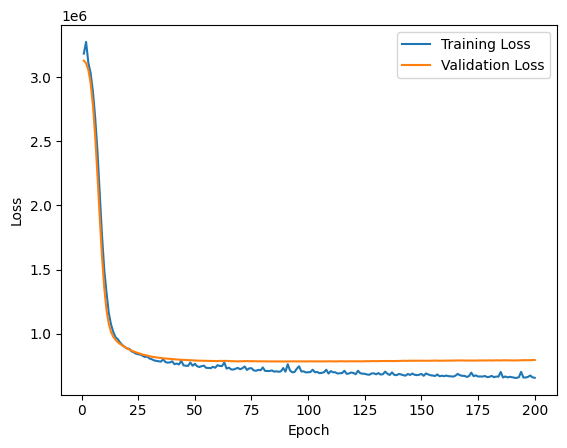

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local5_505, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_l5_3010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local5, temp_l5_3010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l5_3010.fc1.weight.shape)
print("fc2 weight shape:", temp_l5_3010.fc2.weight.shape)
print("fc3 weight shape:", temp_l5_3010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l5_3010 = temp_l5_3010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l5_3010 = apply_pca_and_reshape(original_fc1_weights_l5_3010,
                                                        30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l5_3010.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l5_3010 = temp_l5_3010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l5_3010 = apply_pca_and_reshape(original_fc2_weights_l5_3010,
                                                        10)

# Instantiate the compressed model
PCA_local5_3010 = CompressedRegressionNN(58, 30, 10, 1)

# Assign the PCA-transformed weights
PCA_local5_3010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l5_3010).float().view(30, 58)
PCA_local5_3010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l5_3010).float().view(10, 30)

# Reset biases
PCA_local5_3010.fc1.bias.data.fill_(0)
PCA_local5_3010.fc2.bias.data.fill_(0)
PCA_local5_3010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local5_3010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local5_3010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local5_3010.fc3.weight.shape)
print()
print(PCA_local5_3010)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([10, 30])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local5_3010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3133111.9346, Average MAE: 1499.5764


Epoch [1/200], MSE Loss (Train): 3194831.817, MAE Loss (Train): 1520.137
Validation Loss: 3136142.231, Validation MAE: 1500.418
Epoch [2/200], MSE Loss (Train): 3167315.481, MAE Loss (Train): 1515.897
Validation Loss: 3129830.712, Validation MAE: 1498.367
Epoch [3/200], MSE Loss (Train): 3187059.082, MAE Loss (Train): 1519.779
Validation Loss: 3117443.462, Validation MAE: 1494.384
Epoch [4/200], MSE Loss (Train): 3132756.365, MAE Loss (Train): 1504.986
Validation Loss: 3094040.038, Validation MAE: 1486.936
Epoch [5/200], MSE Loss (Train): 3095359.236, MAE Loss (Train): 1493.000
Validation Loss: 3047030.692, Validation MAE: 1471.994
Epoch [6/200], MSE Loss (Train): 3038341.094, MAE Loss (Train): 1475.388
Validation Loss: 2966048.192, Validation MAE: 1445.931
Epoch [7/200], MSE Loss (Train): 2930222.469, MAE Loss (Train): 1440.191
Validation Loss: 2841022.942, Validation MAE: 1404.750
Epoch [8/200], MSE Loss (Train): 2790366.964, MAE Loss (Train): 1390.939
Validation Loss: 2658680.423, V

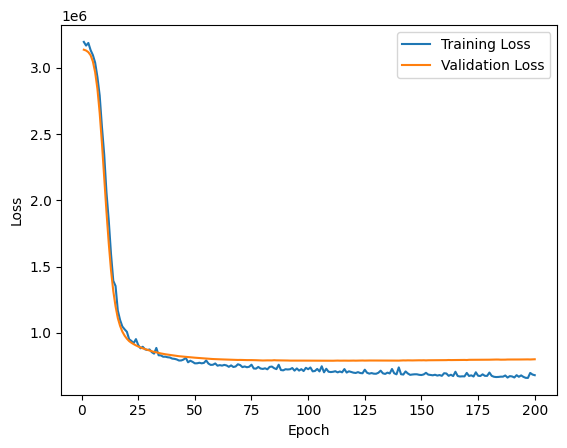

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local5_3010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_l5_305 = RegressionNN(input_size, hidden_size1,
                           hidden_size2, output_size)
transfer_pruned_weights(pruned_local5, temp_l5_305)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l5_305.fc1.weight.shape)
print("fc2 weight shape:", temp_l5_305.fc2.weight.shape)
print("fc3 weight shape:", temp_l5_305.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l5_305 = temp_l5_305.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l5_305 = apply_pca_and_reshape(original_fc1_weights_l5_305,
                                                       30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l5_305.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l5_305 = temp_l5_305.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l5_305 = apply_pca_and_reshape(original_fc2_weights_l5_305,
                                                        5)

# Instantiate the compressed model
PCA_local5_305 = CompressedRegressionNN(58, 30, 5, 1)

# Assign the PCA-transformed weights
PCA_local5_305.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l5_305).float().view(30, 58)
PCA_local5_305.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l5_305).float().view(5, 30)

# Reset biases
PCA_local5_305.fc1.bias.data.fill_(0)
PCA_local5_305.fc2.bias.data.fill_(0)
PCA_local5_305.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local5_305.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local5_305.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local5_305.fc3.weight.shape)
print()
print(PCA_local5_305)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([5, 30])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local5_305, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130147.0312, Average MAE: 1498.6195


Epoch [1/200], MSE Loss (Train): 3162865.240, MAE Loss (Train): 1514.433
Validation Loss: 3131044.635, Validation MAE: 1498.800
Epoch [2/200], MSE Loss (Train): 3178659.216, MAE Loss (Train): 1516.886
Validation Loss: 3116532.096, Validation MAE: 1494.145
Epoch [3/200], MSE Loss (Train): 3153158.591, MAE Loss (Train): 1508.708
Validation Loss: 3087018.962, Validation MAE: 1484.744
Epoch [4/200], MSE Loss (Train): 3084884.671, MAE Loss (Train): 1488.722
Validation Loss: 3034198.019, Validation MAE: 1467.916
Epoch [5/200], MSE Loss (Train): 3051276.062, MAE Loss (Train): 1478.612
Validation Loss: 2948221.481, Validation MAE: 1440.213
Epoch [6/200], MSE Loss (Train): 2981223.928, MAE Loss (Train): 1448.579
Validation Loss: 2821657.740, Validation MAE: 1398.407
Epoch [7/200], MSE Loss (Train): 2763898.356, MAE Loss (Train): 1383.384
Validation Loss: 2653106.135, Validation MAE: 1340.360
Epoch [8/200], MSE Loss (Train): 2623945.623, MAE Loss (Train): 1322.037
Validation Loss: 2447736.173, V

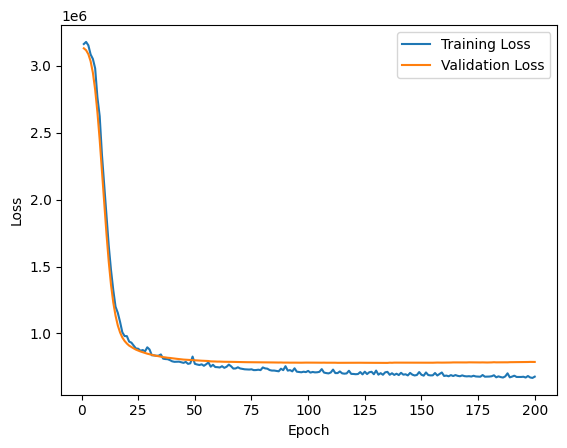

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local5_305, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=10 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_l5_105 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_local5, temp_l5_105)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l5_105.fc1.weight.shape)
print("fc2 weight shape:", temp_l5_105.fc2.weight.shape)
print("fc3 weight shape:", temp_l5_105.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_l5_105 = temp_l5_105.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_l5_105 = apply_pca_and_reshape(original_fc1_weights_l5_105,
                                                       10)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l5_105.fc2 = nn.Linear(10, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_l5_105 = temp_l5_105.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_l5_105 = apply_pca_and_reshape(original_fc2_weights_l5_105,
                                                        5)

# Instantiate the compressed model
PCA_local5_105 = CompressedRegressionNN(58, 10, 5, 1)

# Assign the PCA-transformed weights
PCA_local5_105.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_l5_105).float().view(10, 58)
PCA_local5_105.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_l5_105).float().view(5, 10)

# Reset biases
PCA_local5_105.fc1.bias.data.fill_(0)
PCA_local5_105.fc2.bias.data.fill_(0)
PCA_local5_105.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_local5_105.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_local5_105.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_local5_105.fc3.weight.shape)
print()
print(PCA_local5_105)

Transformed fc1 weight shape: torch.Size([10, 58])
Transformed fc2 weight shape: torch.Size([5, 10])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=10, bias=True)
  (fc2): Linear(in_features=10, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_local5_105, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130900.0416, Average MAE: 1498.8099


Epoch [1/200], MSE Loss (Train): 3217291.053, MAE Loss (Train): 1526.209
Validation Loss: 3135090.635, Validation MAE: 1500.043
Epoch [2/200], MSE Loss (Train): 3198240.613, MAE Loss (Train): 1522.800
Validation Loss: 3130592.077, Validation MAE: 1498.537
Epoch [3/200], MSE Loss (Train): 3142997.084, MAE Loss (Train): 1506.190
Validation Loss: 3122767.750, Validation MAE: 1495.943
Epoch [4/200], MSE Loss (Train): 3140781.892, MAE Loss (Train): 1507.828
Validation Loss: 3109747.231, Validation MAE: 1491.636
Epoch [5/200], MSE Loss (Train): 3196307.394, MAE Loss (Train): 1516.739
Validation Loss: 3088587.173, Validation MAE: 1484.683
Epoch [6/200], MSE Loss (Train): 3092681.094, MAE Loss (Train): 1491.650
Validation Loss: 3054129.692, Validation MAE: 1473.401
Epoch [7/200], MSE Loss (Train): 3107647.733, MAE Loss (Train): 1490.858
Validation Loss: 3001753.731, Validation MAE: 1456.172
Epoch [8/200], MSE Loss (Train): 3003474.702, MAE Loss (Train): 1462.886
Validation Loss: 2928803.827, V

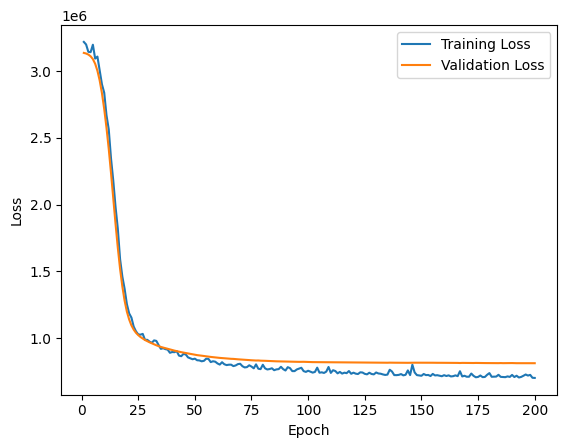

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_local5_105, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

### PCA on Layer-Wise Locally Pruned Models

#### PCA on the Pruned Model, `pruned_sparse1`, with Pruning Amount=0.6

###### fc1 out_features=50 and fc2 out_features=30

In [ ]:
# create copy of the locally pruned model
temp_sl1_5030 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse1, temp_sl1_5030)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl1_5030.fc1.weight.shape)
print("fc2 weight shape:", temp_sl1_5030.fc2.weight.shape)
print("fc3 weight shape:", temp_sl1_5030.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl1_5030 = temp_sl1_5030.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl1_5030 = apply_pca_and_reshape(original_fc1_weights_sl1_5030,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl1_5030.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl1_5030 = temp_sl1_5030.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl1_5030 = apply_pca_and_reshape(original_fc2_weights_sl1_5030,
                                                        30)

# Instantiate the compressed model
PCA_sparse1_5030 = CompressedRegressionNN(58, 50, 30, 1)

# Assign the PCA-transformed weights
PCA_sparse1_5030.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl1_5030).float().view(50, 58)
PCA_sparse1_5030.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl1_5030).float().view(30, 50)

# Reset biases
PCA_sparse1_5030.fc1.bias.data.fill_(0)
PCA_sparse1_5030.fc2.bias.data.fill_(0)
PCA_sparse1_5030.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse1_5030.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse1_5030.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse1_5030.fc3.weight.shape)
print()
print(PCA_sparse1_5030)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([30, 50])
Transformed fc3 weight shape: torch.Size([1, 30])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=30, bias=True)
  (fc3): Linear(in_features=30, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse1_5030, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130530.9108, Average MAE: 1498.7333


Epoch [1/200], MSE Loss (Train): 3149426.940, MAE Loss (Train): 1510.351
Validation Loss: 3101421.038, Validation MAE: 1488.719
Epoch [2/200], MSE Loss (Train): 3067289.903, MAE Loss (Train): 1482.993
Validation Loss: 2981827.462, Validation MAE: 1448.153
Epoch [3/200], MSE Loss (Train): 2878673.554, MAE Loss (Train): 1418.963
Validation Loss: 2716234.250, Validation MAE: 1355.156
Epoch [4/200], MSE Loss (Train): 2568120.909, MAE Loss (Train): 1306.379
Validation Loss: 2278189.875, Validation MAE: 1188.344
Epoch [5/200], MSE Loss (Train): 2039675.904, MAE Loss (Train): 1098.683
Validation Loss: 1743513.048, Validation MAE: 954.112
Epoch [6/200], MSE Loss (Train): 1485817.315, MAE Loss (Train): 855.182
Validation Loss: 1286059.067, Validation MAE: 752.096
Epoch [7/200], MSE Loss (Train): 1171494.881, MAE Loss (Train): 713.838
Validation Loss: 1034286.639, Validation MAE: 671.244
Epoch [8/200], MSE Loss (Train): 937380.358, MAE Loss (Train): 655.446
Validation Loss: 938904.894, Validatio

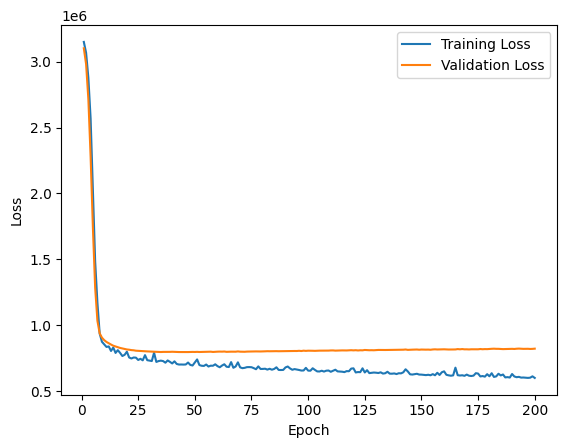

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse1_5030, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_sl1_5010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse1, temp_sl1_5010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl1_5010.fc1.weight.shape)
print("fc2 weight shape:", temp_sl1_5010.fc2.weight.shape)
print("fc3 weight shape:", temp_sl1_5010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl1_5010 = temp_sl1_5010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl1_5010 = apply_pca_and_reshape(original_fc1_weights_sl1_5010,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl1_5010.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl1_5010 = temp_sl1_5010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl1_5010 = apply_pca_and_reshape(original_fc2_weights_sl1_5010,
                                                        10)

# Instantiate the compressed model
PCA_sparse1_5010 = CompressedRegressionNN(58, 50, 10, 1)

# Assign the PCA-transformed weights
PCA_sparse1_5010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl1_5010).float().view(50, 58)
PCA_sparse1_5010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl1_5010).float().view(10, 50)

# Reset biases
PCA_sparse1_5010.fc1.bias.data.fill_(0)
PCA_sparse1_5010.fc2.bias.data.fill_(0)
PCA_sparse1_5010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse1_5010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse1_5010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse1_5010.fc3.weight.shape)
print()
print(PCA_sparse1_5010)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([10, 50])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse1_5010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130921.5122, Average MAE: 1498.8223


Epoch [1/200], MSE Loss (Train): 3170201.202, MAE Loss (Train): 1515.268
Validation Loss: 3123626.942, Validation MAE: 1496.274
Epoch [2/200], MSE Loss (Train): 3159259.726, MAE Loss (Train): 1512.146
Validation Loss: 3084932.635, Validation MAE: 1483.419
Epoch [3/200], MSE Loss (Train): 3111227.750, MAE Loss (Train): 1495.152
Validation Loss: 2999809.404, Validation MAE: 1455.143
Epoch [4/200], MSE Loss (Train): 3035882.757, MAE Loss (Train): 1461.890
Validation Loss: 2848187.885, Validation MAE: 1403.991
Epoch [5/200], MSE Loss (Train): 2779843.587, MAE Loss (Train): 1384.856
Validation Loss: 2617118.567, Validation MAE: 1322.882
Epoch [6/200], MSE Loss (Train): 2483838.911, MAE Loss (Train): 1284.121
Validation Loss: 2311395.981, Validation MAE: 1207.709
Epoch [7/200], MSE Loss (Train): 2186962.709, MAE Loss (Train): 1161.385
Validation Loss: 1961565.635, Validation MAE: 1061.426
Epoch [8/200], MSE Loss (Train): 1805474.053, MAE Loss (Train): 1003.864
Validation Loss: 1611925.000, V

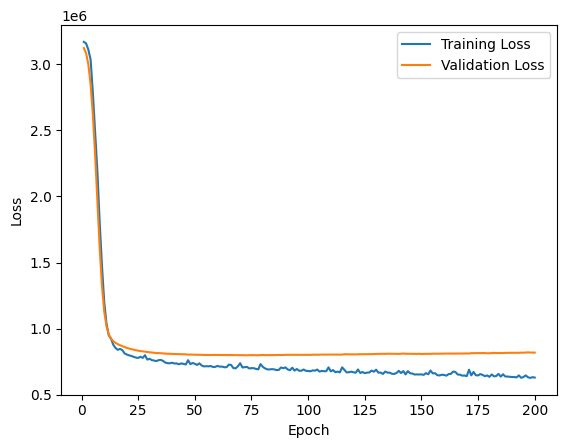

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse1_5010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_sl1_505 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse1, temp_sl1_505)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl1_505.fc1.weight.shape)
print("fc2 weight shape:", temp_sl1_505.fc2.weight.shape)
print("fc3 weight shape:", temp_sl1_505.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl1_505 = temp_sl1_505.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl1_505 = apply_pca_and_reshape(original_fc1_weights_sl1_505,
                                                       50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl1_505.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl1_505 = temp_sl1_505.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl1_505 = apply_pca_and_reshape(original_fc2_weights_sl1_505,
                                                       5)

# Instantiate the compressed model
PCA_sparse1_505 = CompressedRegressionNN(58, 50, 5, 1)

# Assign the PCA-transformed weights
PCA_sparse1_505.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl1_505).float().view(50, 58)
PCA_sparse1_505.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl1_505).float().view(5, 50)

# Reset biases
PCA_sparse1_505.fc1.bias.data.fill_(0)
PCA_sparse1_505.fc2.bias.data.fill_(0)
PCA_sparse1_505.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse1_505.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse1_505.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse1_505.fc3.weight.shape)
print()
print(PCA_sparse1_505)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([5, 50])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse1_505, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3129749.5520, Average MAE: 1498.3383


Epoch [1/200], MSE Loss (Train): 3155189.493, MAE Loss (Train): 1512.600
Validation Loss: 3124798.019, Validation MAE: 1496.368
Epoch [2/200], MSE Loss (Train): 3140424.954, MAE Loss (Train): 1507.496
Validation Loss: 3100611.423, Validation MAE: 1488.182
Epoch [3/200], MSE Loss (Train): 3186270.394, MAE Loss (Train): 1514.779
Validation Loss: 3056448.846, Validation MAE: 1473.318
Epoch [4/200], MSE Loss (Train): 3154406.442, MAE Loss (Train): 1497.267
Validation Loss: 2983265.269, Validation MAE: 1448.681
Epoch [5/200], MSE Loss (Train): 2944283.268, MAE Loss (Train): 1442.186
Validation Loss: 2873817.404, Validation MAE: 1411.503
Epoch [6/200], MSE Loss (Train): 2895228.738, MAE Loss (Train): 1415.980
Validation Loss: 2720898.413, Validation MAE: 1358.144
Epoch [7/200], MSE Loss (Train): 2701287.204, MAE Loss (Train): 1345.641
Validation Loss: 2519805.529, Validation MAE: 1284.935
Epoch [8/200], MSE Loss (Train): 2456584.108, MAE Loss (Train): 1266.351
Validation Loss: 2281068.288, V

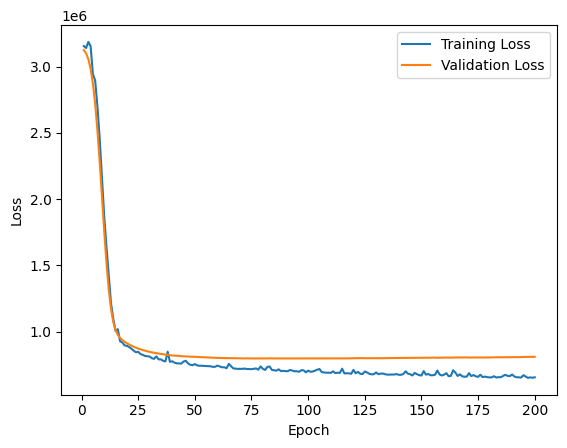

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse1_505, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_sl1_3010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse1, temp_sl1_3010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_l1_3010.fc1.weight.shape)
print("fc2 weight shape:", temp_l1_3010.fc2.weight.shape)
print("fc3 weight shape:", temp_l1_3010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 30])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl1_3010 = temp_l1_3010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl1_3010 = apply_pca_and_reshape(original_fc1_weights_sl1_3010,
                                                        30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_l1_3010.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl1_3010 = temp_l1_3010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl1_3010 = apply_pca_and_reshape(original_fc2_weights_sl1_3010,
                                                        10)

# Instantiate the compressed model
PCA_sparse1_3010 = CompressedRegressionNN(58, 30, 10, 1)

# Assign the PCA-transformed weights
PCA_sparse1_3010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl1_3010).float().view(30, 58)
PCA_sparse1_3010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl1_3010).float().view(10, 30)

# Reset biases
PCA_sparse1_3010.fc1.bias.data.fill_(0)
PCA_sparse1_3010.fc2.bias.data.fill_(0)
PCA_sparse1_3010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse1_3010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse1_3010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse1_3010.fc3.weight.shape)
print()
print(PCA_sparse1_3010)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([10, 30])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse1_3010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132805.0483, Average MAE: 1499.4593


Epoch [1/200], MSE Loss (Train): 3148958.447, MAE Loss (Train): 1509.107
Validation Loss: 3132184.808, Validation MAE: 1499.260
Epoch [2/200], MSE Loss (Train): 3170145.332, MAE Loss (Train): 1514.890
Validation Loss: 3113763.596, Validation MAE: 1493.458
Epoch [3/200], MSE Loss (Train): 3227072.913, MAE Loss (Train): 1524.786
Validation Loss: 3072237.404, Validation MAE: 1480.253
Epoch [4/200], MSE Loss (Train): 3068159.079, MAE Loss (Train): 1485.151
Validation Loss: 2998245.692, Validation MAE: 1456.513
Epoch [5/200], MSE Loss (Train): 2968167.135, MAE Loss (Train): 1450.734
Validation Loss: 2884408.135, Validation MAE: 1419.345
Epoch [6/200], MSE Loss (Train): 2826344.793, MAE Loss (Train): 1406.828
Validation Loss: 2724732.663, Validation MAE: 1365.654
Epoch [7/200], MSE Loss (Train): 2704937.596, MAE Loss (Train): 1357.713
Validation Loss: 2519234.731, Validation MAE: 1293.071
Epoch [8/200], MSE Loss (Train): 2473020.413, MAE Loss (Train): 1274.725
Validation Loss: 2278006.769, V

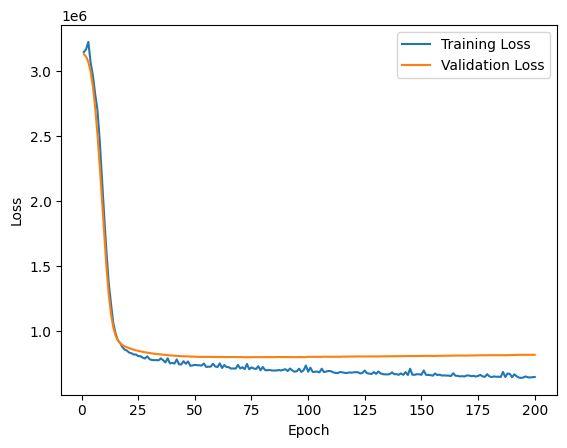

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse1_3010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_sl1_305 = RegressionNN(input_size, hidden_size1,
                           hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse1, temp_sl1_305)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl1_305.fc1.weight.shape)
print("fc2 weight shape:", temp_sl1_305.fc2.weight.shape)
print("fc3 weight shape:", temp_sl1_305.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl1_305 = temp_sl1_305.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl1_305 = apply_pca_and_reshape(original_fc1_weights_sl1_305,
                                                       30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl1_305.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl1_305 = temp_sl1_305.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl1_305 = apply_pca_and_reshape(original_fc2_weights_sl1_305,
                                                        5)

# Instantiate the compressed model
PCA_sparse1_305 = CompressedRegressionNN(58, 30, 5, 1)

# Assign the PCA-transformed weights
PCA_sparse1_305.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl1_305).float().view(30, 58)
PCA_sparse1_305.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl1_305).float().view(5, 30)

# Reset biases
PCA_sparse1_305.fc1.bias.data.fill_(0)
PCA_sparse1_305.fc2.bias.data.fill_(0)
PCA_sparse1_305.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse1_305.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse1_305.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse1_305.fc3.weight.shape)
print()
print(PCA_sparse1_305)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([5, 30])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse1_305, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132075.2445, Average MAE: 1499.3273


Epoch [1/200], MSE Loss (Train): 3155118.060, MAE Loss (Train): 1512.658
Validation Loss: 3129519.519, Validation MAE: 1498.299
Epoch [2/200], MSE Loss (Train): 3172345.793, MAE Loss (Train): 1513.599
Validation Loss: 3110218.558, Validation MAE: 1491.866
Epoch [3/200], MSE Loss (Train): 3137066.567, MAE Loss (Train): 1505.163
Validation Loss: 3077285.904, Validation MAE: 1480.920
Epoch [4/200], MSE Loss (Train): 3082386.200, MAE Loss (Train): 1488.398
Validation Loss: 3026886.250, Validation MAE: 1464.133
Epoch [5/200], MSE Loss (Train): 3015974.127, MAE Loss (Train): 1466.806
Validation Loss: 2952877.538, Validation MAE: 1439.389
Epoch [6/200], MSE Loss (Train): 2956050.221, MAE Loss (Train): 1445.156
Validation Loss: 2851073.135, Validation MAE: 1404.792
Epoch [7/200], MSE Loss (Train): 2800845.397, MAE Loss (Train): 1396.705
Validation Loss: 2717529.577, Validation MAE: 1358.397
Epoch [8/200], MSE Loss (Train): 2666799.856, MAE Loss (Train): 1346.991
Validation Loss: 2553254.471, V

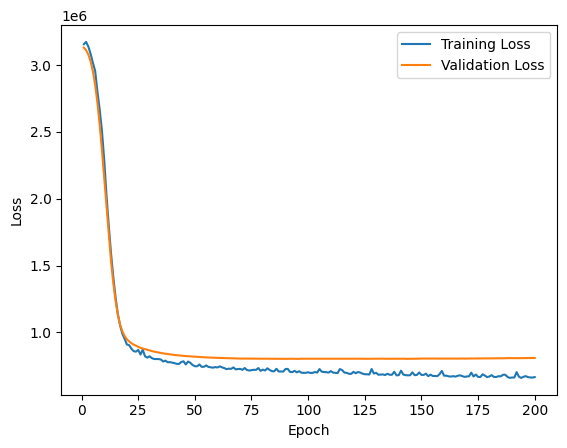

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse1_305, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=10 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_sl1_105 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse1, temp_sl1_105)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl1_105.fc1.weight.shape)
print("fc2 weight shape:", temp_sl1_105.fc2.weight.shape)
print("fc3 weight shape:", temp_sl1_105.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl1_105 = temp_sl1_105.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl1_105 = apply_pca_and_reshape(original_fc1_weights_sl1_105,
                                                       10)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl1_105.fc2 = nn.Linear(10, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl1_105 = temp_sl1_105.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl1_105 = apply_pca_and_reshape(original_fc2_weights_sl1_105,
                                                        5)

# Instantiate the compressed model
PCA_sparse1_105 = CompressedRegressionNN(58, 10, 5, 1)

# Assign the PCA-transformed weights
PCA_sparse1_105.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl1_105).float().view(10, 58)
PCA_sparse1_105.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl1_105).float().view(5, 10)

# Reset biases
PCA_sparse1_105.fc1.bias.data.fill_(0)
PCA_sparse1_105.fc2.bias.data.fill_(0)
PCA_sparse1_105.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse1_105.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse1_105.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse1_105.fc3.weight.shape)
print()
print(PCA_sparse1_105)

Transformed fc1 weight shape: torch.Size([10, 58])
Transformed fc2 weight shape: torch.Size([5, 10])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=10, bias=True)
  (fc2): Linear(in_features=10, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse1_105, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3128796.6724, Average MAE: 1497.9826


Epoch [1/200], MSE Loss (Train): 3174121.724, MAE Loss (Train): 1518.151
Validation Loss: 3130034.135, Validation MAE: 1498.182
Epoch [2/200], MSE Loss (Train): 3181056.183, MAE Loss (Train): 1517.267
Validation Loss: 3121138.154, Validation MAE: 1495.125
Epoch [3/200], MSE Loss (Train): 3150704.707, MAE Loss (Train): 1509.991
Validation Loss: 3106745.654, Validation MAE: 1490.161
Epoch [4/200], MSE Loss (Train): 3125506.690, MAE Loss (Train): 1501.430
Validation Loss: 3084290.192, Validation MAE: 1482.379
Epoch [5/200], MSE Loss (Train): 3101928.793, MAE Loss (Train): 1495.291
Validation Loss: 3052339.904, Validation MAE: 1471.264
Epoch [6/200], MSE Loss (Train): 3043296.108, MAE Loss (Train): 1475.412
Validation Loss: 3010679.327, Validation MAE: 1456.683
Epoch [7/200], MSE Loss (Train): 3035797.226, MAE Loss (Train): 1470.449
Validation Loss: 2957048.423, Validation MAE: 1437.856
Epoch [8/200], MSE Loss (Train): 2956629.558, MAE Loss (Train): 1444.184
Validation Loss: 2891251.096, V

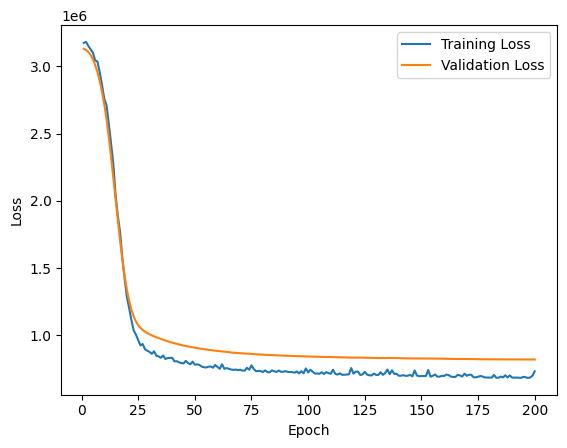

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse1_105, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### PCA on the Pruned Model, `pruned_sparse2`, with Pruning Amount=0.7

###### fc1 out_features=50 and fc2 out_features=30

In [ ]:
# create copy of the locally pruned model
temp_sl2_5030 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse2, temp_sl2_5030)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl2_5030.fc1.weight.shape)
print("fc2 weight shape:", temp_sl2_5030.fc2.weight.shape)
print("fc3 weight shape:", temp_sl2_5030.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl2_5030 = temp_sl2_5030.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl2_5030 = apply_pca_and_reshape(original_fc1_weights_sl2_5030,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl2_5030.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl2_5030 = temp_sl2_5030.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl2_5030 = apply_pca_and_reshape(original_fc2_weights_sl2_5030,
                                                        30)

# Instantiate the compressed model
PCA_sparse2_5030 = CompressedRegressionNN(58, 50, 30, 1)

# Assign the PCA-transformed weights
PCA_sparse2_5030.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl2_5030).float().view(50, 58)
PCA_sparse2_5030.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl2_5030).float().view(30, 50)

# Reset biases
PCA_sparse2_5030.fc1.bias.data.fill_(0)
PCA_sparse2_5030.fc2.bias.data.fill_(0)
PCA_sparse2_5030.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse2_5030.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse2_5030.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse2_5030.fc3.weight.shape)
print()
print(PCA_sparse2_5030)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([30, 50])
Transformed fc3 weight shape: torch.Size([1, 30])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=30, bias=True)
  (fc3): Linear(in_features=30, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse2_5030, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131263.8282, Average MAE: 1498.9153


Epoch [1/200], MSE Loss (Train): 3170925.471, MAE Loss (Train): 1513.467
Validation Loss: 3109167.269, Validation MAE: 1491.173
Epoch [2/200], MSE Loss (Train): 3109248.478, MAE Loss (Train): 1497.534
Validation Loss: 3009911.481, Validation MAE: 1457.496
Epoch [3/200], MSE Loss (Train): 2951204.726, MAE Loss (Train): 1444.078
Validation Loss: 2790699.923, Validation MAE: 1381.466
Epoch [4/200], MSE Loss (Train): 2636665.331, MAE Loss (Train): 1334.026
Validation Loss: 2426715.779, Validation MAE: 1246.588
Epoch [5/200], MSE Loss (Train): 2241117.793, MAE Loss (Train): 1170.273
Validation Loss: 1951609.635, Validation MAE: 1047.463
Epoch [6/200], MSE Loss (Train): 1701902.436, MAE Loss (Train): 947.925
Validation Loss: 1482052.486, Validation MAE: 831.753
Epoch [7/200], MSE Loss (Train): 1276033.324, MAE Loss (Train): 761.134
Validation Loss: 1146584.615, Validation MAE: 699.897
Epoch [8/200], MSE Loss (Train): 1020916.834, MAE Loss (Train): 675.187
Validation Loss: 983753.091, Validat

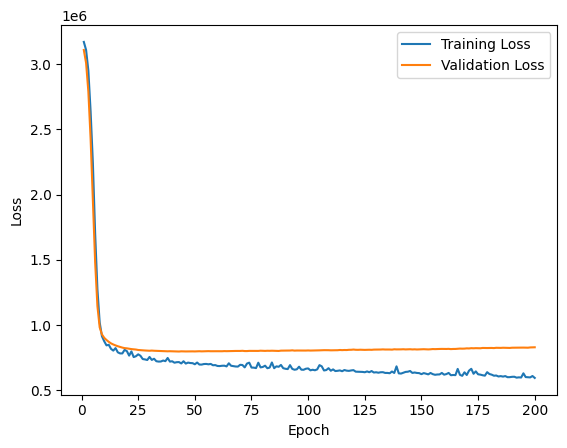

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse2_5030, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_sl2_5010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse2, temp_sl2_5010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl2_5010.fc1.weight.shape)
print("fc2 weight shape:", temp_sl2_5010.fc2.weight.shape)
print("fc3 weight shape:", temp_sl2_5010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl2_5010 = temp_sl2_5010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl2_5010 = apply_pca_and_reshape(original_fc1_weights_sl2_5010,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl2_5010.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl2_5010 = temp_sl2_5010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl2_5010 = apply_pca_and_reshape(original_fc2_weights_sl2_5010,
                                                        10)

# Instantiate the compressed model
PCA_sparse2_5010 = CompressedRegressionNN(58, 50, 10, 1)

# Assign the PCA-transformed weights
PCA_sparse2_5010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl2_5010).float().view(50, 58)
PCA_sparse2_5010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl2_5010).float().view(10, 50)

# Reset biases
PCA_sparse2_5010.fc1.bias.data.fill_(0)
PCA_sparse2_5010.fc2.bias.data.fill_(0)
PCA_sparse2_5010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse2_5010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse2_5010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse2_5010.fc3.weight.shape)
print()
print(PCA_sparse2_5010)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([10, 50])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse2_5010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132163.1253, Average MAE: 1499.2754


Epoch [1/200], MSE Loss (Train): 3157985.224, MAE Loss (Train): 1513.750
Validation Loss: 3125760.788, Validation MAE: 1496.918
Epoch [2/200], MSE Loss (Train): 3142455.930, MAE Loss (Train): 1505.974
Validation Loss: 3092019.423, Validation MAE: 1485.634
Epoch [3/200], MSE Loss (Train): 3160143.726, MAE Loss (Train): 1502.960
Validation Loss: 3018860.500, Validation MAE: 1461.180
Epoch [4/200], MSE Loss (Train): 2973117.661, MAE Loss (Train): 1452.247
Validation Loss: 2888204.115, Validation MAE: 1416.869
Epoch [5/200], MSE Loss (Train): 2868828.700, MAE Loss (Train): 1409.608
Validation Loss: 2684657.135, Validation MAE: 1345.388
Epoch [6/200], MSE Loss (Train): 2557002.368, MAE Loss (Train): 1306.176
Validation Loss: 2409349.365, Validation MAE: 1242.567
Epoch [7/200], MSE Loss (Train): 2294021.481, MAE Loss (Train): 1200.022
Validation Loss: 2083242.808, Validation MAE: 1108.475
Epoch [8/200], MSE Loss (Train): 1920367.243, MAE Loss (Train): 1046.142
Validation Loss: 1745576.788, V

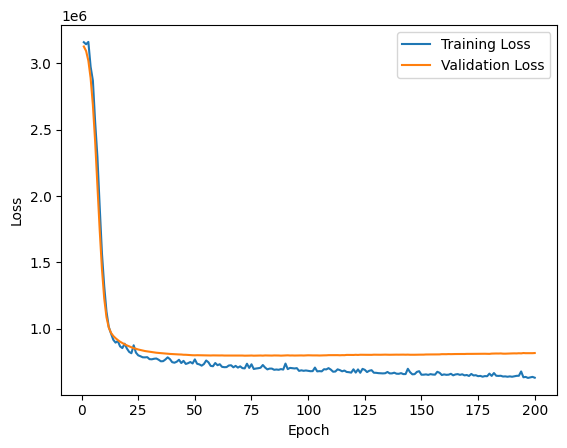

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse2_5010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_sl2_505 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse2, temp_sl2_505)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl2_505.fc1.weight.shape)
print("fc2 weight shape:", temp_sl2_505.fc2.weight.shape)
print("fc3 weight shape:", temp_sl2_505.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl2_505 = temp_sl2_505.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl2_505 = apply_pca_and_reshape(original_fc1_weights_sl2_505,
                                                       50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl2_505.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl2_505 = temp_sl2_505.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl2_505 = apply_pca_and_reshape(original_fc2_weights_sl2_505,
                                                       5)

# Instantiate the compressed model
PCA_sparse2_505 = CompressedRegressionNN(58, 50, 5, 1)

# Assign the PCA-transformed weights
PCA_sparse2_505.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl2_505).float().view(50, 58)
PCA_sparse2_505.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl2_505).float().view(5, 50)

# Reset biases
PCA_sparse2_505.fc1.bias.data.fill_(0)
PCA_sparse2_505.fc2.bias.data.fill_(0)
PCA_sparse2_505.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse2_505.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse2_505.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse2_505.fc3.weight.shape)
print()
print(PCA_sparse2_505)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([5, 50])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse2_505, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131058.1883, Average MAE: 1498.8354


Epoch [1/200], MSE Loss (Train): 3166504.630, MAE Loss (Train): 1511.824
Validation Loss: 3125830.058, Validation MAE: 1496.878
Epoch [2/200], MSE Loss (Train): 3211203.736, MAE Loss (Train): 1517.794
Validation Loss: 3094959.365, Validation MAE: 1486.513
Epoch [3/200], MSE Loss (Train): 3181686.238, MAE Loss (Train): 1511.122
Validation Loss: 3040290.769, Validation MAE: 1468.224
Epoch [4/200], MSE Loss (Train): 3078534.529, MAE Loss (Train): 1478.575
Validation Loss: 2953862.731, Validation MAE: 1439.070
Epoch [5/200], MSE Loss (Train): 2931756.406, MAE Loss (Train): 1434.528
Validation Loss: 2826694.173, Validation MAE: 1395.568
Epoch [6/200], MSE Loss (Train): 2802103.971, MAE Loss (Train): 1388.706
Validation Loss: 2654608.298, Validation MAE: 1334.757
Epoch [7/200], MSE Loss (Train): 2581774.962, MAE Loss (Train): 1317.117
Validation Loss: 2439782.279, Validation MAE: 1254.851
Epoch [8/200], MSE Loss (Train): 2355304.738, MAE Loss (Train): 1223.561
Validation Loss: 2191050.423, V

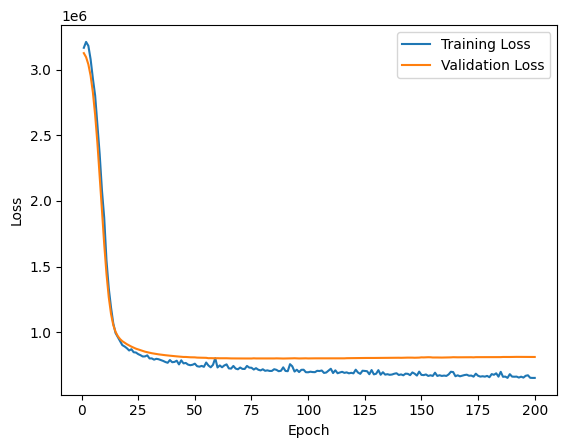

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse2_505, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_sl2_3010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse2, temp_sl2_3010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl2_3010.fc1.weight.shape)
print("fc2 weight shape:", temp_sl2_3010.fc2.weight.shape)
print("fc3 weight shape:", temp_sl2_3010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl2_3010 = temp_sl2_3010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl2_3010 = apply_pca_and_reshape(original_fc1_weights_sl2_3010,
                                                        30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl2_3010.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl2_3010 = temp_sl2_3010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl2_3010 = apply_pca_and_reshape(original_fc2_weights_sl2_3010,
                                                        10)

# Instantiate the compressed model
PCA_sparse2_3010 = CompressedRegressionNN(58, 30, 10, 1)

# Assign the PCA-transformed weights
PCA_sparse2_3010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl2_3010).float().view(30, 58)
PCA_sparse2_3010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl2_3010).float().view(10, 30)

# Reset biases
PCA_sparse2_3010.fc1.bias.data.fill_(0)
PCA_sparse2_3010.fc2.bias.data.fill_(0)
PCA_sparse2_3010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse2_3010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse2_3010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse2_3010.fc3.weight.shape)
print()
print(PCA_sparse2_3010)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([10, 30])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse2_3010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3128327.1229, Average MAE: 1497.9366


Epoch [1/200], MSE Loss (Train): 3149805.125, MAE Loss (Train): 1510.342
Validation Loss: 3120628.942, Validation MAE: 1495.067
Epoch [2/200], MSE Loss (Train): 3129166.115, MAE Loss (Train): 1501.799
Validation Loss: 3077590.846, Validation MAE: 1480.505
Epoch [3/200], MSE Loss (Train): 3091789.572, MAE Loss (Train): 1489.871
Validation Loss: 2991350.212, Validation MAE: 1451.296
Epoch [4/200], MSE Loss (Train): 2951458.608, MAE Loss (Train): 1445.471
Validation Loss: 2844298.808, Validation MAE: 1400.755
Epoch [5/200], MSE Loss (Train): 2778445.190, MAE Loss (Train): 1383.431
Validation Loss: 2628869.673, Validation MAE: 1324.238
Epoch [6/200], MSE Loss (Train): 2557882.738, MAE Loss (Train): 1301.859
Validation Loss: 2347994.500, Validation MAE: 1218.218
Epoch [7/200], MSE Loss (Train): 2188087.418, MAE Loss (Train): 1167.995
Validation Loss: 2024081.144, Validation MAE: 1084.271
Epoch [8/200], MSE Loss (Train): 1904618.201, MAE Loss (Train): 1034.044
Validation Loss: 1696920.490, V

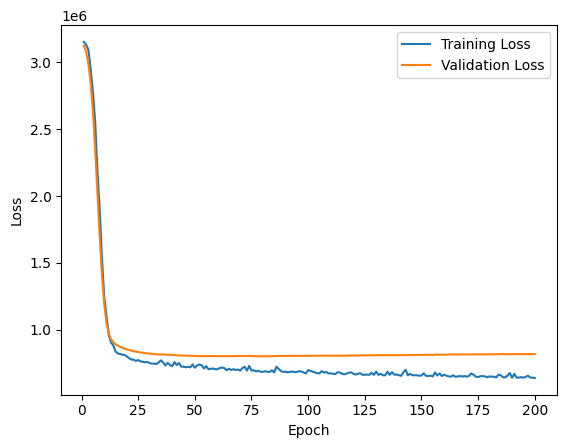

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse2_3010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_sl2_305 = RegressionNN(input_size, hidden_size1,
                           hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse2, temp_sl2_305)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl2_305.fc1.weight.shape)
print("fc2 weight shape:", temp_sl2_305.fc2.weight.shape)
print("fc3 weight shape:", temp_sl2_305.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl2_305 = temp_sl2_305.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl2_305 = apply_pca_and_reshape(original_fc1_weights_sl2_305,
                                                       30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl2_305.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl2_305 = temp_sl2_305.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl2_305 = apply_pca_and_reshape(original_fc2_weights_sl2_305,
                                                        5)

# Instantiate the compressed model
PCA_sparse2_305 = CompressedRegressionNN(58, 30, 5, 1)

# Assign the PCA-transformed weights
PCA_sparse2_305.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl2_305).float().view(30, 58)
PCA_sparse2_305.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl2_305).float().view(5, 30)

# Reset biases
PCA_sparse2_305.fc1.bias.data.fill_(0)
PCA_sparse2_305.fc2.bias.data.fill_(0)
PCA_sparse2_305.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse2_305.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse2_305.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse2_305.fc3.weight.shape)
print()
print(PCA_sparse2_305)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([5, 30])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse2_305, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3133141.2182, Average MAE: 1499.6184


Epoch [1/200], MSE Loss (Train): 3163618.406, MAE Loss (Train): 1515.414
Validation Loss: 3132961.250, Validation MAE: 1499.315
Epoch [2/200], MSE Loss (Train): 3138868.181, MAE Loss (Train): 1505.890
Validation Loss: 3120896.058, Validation MAE: 1495.251
Epoch [3/200], MSE Loss (Train): 3143717.550, MAE Loss (Train): 1508.803
Validation Loss: 3100769.269, Validation MAE: 1488.509
Epoch [4/200], MSE Loss (Train): 3179169.587, MAE Loss (Train): 1514.565
Validation Loss: 3065867.135, Validation MAE: 1476.841
Epoch [5/200], MSE Loss (Train): 3064103.524, MAE Loss (Train): 1481.420
Validation Loss: 3005316.481, Validation MAE: 1456.576
Epoch [6/200], MSE Loss (Train): 3027949.457, MAE Loss (Train): 1468.450
Validation Loss: 2916812.250, Validation MAE: 1426.703
Epoch [7/200], MSE Loss (Train): 2871454.692, MAE Loss (Train): 1419.827
Validation Loss: 2795008.635, Validation MAE: 1385.029
Epoch [8/200], MSE Loss (Train): 2754604.647, MAE Loss (Train): 1376.136
Validation Loss: 2641377.481, V

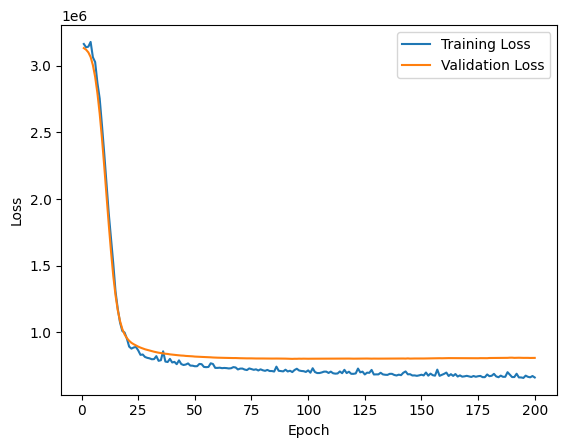

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse2_305, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=10 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_sl2_105 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse2, temp_sl2_105)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl2_105.fc1.weight.shape)
print("fc2 weight shape:", temp_sl2_105.fc2.weight.shape)
print("fc3 weight shape:", temp_sl2_105.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl2_105 = temp_sl2_105.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl2_105 = apply_pca_and_reshape(original_fc1_weights_sl2_105,
                                                       10)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl2_105.fc2 = nn.Linear(10, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl2_105 = temp_sl2_105.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl2_105 = apply_pca_and_reshape(original_fc2_weights_sl2_105,
                                                        5)

# Instantiate the compressed model
PCA_sparse2_105 = CompressedRegressionNN(58, 10, 5, 1)

# Assign the PCA-transformed weights
PCA_sparse2_105.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl2_105).float().view(10, 58)
PCA_sparse2_105.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl2_105).float().view(5, 10)

# Reset biases
PCA_sparse2_105.fc1.bias.data.fill_(0)
PCA_sparse2_105.fc2.bias.data.fill_(0)
PCA_sparse2_105.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse2_105.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse2_105.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse2_105.fc3.weight.shape)
print()
print(PCA_sparse2_105)

Transformed fc1 weight shape: torch.Size([10, 58])
Transformed fc2 weight shape: torch.Size([5, 10])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=10, bias=True)
  (fc2): Linear(in_features=10, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse2_105, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3136582.1571, Average MAE: 1500.7284


Epoch [1/200], MSE Loss (Train): 3176178.702, MAE Loss (Train): 1518.919
Validation Loss: 3137609.385, Validation MAE: 1500.806
Epoch [2/200], MSE Loss (Train): 3232112.577, MAE Loss (Train): 1527.880
Validation Loss: 3132253.462, Validation MAE: 1498.919
Epoch [3/200], MSE Loss (Train): 3191504.014, MAE Loss (Train): 1518.548
Validation Loss: 3126115.481, Validation MAE: 1496.744
Epoch [4/200], MSE Loss (Train): 3157957.048, MAE Loss (Train): 1512.610
Validation Loss: 3118356.404, Validation MAE: 1494.003
Epoch [5/200], MSE Loss (Train): 3147233.995, MAE Loss (Train): 1508.074
Validation Loss: 3108268.212, Validation MAE: 1490.453
Epoch [6/200], MSE Loss (Train): 3125452.560, MAE Loss (Train): 1501.927
Validation Loss: 3095423.596, Validation MAE: 1485.948
Epoch [7/200], MSE Loss (Train): 3116418.704, MAE Loss (Train): 1498.428
Validation Loss: 3079498.308, Validation MAE: 1480.374
Epoch [8/200], MSE Loss (Train): 3153984.947, MAE Loss (Train): 1499.709
Validation Loss: 3059702.577, V

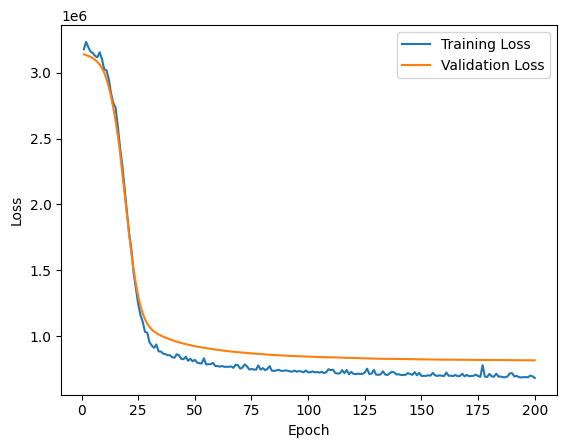

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse2_105, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### PCA on the Pruned Model, `pruned_sparse3`, with Pruning Amount=0.8

###### fc1 out_features=50 and fc2 out_features=30

In [ ]:
# create copy of the locally pruned model
temp_sl3_5030 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse3, temp_sl3_5030)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl3_5030.fc1.weight.shape)
print("fc2 weight shape:", temp_sl3_5030.fc2.weight.shape)
print("fc3 weight shape:", temp_sl3_5030.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl3_5030 = temp_sl3_5030.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl3_5030 = apply_pca_and_reshape(original_fc1_weights_sl3_5030,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl3_5030.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl3_5030 = temp_sl3_5030.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl3_5030 = apply_pca_and_reshape(original_fc2_weights_sl3_5030,
                                                        30)

# Instantiate the compressed model
PCA_sparse3_5030 = CompressedRegressionNN(58, 50, 30, 1)

# Assign the PCA-transformed weights
PCA_sparse3_5030.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl3_5030).float().view(50, 58)
PCA_sparse3_5030.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl3_5030).float().view(30, 50)

# Reset biases
PCA_sparse3_5030.fc1.bias.data.fill_(0)
PCA_sparse3_5030.fc2.bias.data.fill_(0)
PCA_sparse3_5030.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse3_5030.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse3_5030.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse3_5030.fc3.weight.shape)
print()
print(PCA_sparse3_5030)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([30, 50])
Transformed fc3 weight shape: torch.Size([1, 30])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=30, bias=True)
  (fc3): Linear(in_features=30, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse3_5030, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131927.3221, Average MAE: 1499.1976


Epoch [1/200], MSE Loss (Train): 3159113.885, MAE Loss (Train): 1513.485
Validation Loss: 3113589.865, Validation MAE: 1493.079
Epoch [2/200], MSE Loss (Train): 3139406.635, MAE Loss (Train): 1505.693
Validation Loss: 3034088.365, Validation MAE: 1466.799
Epoch [3/200], MSE Loss (Train): 2975712.745, MAE Loss (Train): 1453.959
Validation Loss: 2852967.058, Validation MAE: 1405.654
Epoch [4/200], MSE Loss (Train): 2780832.940, MAE Loss (Train): 1379.981
Validation Loss: 2533066.202, Validation MAE: 1291.353
Epoch [5/200], MSE Loss (Train): 2330968.149, MAE Loss (Train): 1224.047
Validation Loss: 2090177.683, Validation MAE: 1114.000
Epoch [6/200], MSE Loss (Train): 1861336.520, MAE Loss (Train): 1024.426
Validation Loss: 1619767.851, Validation MAE: 900.358
Epoch [7/200], MSE Loss (Train): 1460911.550, MAE Loss (Train): 834.224
Validation Loss: 1242045.188, Validation MAE: 740.633
Epoch [8/200], MSE Loss (Train): 1100487.339, MAE Loss (Train): 703.179
Validation Loss: 1036014.721, Valid

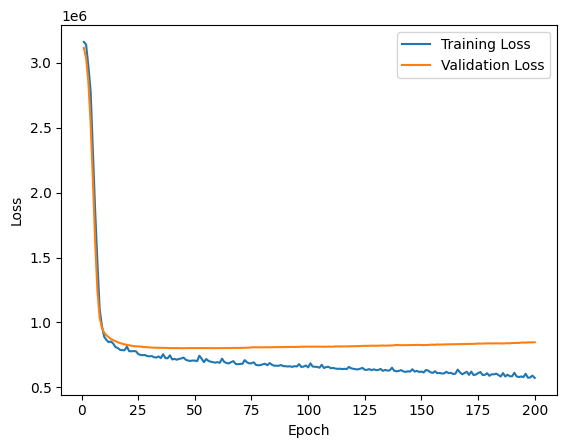

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse3_5030, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_sl3_5010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse3, temp_sl3_5010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl3_5010.fc1.weight.shape)
print("fc2 weight shape:", temp_sl3_5010.fc2.weight.shape)
print("fc3 weight shape:", temp_sl3_5010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl3_5010 = temp_sl3_5010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl3_5010 = apply_pca_and_reshape(original_fc1_weights_sl3_5010,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl3_5010.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl3_5010 = temp_sl3_5010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl3_5010 = apply_pca_and_reshape(original_fc2_weights_sl3_5010,
                                                        10)

# Instantiate the compressed model
PCA_sparse3_5010 = CompressedRegressionNN(58, 50, 10, 1)

# Assign the PCA-transformed weights
PCA_sparse3_5010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl3_5010).float().view(50, 58)
PCA_sparse3_5010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl3_5010).float().view(10, 50)

# Reset biases
PCA_sparse3_5010.fc1.bias.data.fill_(0)
PCA_sparse3_5010.fc2.bias.data.fill_(0)
PCA_sparse3_5010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse3_5010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse3_5010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse3_5010.fc3.weight.shape)
print()
print(PCA_sparse3_5010)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([10, 50])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse3_5010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3129316.3606, Average MAE: 1498.4377


Epoch [1/200], MSE Loss (Train): 3212069.413, MAE Loss (Train): 1523.558
Validation Loss: 3119806.250, Validation MAE: 1495.170
Epoch [2/200], MSE Loss (Train): 3155127.096, MAE Loss (Train): 1511.393
Validation Loss: 3078947.404, Validation MAE: 1481.753
Epoch [3/200], MSE Loss (Train): 3166060.875, MAE Loss (Train): 1501.059
Validation Loss: 2996542.808, Validation MAE: 1454.512
Epoch [4/200], MSE Loss (Train): 3023648.166, MAE Loss (Train): 1458.169
Validation Loss: 2854461.288, Validation MAE: 1406.789
Epoch [5/200], MSE Loss (Train): 2816503.462, MAE Loss (Train): 1396.992
Validation Loss: 2644121.894, Validation MAE: 1333.163
Epoch [6/200], MSE Loss (Train): 2575669.274, MAE Loss (Train): 1312.071
Validation Loss: 2364923.750, Validation MAE: 1228.672
Epoch [7/200], MSE Loss (Train): 2200688.210, MAE Loss (Train): 1174.312
Validation Loss: 2039959.510, Validation MAE: 1093.844
Epoch [8/200], MSE Loss (Train): 1867489.977, MAE Loss (Train): 1030.633
Validation Loss: 1712542.442, V

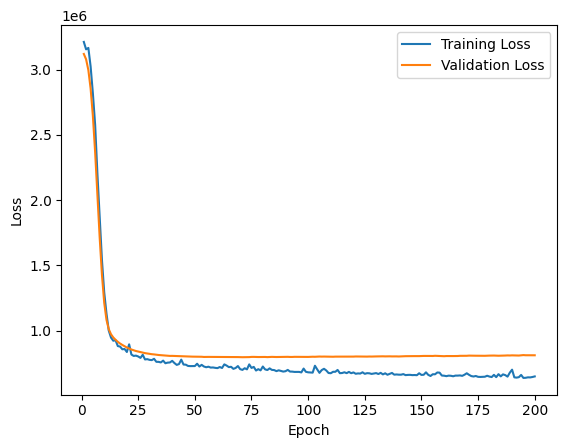

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse3_5010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_sl3_505 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse3, temp_sl3_505)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl3_505.fc1.weight.shape)
print("fc2 weight shape:", temp_sl3_505.fc2.weight.shape)
print("fc3 weight shape:", temp_sl3_505.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl3_505 = temp_sl3_505.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl3_505 = apply_pca_and_reshape(original_fc1_weights_sl3_505,
                                                       50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl3_505.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl3_505 = temp_sl3_505.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl3_505 = apply_pca_and_reshape(original_fc2_weights_sl3_505,
                                                       5)

# Instantiate the compressed model
PCA_sparse3_505 = CompressedRegressionNN(58, 50, 5, 1)

# Assign the PCA-transformed weights
PCA_sparse3_505.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl3_505).float().view(50, 58)
PCA_sparse3_505.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl3_505).float().view(5, 50)

# Reset biases
PCA_sparse3_505.fc1.bias.data.fill_(0)
PCA_sparse3_505.fc2.bias.data.fill_(0)
PCA_sparse3_505.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse3_505.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse3_505.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse3_505.fc3.weight.shape)
print()
print(PCA_sparse3_505)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([5, 50])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse3_505, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132116.9688, Average MAE: 1499.3289


Epoch [1/200], MSE Loss (Train): 3196390.144, MAE Loss (Train): 1520.069
Validation Loss: 3126613.077, Validation MAE: 1497.378
Epoch [2/200], MSE Loss (Train): 3166350.796, MAE Loss (Train): 1510.788
Validation Loss: 3105321.596, Validation MAE: 1490.449
Epoch [3/200], MSE Loss (Train): 3153792.587, MAE Loss (Train): 1504.158
Validation Loss: 3069886.500, Validation MAE: 1478.968
Epoch [4/200], MSE Loss (Train): 3059690.115, MAE Loss (Train): 1481.169
Validation Loss: 3013265.577, Validation MAE: 1460.540
Epoch [5/200], MSE Loss (Train): 3098535.649, MAE Loss (Train): 1483.683
Validation Loss: 2928826.019, Validation MAE: 1432.704
Epoch [6/200], MSE Loss (Train): 2904533.111, MAE Loss (Train): 1431.899
Validation Loss: 2810725.923, Validation MAE: 1393.006
Epoch [7/200], MSE Loss (Train): 2774739.363, MAE Loss (Train): 1384.409
Validation Loss: 2659370.077, Validation MAE: 1340.361
Epoch [8/200], MSE Loss (Train): 2586868.005, MAE Loss (Train): 1317.804
Validation Loss: 2473360.404, V

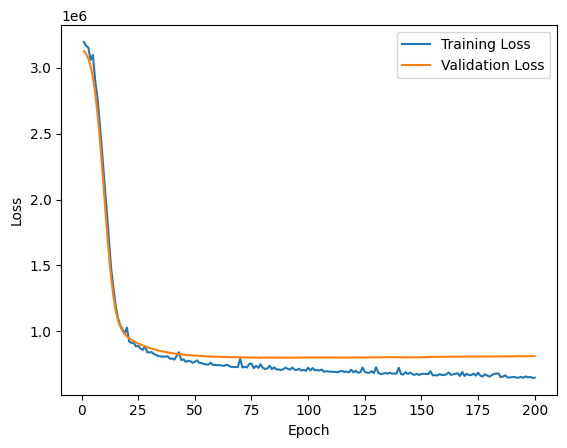

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse3_505, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_sl3_3010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse3, temp_sl3_3010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl3_3010.fc1.weight.shape)
print("fc2 weight shape:", temp_sl3_3010.fc2.weight.shape)
print("fc3 weight shape:", temp_sl3_3010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl3_3010 = temp_sl3_3010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl3_3010 = apply_pca_and_reshape(original_fc1_weights_sl3_3010,
                                                        30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl3_3010.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl3_3010 = temp_sl3_3010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl3_3010 = apply_pca_and_reshape(original_fc2_weights_sl3_3010,
                                                        10)

# Instantiate the compressed model
PCA_sparse3_3010 = CompressedRegressionNN(58, 30, 10, 1)

# Assign the PCA-transformed weights
PCA_sparse3_3010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl3_3010).float().view(30, 58)
PCA_sparse3_3010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl3_3010).float().view(10, 30)

# Reset biases
PCA_sparse3_3010.fc1.bias.data.fill_(0)
PCA_sparse3_3010.fc2.bias.data.fill_(0)
PCA_sparse3_3010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse3_3010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse3_3010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse3_3010.fc3.weight.shape)
print()
print(PCA_sparse3_3010)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([10, 30])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse3_3010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3133109.4315, Average MAE: 1499.5385


Epoch [1/200], MSE Loss (Train): 3164020.142, MAE Loss (Train): 1514.079
Validation Loss: 3131246.058, Validation MAE: 1498.779
Epoch [2/200], MSE Loss (Train): 3220168.827, MAE Loss (Train): 1522.251
Validation Loss: 3115218.769, Validation MAE: 1493.513
Epoch [3/200], MSE Loss (Train): 3158267.096, MAE Loss (Train): 1508.188
Validation Loss: 3079090.712, Validation MAE: 1481.596
Epoch [4/200], MSE Loss (Train): 3076400.488, MAE Loss (Train): 1485.496
Validation Loss: 3001402.077, Validation MAE: 1455.944
Epoch [5/200], MSE Loss (Train): 3023169.796, MAE Loss (Train): 1463.846
Validation Loss: 2873289.404, Validation MAE: 1413.122
Epoch [6/200], MSE Loss (Train): 2811145.925, MAE Loss (Train): 1400.760
Validation Loss: 2686286.125, Validation MAE: 1348.511
Epoch [7/200], MSE Loss (Train): 2626220.197, MAE Loss (Train): 1321.936
Validation Loss: 2432922.452, Validation MAE: 1255.864
Epoch [8/200], MSE Loss (Train): 2286052.236, MAE Loss (Train): 1210.249
Validation Loss: 2138843.721, V

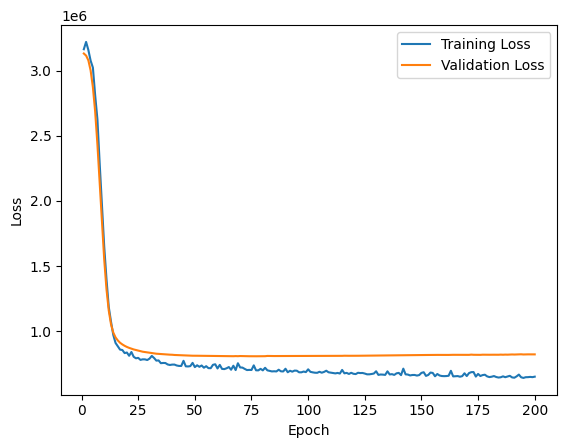

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse3_3010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_sl3_305 = RegressionNN(input_size, hidden_size1,
                           hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse3, temp_sl3_305)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl3_305.fc1.weight.shape)
print("fc2 weight shape:", temp_sl3_305.fc2.weight.shape)
print("fc3 weight shape:", temp_sl3_305.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl3_305 = temp_sl3_305.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl3_305 = apply_pca_and_reshape(original_fc1_weights_sl3_305,
                                                       30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl3_305.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl3_305 = temp_sl3_305.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl3_305 = apply_pca_and_reshape(original_fc2_weights_sl3_305,
                                                        5)

# Instantiate the compressed model
PCA_sparse3_305 = CompressedRegressionNN(58, 30, 5, 1)

# Assign the PCA-transformed weights
PCA_sparse3_305.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl3_305).float().view(30, 58)
PCA_sparse3_305.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl3_305).float().view(5, 30)

# Reset biases
PCA_sparse3_305.fc1.bias.data.fill_(0)
PCA_sparse3_305.fc2.bias.data.fill_(0)
PCA_sparse3_305.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse3_305.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse3_305.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse3_305.fc3.weight.shape)
print()
print(PCA_sparse3_305)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([5, 30])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse3_305, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3127879.5458, Average MAE: 1497.9573


Epoch [1/200], MSE Loss (Train): 3179635.149, MAE Loss (Train): 1517.762
Validation Loss: 3126264.673, Validation MAE: 1497.401
Epoch [2/200], MSE Loss (Train): 3133302.897, MAE Loss (Train): 1505.251
Validation Loss: 3103154.058, Validation MAE: 1489.914
Epoch [3/200], MSE Loss (Train): 3144360.370, MAE Loss (Train): 1505.676
Validation Loss: 3057936.231, Validation MAE: 1475.158
Epoch [4/200], MSE Loss (Train): 3073752.579, MAE Loss (Train): 1484.992
Validation Loss: 2982493.385, Validation MAE: 1450.314
Epoch [5/200], MSE Loss (Train): 3002875.649, MAE Loss (Train): 1458.204
Validation Loss: 2868974.481, Validation MAE: 1412.274
Epoch [6/200], MSE Loss (Train): 2897300.151, MAE Loss (Train): 1421.063
Validation Loss: 2711691.115, Validation MAE: 1358.029
Epoch [7/200], MSE Loss (Train): 2621902.559, MAE Loss (Train): 1336.528
Validation Loss: 2513478.038, Validation MAE: 1286.406
Epoch [8/200], MSE Loss (Train): 2399844.826, MAE Loss (Train): 1253.046
Validation Loss: 2282526.635, V

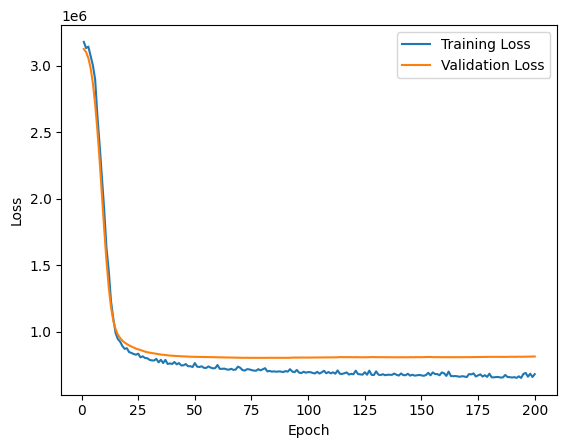

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse3_305, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=10 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_sl3_105 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse3, temp_sl3_105)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl3_105.fc1.weight.shape)
print("fc2 weight shape:", temp_sl3_105.fc2.weight.shape)
print("fc3 weight shape:", temp_sl3_105.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl3_105 = temp_sl3_105.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl3_105 = apply_pca_and_reshape(original_fc1_weights_sl3_105,
                                                       10)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl3_105.fc2 = nn.Linear(10, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl3_105 = temp_sl3_105.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl3_105 = apply_pca_and_reshape(original_fc2_weights_sl3_105,
                                                        5)

# Instantiate the compressed model
PCA_sparse3_105 = CompressedRegressionNN(58, 10, 5, 1)

# Assign the PCA-transformed weights
PCA_sparse3_105.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl3_105).float().view(10, 58)
PCA_sparse3_105.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl3_105).float().view(5, 10)

# Reset biases
PCA_sparse3_105.fc1.bias.data.fill_(0)
PCA_sparse3_105.fc2.bias.data.fill_(0)
PCA_sparse3_105.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse3_105.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse3_105.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse3_105.fc3.weight.shape)
print()
print(PCA_sparse3_105)

Transformed fc1 weight shape: torch.Size([10, 58])
Transformed fc2 weight shape: torch.Size([5, 10])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=10, bias=True)
  (fc2): Linear(in_features=10, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse3_105, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3137374.3209, Average MAE: 1500.8514


Epoch [1/200], MSE Loss (Train): 3216032.577, MAE Loss (Train): 1526.934
Validation Loss: 3137663.519, Validation MAE: 1500.886
Epoch [2/200], MSE Loss (Train): 3190165.543, MAE Loss (Train): 1519.274
Validation Loss: 3131938.808, Validation MAE: 1499.039
Epoch [3/200], MSE Loss (Train): 3172007.202, MAE Loss (Train): 1514.871
Validation Loss: 3125595.808, Validation MAE: 1496.973
Epoch [4/200], MSE Loss (Train): 3148959.440, MAE Loss (Train): 1511.053
Validation Loss: 3117706.288, Validation MAE: 1494.383
Epoch [5/200], MSE Loss (Train): 3141390.774, MAE Loss (Train): 1507.687
Validation Loss: 3107698.173, Validation MAE: 1491.089
Epoch [6/200], MSE Loss (Train): 3150372.197, MAE Loss (Train): 1508.284
Validation Loss: 3095035.192, Validation MAE: 1486.920
Epoch [7/200], MSE Loss (Train): 3149504.207, MAE Loss (Train): 1507.675
Validation Loss: 3078859.288, Validation MAE: 1481.604
Epoch [8/200], MSE Loss (Train): 3206092.255, MAE Loss (Train): 1513.562
Validation Loss: 3058065.731, V

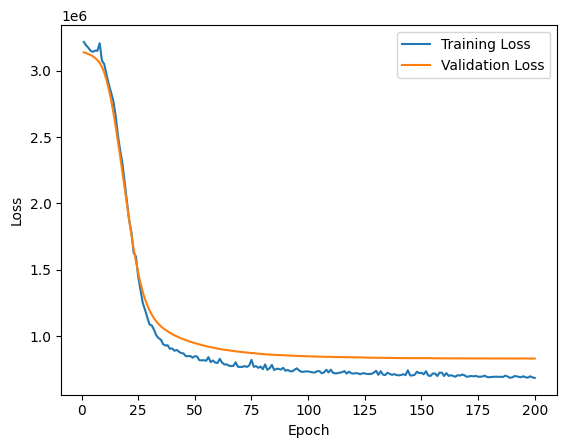

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse3_105, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### PCA on the Pruned Model, `pruned_sparse4`, with Pruning Amount=0.9

###### fc1 out_features=50 and fc2 out_features=30

In [ ]:
# create copy of the locally pruned model
temp_sl4_5030 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse4, temp_sl4_5030)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl4_5030.fc1.weight.shape)
print("fc2 weight shape:", temp_sl4_5030.fc2.weight.shape)
print("fc3 weight shape:", temp_sl4_5030.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl4_5030 = temp_sl4_5030.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl4_5030 = apply_pca_and_reshape(original_fc1_weights_sl4_5030,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl4_5030.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl4_5030 = temp_sl4_5030.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl4_5030 = apply_pca_and_reshape(original_fc2_weights_sl4_5030,
                                                        30)

# Instantiate the compressed model
PCA_sparse4_5030 = CompressedRegressionNN(58, 50, 30, 1)

# Assign the PCA-transformed weights
PCA_sparse4_5030.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl4_5030).float().view(50, 58)
PCA_sparse4_5030.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl4_5030).float().view(30, 50)

# Reset biases
PCA_sparse4_5030.fc1.bias.data.fill_(0)
PCA_sparse4_5030.fc2.bias.data.fill_(0)
PCA_sparse4_5030.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse4_5030.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse4_5030.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse4_5030.fc3.weight.shape)
print()
print(PCA_sparse4_5030)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([30, 50])
Transformed fc3 weight shape: torch.Size([1, 30])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=30, bias=True)
  (fc3): Linear(in_features=30, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse4_5030, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131456.1632, Average MAE: 1499.0158


Epoch [1/200], MSE Loss (Train): 3187105.450, MAE Loss (Train): 1517.453
Validation Loss: 3109569.115, Validation MAE: 1491.758
Epoch [2/200], MSE Loss (Train): 3137724.476, MAE Loss (Train): 1505.590
Validation Loss: 3029493.500, Validation MAE: 1465.631
Epoch [3/200], MSE Loss (Train): 2998513.550, MAE Loss (Train): 1454.970
Validation Loss: 2855375.327, Validation MAE: 1407.835
Epoch [4/200], MSE Loss (Train): 2729293.431, MAE Loss (Train): 1371.845
Validation Loss: 2556467.010, Validation MAE: 1303.039
Epoch [5/200], MSE Loss (Train): 2362427.826, MAE Loss (Train): 1237.137
Validation Loss: 2144381.452, Validation MAE: 1142.742
Epoch [6/200], MSE Loss (Train): 1919150.054, MAE Loss (Train): 1056.182
Validation Loss: 1693635.606, Validation MAE: 944.480
Epoch [7/200], MSE Loss (Train): 1475065.131, MAE Loss (Train): 860.873
Validation Loss: 1315124.803, Validation MAE: 774.199
Epoch [8/200], MSE Loss (Train): 1245936.338, MAE Loss (Train): 748.805
Validation Loss: 1078227.067, Valid

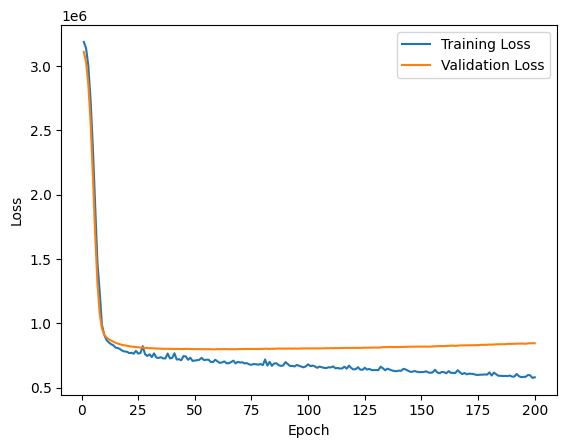

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse4_5030, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_sl4_5010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse4, temp_sl4_5010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl4_5010.fc1.weight.shape)
print("fc2 weight shape:", temp_sl4_5010.fc2.weight.shape)
print("fc3 weight shape:", temp_sl4_5010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl4_5010 = temp_sl4_5010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl4_5010 = apply_pca_and_reshape(original_fc1_weights_sl4_5010,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl4_5010.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl4_5010 = temp_sl4_5010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl4_5010 = apply_pca_and_reshape(original_fc2_weights_sl4_5010,
                                                        10)

# Instantiate the compressed model
PCA_sparse4_5010 = CompressedRegressionNN(58, 50, 10, 1)

# Assign the PCA-transformed weights
PCA_sparse4_5010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl4_5010).float().view(50, 58)
PCA_sparse4_5010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl4_5010).float().view(10, 50)

# Reset biases
PCA_sparse4_5010.fc1.bias.data.fill_(0)
PCA_sparse4_5010.fc2.bias.data.fill_(0)
PCA_sparse4_5010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse4_5010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse4_5010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse4_5010.fc3.weight.shape)
print()
print(PCA_sparse4_5010)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([10, 50])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse4_5010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3133796.6174, Average MAE: 1499.8596


Epoch [1/200], MSE Loss (Train): 3167899.702, MAE Loss (Train): 1516.400
Validation Loss: 3126210.019, Validation MAE: 1497.214
Epoch [2/200], MSE Loss (Train): 3195199.103, MAE Loss (Train): 1520.228
Validation Loss: 3092017.481, Validation MAE: 1486.064
Epoch [3/200], MSE Loss (Train): 3112359.108, MAE Loss (Train): 1494.900
Validation Loss: 3023814.038, Validation MAE: 1463.691
Epoch [4/200], MSE Loss (Train): 3018683.428, MAE Loss (Train): 1463.752
Validation Loss: 2905849.558, Validation MAE: 1424.488
Epoch [5/200], MSE Loss (Train): 2854116.072, MAE Loss (Train): 1412.832
Validation Loss: 2724082.125, Validation MAE: 1362.063
Epoch [6/200], MSE Loss (Train): 2624906.724, MAE Loss (Train): 1334.349
Validation Loss: 2478270.856, Validation MAE: 1272.849
Epoch [7/200], MSE Loss (Train): 2380904.303, MAE Loss (Train): 1238.179
Validation Loss: 2178836.365, Validation MAE: 1154.918
Epoch [8/200], MSE Loss (Train): 2030053.173, MAE Loss (Train): 1100.077
Validation Loss: 1854540.692, V

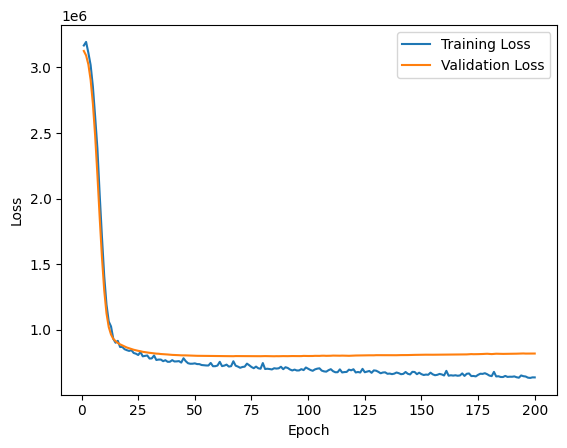

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse4_5010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_sl4_505 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse4, temp_sl4_505)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl4_505.fc1.weight.shape)
print("fc2 weight shape:", temp_sl4_505.fc2.weight.shape)
print("fc3 weight shape:", temp_sl4_505.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl4_505 = temp_sl4_505.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl4_505 = apply_pca_and_reshape(original_fc1_weights_sl4_505,
                                                       50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl4_505.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl4_505 = temp_sl4_505.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl4_505 = apply_pca_and_reshape(original_fc2_weights_sl4_505,
                                                       5)

# Instantiate the compressed model
PCA_sparse4_505 = CompressedRegressionNN(58, 50, 5, 1)

# Assign the PCA-transformed weights
PCA_sparse4_505.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl4_505).float().view(50, 58)
PCA_sparse4_505.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl4_505).float().view(5, 50)

# Reset biases
PCA_sparse4_505.fc1.bias.data.fill_(0)
PCA_sparse4_505.fc2.bias.data.fill_(0)
PCA_sparse4_505.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse4_505.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse4_505.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse4_505.fc3.weight.shape)
print()
print(PCA_sparse4_505)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([5, 50])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse4_505, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3133329.7341, Average MAE: 1499.6395


Epoch [1/200], MSE Loss (Train): 3178192.966, MAE Loss (Train): 1514.333
Validation Loss: 3136452.269, Validation MAE: 1500.548
Epoch [2/200], MSE Loss (Train): 3180116.716, MAE Loss (Train): 1519.848
Validation Loss: 3126594.308, Validation MAE: 1497.368
Epoch [3/200], MSE Loss (Train): 3200523.678, MAE Loss (Train): 1518.768
Validation Loss: 3103485.750, Validation MAE: 1489.961
Epoch [4/200], MSE Loss (Train): 3121767.190, MAE Loss (Train): 1502.604
Validation Loss: 3059711.077, Validation MAE: 1475.962
Epoch [5/200], MSE Loss (Train): 3073623.111, MAE Loss (Train): 1486.381
Validation Loss: 2987189.423, Validation MAE: 1452.584
Epoch [6/200], MSE Loss (Train): 2995012.091, MAE Loss (Train): 1456.197
Validation Loss: 2879981.019, Validation MAE: 1417.527
Epoch [7/200], MSE Loss (Train): 2834457.810, MAE Loss (Train): 1407.415
Validation Loss: 2735452.587, Validation MAE: 1368.868
Epoch [8/200], MSE Loss (Train): 2670089.368, MAE Loss (Train): 1352.538
Validation Loss: 2555990.808, V

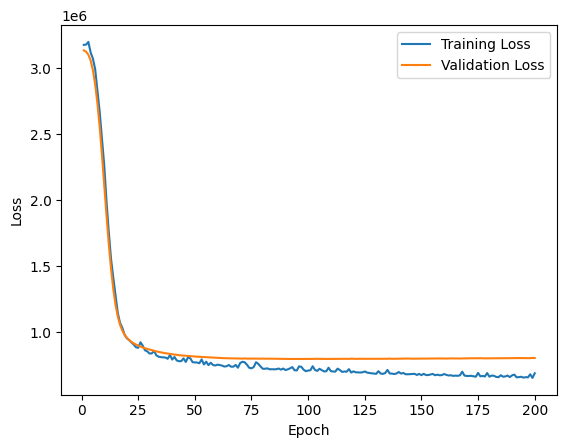

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse4_505, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_sl4_3010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse4, temp_sl4_3010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl4_3010.fc1.weight.shape)
print("fc2 weight shape:", temp_sl4_3010.fc2.weight.shape)
print("fc3 weight shape:", temp_sl4_3010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl4_3010 = temp_sl4_3010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl4_3010 = apply_pca_and_reshape(original_fc1_weights_sl4_3010,
                                                        30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl4_3010.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl4_3010 = temp_sl4_3010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl4_3010 = apply_pca_and_reshape(original_fc2_weights_sl4_3010,
                                                        10)

# Instantiate the compressed model
PCA_sparse4_3010 = CompressedRegressionNN(58, 30, 10, 1)

# Assign the PCA-transformed weights
PCA_sparse4_3010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl4_3010).float().view(30, 58)
PCA_sparse4_3010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl4_3010).float().view(10, 30)

# Reset biases
PCA_sparse4_3010.fc1.bias.data.fill_(0)
PCA_sparse4_3010.fc2.bias.data.fill_(0)
PCA_sparse4_3010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse4_3010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse4_3010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse4_3010.fc3.weight.shape)
print()
print(PCA_sparse4_3010)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([10, 30])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse4_3010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131140.0104, Average MAE: 1499.0169


Epoch [1/200], MSE Loss (Train): 3189777.702, MAE Loss (Train): 1522.348
Validation Loss: 3126761.519, Validation MAE: 1497.545
Epoch [2/200], MSE Loss (Train): 3145529.173, MAE Loss (Train): 1509.356
Validation Loss: 3104410.923, Validation MAE: 1490.359
Epoch [3/200], MSE Loss (Train): 3142505.334, MAE Loss (Train): 1507.745
Validation Loss: 3058730.115, Validation MAE: 1475.597
Epoch [4/200], MSE Loss (Train): 3074460.849, MAE Loss (Train): 1484.605
Validation Loss: 2977931.692, Validation MAE: 1449.205
Epoch [5/200], MSE Loss (Train): 2994951.615, MAE Loss (Train): 1454.982
Validation Loss: 2834667.769, Validation MAE: 1401.378
Epoch [6/200], MSE Loss (Train): 2768690.185, MAE Loss (Train): 1385.341
Validation Loss: 2625232.587, Validation MAE: 1328.495
Epoch [7/200], MSE Loss (Train): 2494254.091, MAE Loss (Train): 1287.960
Validation Loss: 2362732.269, Validation MAE: 1231.150
Epoch [8/200], MSE Loss (Train): 2206364.896, MAE Loss (Train): 1176.943
Validation Loss: 2061929.125, V

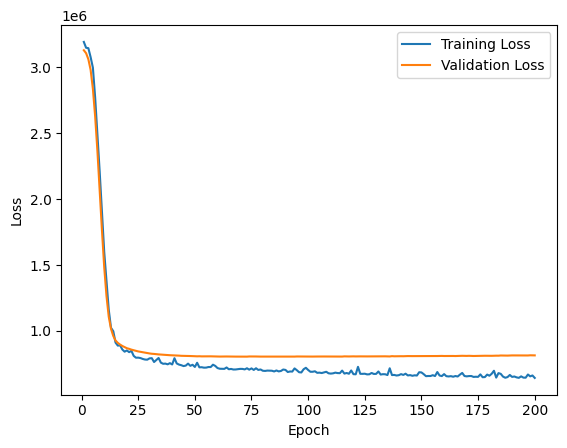

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse4_3010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_sl4_305 = RegressionNN(input_size, hidden_size1,
                           hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse4, temp_sl4_305)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl4_305.fc1.weight.shape)
print("fc2 weight shape:", temp_sl4_305.fc2.weight.shape)
print("fc3 weight shape:", temp_sl4_305.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl4_305 = temp_sl4_305.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl4_305 = apply_pca_and_reshape(original_fc1_weights_sl4_305,
                                                       30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl4_305.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl4_305 = temp_sl4_305.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl4_305 = apply_pca_and_reshape(original_fc2_weights_sl4_305,
                                                        5)

# Instantiate the compressed model
PCA_sparse4_305 = CompressedRegressionNN(58, 30, 5, 1)

# Assign the PCA-transformed weights
PCA_sparse4_305.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl4_305).float().view(30, 58)
PCA_sparse4_305.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl4_305).float().view(5, 30)

# Reset biases
PCA_sparse4_305.fc1.bias.data.fill_(0)
PCA_sparse4_305.fc2.bias.data.fill_(0)
PCA_sparse4_305.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse4_305.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse4_305.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse4_305.fc3.weight.shape)
print()
print(PCA_sparse4_305)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([5, 30])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse4_305, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130966.2378, Average MAE: 1498.9103


Epoch [1/200], MSE Loss (Train): 3195950.005, MAE Loss (Train): 1523.146
Validation Loss: 3127793.654, Validation MAE: 1497.797
Epoch [2/200], MSE Loss (Train): 3155643.346, MAE Loss (Train): 1509.119
Validation Loss: 3106803.692, Validation MAE: 1491.010
Epoch [3/200], MSE Loss (Train): 3116842.779, MAE Loss (Train): 1498.770
Validation Loss: 3068801.404, Validation MAE: 1478.701
Epoch [4/200], MSE Loss (Train): 3051257.756, MAE Loss (Train): 1478.569
Validation Loss: 3006995.615, Validation MAE: 1458.654
Epoch [5/200], MSE Loss (Train): 3029177.389, MAE Loss (Train): 1463.102
Validation Loss: 2913703.942, Validation MAE: 1428.040
Epoch [6/200], MSE Loss (Train): 3019226.507, MAE Loss (Train): 1452.272
Validation Loss: 2783032.529, Validation MAE: 1384.172
Epoch [7/200], MSE Loss (Train): 2711491.769, MAE Loss (Train): 1367.728
Validation Loss: 2615713.442, Validation MAE: 1325.899
Epoch [8/200], MSE Loss (Train): 2573235.870, MAE Loss (Train): 1310.747
Validation Loss: 2414779.971, V

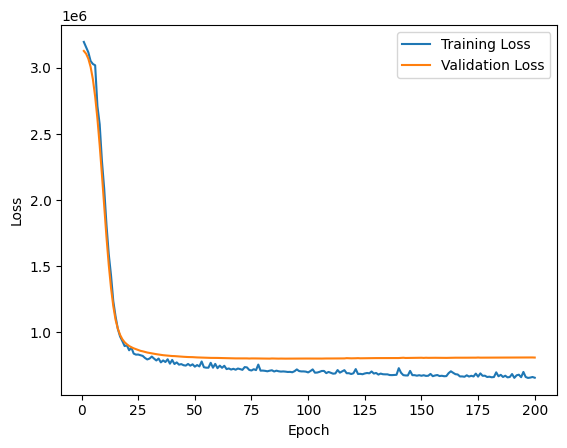

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse4_305, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=10 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_sl4_105 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse4, temp_sl4_105)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl4_105.fc1.weight.shape)
print("fc2 weight shape:", temp_sl4_105.fc2.weight.shape)
print("fc3 weight shape:", temp_sl4_105.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl4_105 = temp_sl4_105.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl4_105 = apply_pca_and_reshape(original_fc1_weights_sl4_105,
                                                       10)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl4_105.fc2 = nn.Linear(10, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl4_105 = temp_sl4_105.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl4_105 = apply_pca_and_reshape(original_fc2_weights_sl4_105,
                                                        5)

# Instantiate the compressed model
PCA_sparse4_105 = CompressedRegressionNN(58, 10, 5, 1)

# Assign the PCA-transformed weights
PCA_sparse4_105.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl4_105).float().view(10, 58)
PCA_sparse4_105.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl4_105).float().view(5, 10)

# Reset biases
PCA_sparse4_105.fc1.bias.data.fill_(0)
PCA_sparse4_105.fc2.bias.data.fill_(0)
PCA_sparse4_105.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse4_105.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse4_105.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse4_105.fc3.weight.shape)
print()
print(PCA_sparse4_105)

Transformed fc1 weight shape: torch.Size([10, 58])
Transformed fc2 weight shape: torch.Size([5, 10])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=10, bias=True)
  (fc2): Linear(in_features=10, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse4_105, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3118392.1944, Average MAE: 1495.0864


Epoch [1/200], MSE Loss (Train): 3185073.680, MAE Loss (Train): 1515.278
Validation Loss: 3114543.077, Validation MAE: 1493.956
Epoch [2/200], MSE Loss (Train): 3150421.397, MAE Loss (Train): 1509.411
Validation Loss: 3098281.019, Validation MAE: 1488.964
Epoch [3/200], MSE Loss (Train): 3097202.870, MAE Loss (Train): 1493.459
Validation Loss: 3073378.019, Validation MAE: 1481.176
Epoch [4/200], MSE Loss (Train): 3099705.822, MAE Loss (Train): 1495.117
Validation Loss: 3036223.250, Validation MAE: 1469.248
Epoch [5/200], MSE Loss (Train): 3041892.988, MAE Loss (Train): 1477.924
Validation Loss: 2985806.135, Validation MAE: 1452.827
Epoch [6/200], MSE Loss (Train): 2975352.435, MAE Loss (Train): 1457.607
Validation Loss: 2920795.462, Validation MAE: 1431.369
Epoch [7/200], MSE Loss (Train): 2932713.587, MAE Loss (Train): 1440.612
Validation Loss: 2841497.087, Validation MAE: 1404.668
Epoch [8/200], MSE Loss (Train): 2819794.481, MAE Loss (Train): 1404.943
Validation Loss: 2746885.240, V

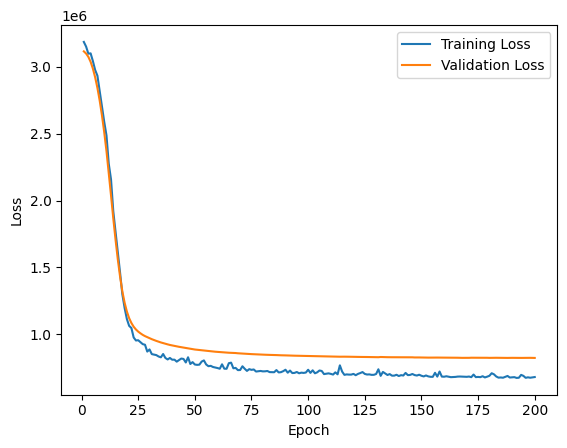

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse4_105, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### PCA on the Pruned Model, `pruned_sparse5`, with Pruning Amount=0.95

###### fc1 out_features=50 and fc2 out_features=30

In [ ]:
# create copy of the locally pruned model
temp_sl5_5030 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse5, temp_sl5_5030)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl5_5030.fc1.weight.shape)
print("fc2 weight shape:", temp_sl5_5030.fc2.weight.shape)
print("fc3 weight shape:", temp_sl5_5030.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl5_5030 = temp_sl5_5030.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl5_5030 = apply_pca_and_reshape(original_fc1_weights_sl5_5030,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl5_5030.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl5_5030 = temp_sl5_5030.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl5_5030 = apply_pca_and_reshape(original_fc2_weights_sl5_5030,
                                                        30)

# Instantiate the compressed model
PCA_sparse5_5030 = CompressedRegressionNN(58, 50, 30, 1)

# Assign the PCA-transformed weights
PCA_sparse5_5030.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl5_5030).float().view(50, 58)
PCA_sparse5_5030.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl5_5030).float().view(30, 50)

# Reset biases
PCA_sparse5_5030.fc1.bias.data.fill_(0)
PCA_sparse5_5030.fc2.bias.data.fill_(0)
PCA_sparse5_5030.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse5_5030.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse5_5030.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse5_5030.fc3.weight.shape)
print()
print(PCA_sparse5_5030)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([30, 50])
Transformed fc3 weight shape: torch.Size([1, 30])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=30, bias=True)
  (fc3): Linear(in_features=30, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse5_5030, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132730.9163, Average MAE: 1499.3780


Epoch [1/200], MSE Loss (Train): 3155683.644, MAE Loss (Train): 1510.886
Validation Loss: 3112134.981, Validation MAE: 1492.521
Epoch [2/200], MSE Loss (Train): 3136559.724, MAE Loss (Train): 1504.737
Validation Loss: 3033106.077, Validation MAE: 1466.480
Epoch [3/200], MSE Loss (Train): 2974604.490, MAE Loss (Train): 1451.624
Validation Loss: 2859063.231, Validation MAE: 1408.000
Epoch [4/200], MSE Loss (Train): 2733977.731, MAE Loss (Train): 1370.280
Validation Loss: 2562380.894, Validation MAE: 1303.129
Epoch [5/200], MSE Loss (Train): 2381922.486, MAE Loss (Train): 1242.734
Validation Loss: 2148643.769, Validation MAE: 1141.094
Epoch [6/200], MSE Loss (Train): 1927564.761, MAE Loss (Train): 1055.322
Validation Loss: 1689954.875, Validation MAE: 936.093
Epoch [7/200], MSE Loss (Train): 1486266.381, MAE Loss (Train): 857.719
Validation Loss: 1303616.260, Validation MAE: 763.468
Epoch [8/200], MSE Loss (Train): 1146769.300, MAE Loss (Train): 715.102
Validation Loss: 1061518.178, Valid

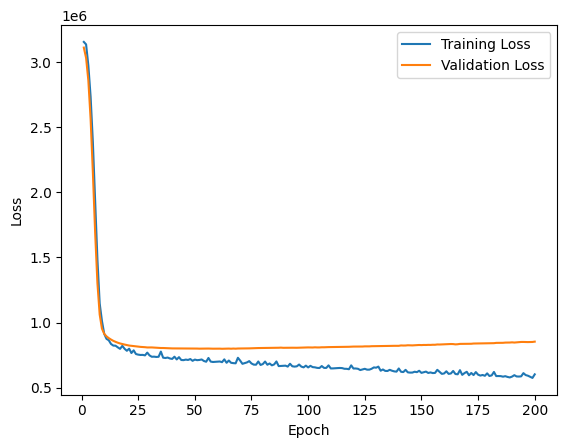

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse5_5030, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_sl5_5010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse5, temp_sl5_5010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl5_5010.fc1.weight.shape)
print("fc2 weight shape:", temp_sl5_5010.fc2.weight.shape)
print("fc3 weight shape:", temp_sl5_5010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl5_5010 = temp_sl5_5010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl5_5010 = apply_pca_and_reshape(original_fc1_weights_sl5_5010,
                                                        50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl5_5010.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl5_5010 = temp_sl5_5010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl5_5010 = apply_pca_and_reshape(original_fc2_weights_sl5_5010,
                                                        10)

# Instantiate the compressed model
PCA_sparse5_5010 = CompressedRegressionNN(58, 50, 10, 1)

# Assign the PCA-transformed weights
PCA_sparse5_5010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl5_5010).float().view(50, 58)
PCA_sparse5_5010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl5_5010).float().view(10, 50)

# Reset biases
PCA_sparse5_5010.fc1.bias.data.fill_(0)
PCA_sparse5_5010.fc2.bias.data.fill_(0)
PCA_sparse5_5010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse5_5010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse5_5010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse5_5010.fc3.weight.shape)
print()
print(PCA_sparse5_5010)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([10, 50])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse5_5010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131278.2775, Average MAE: 1498.9565


Epoch [1/200], MSE Loss (Train): 3184202.779, MAE Loss (Train): 1517.939
Validation Loss: 3122623.096, Validation MAE: 1496.006
Epoch [2/200], MSE Loss (Train): 3188688.998, MAE Loss (Train): 1517.500
Validation Loss: 3086729.365, Validation MAE: 1484.229
Epoch [3/200], MSE Loss (Train): 3145311.368, MAE Loss (Train): 1503.312
Validation Loss: 3021249.519, Validation MAE: 1462.487
Epoch [4/200], MSE Loss (Train): 3057900.115, MAE Loss (Train): 1471.401
Validation Loss: 2906427.038, Validation MAE: 1423.925
Epoch [5/200], MSE Loss (Train): 2859488.743, MAE Loss (Train): 1412.594
Validation Loss: 2725593.702, Validation MAE: 1361.207
Epoch [6/200], MSE Loss (Train): 2646392.978, MAE Loss (Train): 1337.918
Validation Loss: 2478635.135, Validation MAE: 1270.979
Epoch [7/200], MSE Loss (Train): 2370212.923, MAE Loss (Train): 1229.727
Validation Loss: 2179843.327, Validation MAE: 1152.070
Epoch [8/200], MSE Loss (Train): 2019297.772, MAE Loss (Train): 1091.302
Validation Loss: 1861292.654, V

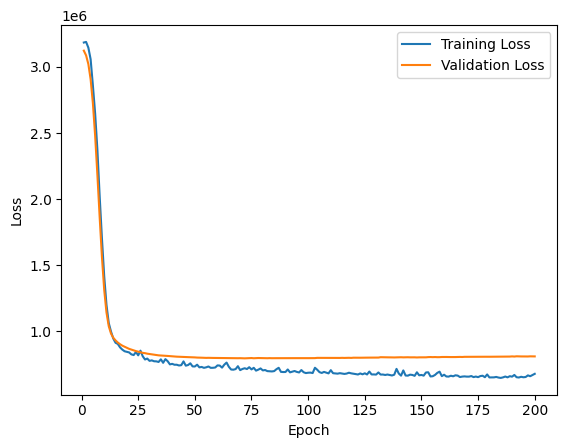

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse5_5010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=50 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_sl5_505 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse5, temp_sl5_505)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl5_505.fc1.weight.shape)
print("fc2 weight shape:", temp_sl5_505.fc2.weight.shape)
print("fc3 weight shape:", temp_sl5_505.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl5_505 = temp_sl5_505.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl5_505 = apply_pca_and_reshape(original_fc1_weights_sl5_505,
                                                       50)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl5_505.fc2 = nn.Linear(50, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl5_505 = temp_sl5_505.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl5_505 = apply_pca_and_reshape(original_fc2_weights_sl5_505,
                                                       5)

# Instantiate the compressed model
PCA_sparse5_505 = CompressedRegressionNN(58, 50, 5, 1)

# Assign the PCA-transformed weights
PCA_sparse5_505.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl5_505).float().view(50, 58)
PCA_sparse5_505.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl5_505).float().view(5, 50)

# Reset biases
PCA_sparse5_505.fc1.bias.data.fill_(0)
PCA_sparse5_505.fc2.bias.data.fill_(0)
PCA_sparse5_505.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse5_505.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse5_505.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse5_505.fc3.weight.shape)
print()
print(PCA_sparse5_505)

Transformed fc1 weight shape: torch.Size([50, 58])
Transformed fc2 weight shape: torch.Size([5, 50])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse5_505, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130959.8075, Average MAE: 1498.8457


Epoch [1/200], MSE Loss (Train): 3179371.567, MAE Loss (Train): 1517.897
Validation Loss: 3127117.558, Validation MAE: 1497.463
Epoch [2/200], MSE Loss (Train): 3169839.137, MAE Loss (Train): 1515.483
Validation Loss: 3103271.558, Validation MAE: 1489.680
Epoch [3/200], MSE Loss (Train): 3119134.180, MAE Loss (Train): 1501.213
Validation Loss: 3059471.423, Validation MAE: 1475.391
Epoch [4/200], MSE Loss (Train): 3071418.538, MAE Loss (Train): 1481.535
Validation Loss: 2984871.981, Validation MAE: 1450.907
Epoch [5/200], MSE Loss (Train): 2950038.832, MAE Loss (Train): 1445.777
Validation Loss: 2871514.519, Validation MAE: 1413.108
Epoch [6/200], MSE Loss (Train): 2821374.375, MAE Loss (Train): 1402.498
Validation Loss: 2711904.308, Validation MAE: 1358.399
Epoch [7/200], MSE Loss (Train): 2640896.560, MAE Loss (Train): 1340.062
Validation Loss: 2505988.125, Validation MAE: 1284.396
Epoch [8/200], MSE Loss (Train): 2396804.585, MAE Loss (Train): 1247.169
Validation Loss: 2258760.692, V

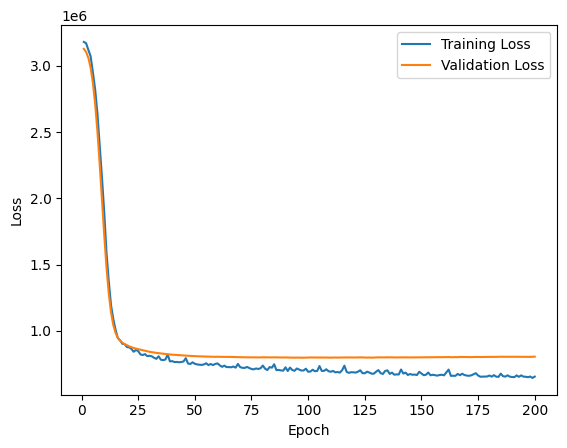

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse5_505, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=10

In [ ]:
# create copy of the locally pruned model
temp_sl5_3010 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse5, temp_sl5_3010)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl5_3010.fc1.weight.shape)
print("fc2 weight shape:", temp_sl5_3010.fc2.weight.shape)
print("fc3 weight shape:", temp_sl5_3010.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl5_3010 = temp_sl5_3010.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl5_3010 = apply_pca_and_reshape(original_fc1_weights_sl5_3010,
                                                        30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl5_3010.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl5_3010 = temp_sl5_3010.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl5_3010 = apply_pca_and_reshape(original_fc2_weights_sl5_3010,
                                                        10)

# Instantiate the compressed model
PCA_sparse5_3010 = CompressedRegressionNN(58, 30, 10, 1)

# Assign the PCA-transformed weights
PCA_sparse5_3010.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl5_3010).float().view(30, 58)
PCA_sparse5_3010.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl5_3010).float().view(10, 30)

# Reset biases
PCA_sparse5_3010.fc1.bias.data.fill_(0)
PCA_sparse5_3010.fc2.bias.data.fill_(0)
PCA_sparse5_3010.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse5_3010.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse5_3010.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse5_3010.fc3.weight.shape)
print()
print(PCA_sparse5_3010)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([10, 30])
Transformed fc3 weight shape: torch.Size([1, 10])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=10, bias=True)
  (fc3): Linear(in_features=10, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse5_3010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3127934.6491, Average MAE: 1497.8253


Epoch [1/200], MSE Loss (Train): 3228535.928, MAE Loss (Train): 1522.764
Validation Loss: 3118569.923, Validation MAE: 1494.650
Epoch [2/200], MSE Loss (Train): 3133564.159, MAE Loss (Train): 1503.574
Validation Loss: 3078690.212, Validation MAE: 1481.659
Epoch [3/200], MSE Loss (Train): 3084517.291, MAE Loss (Train): 1487.971
Validation Loss: 3001924.135, Validation MAE: 1456.447
Epoch [4/200], MSE Loss (Train): 2991858.572, MAE Loss (Train): 1459.420
Validation Loss: 2876963.019, Validation MAE: 1414.798
Epoch [5/200], MSE Loss (Train): 2845614.534, MAE Loss (Train): 1406.659
Validation Loss: 2696161.481, Validation MAE: 1353.023
Epoch [6/200], MSE Loss (Train): 2651534.945, MAE Loss (Train): 1338.116
Validation Loss: 2461572.856, Validation MAE: 1268.371
Epoch [7/200], MSE Loss (Train): 2337775.373, MAE Loss (Train): 1226.580
Validation Loss: 2181209.010, Validation MAE: 1158.983
Epoch [8/200], MSE Loss (Train): 2053182.276, MAE Loss (Train): 1111.058
Validation Loss: 1883501.538, V

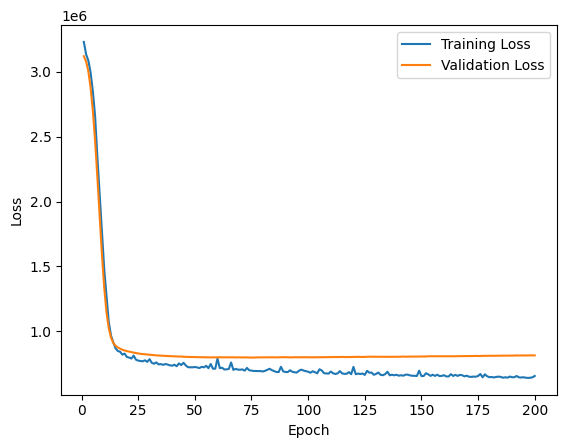

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse5_3010, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=30 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_sl5_305 = RegressionNN(input_size, hidden_size1,
                           hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse5, temp_sl5_305)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl5_305.fc1.weight.shape)
print("fc2 weight shape:", temp_sl5_305.fc2.weight.shape)
print("fc3 weight shape:", temp_sl5_305.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl5_305 = temp_sl5_305.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl5_305 = apply_pca_and_reshape(original_fc1_weights_sl5_305,
                                                       30)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl5_305.fc2 = nn.Linear(30, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl5_305 = temp_sl5_305.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl5_305 = apply_pca_and_reshape(original_fc2_weights_sl5_305,
                                                        5)

# Instantiate the compressed model
PCA_sparse5_305 = CompressedRegressionNN(58, 30, 5, 1)

# Assign the PCA-transformed weights
PCA_sparse5_305.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl5_305).float().view(30, 58)
PCA_sparse5_305.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl5_305).float().view(5, 30)

# Reset biases
PCA_sparse5_305.fc1.bias.data.fill_(0)
PCA_sparse5_305.fc2.bias.data.fill_(0)
PCA_sparse5_305.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse5_305.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse5_305.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse5_305.fc3.weight.shape)
print()
print(PCA_sparse5_305)

Transformed fc1 weight shape: torch.Size([30, 58])
Transformed fc2 weight shape: torch.Size([5, 30])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=30, bias=True)
  (fc2): Linear(in_features=30, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse5_305, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3133463.4914, Average MAE: 1499.5613


Epoch [1/200], MSE Loss (Train): 3170944.538, MAE Loss (Train): 1518.212
Validation Loss: 3132298.038, Validation MAE: 1499.001
Epoch [2/200], MSE Loss (Train): 3145615.512, MAE Loss (Train): 1507.931
Validation Loss: 3118616.231, Validation MAE: 1494.482
Epoch [3/200], MSE Loss (Train): 3166673.885, MAE Loss (Train): 1514.116
Validation Loss: 3095408.904, Validation MAE: 1486.890
Epoch [4/200], MSE Loss (Train): 3191852.952, MAE Loss (Train): 1511.261
Validation Loss: 3060194.327, Validation MAE: 1475.381
Epoch [5/200], MSE Loss (Train): 3058080.406, MAE Loss (Train): 1481.195
Validation Loss: 3009204.212, Validation MAE: 1458.736
Epoch [6/200], MSE Loss (Train): 2992904.070, MAE Loss (Train): 1460.143
Validation Loss: 2939572.558, Validation MAE: 1435.922
Epoch [7/200], MSE Loss (Train): 2921107.411, MAE Loss (Train): 1437.332
Validation Loss: 2847432.712, Validation MAE: 1405.344
Epoch [8/200], MSE Loss (Train): 2879024.478, MAE Loss (Train): 1418.311
Validation Loss: 2730133.452, V

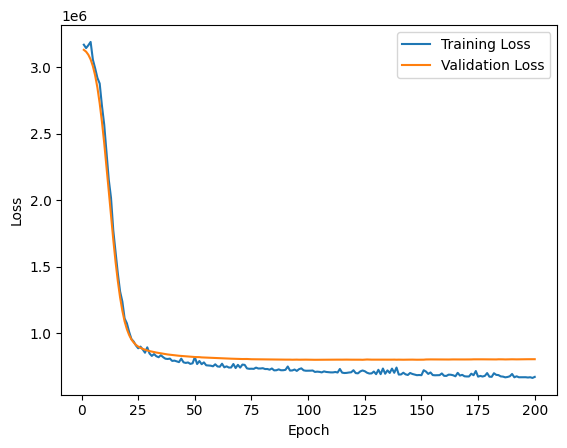

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse5_305, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

###### fc1 out_features=10 and fc2 out_features=5

In [ ]:
# create copy of the locally pruned model
temp_sl5_105 = RegressionNN(input_size, hidden_size1,
                               hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse5, temp_sl5_105)

In [ ]:
# weight shape of the loaded pruned model
print("fc1 weight shape:", temp_sl5_105.fc1.weight.shape)
print("fc2 weight shape:", temp_sl5_105.fc2.weight.shape)
print("fc3 weight shape:", temp_sl5_105.fc3.weight.shape)

fc1 weight shape: torch.Size([64, 58])
fc2 weight shape: torch.Size([32, 64])
fc3 weight shape: torch.Size([1, 32])


In [ ]:
# Extract weights from the pruned model
original_fc1_weights_sl5_105 = temp_sl5_105.fc1.weight.data.cpu().numpy()

# Apply PCA to fc1 weights
transformed_fc1_weights_sl5_105 = apply_pca_and_reshape(original_fc1_weights_sl5_105,
                                                       10)

# Update fc2 in the pruned model to match new fc1 out_features
temp_sl5_105.fc2 = nn.Linear(10, hidden_size2)

# Extract fc2 weights after updating fc2 in the pruned model
original_fc2_weights_sl5_105 = temp_sl5_105.fc2.weight.data.cpu().numpy()

# Apply PCA to fc2 weights
transformed_fc2_weights_sl5_105 = apply_pca_and_reshape(original_fc2_weights_sl5_105,
                                                        5)

# Instantiate the compressed model
PCA_sparse5_105 = CompressedRegressionNN(58, 10, 5, 1)

# Assign the PCA-transformed weights
PCA_sparse5_105.fc1.weight.data = torch.from_numpy(transformed_fc1_weights_sl5_105).float().view(10, 58)
PCA_sparse5_105.fc2.weight.data = torch.from_numpy(transformed_fc2_weights_sl5_105).float().view(5, 10)

# Reset biases
PCA_sparse5_105.fc1.bias.data.fill_(0)
PCA_sparse5_105.fc2.bias.data.fill_(0)
PCA_sparse5_105.fc3.bias.data.fill_(0)

# Validate the weight shapes
print("Transformed fc1 weight shape:", PCA_sparse5_105.fc1.weight.shape)
print("Transformed fc2 weight shape:", PCA_sparse5_105.fc2.weight.shape)
print("Transformed fc3 weight shape:", PCA_sparse5_105.fc3.weight.shape)
print()
print(PCA_sparse5_105)

Transformed fc1 weight shape: torch.Size([10, 58])
Transformed fc2 weight shape: torch.Size([5, 10])
Transformed fc3 weight shape: torch.Size([1, 5])

CompressedRegressionNN(
  (fc1): Linear(in_features=58, out_features=10, bias=True)
  (fc2): Linear(in_features=10, out_features=5, bias=True)
  (fc3): Linear(in_features=5, out_features=1, bias=True)
)


In [ ]:
average_loss, average_mae = evaluate_model(PCA_sparse5_105, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131112.1229, Average MAE: 1498.8251


Epoch [1/200], MSE Loss (Train): 3235067.490, MAE Loss (Train): 1525.809
Validation Loss: 3132256.981, Validation MAE: 1498.945
Epoch [2/200], MSE Loss (Train): 3151565.401, MAE Loss (Train): 1510.879
Validation Loss: 3124034.654, Validation MAE: 1496.105
Epoch [3/200], MSE Loss (Train): 3190316.769, MAE Loss (Train): 1518.579
Validation Loss: 3110381.481, Validation MAE: 1491.500
Epoch [4/200], MSE Loss (Train): 3132671.613, MAE Loss (Train): 1504.484
Validation Loss: 3088484.846, Validation MAE: 1484.200
Epoch [5/200], MSE Loss (Train): 3108275.279, MAE Loss (Train): 1495.322
Validation Loss: 3056978.558, Validation MAE: 1473.763
Epoch [6/200], MSE Loss (Train): 3061494.106, MAE Loss (Train): 1479.659
Validation Loss: 3014571.538, Validation MAE: 1459.566
Epoch [7/200], MSE Loss (Train): 3008572.505, MAE Loss (Train): 1464.698
Validation Loss: 2959184.788, Validation MAE: 1440.931
Epoch [8/200], MSE Loss (Train): 2952428.322, MAE Loss (Train): 1445.984
Validation Loss: 2886572.731, V

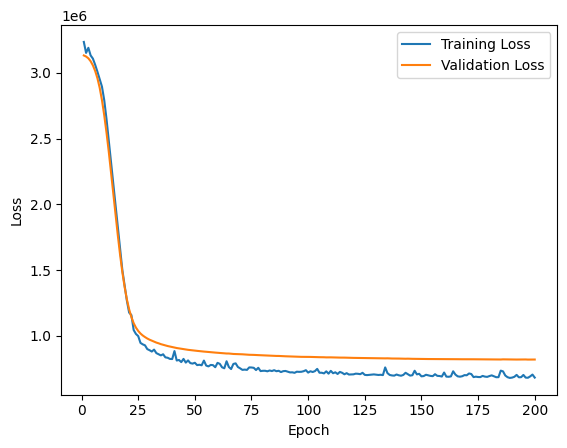

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=PCA_sparse5_105, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

## Sparse Principal Components Analysis (SparsePCA) on a Pruned Model

In [ ]:
# function to apply SparsePCA on the input features, in_features
# alpha (float) - high value to ensure more sparsity
def apply_sparse_pca(layer, n_components, alpha=1.0):

    # Extract the layer's weights and transposing them
    weights = layer.weight.data.cpu().numpy().T

    # Initialize the SparsePCA
    # reference: https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.SparsePCA.html#sklearn.decomposition.SparsePCA
    sparse_pca = SparsePCA(n_components=n_components, alpha=alpha, random_state=42)

    # Fit the SparsePCA model on the transposed weights and transforming them
    transformed_weights = sparse_pca.fit_transform(weights)

    # Transpose the transformed weights back to their original orientation
    return transformed_weights.T

### SparsePCA on Locally Pruned Model

#### SparsePCA on the Pruned Model, `pruned_local1`, with Pruning Amount=0.6

###### no_components = 50

In [ ]:
# create copy of the model
sparsePCA_l1_temp = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local1, sparsePCA_l1_temp)

In [ ]:
# Apply SparsePCA to fc1 and fc2 of the pruned model
l1_50_transformed_fc1_weights = apply_sparse_pca(sparsePCA_l1_temp.fc1,
                                           n_components=50, alpha=0.5)

# the adjusted model
fc1_out_features = 50
fc2_out_features = 32
SparsePCA_l1_50 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_l1_50.fc1.weight.data = torch.FloatTensor(l1_50_transformed_fc1_weights).to(sparsePCA_l1_temp.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_l1_50.fc1.bias.data.fill_(0)
SparsePCA_l1_50.fc2.bias.data.fill_(0)
SparsePCA_l1_50.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_l1_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3128845.7836, Average MAE: 1498.1710


Epoch [1/200], MSE Loss (Train): 3135521.065, MAE Loss (Train): 1505.504
Validation Loss: 3090236.000, Validation MAE: 1484.918
Epoch [2/200], MSE Loss (Train): 3089341.433, MAE Loss (Train): 1488.322
Validation Loss: 2964474.365, Validation MAE: 1441.866
Epoch [3/200], MSE Loss (Train): 2942029.558, MAE Loss (Train): 1430.451
Validation Loss: 2705618.375, Validation MAE: 1349.928
Epoch [4/200], MSE Loss (Train): 2506515.113, MAE Loss (Train): 1283.708
Validation Loss: 2300803.837, Validation MAE: 1193.331
Epoch [5/200], MSE Loss (Train): 2039125.924, MAE Loss (Train): 1099.985
Validation Loss: 1815279.067, Validation MAE: 978.953
Epoch [6/200], MSE Loss (Train): 1595272.444, MAE Loss (Train): 885.416
Validation Loss: 1356894.817, Validation MAE: 771.522
Epoch [7/200], MSE Loss (Train): 1180043.501, MAE Loss (Train): 712.534
Validation Loss: 1065026.736, Validation MAE: 670.665
Epoch [8/200], MSE Loss (Train): 906353.249, MAE Loss (Train): 638.740
Validation Loss: 939556.582, Validatio

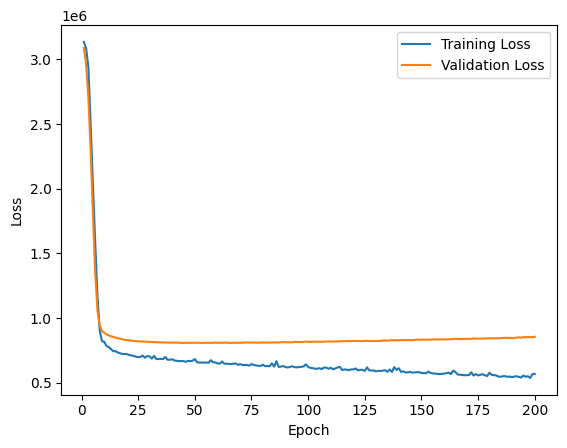

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_l1_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
sparsePCA_l13_temp = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local1, sparsePCA_l13_temp)

# Apply SparsePCA to fc1 and fc2 of the pruned model
l1_30_transformed_fc1_weights = apply_sparse_pca(sparsePCA_l13_temp.fc1,
                                           n_components=30, alpha=0.5)

# the adjusted model
fc1_out_features = 30
fc2_out_features = 32
SparsePCA_l1_30 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA l1_30_transformed weights
SparsePCA_l1_30.fc1.weight.data = torch.FloatTensor(l1_30_transformed_fc1_weights).to(sparsePCA_l13_temp.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_l1_30.fc1.bias.data.fill_(0)
SparsePCA_l1_30.fc2.bias.data.fill_(0)
SparsePCA_l1_30.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_l1_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132202.3802, Average MAE: 1499.2610


Epoch [1/200], MSE Loss (Train): 3225202.942, MAE Loss (Train): 1525.297
Validation Loss: 3112178.481, Validation MAE: 1492.170
Epoch [2/200], MSE Loss (Train): 3092729.429, MAE Loss (Train): 1489.358
Validation Loss: 3035704.173, Validation MAE: 1465.730
Epoch [3/200], MSE Loss (Train): 2992745.514, MAE Loss (Train): 1456.389
Validation Loss: 2874910.904, Validation MAE: 1409.025
Epoch [4/200], MSE Loss (Train): 2765065.286, MAE Loss (Train): 1378.145
Validation Loss: 2606868.202, Validation MAE: 1310.200
Epoch [5/200], MSE Loss (Train): 2453417.103, MAE Loss (Train): 1257.703
Validation Loss: 2237931.856, Validation MAE: 1161.574
Epoch [6/200], MSE Loss (Train): 2027471.519, MAE Loss (Train): 1086.282
Validation Loss: 1823719.798, Validation MAE: 977.404
Epoch [7/200], MSE Loss (Train): 1593635.364, MAE Loss (Train): 894.410
Validation Loss: 1441670.365, Validation MAE: 806.508
Epoch [8/200], MSE Loss (Train): 1254651.261, MAE Loss (Train): 752.895
Validation Loss: 1167420.678, Valid

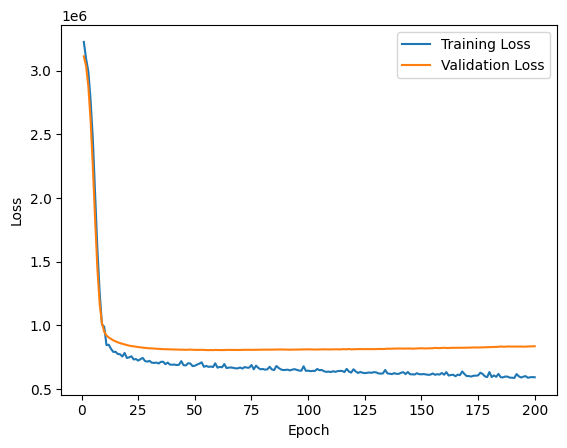

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_l1_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
sparsePCA_l110_temp = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local1, sparsePCA_l110_temp)

# Apply SparsePCA to fc1 and fc2 of the pruned model
l1_10_transformed_fc1_weights = apply_sparse_pca(sparsePCA_l110_temp.fc1,
                                           n_components=10, alpha=0.5)

# the adjusted model
fc1_out_features = 10
fc2_out_features = 32
SparsePCA_l1_10 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA l1_10_transformed weights
SparsePCA_l1_10.fc1.weight.data = torch.FloatTensor(l1_10_transformed_fc1_weights).to(sparsePCA_l110_temp.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_l1_10.fc1.bias.data.fill_(0)
SparsePCA_l1_10.fc2.bias.data.fill_(0)
SparsePCA_l1_10.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_l1_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130483.8154, Average MAE: 1498.8092


Epoch [1/200], MSE Loss (Train): 3196954.892, MAE Loss (Train): 1516.943
Validation Loss: 3119862.212, Validation MAE: 1495.024
Epoch [2/200], MSE Loss (Train): 3153596.050, MAE Loss (Train): 1508.089
Validation Loss: 3084563.673, Validation MAE: 1483.035
Epoch [3/200], MSE Loss (Train): 3075779.962, MAE Loss (Train): 1486.587
Validation Loss: 3009777.000, Validation MAE: 1457.400
Epoch [4/200], MSE Loss (Train): 2961433.339, MAE Loss (Train): 1447.029
Validation Loss: 2879751.365, Validation MAE: 1411.688
Epoch [5/200], MSE Loss (Train): 2858088.469, MAE Loss (Train): 1401.367
Validation Loss: 2691419.462, Validation MAE: 1342.289
Epoch [6/200], MSE Loss (Train): 2578856.050, MAE Loss (Train): 1308.487
Validation Loss: 2448819.798, Validation MAE: 1246.345
Epoch [7/200], MSE Loss (Train): 2380099.995, MAE Loss (Train): 1221.819
Validation Loss: 2175928.087, Validation MAE: 1129.138
Epoch [8/200], MSE Loss (Train): 2052246.798, MAE Loss (Train): 1088.747
Validation Loss: 1895788.817, V

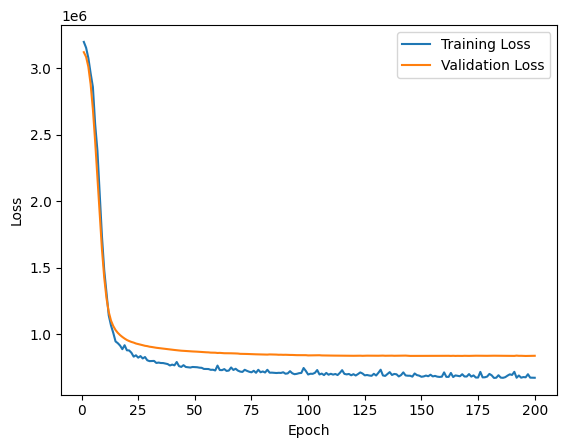

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_l1_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### SparsePCA on the Pruned Model, `pruned_local2`, with Pruning Amount=0.7

##### no_components = 50

In [ ]:
# create copy of the model
sparse_l2_temp = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local2, sparse_l2_temp)

In [ ]:
# Apply SparsePCA to fc1 and fc2 of the pruned model
l2_50_transformed_fc1_weights = apply_sparse_pca(sparse_l2_temp.fc1,
                                           n_components=50, alpha=0.5)

# the adjusted model
fc1_out_features = 50
fc2_out_features = 32
SparsePCA_l2_50 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA l2_50_transformed weights
SparsePCA_l2_50.fc1.weight.data = torch.FloatTensor(l2_50_transformed_fc1_weights).to(sparse_l2_temp.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_l2_50.fc1.bias.data.fill_(0)
SparsePCA_l2_50.fc2.bias.data.fill_(0)
SparsePCA_l2_50.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_l2_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132117.5208, Average MAE: 1499.2566


Epoch [1/200], MSE Loss (Train): 3220968.255, MAE Loss (Train): 1524.864
Validation Loss: 3100453.327, Validation MAE: 1488.468
Epoch [2/200], MSE Loss (Train): 3116393.721, MAE Loss (Train): 1492.396
Validation Loss: 2990044.558, Validation MAE: 1451.286
Epoch [3/200], MSE Loss (Train): 2925609.320, MAE Loss (Train): 1432.294
Validation Loss: 2758330.596, Validation MAE: 1370.875
Epoch [4/200], MSE Loss (Train): 2583058.096, MAE Loss (Train): 1314.323
Validation Loss: 2388296.365, Validation MAE: 1232.988
Epoch [5/200], MSE Loss (Train): 2166149.615, MAE Loss (Train): 1150.742
Validation Loss: 1913534.788, Validation MAE: 1033.291
Epoch [6/200], MSE Loss (Train): 1648761.944, MAE Loss (Train): 925.929
Validation Loss: 1446040.933, Validation MAE: 818.734
Epoch [7/200], MSE Loss (Train): 1237877.314, MAE Loss (Train): 745.852
Validation Loss: 1115582.995, Validation MAE: 685.543
Epoch [8/200], MSE Loss (Train): 967993.474, MAE Loss (Train): 653.104
Validation Loss: 952926.803, Validati

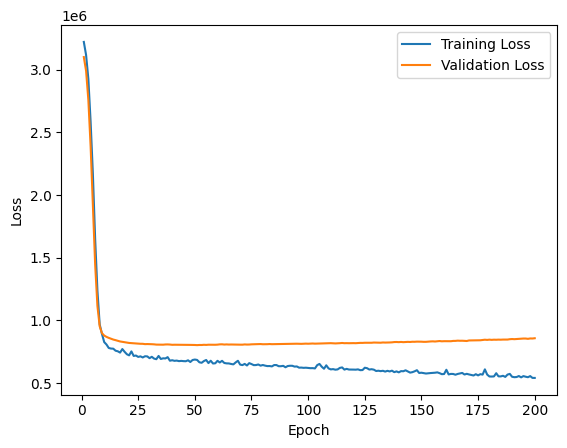

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_l2_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
sparse_l230_temp = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local2, sparse_l230_temp)

# Apply SparsePCA to fc1 and fc2 of the pruned model
l2_30_transformed_fc1_weights = apply_sparse_pca(sparse_l230_temp.fc1,
                                           n_components=30, alpha=0.5)

# the adjusted model
fc1_out_features = 30
fc2_out_features = 32
SparsePCA_l2_30 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA l2_30_transformed weights
SparsePCA_l2_30.fc1.weight.data = torch.FloatTensor(l2_30_transformed_fc1_weights).to(sparse_l230_temp.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_l2_30.fc1.bias.data.fill_(0)
SparsePCA_l2_30.fc2.bias.data.fill_(0)
SparsePCA_l2_30.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_l2_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131316.4957, Average MAE: 1498.9487


Epoch [1/200], MSE Loss (Train): 3209368.048, MAE Loss (Train): 1526.333
Validation Loss: 3118191.000, Validation MAE: 1494.248
Epoch [2/200], MSE Loss (Train): 3151099.481, MAE Loss (Train): 1509.018
Validation Loss: 3067931.442, Validation MAE: 1476.957
Epoch [3/200], MSE Loss (Train): 3062596.663, MAE Loss (Train): 1479.911
Validation Loss: 2958070.712, Validation MAE: 1438.852
Epoch [4/200], MSE Loss (Train): 2888360.940, MAE Loss (Train): 1420.901
Validation Loss: 2756341.029, Validation MAE: 1366.560
Epoch [5/200], MSE Loss (Train): 2652478.231, MAE Loss (Train): 1333.423
Validation Loss: 2445643.163, Validation MAE: 1247.891
Epoch [6/200], MSE Loss (Train): 2335150.142, MAE Loss (Train): 1198.305
Validation Loss: 2046797.962, Validation MAE: 1078.095
Epoch [7/200], MSE Loss (Train): 1851981.452, MAE Loss (Train): 995.123
Validation Loss: 1630787.769, Validation MAE: 889.906
Epoch [8/200], MSE Loss (Train): 1409033.979, MAE Loss (Train): 809.395
Validation Loss: 1293322.462, Vali

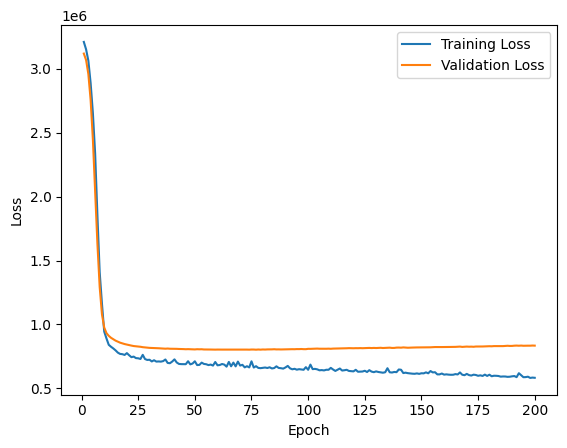

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_l2_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
sparse_l210_temp = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local2, sparse_l210_temp)

# Apply SparsePCA to fc1 and fc2 of the pruned model
l2_10_transformed_fc1_weights = apply_sparse_pca(sparse_l210_temp.fc1,
                                           n_components=10, alpha=0.5)

# the adjusted model
fc1_out_features = 10
fc2_out_features = 32
SparsePCA_l2_10 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA l2_10_transformed weights
SparsePCA_l2_10.fc1.weight.data = torch.FloatTensor(l2_10_transformed_fc1_weights).to(sparse_l210_temp.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_l2_10.fc1.bias.data.fill_(0)
SparsePCA_l2_10.fc2.bias.data.fill_(0)
SparsePCA_l2_10.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_l2_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130830.8136, Average MAE: 1498.7049


Epoch [1/200], MSE Loss (Train): 3155545.683, MAE Loss (Train): 1510.952
Validation Loss: 3123092.615, Validation MAE: 1495.889
Epoch [2/200], MSE Loss (Train): 3147794.048, MAE Loss (Train): 1509.609
Validation Loss: 3087226.096, Validation MAE: 1483.769
Epoch [3/200], MSE Loss (Train): 3089718.500, MAE Loss (Train): 1491.473
Validation Loss: 3006567.058, Validation MAE: 1456.408
Epoch [4/200], MSE Loss (Train): 3040689.228, MAE Loss (Train): 1463.224
Validation Loss: 2869245.673, Validation MAE: 1408.893
Epoch [5/200], MSE Loss (Train): 2778719.814, MAE Loss (Train): 1387.234
Validation Loss: 2670335.308, Validation MAE: 1337.597
Epoch [6/200], MSE Loss (Train): 2546216.320, MAE Loss (Train): 1304.704
Validation Loss: 2416335.683, Validation MAE: 1240.980
Epoch [7/200], MSE Loss (Train): 2267650.793, MAE Loss (Train): 1197.462
Validation Loss: 2118511.337, Validation MAE: 1117.349
Epoch [8/200], MSE Loss (Train): 1923217.307, MAE Loss (Train): 1054.364
Validation Loss: 1809445.077, V

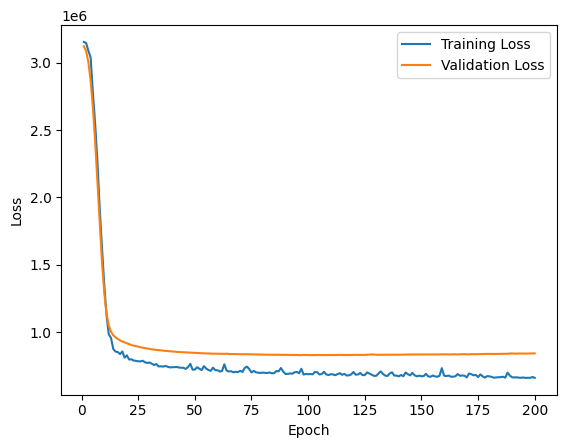

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_l2_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### SparsePCA on the Pruned Model, `pruned_local3`, with Pruning Amount=0.8

##### no_components = 50

In [ ]:
# create copy of the model
sparse_l3_temp = RegressionNN(input_size, hidden_size1, hidden_size2, output_size)
transfer_pruned_weights(pruned_local3, sparse_l3_temp)

In [ ]:
# Apply SparsePCA to fc1 and fc2 of the pruned model
l3_50_transformed_fc1_weights = apply_sparse_pca(sparse_l3_temp.fc1,
                                           n_components=50, alpha=0.5)

# the adjusted model
fc1_out_features = 50
fc2_out_features = 32
SparsePCA_l3_50 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_l3_50.fc1.weight.data = torch.FloatTensor(l3_50_transformed_fc1_weights).to(sparse_l3_temp.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_l3_50.fc1.bias.data.fill_(0)
SparsePCA_l3_50.fc2.bias.data.fill_(0)
SparsePCA_l3_50.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_l3_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132844.7005, Average MAE: 1499.4835


Epoch [1/200], MSE Loss (Train): 3188366.925, MAE Loss (Train): 1520.914
Validation Loss: 3115046.750, Validation MAE: 1493.278
Epoch [2/200], MSE Loss (Train): 3101710.137, MAE Loss (Train): 1494.815
Validation Loss: 3043617.731, Validation MAE: 1469.163
Epoch [3/200], MSE Loss (Train): 2988024.540, MAE Loss (Train): 1455.413
Validation Loss: 2890157.654, Validation MAE: 1416.664
Epoch [4/200], MSE Loss (Train): 2788222.666, MAE Loss (Train): 1388.214
Validation Loss: 2617888.817, Validation MAE: 1319.430
Epoch [5/200], MSE Loss (Train): 2442674.594, MAE Loss (Train): 1263.061
Validation Loss: 2228078.144, Validation MAE: 1167.142
Epoch [6/200], MSE Loss (Train): 1996034.081, MAE Loss (Train): 1081.553
Validation Loss: 1779561.221, Validation MAE: 969.295
Epoch [7/200], MSE Loss (Train): 1538022.553, MAE Loss (Train): 872.661
Validation Loss: 1368328.034, Validation MAE: 783.697
Epoch [8/200], MSE Loss (Train): 1178693.410, MAE Loss (Train): 722.712
Validation Loss: 1094111.947, Valid

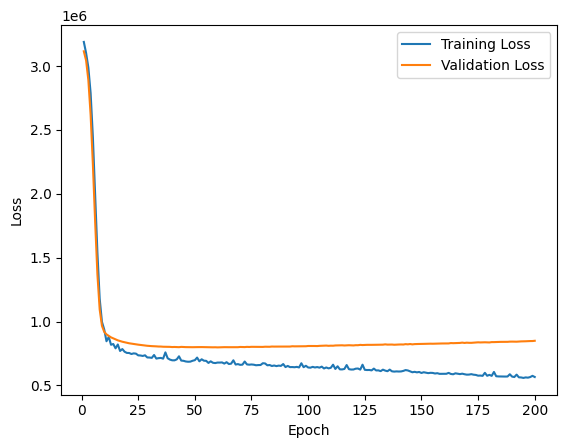

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_l3_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
sparse_l330_temp = RegressionNN(input_size, hidden_size1, hidden_size2, output_size)
transfer_pruned_weights(pruned_local3, sparse_l330_temp)

# Apply SparsePCA to fc1 and fc2 of the pruned model
l3_30_transformed_fc1_weights = apply_sparse_pca(sparse_l330_temp.fc1,
                                           n_components=30, alpha=0.5)

# the adjusted model
fc1_out_features = 30
fc2_out_features = 32
SparsePCA_l3_30 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_l3_30.fc1.weight.data = torch.FloatTensor(l3_30_transformed_fc1_weights).to(sparse_l330_temp.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_l3_30.fc1.bias.data.fill_(0)
SparsePCA_l3_30.fc2.bias.data.fill_(0)
SparsePCA_l3_30.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_l3_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130899.3661, Average MAE: 1498.8244


Epoch [1/200], MSE Loss (Train): 3176847.252, MAE Loss (Train): 1519.256
Validation Loss: 3119554.442, Validation MAE: 1494.701
Epoch [2/200], MSE Loss (Train): 3132510.082, MAE Loss (Train): 1503.828
Validation Loss: 3066634.635, Validation MAE: 1476.520
Epoch [3/200], MSE Loss (Train): 3103998.873, MAE Loss (Train): 1480.412
Validation Loss: 2951592.673, Validation MAE: 1436.659
Epoch [4/200], MSE Loss (Train): 2868504.359, MAE Loss (Train): 1413.516
Validation Loss: 2747710.010, Validation MAE: 1363.891
Epoch [5/200], MSE Loss (Train): 2626393.524, MAE Loss (Train): 1326.026
Validation Loss: 2437420.519, Validation MAE: 1246.308
Epoch [6/200], MSE Loss (Train): 2244964.799, MAE Loss (Train): 1178.353
Validation Loss: 2029650.990, Validation MAE: 1074.138
Epoch [7/200], MSE Loss (Train): 1813524.764, MAE Loss (Train): 994.072
Validation Loss: 1605013.394, Validation MAE: 881.162
Epoch [8/200], MSE Loss (Train): 1476733.916, MAE Loss (Train): 827.703
Validation Loss: 1246443.635, Vali

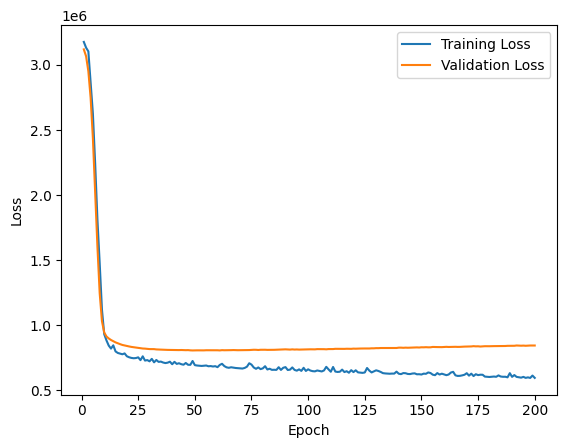

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_l3_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
sparse_l310_temp = RegressionNN(input_size, hidden_size1, hidden_size2, output_size)
transfer_pruned_weights(pruned_local3, sparse_l310_temp)
# Apply SparsePCA to fc1 and fc2 of the pruned model
l3_10_transformed_fc1_weights = apply_sparse_pca(sparse_l310_temp.fc1,
                                           n_components=10, alpha=0.5)

# the adjusted model
fc1_out_features = 10
fc2_out_features = 32
SparsePCA_l3_10 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_l3_10.fc1.weight.data = torch.FloatTensor(l3_10_transformed_fc1_weights).to(sparse_l310_temp.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_l3_10.fc1.bias.data.fill_(0)
SparsePCA_l3_10.fc2.bias.data.fill_(0)
SparsePCA_l3_10.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_l3_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3129486.2042, Average MAE: 1498.4324


Epoch [1/200], MSE Loss (Train): 3170494.219, MAE Loss (Train): 1516.907
Validation Loss: 3122322.615, Validation MAE: 1495.931
Epoch [2/200], MSE Loss (Train): 3149183.447, MAE Loss (Train): 1509.635
Validation Loss: 3092798.942, Validation MAE: 1486.310
Epoch [3/200], MSE Loss (Train): 3083836.226, MAE Loss (Train): 1488.717
Validation Loss: 3030189.135, Validation MAE: 1465.803
Epoch [4/200], MSE Loss (Train): 2993519.166, MAE Loss (Train): 1460.518
Validation Loss: 2917873.846, Validation MAE: 1428.382
Epoch [5/200], MSE Loss (Train): 2838188.144, MAE Loss (Train): 1408.998
Validation Loss: 2745802.067, Validation MAE: 1369.053
Epoch [6/200], MSE Loss (Train): 2625137.084, MAE Loss (Train): 1337.081
Validation Loss: 2510100.288, Validation MAE: 1282.625
Epoch [7/200], MSE Loss (Train): 2346104.776, MAE Loss (Train): 1232.763
Validation Loss: 2228048.442, Validation MAE: 1170.406
Epoch [8/200], MSE Loss (Train): 2032514.779, MAE Loss (Train): 1104.118
Validation Loss: 1925170.846, V

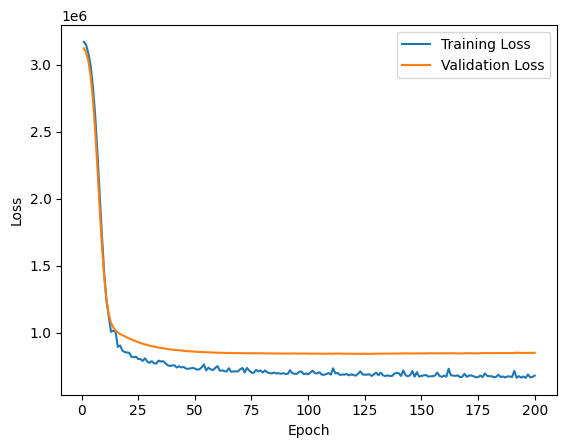

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_l3_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### SparsePCA on the Pruned Model, `pruned_local4`, with Pruning Amount=0.9

##### no_components = 50

In [ ]:
# create copy of the model
sparse_l4_temp = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local4, sparse_l4_temp)

In [ ]:
# Apply SparsePCA to fc1 and fc2 of the pruned model
l4_50_transformed_fc1_weights = apply_sparse_pca(sparse_l4_temp.fc1,
                                           n_components=50, alpha=0.5)

# the adjusted model
fc1_out_features = 50
fc2_out_features = 32
SparsePCA_l4_50 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_l4_50.fc1.weight.data = torch.FloatTensor(l4_50_transformed_fc1_weights).to(sparse_l4_temp.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_l4_50.fc1.bias.data.fill_(0)
SparsePCA_l4_50.fc2.bias.data.fill_(0)
SparsePCA_l4_50.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_l4_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131597.8032, Average MAE: 1499.0719


Epoch [1/200], MSE Loss (Train): 3197147.639, MAE Loss (Train): 1522.246
Validation Loss: 3112674.750, Validation MAE: 1492.666
Epoch [2/200], MSE Loss (Train): 3134443.803, MAE Loss (Train): 1503.486
Validation Loss: 3032789.212, Validation MAE: 1466.236
Epoch [3/200], MSE Loss (Train): 2985199.010, MAE Loss (Train): 1456.774
Validation Loss: 2844445.962, Validation MAE: 1402.823
Epoch [4/200], MSE Loss (Train): 2739306.555, MAE Loss (Train): 1368.062
Validation Loss: 2508502.971, Validation MAE: 1282.708
Epoch [5/200], MSE Loss (Train): 2314780.726, MAE Loss (Train): 1209.392
Validation Loss: 2050094.010, Validation MAE: 1098.654
Epoch [6/200], MSE Loss (Train): 1800956.609, MAE Loss (Train): 999.790
Validation Loss: 1570430.846, Validation MAE: 879.544
Epoch [7/200], MSE Loss (Train): 1356033.595, MAE Loss (Train): 803.840
Validation Loss: 1206282.043, Validation MAE: 726.809
Epoch [8/200], MSE Loss (Train): 1073207.581, MAE Loss (Train): 696.660
Validation Loss: 1017783.764, Valida

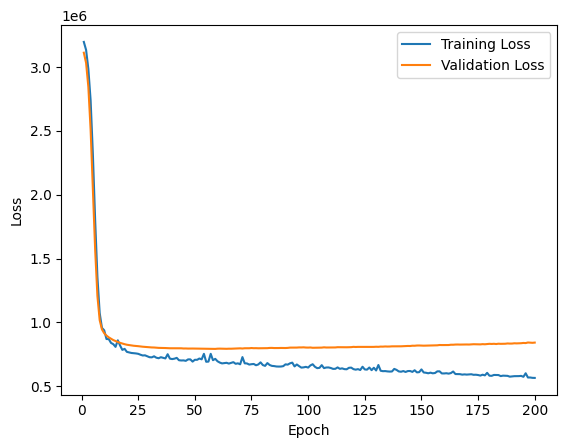

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_l4_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
sparse_l430_temp = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local4, sparse_l430_temp)
# Apply SparsePCA to fc1 and fc2 of the pruned model
l4_30_transformed_fc1_weights = apply_sparse_pca(sparse_l430_temp.fc1,
                                           n_components=30, alpha=0.5)

# the adjusted model
fc1_out_features = 30
fc2_out_features = 32
SparsePCA_l4_30 = CompressedRegressionNN(input_size, fc1_out_features,
                                       fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_l4_30.fc1.weight.data = torch.FloatTensor(l4_30_transformed_fc1_weights).to(sparse_l430_temp.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_l4_30.fc1.bias.data.fill_(0)
SparsePCA_l4_30.fc2.bias.data.fill_(0)
SparsePCA_l4_30.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_l4_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132349.9425, Average MAE: 1499.3263


Epoch [1/200], MSE Loss (Train): 3164071.425, MAE Loss (Train): 1513.344
Validation Loss: 3121651.058, Validation MAE: 1495.622
Epoch [2/200], MSE Loss (Train): 3177487.279, MAE Loss (Train): 1508.225
Validation Loss: 3069570.615, Validation MAE: 1478.300
Epoch [3/200], MSE Loss (Train): 3094956.519, MAE Loss (Train): 1485.721
Validation Loss: 2953147.731, Validation MAE: 1439.227
Epoch [4/200], MSE Loss (Train): 2878663.531, MAE Loss (Train): 1419.682
Validation Loss: 2731952.212, Validation MAE: 1362.837
Epoch [5/200], MSE Loss (Train): 2666790.488, MAE Loss (Train): 1332.482
Validation Loss: 2388140.663, Validation MAE: 1235.311
Epoch [6/200], MSE Loss (Train): 2206215.159, MAE Loss (Train): 1166.682
Validation Loss: 1954920.644, Validation MAE: 1054.030
Epoch [7/200], MSE Loss (Train): 1739241.931, MAE Loss (Train): 964.422
Validation Loss: 1529150.034, Validation MAE: 861.596
Epoch [8/200], MSE Loss (Train): 1387661.543, MAE Loss (Train): 809.723
Validation Loss: 1211200.928, Vali

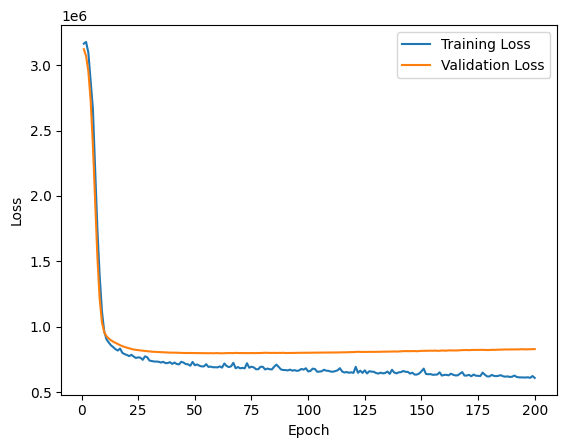

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_l4_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
sparse_l410_temp = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local4, sparse_l410_temp)

# Apply SparsePCA to fc1 and fc2 of the pruned model
l4_10_transformed_fc1_weights = apply_sparse_pca(sparse_l410_temp.fc1,
                                           n_components=10, alpha=0.5)

# the adjusted model
fc1_out_features = 10
fc2_out_features = 32
SparsePCA_l4_10 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_l4_10.fc1.weight.data = torch.FloatTensor(l4_10_transformed_fc1_weights).to(sparse_l410_temp.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_l4_10.fc1.bias.data.fill_(0)
SparsePCA_l4_10.fc2.bias.data.fill_(0)
SparsePCA_l4_10.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_l4_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131225.7537, Average MAE: 1498.9478


Epoch [1/200], MSE Loss (Train): 3168590.452, MAE Loss (Train): 1515.960
Validation Loss: 3129413.212, Validation MAE: 1498.266
Epoch [2/200], MSE Loss (Train): 3143754.284, MAE Loss (Train): 1508.432
Validation Loss: 3109671.019, Validation MAE: 1491.857
Epoch [3/200], MSE Loss (Train): 3197346.582, MAE Loss (Train): 1515.130
Validation Loss: 3062485.135, Validation MAE: 1476.517
Epoch [4/200], MSE Loss (Train): 3069195.240, MAE Loss (Train): 1483.599
Validation Loss: 2969489.500, Validation MAE: 1446.173
Epoch [5/200], MSE Loss (Train): 2970930.877, MAE Loss (Train): 1447.306
Validation Loss: 2811756.942, Validation MAE: 1393.615
Epoch [6/200], MSE Loss (Train): 2817563.017, MAE Loss (Train): 1387.680
Validation Loss: 2578504.567, Validation MAE: 1312.195
Epoch [7/200], MSE Loss (Train): 2446673.438, MAE Loss (Train): 1266.692
Validation Loss: 2279203.558, Validation MAE: 1198.942
Epoch [8/200], MSE Loss (Train): 2136363.356, MAE Loss (Train): 1138.339
Validation Loss: 1946287.769, V

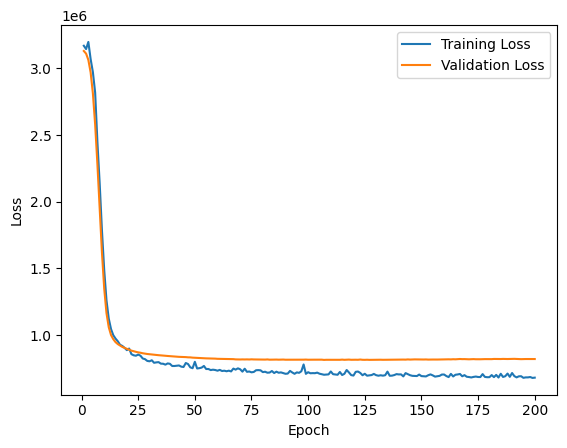

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_l4_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### SparsePCA on the Pruned Model, `pruned_local5`, with Pruning Amount=0.95

##### no_components = 50

In [ ]:
# create copy of the model
sparse_l5_temp = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local5, sparse_l5_temp)

In [ ]:
# Apply SparsePCA to fc1 and fc2 of the pruned model
l5_50_transformed_fc1_weights = apply_sparse_pca(sparse_l5_temp.fc1,
                                           n_components=50, alpha=0.5)

# the adjusted model
fc1_out_features = 50
fc2_out_features = 32
SparsePCA_l5_50 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_l5_50.fc1.weight.data = torch.FloatTensor(l5_50_transformed_fc1_weights).to(sparse_l5_temp.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_l5_50.fc1.bias.data.fill_(0)
SparsePCA_l5_50.fc2.bias.data.fill_(0)
SparsePCA_l5_50.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_l5_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130546.6797, Average MAE: 1498.6981


Epoch [1/200], MSE Loss (Train): 3193692.418, MAE Loss (Train): 1520.799
Validation Loss: 3117213.423, Validation MAE: 1494.140
Epoch [2/200], MSE Loss (Train): 3121401.356, MAE Loss (Train): 1501.385
Validation Loss: 3048886.558, Validation MAE: 1471.715
Epoch [3/200], MSE Loss (Train): 2985981.077, MAE Loss (Train): 1455.410
Validation Loss: 2869640.808, Validation MAE: 1412.330
Epoch [4/200], MSE Loss (Train): 2744369.839, MAE Loss (Train): 1374.823
Validation Loss: 2530714.721, Validation MAE: 1293.356
Epoch [5/200], MSE Loss (Train): 2303654.922, MAE Loss (Train): 1214.206
Validation Loss: 2041978.567, Validation MAE: 1099.618
Epoch [6/200], MSE Loss (Train): 1791771.312, MAE Loss (Train): 994.277
Validation Loss: 1539859.418, Validation MAE: 877.221
Epoch [7/200], MSE Loss (Train): 1351841.322, MAE Loss (Train): 812.528
Validation Loss: 1187762.851, Validation MAE: 732.984
Epoch [8/200], MSE Loss (Train): 1070419.942, MAE Loss (Train): 706.662
Validation Loss: 1021387.139, Valida

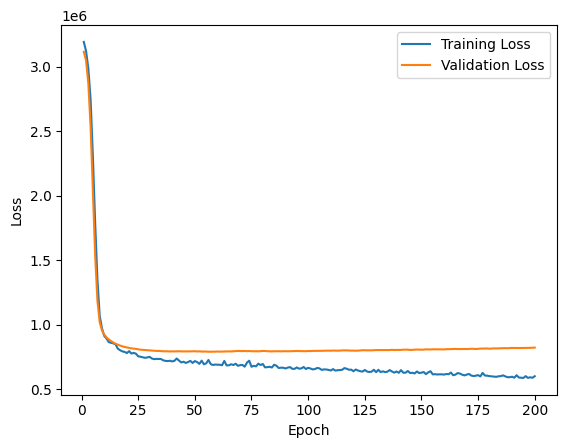

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_l5_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
sparse_l530_temp = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local5, sparse_l530_temp)

# Apply SparsePCA to fc1 and fc2 of the pruned model
l5_30_transform_fc1_weights = apply_sparse_pca(sparse_l530_temp.fc1,
                                           n_components=30, alpha=0.5)

# the adjusted model
fc1_out_features = 30
fc2_out_features = 32
SparsePCA_l5_30 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_l5_30.fc1.weight.data = torch.FloatTensor(l5_30_transform_fc1_weights).to(sparse_l530_temp.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_l5_30.fc1.bias.data.fill_(0)
SparsePCA_l5_30.fc2.bias.data.fill_(0)
SparsePCA_l5_30.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_l5_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131747.8185, Average MAE: 1499.1274


Epoch [1/200], MSE Loss (Train): 3191855.389, MAE Loss (Train): 1521.584
Validation Loss: 3123607.212, Validation MAE: 1496.323
Epoch [2/200], MSE Loss (Train): 3210706.404, MAE Loss (Train): 1519.428
Validation Loss: 3074692.750, Validation MAE: 1480.338
Epoch [3/200], MSE Loss (Train): 3029760.162, MAE Loss (Train): 1468.215
Validation Loss: 2955265.288, Validation MAE: 1441.052
Epoch [4/200], MSE Loss (Train): 2867645.899, MAE Loss (Train): 1418.163
Validation Loss: 2721212.548, Validation MAE: 1361.493
Epoch [5/200], MSE Loss (Train): 2590427.356, MAE Loss (Train): 1318.438
Validation Loss: 2349675.817, Validation MAE: 1224.639
Epoch [6/200], MSE Loss (Train): 2154157.572, MAE Loss (Train): 1144.829
Validation Loss: 1893344.106, Validation MAE: 1033.209
Epoch [7/200], MSE Loss (Train): 1688996.232, MAE Loss (Train): 949.789
Validation Loss: 1471966.159, Validation MAE: 845.763
Epoch [8/200], MSE Loss (Train): 1293468.769, MAE Loss (Train): 784.176
Validation Loss: 1175828.442, Vali

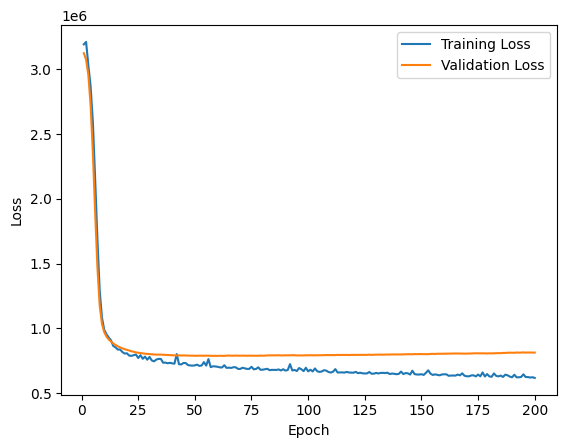

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_l5_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
sparse_l510_temp = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local5, sparse_l510_temp)

# Apply SparsePCA to fc1 and fc2 of the pruned model
l5_10_transformed_fc1_weights = apply_sparse_pca(sparse_l510_temp.fc1,
                                           n_components=10, alpha=0.5)

# the adjusted model
fc1_out_features = 10
fc2_out_features = 32
SparsePCA_l5_10 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_l5_10.fc1.weight.data = torch.FloatTensor(l5_10_transformed_fc1_weights).to(sparse_l510_temp.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_l5_10.fc1.bias.data.fill_(0)
SparsePCA_l5_10.fc2.bias.data.fill_(0)
SparsePCA_l5_10.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_l5_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3129547.7237, Average MAE: 1498.3872


Epoch [1/200], MSE Loss (Train): 3208774.365, MAE Loss (Train): 1523.771
Validation Loss: 3127664.173, Validation MAE: 1497.608
Epoch [2/200], MSE Loss (Train): 3178277.125, MAE Loss (Train): 1516.561
Validation Loss: 3104891.173, Validation MAE: 1490.034
Epoch [3/200], MSE Loss (Train): 3221842.726, MAE Loss (Train): 1523.219
Validation Loss: 3047525.135, Validation MAE: 1471.015
Epoch [4/200], MSE Loss (Train): 3108549.466, MAE Loss (Train): 1484.204
Validation Loss: 2937887.404, Validation MAE: 1434.236
Epoch [5/200], MSE Loss (Train): 3012930.709, MAE Loss (Train): 1446.451
Validation Loss: 2761906.548, Validation MAE: 1373.533
Epoch [6/200], MSE Loss (Train): 2699477.442, MAE Loss (Train): 1352.085
Validation Loss: 2510375.702, Validation MAE: 1282.301
Epoch [7/200], MSE Loss (Train): 2446733.317, MAE Loss (Train): 1245.017
Validation Loss: 2197232.654, Validation MAE: 1158.124
Epoch [8/200], MSE Loss (Train): 2054290.245, MAE Loss (Train): 1093.133
Validation Loss: 1850878.375, V

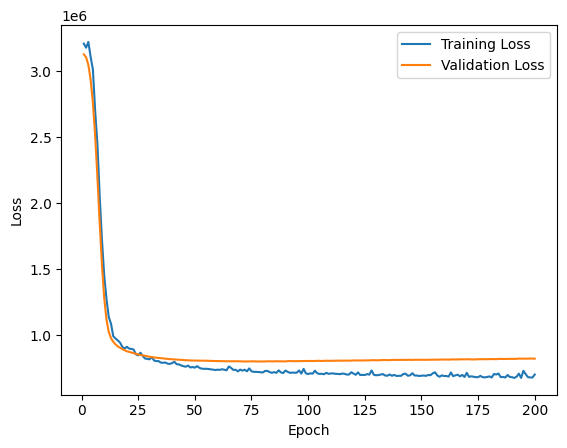

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_l5_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

### SparsePCA on Layer-Wise Locally Pruned Models

#### SparsePCA on the Pruned Model, `pruned_sparse1`, with Pruning Amount=0.6

##### no_components = 50

In [ ]:
# create copy of the model
SparsePCA_sparse1 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse1, SparsePCA_sparse1)

In [ ]:
# Apply SparsePCA to fc1 and fc2 of the pruned model
transformed_fc1_weights = apply_sparse_pca(SparsePCA_sparse1.fc1,
                                           n_components=50, alpha=0.5)

# the adjusted model
fc1_out_features = 50
fc2_out_features = 32
SparsePCA_sparse1_50 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_sparse1_50.fc1.weight.data = torch.FloatTensor(transformed_fc1_weights).to(SparsePCA_sparse1.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_sparse1_50.fc1.bias.data.fill_(0)
SparsePCA_sparse1_50.fc2.bias.data.fill_(0)
SparsePCA_sparse1_50.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_sparse1_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3133099.3178, Average MAE: 1499.5538


Epoch [1/200], MSE Loss (Train): 3154262.555, MAE Loss (Train): 1510.741
Validation Loss: 3108321.481, Validation MAE: 1490.929
Epoch [2/200], MSE Loss (Train): 3088662.442, MAE Loss (Train): 1488.098
Validation Loss: 3011489.692, Validation MAE: 1457.629
Epoch [3/200], MSE Loss (Train): 2981529.740, MAE Loss (Train): 1447.164
Validation Loss: 2810140.904, Validation MAE: 1386.393
Epoch [4/200], MSE Loss (Train): 2675367.827, MAE Loss (Train): 1346.943
Validation Loss: 2488574.221, Validation MAE: 1265.328
Epoch [5/200], MSE Loss (Train): 2274372.911, MAE Loss (Train): 1192.014
Validation Loss: 2071229.933, Validation MAE: 1090.342
Epoch [6/200], MSE Loss (Train): 1872075.272, MAE Loss (Train): 1009.567
Validation Loss: 1633421.736, Validation MAE: 890.844
Epoch [7/200], MSE Loss (Train): 1424497.776, MAE Loss (Train): 816.312
Validation Loss: 1267157.827, Validation MAE: 735.947
Epoch [8/200], MSE Loss (Train): 1070361.739, MAE Loss (Train): 680.517
Validation Loss: 1047301.125, Valid

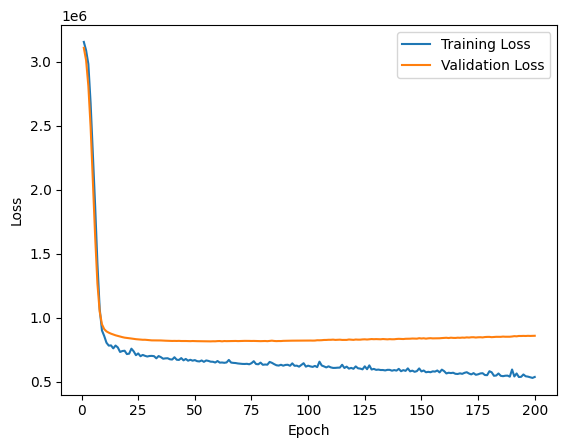

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_sparse1_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
SparsePCA_sparse130 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse1, SparsePCA_sparse130)

# Apply SparsePCA to fc1 and fc2 of the pruned model
transformed_fc1_weights = apply_sparse_pca(SparsePCA_sparse130.fc1,
                                           n_components=30, alpha=0.5)

# the adjusted model
fc1_out_features = 30
fc2_out_features = 32
SparsePCA_sparse1_30 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_sparse1_30.fc1.weight.data = torch.FloatTensor(transformed_fc1_weights).to(SparsePCA_sparse130.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_sparse1_30.fc1.bias.data.fill_(0)
SparsePCA_sparse1_30.fc2.bias.data.fill_(0)
SparsePCA_sparse1_30.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_sparse1_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3128872.9364, Average MAE: 1498.2074


Epoch [1/200], MSE Loss (Train): 3153128.666, MAE Loss (Train): 1508.036
Validation Loss: 3103334.038, Validation MAE: 1489.563
Epoch [2/200], MSE Loss (Train): 3105071.303, MAE Loss (Train): 1492.275
Validation Loss: 3009212.923, Validation MAE: 1458.085
Epoch [3/200], MSE Loss (Train): 2935101.456, MAE Loss (Train): 1439.389
Validation Loss: 2817413.875, Validation MAE: 1392.289
Epoch [4/200], MSE Loss (Train): 2687727.870, MAE Loss (Train): 1354.476
Validation Loss: 2494594.875, Validation MAE: 1274.657
Epoch [5/200], MSE Loss (Train): 2296888.469, MAE Loss (Train): 1210.396
Validation Loss: 2065719.683, Validation MAE: 1100.823
Epoch [6/200], MSE Loss (Train): 1898448.317, MAE Loss (Train): 1022.210
Validation Loss: 1603171.976, Validation MAE: 890.550
Epoch [7/200], MSE Loss (Train): 1369244.444, MAE Loss (Train): 803.889
Validation Loss: 1228143.582, Validation MAE: 725.527
Epoch [8/200], MSE Loss (Train): 1054353.473, MAE Loss (Train): 679.093
Validation Loss: 1011652.178, Valid

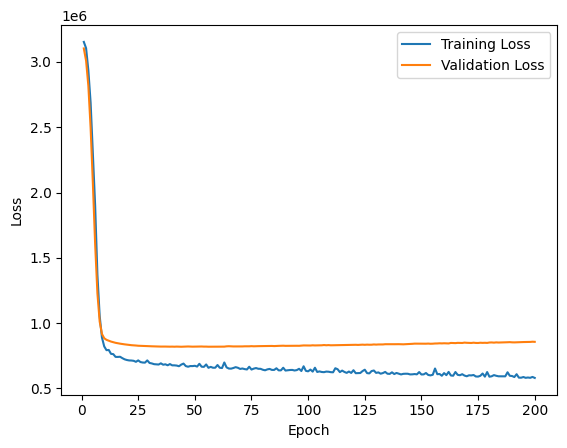

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_sparse1_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
SparsePCA_sparse110 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse1, SparsePCA_sparse110)

# Apply SparsePCA to fc1 and fc2 of the pruned model
transformed_fc1_weights = apply_sparse_pca(SparsePCA_sparse110.fc1,
                                           n_components=10, alpha=0.5)

# the adjusted model
fc1_out_features = 10
fc2_out_features = 32
SparsePCA_sparse1_10 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_sparse1_10.fc1.weight.data = torch.FloatTensor(transformed_fc1_weights).to(SparsePCA_sparse110.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_sparse1_10.fc1.bias.data.fill_(0)
SparsePCA_sparse1_10.fc2.bias.data.fill_(0)
SparsePCA_sparse1_10.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_sparse1_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130765.8227, Average MAE: 1498.8320


Epoch [1/200], MSE Loss (Train): 3159517.067, MAE Loss (Train): 1513.479
Validation Loss: 3124227.385, Validation MAE: 1496.454
Epoch [2/200], MSE Loss (Train): 3162905.219, MAE Loss (Train): 1514.514
Validation Loss: 3091544.000, Validation MAE: 1485.343
Epoch [3/200], MSE Loss (Train): 3110681.745, MAE Loss (Train): 1496.957
Validation Loss: 3017774.750, Validation MAE: 1459.838
Epoch [4/200], MSE Loss (Train): 3074339.483, MAE Loss (Train): 1469.293
Validation Loss: 2886115.269, Validation MAE: 1413.214
Epoch [5/200], MSE Loss (Train): 2795597.552, MAE Loss (Train): 1388.905
Validation Loss: 2694828.029, Validation MAE: 1342.329
Epoch [6/200], MSE Loss (Train): 2597150.673, MAE Loss (Train): 1314.302
Validation Loss: 2442199.202, Validation MAE: 1242.061
Epoch [7/200], MSE Loss (Train): 2292148.103, MAE Loss (Train): 1196.025
Validation Loss: 2143905.596, Validation MAE: 1112.014
Epoch [8/200], MSE Loss (Train): 1973134.106, MAE Loss (Train): 1058.551
Validation Loss: 1837803.865, V

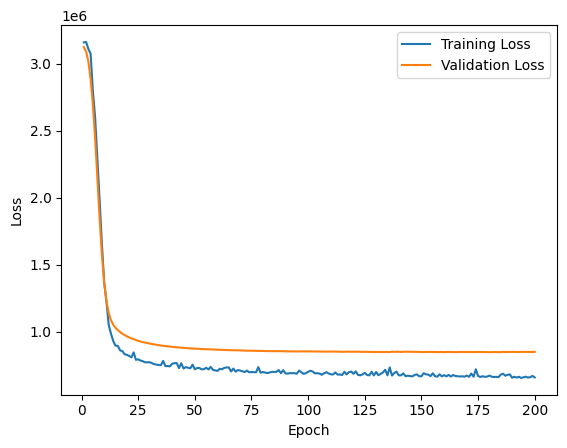

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_sparse1_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### SparsePCA on the Pruned Model, `pruned_sparse2`, with Pruning Amount=0.7

##### no_components = 50

In [ ]:
# create copy of the model
SparsePCA_sparse2 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse2, SparsePCA_sparse2)

In [ ]:
# Apply SparsePCA to fc1 and fc2 of the pruned model
transformed_fc1_weights = apply_sparse_pca(SparsePCA_sparse2.fc1,
                                           n_components=50, alpha=0.5)

# the adjusted model
fc1_out_features = 50
fc2_out_features = 32
SparsePCA_sparse2_50 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_sparse2_50.fc1.weight.data = torch.FloatTensor(transformed_fc1_weights).to(SparsePCA_sparse2.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_sparse2_50.fc1.bias.data.fill_(0)
SparsePCA_sparse2_50.fc2.bias.data.fill_(0)
SparsePCA_sparse2_50.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_sparse2_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3128584.9762, Average MAE: 1498.0347


Epoch [1/200], MSE Loss (Train): 3163470.034, MAE Loss (Train): 1513.520
Validation Loss: 3080372.750, Validation MAE: 1481.412
Epoch [2/200], MSE Loss (Train): 3054948.671, MAE Loss (Train): 1477.166
Validation Loss: 2920467.596, Validation MAE: 1425.910
Epoch [3/200], MSE Loss (Train): 2841950.144, MAE Loss (Train): 1400.712
Validation Loss: 2615831.817, Validation MAE: 1314.594
Epoch [4/200], MSE Loss (Train): 2408808.380, MAE Loss (Train): 1246.682
Validation Loss: 2170454.125, Validation MAE: 1133.964
Epoch [5/200], MSE Loss (Train): 1902409.718, MAE Loss (Train): 1037.247
Validation Loss: 1672877.865, Validation MAE: 909.290
Epoch [6/200], MSE Loss (Train): 1445964.674, MAE Loss (Train): 823.298
Validation Loss: 1249704.764, Validation MAE: 729.926
Epoch [7/200], MSE Loss (Train): 1035291.481, MAE Loss (Train): 669.176
Validation Loss: 1018998.380, Validation MAE: 667.029
Epoch [8/200], MSE Loss (Train): 889100.273, MAE Loss (Train): 639.832
Validation Loss: 930213.582, Validatio

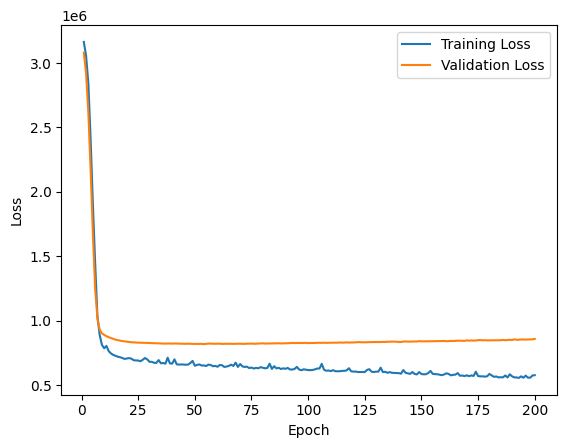

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_sparse2_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
SparsePCA_sparse230 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse2, SparsePCA_sparse230)

# Apply SparsePCA to fc1 and fc2 of the pruned model
transformed_fc1_weights = apply_sparse_pca(SparsePCA_sparse230.fc1,
                                           n_components=30, alpha=0.5)

# the adjusted model
fc1_out_features = 30
fc2_out_features = 32
SparsePCA_sparse2_30 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_sparse2_30.fc1.weight.data = torch.FloatTensor(transformed_fc1_weights).to(SparsePCA_sparse230.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_sparse2_30.fc1.bias.data.fill_(0)
SparsePCA_sparse2_30.fc2.bias.data.fill_(0)
SparsePCA_sparse2_30.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_sparse2_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130937.0098, Average MAE: 1498.9083


Epoch [1/200], MSE Loss (Train): 3218382.918, MAE Loss (Train): 1524.773
Validation Loss: 3111259.731, Validation MAE: 1492.279
Epoch [2/200], MSE Loss (Train): 3110772.582, MAE Loss (Train): 1498.888
Validation Loss: 3030633.558, Validation MAE: 1465.482
Epoch [3/200], MSE Loss (Train): 3027389.159, MAE Loss (Train): 1464.400
Validation Loss: 2854403.731, Validation MAE: 1405.590
Epoch [4/200], MSE Loss (Train): 2756756.647, MAE Loss (Train): 1378.544
Validation Loss: 2558640.808, Validation MAE: 1299.658
Epoch [5/200], MSE Loss (Train): 2397488.026, MAE Loss (Train): 1244.121
Validation Loss: 2160348.625, Validation MAE: 1142.472
Epoch [6/200], MSE Loss (Train): 1944972.875, MAE Loss (Train): 1064.940
Validation Loss: 1721288.260, Validation MAE: 946.786
Epoch [7/200], MSE Loss (Train): 1505332.507, MAE Loss (Train): 865.050
Validation Loss: 1331766.115, Validation MAE: 769.561
Epoch [8/200], MSE Loss (Train): 1146636.422, MAE Loss (Train): 716.740
Validation Loss: 1071199.913, Valid

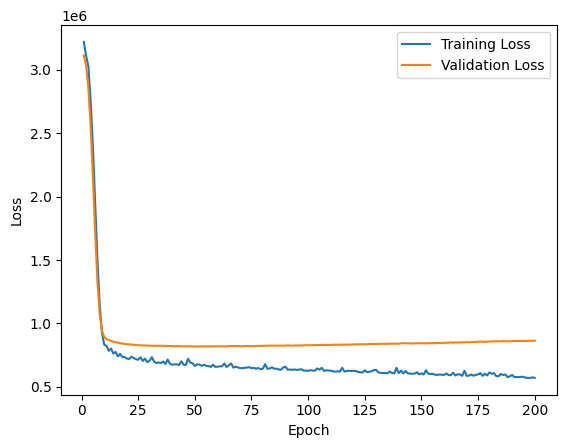

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_sparse2_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
SparsePCA_sparse210 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse2, SparsePCA_sparse210)

# Apply SparsePCA to fc1 and fc2 of the pruned model
transformed_fc1_weights = apply_sparse_pca(SparsePCA_sparse210.fc1,
                                           n_components=10, alpha=0.5)

# the adjusted model
fc1_out_features = 10
fc2_out_features = 32
SparsePCA_sparse2_10 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_sparse2_10.fc1.weight.data = torch.FloatTensor(transformed_fc1_weights).to(SparsePCA_sparse210.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_sparse2_10.fc1.bias.data.fill_(0)
SparsePCA_sparse2_10.fc2.bias.data.fill_(0)
SparsePCA_sparse2_10.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_sparse2_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132061.0416, Average MAE: 1499.2332


Epoch [1/200], MSE Loss (Train): 3167163.072, MAE Loss (Train): 1516.700
Validation Loss: 3123579.846, Validation MAE: 1496.211
Epoch [2/200], MSE Loss (Train): 3148323.923, MAE Loss (Train): 1510.457
Validation Loss: 3092274.173, Validation MAE: 1485.579
Epoch [3/200], MSE Loss (Train): 3284734.918, MAE Loss (Train): 1526.019
Validation Loss: 3028048.058, Validation MAE: 1463.419
Epoch [4/200], MSE Loss (Train): 3007704.084, MAE Loss (Train): 1461.874
Validation Loss: 2919691.538, Validation MAE: 1425.140
Epoch [5/200], MSE Loss (Train): 2865276.558, MAE Loss (Train): 1413.076
Validation Loss: 2750045.029, Validation MAE: 1362.773
Epoch [6/200], MSE Loss (Train): 2692245.036, MAE Loss (Train): 1345.074
Validation Loss: 2504580.106, Validation MAE: 1266.573
Epoch [7/200], MSE Loss (Train): 2341492.660, MAE Loss (Train): 1215.493
Validation Loss: 2212316.798, Validation MAE: 1141.102
Epoch [8/200], MSE Loss (Train): 2091446.644, MAE Loss (Train): 1099.159
Validation Loss: 1916692.577, V

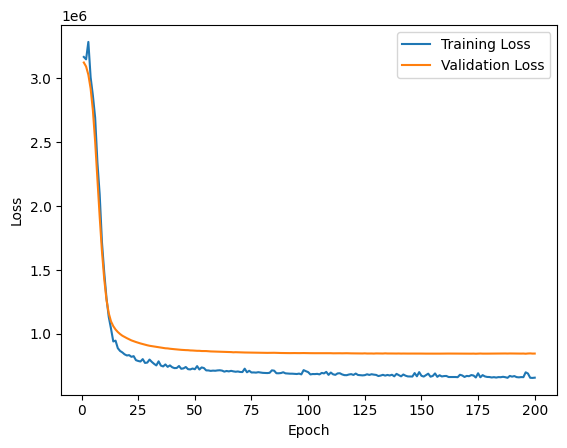

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_sparse2_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### SparsePCA on the Pruned Model, `pruned_sparse3`, with Pruning Amount=0.8

##### no_components = 50

In [ ]:
# create copy of the model
SparsePCA_sparse3 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse3, SparsePCA_sparse3)

In [ ]:
# Apply SparsePCA to fc1 and fc2 of the pruned model
transformed_fc1_weights = apply_sparse_pca(SparsePCA_sparse3.fc1,
                                           n_components=50, alpha=0.5)

# the adjusted model
fc1_out_features = 50
fc2_out_features = 32
SparsePCA_sparse3_50 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_sparse3_50.fc1.weight.data = torch.FloatTensor(transformed_fc1_weights).to(SparsePCA_sparse3.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_sparse3_50.fc1.bias.data.fill_(0)
SparsePCA_sparse3_50.fc2.bias.data.fill_(0)
SparsePCA_sparse3_50.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_sparse3_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132060.6736, Average MAE: 1499.1981


Epoch [1/200], MSE Loss (Train): 3239838.447, MAE Loss (Train): 1529.292
Validation Loss: 3099095.962, Validation MAE: 1487.622
Epoch [2/200], MSE Loss (Train): 3078963.442, MAE Loss (Train): 1485.608
Validation Loss: 2979386.692, Validation MAE: 1445.923
Epoch [3/200], MSE Loss (Train): 2935818.142, MAE Loss (Train): 1435.070
Validation Loss: 2740880.760, Validation MAE: 1359.797
Epoch [4/200], MSE Loss (Train): 2559087.859, MAE Loss (Train): 1302.422
Validation Loss: 2363721.817, Validation MAE: 1212.666
Epoch [5/200], MSE Loss (Train): 2139333.990, MAE Loss (Train): 1134.589
Validation Loss: 1898920.760, Validation MAE: 1008.888
Epoch [6/200], MSE Loss (Train): 1650747.543, MAE Loss (Train): 918.997
Validation Loss: 1450215.909, Validation MAE: 809.140
Epoch [7/200], MSE Loss (Train): 1246996.458, MAE Loss (Train): 747.342
Validation Loss: 1138815.082, Validation MAE: 696.891
Epoch [8/200], MSE Loss (Train): 965820.502, MAE Loss (Train): 655.710
Validation Loss: 985435.957, Validati

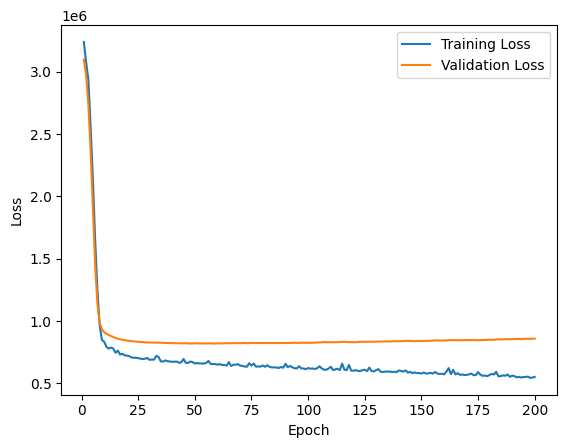

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_sparse3_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
SparsePCA_sparse330 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse3, SparsePCA_sparse330)

# Apply SparsePCA to fc1 and fc2 of the pruned model
transformed_fc1_weights = apply_sparse_pca(SparsePCA_sparse330.fc1,
                                           n_components=30, alpha=0.5)

# the adjusted model
fc1_out_features = 30
fc2_out_features = 32
SparsePCA_sparse3_30 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_sparse3_30.fc1.weight.data = torch.FloatTensor(transformed_fc1_weights).to(SparsePCA_sparse330.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_sparse3_30.fc1.bias.data.fill_(0)
SparsePCA_sparse3_30.fc2.bias.data.fill_(0)
SparsePCA_sparse3_30.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_sparse3_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3134217.3160, Average MAE: 1499.9340


Epoch [1/200], MSE Loss (Train): 3145767.608, MAE Loss (Train): 1508.065
Validation Loss: 3115430.288, Validation MAE: 1493.451
Epoch [2/200], MSE Loss (Train): 3131925.938, MAE Loss (Train): 1500.483
Validation Loss: 3046410.346, Validation MAE: 1470.104
Epoch [3/200], MSE Loss (Train): 2999080.803, MAE Loss (Train): 1459.381
Validation Loss: 2906014.500, Validation MAE: 1421.910
Epoch [4/200], MSE Loss (Train): 2830671.310, MAE Loss (Train): 1401.307
Validation Loss: 2664959.154, Validation MAE: 1335.595
Epoch [5/200], MSE Loss (Train): 2515434.055, MAE Loss (Train): 1286.817
Validation Loss: 2312403.856, Validation MAE: 1199.227
Epoch [6/200], MSE Loss (Train): 2134263.161, MAE Loss (Train): 1131.029
Validation Loss: 1887943.615, Validation MAE: 1015.711
Epoch [7/200], MSE Loss (Train): 1695366.817, MAE Loss (Train): 935.508
Validation Loss: 1472880.817, Validation MAE: 828.356
Epoch [8/200], MSE Loss (Train): 1266432.454, MAE Loss (Train): 756.759
Validation Loss: 1164297.519, Vali

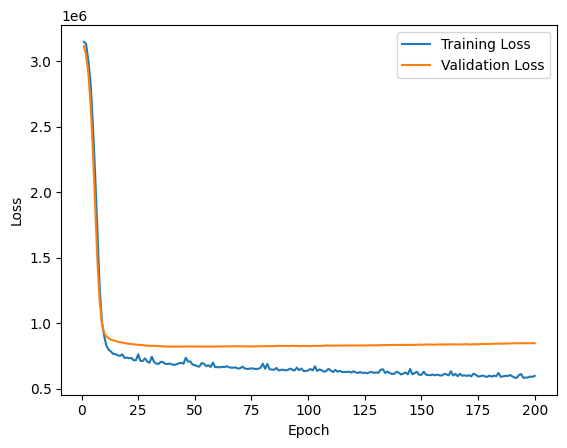

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_sparse3_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
SparsePCA_sparse310 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse3, SparsePCA_sparse310)

# Apply SparsePCA to fc1 and fc2 of the pruned model
transformed_fc1_weights = apply_sparse_pca(SparsePCA_sparse310.fc1,
                                           n_components=10, alpha=0.5)

# the adjusted model
fc1_out_features = 10
fc2_out_features = 32
SparsePCA_sparse3_10 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_sparse3_10.fc1.weight.data = torch.FloatTensor(transformed_fc1_weights).to(SparsePCA_sparse310.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_sparse3_10.fc1.bias.data.fill_(0)
SparsePCA_sparse3_10.fc2.bias.data.fill_(0)
SparsePCA_sparse3_10.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_sparse3_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132378.4584, Average MAE: 1499.2273


Epoch [1/200], MSE Loss (Train): 3156185.887, MAE Loss (Train): 1511.821
Validation Loss: 3125249.885, Validation MAE: 1496.768
Epoch [2/200], MSE Loss (Train): 3154457.788, MAE Loss (Train): 1512.538
Validation Loss: 3090540.404, Validation MAE: 1485.385
Epoch [3/200], MSE Loss (Train): 3061591.458, MAE Loss (Train): 1480.876
Validation Loss: 3003659.327, Validation MAE: 1456.614
Epoch [4/200], MSE Loss (Train): 2950392.596, MAE Loss (Train): 1445.458
Validation Loss: 2847164.894, Validation MAE: 1403.371
Epoch [5/200], MSE Loss (Train): 2767642.036, MAE Loss (Train): 1383.569
Validation Loss: 2622885.163, Validation MAE: 1323.638
Epoch [6/200], MSE Loss (Train): 2495357.120, MAE Loss (Train): 1285.470
Validation Loss: 2338813.798, Validation MAE: 1214.837
Epoch [7/200], MSE Loss (Train): 2194248.805, MAE Loss (Train): 1163.276
Validation Loss: 2007091.519, Validation MAE: 1075.912
Epoch [8/200], MSE Loss (Train): 1827906.238, MAE Loss (Train): 1005.914
Validation Loss: 1671456.048, V

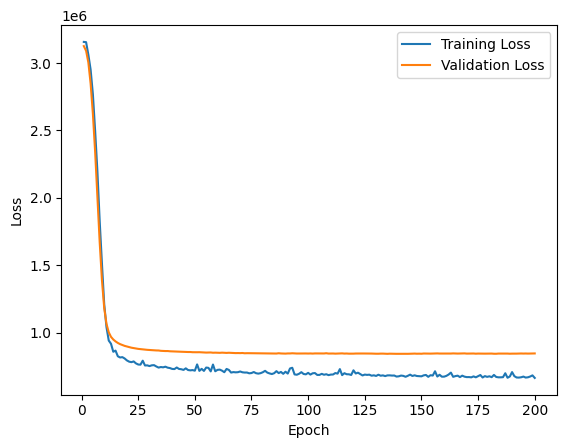

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_sparse3_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### SparsePCA on the Pruned Model, `pruned_sparse4`, with Pruning Amount=0.9

##### no_components = 50

In [ ]:
# create copy of the model
SparsePCA_sparse4 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse4, SparsePCA_sparse4)

In [ ]:
# Apply SparsePCA to fc1 and fc2 of the pruned model
transformed_fc1_weights = apply_sparse_pca(SparsePCA_sparse4.fc1,
                                           n_components=50, alpha=0.5)

# the adjusted model
fc1_out_features = 50
fc2_out_features = 32
SparsePCA_sparse4_50 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_sparse4_50.fc1.weight.data = torch.FloatTensor(transformed_fc1_weights).to(SparsePCA_sparse4.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_sparse4_50.fc1.bias.data.fill_(0)
SparsePCA_sparse4_50.fc2.bias.data.fill_(0)
SparsePCA_sparse4_50.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_sparse4_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130919.5306, Average MAE: 1498.8141


Epoch [1/200], MSE Loss (Train): 3153984.894, MAE Loss (Train): 1510.853
Validation Loss: 3099775.346, Validation MAE: 1488.176
Epoch [2/200], MSE Loss (Train): 3085855.075, MAE Loss (Train): 1488.660
Validation Loss: 2996816.192, Validation MAE: 1453.243
Epoch [3/200], MSE Loss (Train): 3005988.517, MAE Loss (Train): 1452.168
Validation Loss: 2788273.163, Validation MAE: 1380.468
Epoch [4/200], MSE Loss (Train): 2708973.538, MAE Loss (Train): 1353.503
Validation Loss: 2458878.913, Validation MAE: 1258.114
Epoch [5/200], MSE Loss (Train): 2273661.214, MAE Loss (Train): 1197.284
Validation Loss: 2035044.375, Validation MAE: 1082.398
Epoch [6/200], MSE Loss (Train): 1788671.645, MAE Loss (Train): 995.661
Validation Loss: 1590447.519, Validation MAE: 879.366
Epoch [7/200], MSE Loss (Train): 1355195.032, MAE Loss (Train): 795.241
Validation Loss: 1230227.971, Validation MAE: 723.376
Epoch [8/200], MSE Loss (Train): 1050080.888, MAE Loss (Train): 674.663
Validation Loss: 1014248.587, Valida

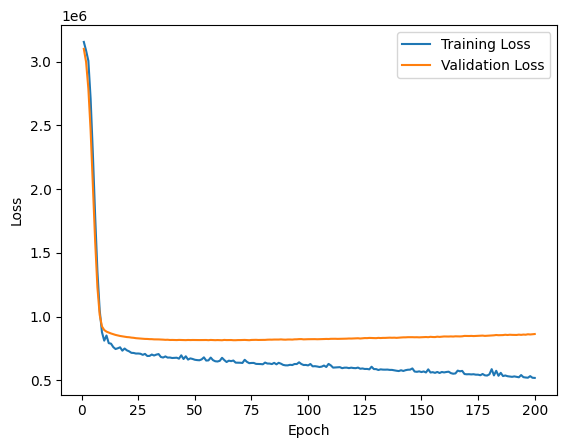

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_sparse4_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
SparsePCA_sparse430 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse4, SparsePCA_sparse430)

# Apply SparsePCA to fc1 and fc2 of the pruned model
transformed_fc1_weights = apply_sparse_pca(SparsePCA_sparse430.fc1,
                                           n_components=30, alpha=0.5)

# the adjusted model
fc1_out_features = 30
fc2_out_features = 32
SparsePCA_sparse4_30 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_sparse4_30.fc1.weight.data = torch.FloatTensor(transformed_fc1_weights).to(SparsePCA_sparse430.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_sparse4_30.fc1.bias.data.fill_(0)
SparsePCA_sparse4_30.fc2.bias.data.fill_(0)
SparsePCA_sparse4_30.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_sparse4_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3134084.2806, Average MAE: 1499.9227


Epoch [1/200], MSE Loss (Train): 3163173.096, MAE Loss (Train): 1514.303
Validation Loss: 3117726.519, Validation MAE: 1494.345
Epoch [2/200], MSE Loss (Train): 3166387.594, MAE Loss (Train): 1510.539
Validation Loss: 3052847.385, Validation MAE: 1472.516
Epoch [3/200], MSE Loss (Train): 3031441.606, MAE Loss (Train): 1471.019
Validation Loss: 2916222.288, Validation MAE: 1425.656
Epoch [4/200], MSE Loss (Train): 2856798.812, MAE Loss (Train): 1410.426
Validation Loss: 2691550.673, Validation MAE: 1345.632
Epoch [5/200], MSE Loss (Train): 2545742.910, MAE Loss (Train): 1301.617
Validation Loss: 2371209.577, Validation MAE: 1223.270
Epoch [6/200], MSE Loss (Train): 2190099.062, MAE Loss (Train): 1163.844
Validation Loss: 1977725.442, Validation MAE: 1056.199
Epoch [7/200], MSE Loss (Train): 1771728.744, MAE Loss (Train): 975.980
Validation Loss: 1568880.548, Validation MAE: 871.119
Epoch [8/200], MSE Loss (Train): 1417687.262, MAE Loss (Train): 812.507
Validation Loss: 1233322.000, Vali

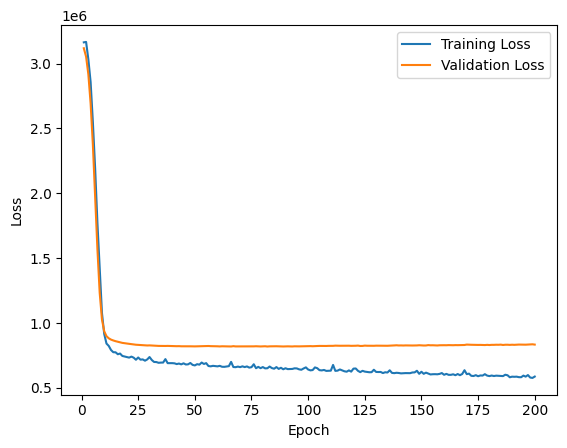

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_sparse4_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
SparsePCA_sparse410 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse4, SparsePCA_sparse410)

# Apply SparsePCA to fc1 and fc2 of the pruned model
transformed_fc1_weights = apply_sparse_pca(SparsePCA_sparse410.fc1,
                                           n_components=10, alpha=0.5)

# the adjusted model
fc1_out_features = 10
fc2_out_features = 32
SparsePCA_sparse4_10 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_sparse4_10.fc1.weight.data = torch.FloatTensor(transformed_fc1_weights).to(SparsePCA_sparse410.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_sparse4_10.fc1.bias.data.fill_(0)
SparsePCA_sparse4_10.fc2.bias.data.fill_(0)
SparsePCA_sparse4_10.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_sparse4_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3129746.6809, Average MAE: 1498.4769


Epoch [1/200], MSE Loss (Train): 3213372.976, MAE Loss (Train): 1525.886
Validation Loss: 3116367.981, Validation MAE: 1493.720
Epoch [2/200], MSE Loss (Train): 3116270.596, MAE Loss (Train): 1498.762
Validation Loss: 3072012.327, Validation MAE: 1478.404
Epoch [3/200], MSE Loss (Train): 3043637.001, MAE Loss (Train): 1475.044
Validation Loss: 2982961.346, Validation MAE: 1447.135
Epoch [4/200], MSE Loss (Train): 2931980.224, MAE Loss (Train): 1436.845
Validation Loss: 2837825.000, Validation MAE: 1394.726
Epoch [5/200], MSE Loss (Train): 2862389.950, MAE Loss (Train): 1397.094
Validation Loss: 2622752.760, Validation MAE: 1313.062
Epoch [6/200], MSE Loss (Train): 2525507.733, MAE Loss (Train): 1281.071
Validation Loss: 2340510.856, Validation MAE: 1196.914
Epoch [7/200], MSE Loss (Train): 2224115.767, MAE Loss (Train): 1156.218
Validation Loss: 2029144.106, Validation MAE: 1058.100
Epoch [8/200], MSE Loss (Train): 1834943.005, MAE Loss (Train): 996.347
Validation Loss: 1723273.798, Va

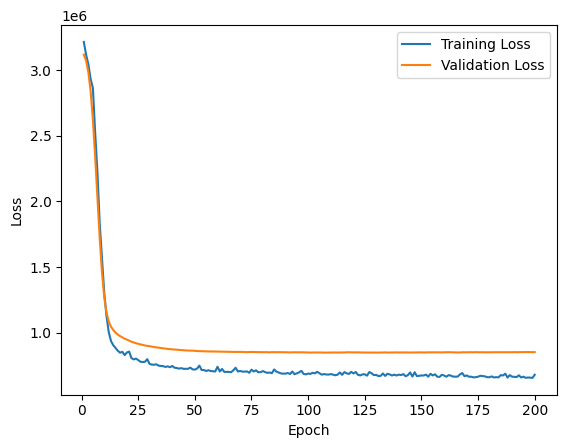

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_sparse4_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### SparsePCA on the Pruned Model, `pruned_sparse5`, with Pruning Amount=0.95

##### no_components = 50

In [ ]:
# create copy of the model
SparsePCA_sparse5 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse5, SparsePCA_sparse5)

In [ ]:
# Apply SparsePCA to fc1 and fc2 of the pruned model
transformed_fc1_weights = apply_sparse_pca(SparsePCA_sparse5.fc1,
                                           n_components=50, alpha=0.5)

# the adjusted model
fc1_out_features = 50
fc2_out_features = 32
SparsePCA_sparse5_50 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_sparse5_50.fc1.weight.data = torch.FloatTensor(transformed_fc1_weights).to(SparsePCA_sparse5.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_sparse5_50.fc1.bias.data.fill_(0)
SparsePCA_sparse5_50.fc2.bias.data.fill_(0)
SparsePCA_sparse5_50.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_sparse5_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3135155.0837, Average MAE: 1500.2966


Epoch [1/200], MSE Loss (Train): 3190690.644, MAE Loss (Train): 1518.491
Validation Loss: 3108694.077, Validation MAE: 1491.037
Epoch [2/200], MSE Loss (Train): 3092308.800, MAE Loss (Train): 1490.465
Validation Loss: 3008706.596, Validation MAE: 1456.558
Epoch [3/200], MSE Loss (Train): 3009192.430, MAE Loss (Train): 1456.829
Validation Loss: 2799446.231, Validation MAE: 1382.256
Epoch [4/200], MSE Loss (Train): 2692582.310, MAE Loss (Train): 1349.007
Validation Loss: 2465221.788, Validation MAE: 1255.569
Epoch [5/200], MSE Loss (Train): 2289303.346, MAE Loss (Train): 1191.931
Validation Loss: 2035021.981, Validation MAE: 1073.382
Epoch [6/200], MSE Loss (Train): 1786011.966, MAE Loss (Train): 980.813
Validation Loss: 1585254.601, Validation MAE: 869.743
Epoch [7/200], MSE Loss (Train): 1357705.562, MAE Loss (Train): 793.169
Validation Loss: 1227513.091, Validation MAE: 722.494
Epoch [8/200], MSE Loss (Train): 1069328.975, MAE Loss (Train): 680.491
Validation Loss: 1021643.216, Valida

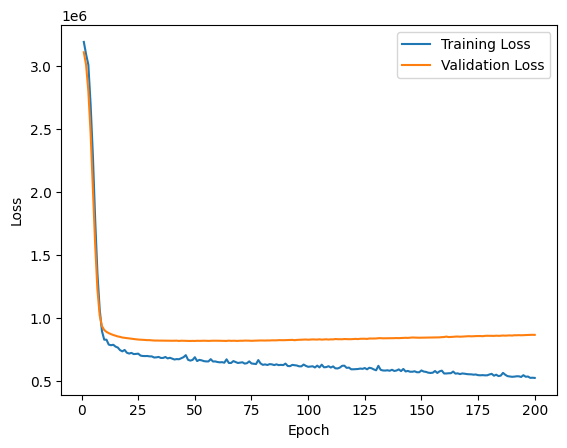

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_sparse5_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
SparsePCA_sparse530 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse5, SparsePCA_sparse530)

# Apply SparsePCA to fc1 and fc2 of the pruned model
transformed_fc1_weights = apply_sparse_pca(SparsePCA_sparse530.fc1,
                                           n_components=30, alpha=0.5)

# the adjusted model
fc1_out_features = 30
fc2_out_features = 32
SparsePCA_sparse5_30 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_sparse5_30.fc1.weight.data = torch.FloatTensor(transformed_fc1_weights).to(SparsePCA_sparse530.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_sparse5_30.fc1.bias.data.fill_(0)
SparsePCA_sparse5_30.fc2.bias.data.fill_(0)
SparsePCA_sparse5_30.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_sparse5_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131550.9982, Average MAE: 1499.1917


Epoch [1/200], MSE Loss (Train): 3179163.969, MAE Loss (Train): 1519.962
Validation Loss: 3105289.885, Validation MAE: 1490.313
Epoch [2/200], MSE Loss (Train): 3247650.317, MAE Loss (Train): 1520.749
Validation Loss: 3017643.635, Validation MAE: 1460.876
Epoch [3/200], MSE Loss (Train): 3003295.582, MAE Loss (Train): 1459.303
Validation Loss: 2846761.500, Validation MAE: 1402.173
Epoch [4/200], MSE Loss (Train): 2759662.490, MAE Loss (Train): 1376.091
Validation Loss: 2579374.721, Validation MAE: 1305.746
Epoch [5/200], MSE Loss (Train): 2437552.995, MAE Loss (Train): 1257.912
Validation Loss: 2222373.173, Validation MAE: 1164.876
Epoch [6/200], MSE Loss (Train): 2069678.562, MAE Loss (Train): 1102.724
Validation Loss: 1809950.423, Validation MAE: 983.894
Epoch [7/200], MSE Loss (Train): 1595873.375, MAE Loss (Train): 901.870
Validation Loss: 1425360.673, Validation MAE: 807.057
Epoch [8/200], MSE Loss (Train): 1268027.196, MAE Loss (Train): 760.345
Validation Loss: 1143045.144, Valid

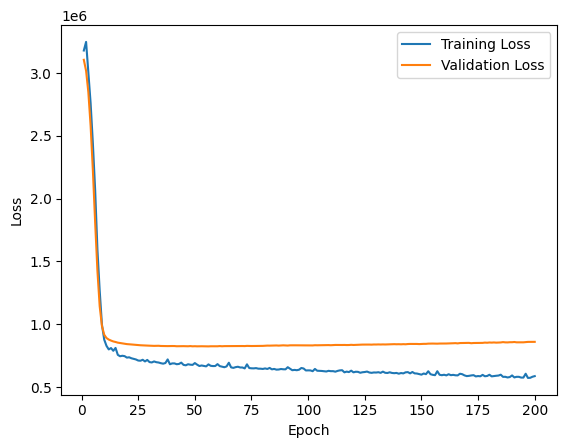

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_sparse5_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
SparsePCA_sparse510 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse5, SparsePCA_sparse510)

# Apply SparsePCA to fc1 and fc2 of the pruned model
transformed_fc1_weights = apply_sparse_pca(SparsePCA_sparse510.fc1,
                                           n_components=10, alpha=0.5)

# the adjusted model
fc1_out_features = 10
fc2_out_features = 32
SparsePCA_sparse5_10 = CompressedRegressionNN(input_size, fc1_out_features,
                                          fc2_out_features, output_size)

# Update the adjusted model with SparsePCA transformed weights
SparsePCA_sparse5_10.fc1.weight.data = torch.FloatTensor(transformed_fc1_weights).to(SparsePCA_sparse510.fc1.weight.device)

# Reset biases to zero because they are not specifically adjusted post-PCA
SparsePCA_sparse5_10.fc1.bias.data.fill_(0)
SparsePCA_sparse5_10.fc2.bias.data.fill_(0)
SparsePCA_sparse5_10.fc3.bias.data.fill_(0)

# testing without training
average_loss, average_mae = evaluate_model(SparsePCA_sparse5_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3129602.7341, Average MAE: 1498.3131


Epoch [1/200], MSE Loss (Train): 3154634.096, MAE Loss (Train): 1511.340
Validation Loss: 3119141.808, Validation MAE: 1494.564
Epoch [2/200], MSE Loss (Train): 3161661.543, MAE Loss (Train): 1508.220
Validation Loss: 3081837.962, Validation MAE: 1481.914
Epoch [3/200], MSE Loss (Train): 3062539.752, MAE Loss (Train): 1481.187
Validation Loss: 3005706.519, Validation MAE: 1456.010
Epoch [4/200], MSE Loss (Train): 3056685.546, MAE Loss (Train): 1470.012
Validation Loss: 2876578.135, Validation MAE: 1411.296
Epoch [5/200], MSE Loss (Train): 2803882.731, MAE Loss (Train): 1394.521
Validation Loss: 2679921.135, Validation MAE: 1340.520
Epoch [6/200], MSE Loss (Train): 2595148.418, MAE Loss (Train): 1316.829
Validation Loss: 2415231.846, Validation MAE: 1238.935
Epoch [7/200], MSE Loss (Train): 2274668.038, MAE Loss (Train): 1191.361
Validation Loss: 2103770.471, Validation MAE: 1108.603
Epoch [8/200], MSE Loss (Train): 1945833.654, MAE Loss (Train): 1054.114
Validation Loss: 1781997.394, V

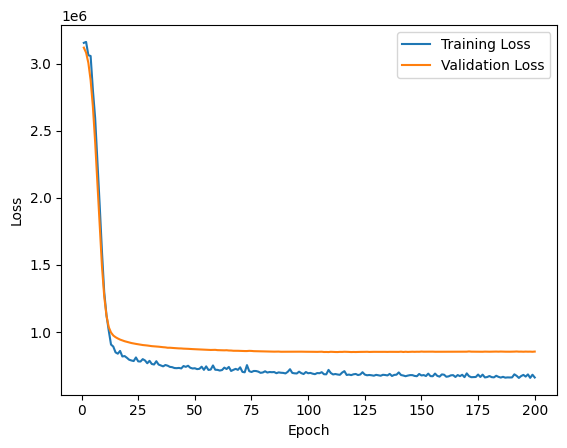

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=SparsePCA_sparse5_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

## Independent Component Analysis (ICA) for a Pruned Model

ICA can be applied to pruned model weights in a similar manner to PCA. The flattened weights from each linear layer are stacked into a matrix and ICA is applied on it to obtain the transformed weights in ica_result.

Reference:
https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.FastICA.html#sklearn.decomposition.FastICA

In [ ]:
# defining a function to apply ICA on the pruned model
def apply_ica_to_layer(layer, n_components):
    # interested in reducing the dimensionality of in_features
    # Transpose to focus on in_features
    weights = layer.weight.data.cpu().numpy().T
    # reference: https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.FastICA.html#sklearn.decomposition.FastICA
    ica = FastICA(n_components=n_components, random_state=0)
    transformed_weights = ica.fit_transform(weights)
    # Transpose back to match original shape orientation
    return transformed_weights.T

In [ ]:
# Define a new adjusted model with dimensions matching the ICA output
class AdjustedModel(RegressionNN):
    def __init__(self):
        super().__init__(input_size=58,
                         hidden_size1=n_components_fc1,
                         hidden_size2=32,
                         output_size=1)

### ICA on Locally Pruned Model

#### ICA on the Pruned Model, `pruned_local1`, with Pruning Amount=0.6

###### no_components = 50

In [ ]:
# create copy of the model
ICA_pruned_local1= RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local1, ICA_pruned_local1)

In [ ]:
# Apply ICA to the first layer as an example
n_components_fc1 = 50  # New dimension for fc1
ical150_transformed_fc1_weights = apply_ica_to_layer(ICA_pruned_local1.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_l1_50 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_l1_50.fc1.weight.data = torch.from_numpy(ical150_transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_l1_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Average Loss: 3130561.7237, Average MAE: 1498.7118


Epoch [1/200], MSE Loss (Train): 3157416.678, MAE Loss (Train): 1512.174
Validation Loss: 3116519.462, Validation MAE: 1494.041
Epoch [2/200], MSE Loss (Train): 3166967.856, MAE Loss (Train): 1512.358
Validation Loss: 3039698.192, Validation MAE: 1469.035
Epoch [3/200], MSE Loss (Train): 3000243.796, MAE Loss (Train): 1460.157
Validation Loss: 2831754.250, Validation MAE: 1399.946
Epoch [4/200], MSE Loss (Train): 2694153.161, MAE Loss (Train): 1356.542
Validation Loss: 2437973.356, Validation MAE: 1258.415
Epoch [5/200], MSE Loss (Train): 2198109.938, MAE Loss (Train): 1164.619
Validation Loss: 1916014.817, Validation MAE: 1039.249
Epoch [6/200], MSE Loss (Train): 1684640.538, MAE Loss (Train): 946.751
Validation Loss: 1434816.082, Validation MAE: 827.300
Epoch [7/200], MSE Loss (Train): 1384702.407, MAE Loss (Train): 817.987
Validation Loss: 1161224.101, Validation MAE: 729.644
Epoch [8/200], MSE Loss (Train): 1106514.251, MAE Loss (Train): 735.232
Validation Loss: 1049068.611, Valida

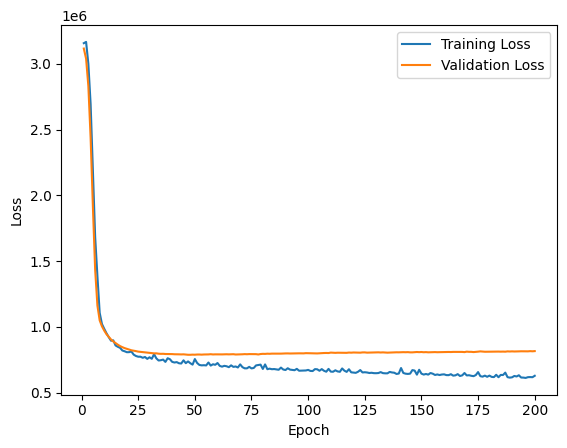

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_l1_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
ICA_pruned_local130= RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local1, ICA_pruned_local130)


# Apply ICA to the first layer as an example
n_components_fc1 = 30  # New dimension for fc1
ical130_transofrmed_fc1_weights = apply_ica_to_layer(ICA_pruned_local130.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_l1_30 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_l1_30.fc1.weight.data = torch.from_numpy(ical130_transofrmed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_l1_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131482.4193, Average MAE: 1499.0176


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3149576.175, MAE Loss (Train): 1510.462
Validation Loss: 3125425.788, Validation MAE: 1496.850
Epoch [2/200], MSE Loss (Train): 3183219.620, MAE Loss (Train): 1517.199
Validation Loss: 3088704.577, Validation MAE: 1484.915
Epoch [3/200], MSE Loss (Train): 3084582.192, MAE Loss (Train): 1489.165
Validation Loss: 2988080.846, Validation MAE: 1452.349
Epoch [4/200], MSE Loss (Train): 2915422.978, MAE Loss (Train): 1434.930
Validation Loss: 2778633.808, Validation MAE: 1382.597
Epoch [5/200], MSE Loss (Train): 2699955.577, MAE Loss (Train): 1351.389
Validation Loss: 2443713.269, Validation MAE: 1262.089
Epoch [6/200], MSE Loss (Train): 2266767.764, MAE Loss (Train): 1193.799
Validation Loss: 2019438.298, Validation MAE: 1089.301
Epoch [7/200], MSE Loss (Train): 1805719.391, MAE Loss (Train): 1005.080
Validation Loss: 1609232.514, Validation MAE: 907.386
Epoch [8/200], MSE Loss (Train): 1488978.528, MAE Loss (Train): 873.102
Validation Loss: 1305929.562, Val

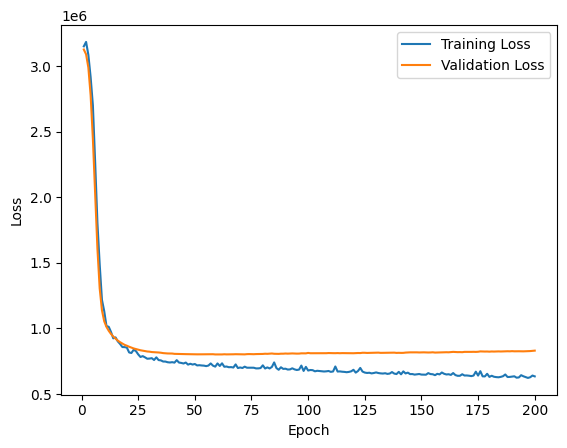

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_l1_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
ICA_pruned_local110= RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local1, ICA_pruned_local110)

# Apply ICA to the first layer as an example
n_components_fc1 = 10  # New dimension for fc1
ical110_transformed_fc1_weights = apply_ica_to_layer(ICA_pruned_local110.fc1,
                                                     n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_l1_10 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_l1_10.fc1.weight.data = torch.from_numpy(ical110_transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_l1_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132400.6577, Average MAE: 1499.3552


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3178382.346, MAE Loss (Train): 1517.035
Validation Loss: 3135702.385, Validation MAE: 1500.325
Epoch [2/200], MSE Loss (Train): 3248189.053, MAE Loss (Train): 1533.067
Validation Loss: 3128334.346, Validation MAE: 1497.986
Epoch [3/200], MSE Loss (Train): 3153168.995, MAE Loss (Train): 1511.754
Validation Loss: 3109438.942, Validation MAE: 1491.996
Epoch [4/200], MSE Loss (Train): 3111621.993, MAE Loss (Train): 1499.025
Validation Loss: 3063816.904, Validation MAE: 1477.401
Epoch [5/200], MSE Loss (Train): 3046495.269, MAE Loss (Train): 1478.719
Validation Loss: 2972081.846, Validation MAE: 1447.558
Epoch [6/200], MSE Loss (Train): 2958150.990, MAE Loss (Train): 1445.603
Validation Loss: 2820224.913, Validation MAE: 1396.392
Epoch [7/200], MSE Loss (Train): 2760981.154, MAE Loss (Train): 1376.432
Validation Loss: 2597324.971, Validation MAE: 1316.894
Epoch [8/200], MSE Loss (Train): 2506599.430, MAE Loss (Train): 1275.519
Validation Loss: 2319534.096, V

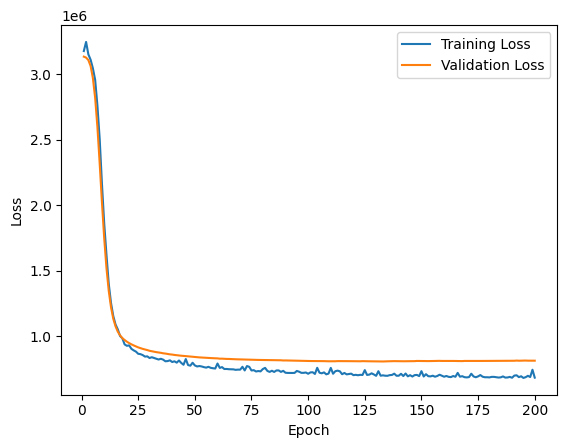

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_l1_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### ICA on the Pruned Model, `pruned_local2`, with Pruning Amount=0.7

###### no_components = 50

In [ ]:
# create copy of the model
ICA_pruned_local2 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local2, ICA_pruned_local2)

In [ ]:
# Apply ICA to the first layer as an example
n_components_fc1 = 50  # New dimension for fc1
ical250_transofrmed_fc1_weights = apply_ica_to_layer(ICA_pruned_local2.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_l2_50 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_l2_50.fc1.weight.data = torch.from_numpy(ical250_transofrmed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_l2_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131592.2696, Average MAE: 1499.0858


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3147189.168, MAE Loss (Train): 1509.245
Validation Loss: 3117197.635, Validation MAE: 1494.438
Epoch [2/200], MSE Loss (Train): 3155322.375, MAE Loss (Train): 1509.007
Validation Loss: 3046191.115, Validation MAE: 1471.888
Epoch [3/200], MSE Loss (Train): 2986571.120, MAE Loss (Train): 1456.456
Validation Loss: 2857971.212, Validation MAE: 1410.670
Epoch [4/200], MSE Loss (Train): 2718065.685, MAE Loss (Train): 1368.257
Validation Loss: 2497250.231, Validation MAE: 1284.192
Epoch [5/200], MSE Loss (Train): 2286652.332, MAE Loss (Train): 1200.562
Validation Loss: 2002873.452, Validation MAE: 1085.279
Epoch [6/200], MSE Loss (Train): 1779115.778, MAE Loss (Train): 994.780
Validation Loss: 1529136.178, Validation MAE: 874.858
Epoch [7/200], MSE Loss (Train): 1395337.552, MAE Loss (Train): 833.250
Validation Loss: 1223516.173, Validation MAE: 754.262
Epoch [8/200], MSE Loss (Train): 1157340.271, MAE Loss (Train): 749.857
Validation Loss: 1078043.183, Valida

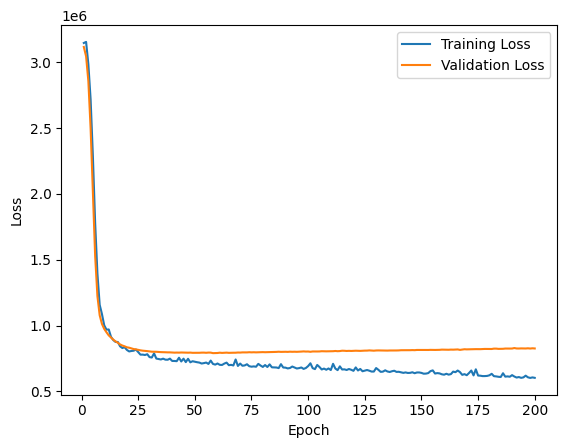

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_l2_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
ICA_pruned_local230 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local2, ICA_pruned_local230)

# Apply ICA to the first layer as an example
n_components_fc1 = 30  # New dimension for fc1
ical230_transformed_fc1_weights = apply_ica_to_layer(ICA_pruned_local230.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_l2_30 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_l2_30.fc1.weight.data = torch.from_numpy(ical230_transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_l2_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131683.6009, Average MAE: 1499.0953


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3187962.442, MAE Loss (Train): 1516.355
Validation Loss: 3127291.077, Validation MAE: 1497.618
Epoch [2/200], MSE Loss (Train): 3229697.620, MAE Loss (Train): 1525.050
Validation Loss: 3088814.135, Validation MAE: 1485.440
Epoch [3/200], MSE Loss (Train): 3106885.909, MAE Loss (Train): 1491.109
Validation Loss: 2975937.865, Validation MAE: 1449.559
Epoch [4/200], MSE Loss (Train): 2906476.796, MAE Loss (Train): 1430.473
Validation Loss: 2724572.327, Validation MAE: 1366.222
Epoch [5/200], MSE Loss (Train): 2545294.155, MAE Loss (Train): 1306.884
Validation Loss: 2318858.490, Validation MAE: 1217.641
Epoch [6/200], MSE Loss (Train): 2084970.792, MAE Loss (Train): 1128.775
Validation Loss: 1842752.154, Validation MAE: 1020.860
Epoch [7/200], MSE Loss (Train): 1690235.613, MAE Loss (Train): 962.732
Validation Loss: 1453678.476, Validation MAE: 854.307
Epoch [8/200], MSE Loss (Train): 1331569.195, MAE Loss (Train): 821.257
Validation Loss: 1206738.053, Vali

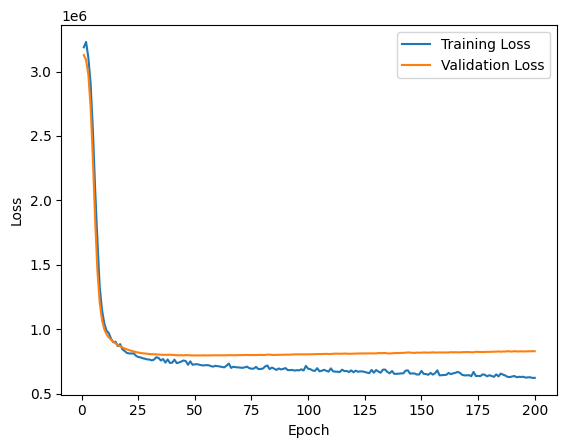

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_l2_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
ICA_local_210 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local2, ICA_local_210)

# Apply ICA to the first layer as an example
n_components_fc1 = 10  # New dimension for fc1
ical210_transformed_fc1_weights = apply_ica_to_layer(ICA_local_210.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_l2_10 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_l2_10.fc1.weight.data = torch.from_numpy(ical210_transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_l2_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130753.3851, Average MAE: 1498.7659


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3156505.755, MAE Loss (Train): 1512.767
Validation Loss: 3131333.500, Validation MAE: 1498.811
Epoch [2/200], MSE Loss (Train): 3143301.594, MAE Loss (Train): 1508.565
Validation Loss: 3116428.250, Validation MAE: 1493.982
Epoch [3/200], MSE Loss (Train): 3183980.925, MAE Loss (Train): 1515.517
Validation Loss: 3078517.923, Validation MAE: 1481.910
Epoch [4/200], MSE Loss (Train): 3085289.469, MAE Loss (Train): 1491.105
Validation Loss: 2999625.942, Validation MAE: 1456.666
Epoch [5/200], MSE Loss (Train): 2982367.921, MAE Loss (Train): 1453.105
Validation Loss: 2865908.385, Validation MAE: 1412.746
Epoch [6/200], MSE Loss (Train): 2773541.008, MAE Loss (Train): 1385.761
Validation Loss: 2675954.865, Validation MAE: 1346.861
Epoch [7/200], MSE Loss (Train): 2561524.337, MAE Loss (Train): 1310.905
Validation Loss: 2441248.087, Validation MAE: 1259.909
Epoch [8/200], MSE Loss (Train): 2295529.026, MAE Loss (Train): 1207.174
Validation Loss: 2185635.942, V

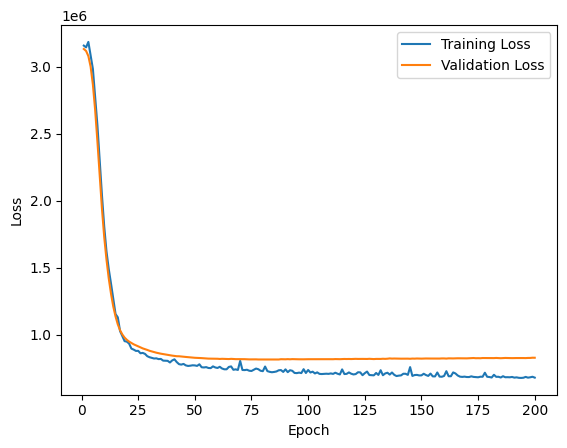

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_l2_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### ICA on the Pruned Model, `pruned_local3`, with Pruning Amount=0.8

###### no_components = 50

In [ ]:
# create copy of the model
ICA_pruned_local_08 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local3, ICA_pruned_local_08)

In [ ]:
# Apply ICA to the first layer as an example
n_components_fc1 = 50  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_pruned_local_08.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_l3_50 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_l3_50.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_l3_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3129471.5128, Average MAE: 1498.3846


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3216245.332, MAE Loss (Train): 1520.483
Validation Loss: 3112249.577, Validation MAE: 1492.783
Epoch [2/200], MSE Loss (Train): 3112351.327, MAE Loss (Train): 1497.045
Validation Loss: 3033490.750, Validation MAE: 1467.341
Epoch [3/200], MSE Loss (Train): 3013953.062, MAE Loss (Train): 1463.232
Validation Loss: 2824911.481, Validation MAE: 1398.253
Epoch [4/200], MSE Loss (Train): 2698076.904, MAE Loss (Train): 1354.365
Validation Loss: 2435370.000, Validation MAE: 1258.322
Epoch [5/200], MSE Loss (Train): 2203528.252, MAE Loss (Train): 1167.549
Validation Loss: 1912775.096, Validation MAE: 1042.197
Epoch [6/200], MSE Loss (Train): 1701888.325, MAE Loss (Train): 951.681
Validation Loss: 1433744.096, Validation MAE: 828.678
Epoch [7/200], MSE Loss (Train): 1283685.041, MAE Loss (Train): 788.062
Validation Loss: 1151275.577, Validation MAE: 724.297
Epoch [8/200], MSE Loss (Train): 1089243.677, MAE Loss (Train): 722.520
Validation Loss: 1036103.279, Valida

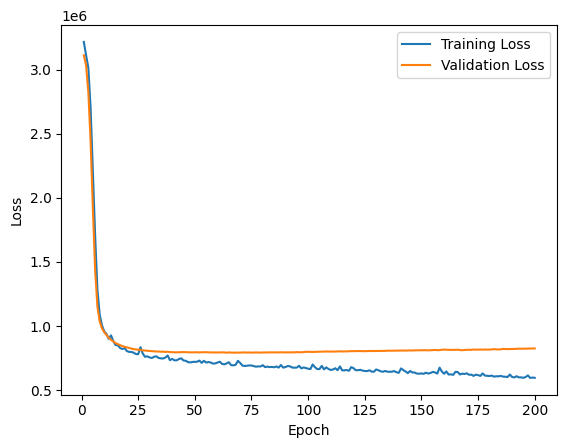

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_l3_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
ICA_local330 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local3, ICA_local330)

# Apply ICA to the first layer as an example
n_components_fc1 = 30  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_local330.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_l3_30 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_l3_30.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_l3_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130884.9358, Average MAE: 1498.8128


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3172362.476, MAE Loss (Train): 1518.443
Validation Loss: 3127763.231, Validation MAE: 1497.742
Epoch [2/200], MSE Loss (Train): 3196690.721, MAE Loss (Train): 1517.760
Validation Loss: 3094076.288, Validation MAE: 1487.041
Epoch [3/200], MSE Loss (Train): 3065716.673, MAE Loss (Train): 1483.477
Validation Loss: 3000156.981, Validation MAE: 1457.076
Epoch [4/200], MSE Loss (Train): 3015103.959, MAE Loss (Train): 1457.639
Validation Loss: 2803508.471, Validation MAE: 1392.220
Epoch [5/200], MSE Loss (Train): 2690703.966, MAE Loss (Train): 1355.888
Validation Loss: 2481238.010, Validation MAE: 1277.459
Epoch [6/200], MSE Loss (Train): 2307749.495, MAE Loss (Train): 1213.600
Validation Loss: 2069247.538, Validation MAE: 1112.674
Epoch [7/200], MSE Loss (Train): 1849994.290, MAE Loss (Train): 1032.605
Validation Loss: 1671736.697, Validation MAE: 938.825
Epoch [8/200], MSE Loss (Train): 1535776.644, MAE Loss (Train): 891.732
Validation Loss: 1361533.466, Val

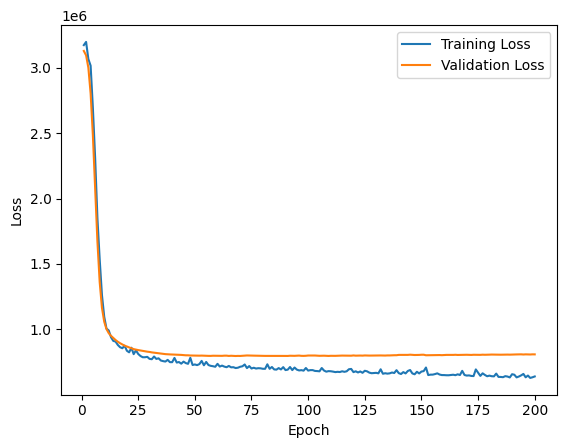

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_l3_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
ICA_local310 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local3, ICA_local310)

# Apply ICA to the first layer as an example
n_components_fc1 = 10  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_local310.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_l3_10 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_l3_10.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_l3_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3128285.9597, Average MAE: 1497.9268


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3181115.312, MAE Loss (Train): 1519.485
Validation Loss: 3126429.462, Validation MAE: 1497.122
Epoch [2/200], MSE Loss (Train): 3155211.147, MAE Loss (Train): 1511.904
Validation Loss: 3105414.058, Validation MAE: 1490.149
Epoch [3/200], MSE Loss (Train): 3236482.606, MAE Loss (Train): 1524.774
Validation Loss: 3056072.942, Validation MAE: 1473.983
Epoch [4/200], MSE Loss (Train): 3063544.014, MAE Loss (Train): 1479.436
Validation Loss: 2963110.365, Validation MAE: 1443.394
Epoch [5/200], MSE Loss (Train): 2984033.731, MAE Loss (Train): 1447.022
Validation Loss: 2813164.740, Validation MAE: 1392.765
Epoch [6/200], MSE Loss (Train): 2717624.993, MAE Loss (Train): 1365.073
Validation Loss: 2597799.663, Validation MAE: 1316.562
Epoch [7/200], MSE Loss (Train): 2476083.514, MAE Loss (Train): 1275.708
Validation Loss: 2327248.990, Validation MAE: 1212.878
Epoch [8/200], MSE Loss (Train): 2169964.489, MAE Loss (Train): 1153.931
Validation Loss: 2032205.837, V

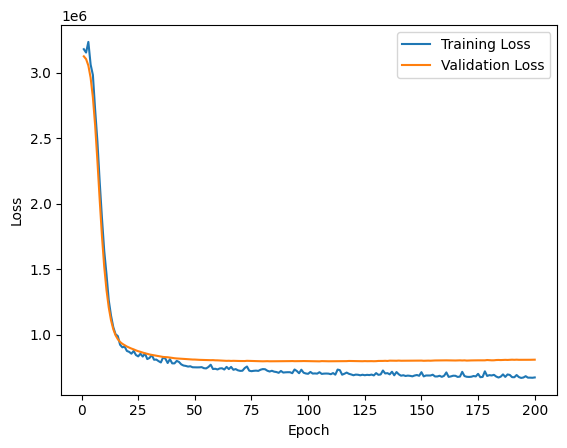

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_l3_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### ICA on the Pruned Model, `pruned_local4`, with Pruning Amount=0.9

###### no_components = 50

In [ ]:
# create copy of the model
ICA_pruned_local_09 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local4, ICA_pruned_local_09)

In [ ]:
# Apply ICA to the first layer as an example
n_components_fc1 = 50  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_pruned_local_09.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_l4_50 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_l4_50.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_l4_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Average Loss: 3131216.0740, Average MAE: 1498.9496


Epoch [1/200], MSE Loss (Train): 3153982.764, MAE Loss (Train): 1512.050
Validation Loss: 3121837.750, Validation MAE: 1495.750
Epoch [2/200], MSE Loss (Train): 3133552.882, MAE Loss (Train): 1502.729
Validation Loss: 3060565.327, Validation MAE: 1476.040
Epoch [3/200], MSE Loss (Train): 3005960.286, MAE Loss (Train): 1463.579
Validation Loss: 2875812.942, Validation MAE: 1415.635
Epoch [4/200], MSE Loss (Train): 2728033.197, MAE Loss (Train): 1370.450
Validation Loss: 2493792.740, Validation MAE: 1280.824
Epoch [5/200], MSE Loss (Train): 2237068.930, MAE Loss (Train): 1183.165
Validation Loss: 1957945.010, Validation MAE: 1061.498
Epoch [6/200], MSE Loss (Train): 1746096.053, MAE Loss (Train): 966.651
Validation Loss: 1459101.260, Validation MAE: 838.316
Epoch [7/200], MSE Loss (Train): 1326897.999, MAE Loss (Train): 798.638
Validation Loss: 1154215.260, Validation MAE: 726.586
Epoch [8/200], MSE Loss (Train): 1090233.183, MAE Loss (Train): 725.349
Validation Loss: 1029785.346, Valida

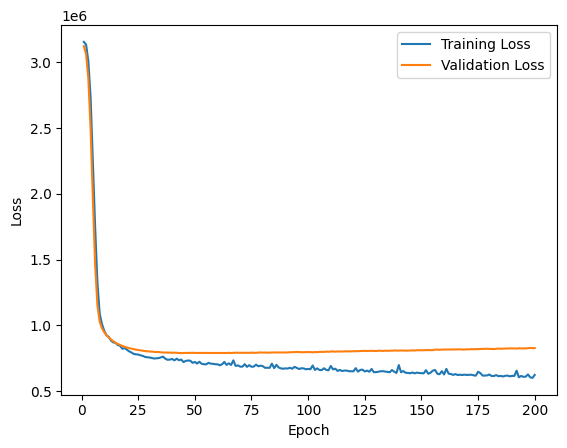

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_l4_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
ICA_local430 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local4, ICA_local430)

# Apply ICA to the first layer as an example
n_components_fc1 = 30  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_local430.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_l4_30 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_l4_30.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_l4_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130425.4034, Average MAE: 1498.6718


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3239977.822, MAE Loss (Train): 1529.363
Validation Loss: 3124698.731, Validation MAE: 1496.731
Epoch [2/200], MSE Loss (Train): 3149508.043, MAE Loss (Train): 1507.623
Validation Loss: 3075408.442, Validation MAE: 1481.062
Epoch [3/200], MSE Loss (Train): 3088917.870, MAE Loss (Train): 1486.251
Validation Loss: 2936195.827, Validation MAE: 1436.271
Epoch [4/200], MSE Loss (Train): 2846049.159, MAE Loss (Train): 1411.066
Validation Loss: 2655976.288, Validation MAE: 1341.555
Epoch [5/200], MSE Loss (Train): 2496739.781, MAE Loss (Train): 1286.672
Validation Loss: 2232591.596, Validation MAE: 1181.965
Epoch [6/200], MSE Loss (Train): 2017524.069, MAE Loss (Train): 1091.370
Validation Loss: 1755769.038, Validation MAE: 974.133
Epoch [7/200], MSE Loss (Train): 1560160.235, MAE Loss (Train): 899.297
Validation Loss: 1369082.308, Validation MAE: 805.130
Epoch [8/200], MSE Loss (Train): 1252833.319, MAE Loss (Train): 777.763
Validation Loss: 1136880.529, Valid

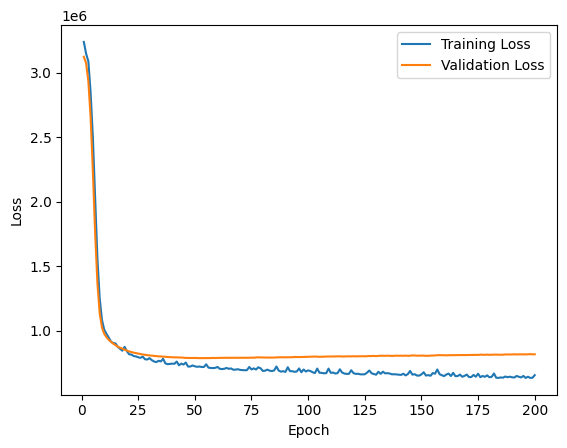

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_l4_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
ICA_local410 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local4, ICA_local410)

# Apply ICA to the first layer as an example
n_components_fc1 = 10  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_local410.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_l4_10 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_l4_10.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_l4_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3129714.5990, Average MAE: 1498.4507


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3205685.731, MAE Loss (Train): 1525.019
Validation Loss: 3130808.269, Validation MAE: 1498.669
Epoch [2/200], MSE Loss (Train): 3154113.392, MAE Loss (Train): 1510.115
Validation Loss: 3113945.231, Validation MAE: 1493.177
Epoch [3/200], MSE Loss (Train): 3115992.490, MAE Loss (Train): 1499.473
Validation Loss: 3066358.885, Validation MAE: 1477.715
Epoch [4/200], MSE Loss (Train): 3036343.909, MAE Loss (Train): 1473.514
Validation Loss: 2961182.096, Validation MAE: 1443.123
Epoch [5/200], MSE Loss (Train): 2892255.445, MAE Loss (Train): 1424.155
Validation Loss: 2780492.846, Validation MAE: 1381.761
Epoch [6/200], MSE Loss (Train): 2725905.022, MAE Loss (Train): 1357.522
Validation Loss: 2521616.356, Validation MAE: 1287.983
Epoch [7/200], MSE Loss (Train): 2409536.916, MAE Loss (Train): 1244.314
Validation Loss: 2205635.529, Validation MAE: 1162.774
Epoch [8/200], MSE Loss (Train): 2022000.456, MAE Loss (Train): 1093.078
Validation Loss: 1871515.192, V

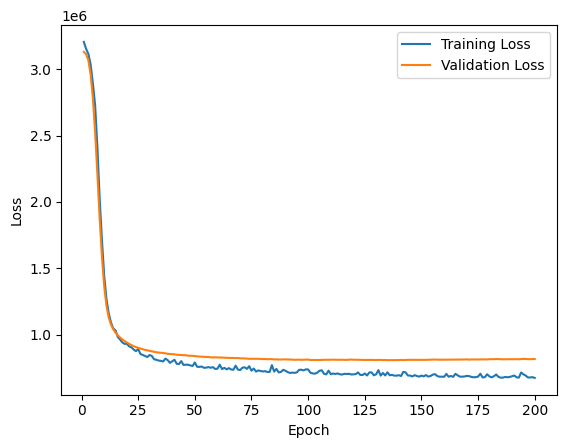

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_l4_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### ICA on the Pruned Model, `pruned_local5`, with Pruning Amount=0.95

###### no_components = 50

In [ ]:
# create copy of the model
ICA_pruned_local_09 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local5, ICA_pruned_local_09)

In [ ]:
# Apply ICA to the first layer as an example
n_components_fc1 = 50  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_pruned_local_09.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_l5_50 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_l5_50.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_l5_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Average Loss: 3815254579850036421926584320.0000, Average MAE: 50434301816281.1953


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3691332058252802526944428032.000, MAE Loss (Train): 48960068165001.844
Validation Loss: 3819583281975999906669658112.000, Validation MAE: 50417871920521.844
Epoch [2/200], MSE Loss (Train): 3608226774462224312857264128.000, MAE Loss (Train): 48243851193422.766
Validation Loss: 3819583281975999906669658112.000, Validation MAE: 50417871920521.844
Epoch [3/200], MSE Loss (Train): 3657660816142611775907430400.000, MAE Loss (Train): 48744588458771.695
Validation Loss: 3819583281975999906669658112.000, Validation MAE: 50417871920521.844
Epoch [4/200], MSE Loss (Train): 3608742687324556356703223808.000, MAE Loss (Train): 48229758614291.695
Validation Loss: 3819583259272315146606739456.000, Validation MAE: 50417871920521.844
Epoch [5/200], MSE Loss (Train): 3594854995032510984502640640.000, MAE Loss (Train): 48176876345501.539
Validation Loss: 3819583259272315146606739456.000, Validation MAE: 50417871920521.844
Epoch [6/200], MSE Loss (Train): 37091956383112082

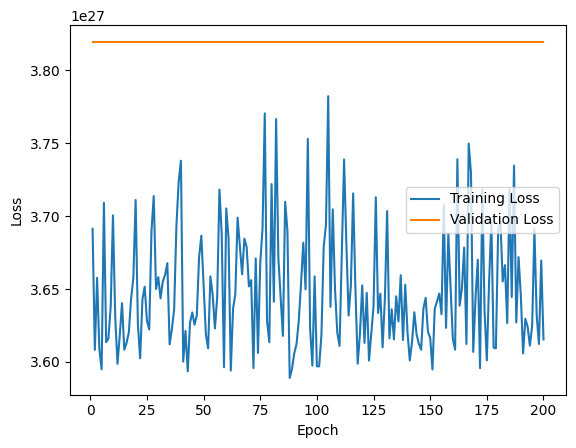

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_l5_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
ICA_local530 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local5, ICA_local530)


# Apply ICA to the first layer as an example
n_components_fc1 = 30  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_local530.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_l5_30 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_l5_30.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_l5_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130578.8123, Average MAE: 1498.7295


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3209973.339, MAE Loss (Train): 1526.161
Validation Loss: 3125026.827, Validation MAE: 1496.735
Epoch [2/200], MSE Loss (Train): 3181100.200, MAE Loss (Train): 1518.025
Validation Loss: 3088448.981, Validation MAE: 1484.666
Epoch [3/200], MSE Loss (Train): 3123850.481, MAE Loss (Train): 1500.624
Validation Loss: 2986245.981, Validation MAE: 1450.824
Epoch [4/200], MSE Loss (Train): 2921503.221, MAE Loss (Train): 1433.081
Validation Loss: 2775216.942, Validation MAE: 1378.703
Epoch [5/200], MSE Loss (Train): 2689854.762, MAE Loss (Train): 1347.342
Validation Loss: 2433860.385, Validation MAE: 1253.084
Epoch [6/200], MSE Loss (Train): 2286089.800, MAE Loss (Train): 1190.099
Validation Loss: 2003896.087, Validation MAE: 1073.622
Epoch [7/200], MSE Loss (Train): 1807315.339, MAE Loss (Train): 991.794
Validation Loss: 1583876.913, Validation MAE: 885.404
Epoch [8/200], MSE Loss (Train): 1416484.334, MAE Loss (Train): 824.733
Validation Loss: 1275041.462, Vali

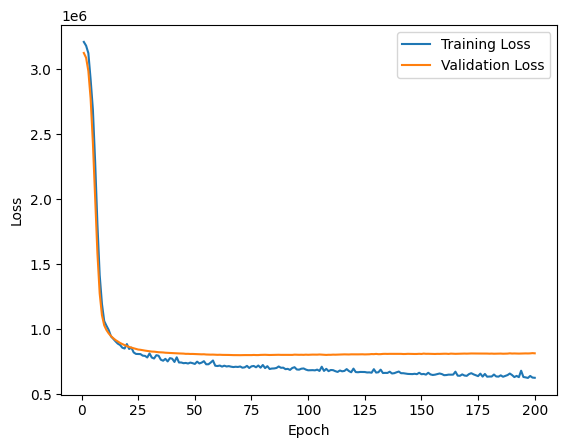

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_l5_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
ICA_local530 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_local5, ICA_local530)

# Apply ICA to the first layer as an example
n_components_fc1 = 10  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_local530.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_l5_10 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_l5_10.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_l5_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130238.9364, Average MAE: 1498.6077


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3234878.486, MAE Loss (Train): 1528.301
Validation Loss: 3130684.942, Validation MAE: 1498.582
Epoch [2/200], MSE Loss (Train): 3201792.957, MAE Loss (Train): 1519.118
Validation Loss: 3113672.058, Validation MAE: 1492.894
Epoch [3/200], MSE Loss (Train): 3142934.988, MAE Loss (Train): 1505.979
Validation Loss: 3070044.423, Validation MAE: 1478.210
Epoch [4/200], MSE Loss (Train): 3090801.841, MAE Loss (Train): 1487.796
Validation Loss: 2982482.115, Validation MAE: 1448.484
Epoch [5/200], MSE Loss (Train): 3012901.702, MAE Loss (Train): 1455.785
Validation Loss: 2833248.269, Validation MAE: 1396.044
Epoch [6/200], MSE Loss (Train): 2814721.433, MAE Loss (Train): 1386.672
Validation Loss: 2618837.096, Validation MAE: 1316.281
Epoch [7/200], MSE Loss (Train): 2502237.065, MAE Loss (Train): 1271.599
Validation Loss: 2347486.298, Validation MAE: 1206.335
Epoch [8/200], MSE Loss (Train): 2249988.671, MAE Loss (Train): 1172.061
Validation Loss: 2050530.106, V

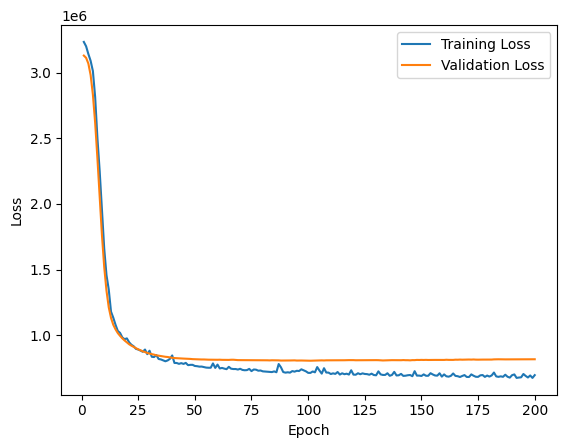

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_l5_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

### ICA on Layer-Wise Locally Pruned Models

#### ICA on the Pruned Model, `pruned_sparse1`, with Pruning Amount=0.6

###### no_components = 50

In [ ]:
# create copy of the model
ICA_sparse1 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse1, ICA_sparse1)

In [ ]:
# Apply ICA to the first layer as an example
n_components_fc1 = 50  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_sparse1.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_sparse1_50 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_sparse1_50.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_sparse1_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Average Loss: 3130653.5685, Average MAE: 1498.7699


Epoch [1/200], MSE Loss (Train): 3235114.365, MAE Loss (Train): 1525.966
Validation Loss: 3118176.038, Validation MAE: 1494.660
Epoch [2/200], MSE Loss (Train): 3172040.442, MAE Loss (Train): 1513.131
Validation Loss: 3054037.096, Validation MAE: 1474.398
Epoch [3/200], MSE Loss (Train): 3005344.986, MAE Loss (Train): 1463.359
Validation Loss: 2876965.596, Validation MAE: 1417.402
Epoch [4/200], MSE Loss (Train): 2824077.416, MAE Loss (Train): 1392.983
Validation Loss: 2522942.846, Validation MAE: 1294.376
Epoch [5/200], MSE Loss (Train): 2283944.077, MAE Loss (Train): 1210.024
Validation Loss: 2038345.125, Validation MAE: 1100.266
Epoch [6/200], MSE Loss (Train): 1789474.536, MAE Loss (Train): 1008.696
Validation Loss: 1574440.529, Validation MAE: 901.010
Epoch [7/200], MSE Loss (Train): 1380633.221, MAE Loss (Train): 839.873
Validation Loss: 1265379.731, Validation MAE: 776.646
Epoch [8/200], MSE Loss (Train): 1195649.565, MAE Loss (Train): 769.197
Validation Loss: 1104827.048, Valid

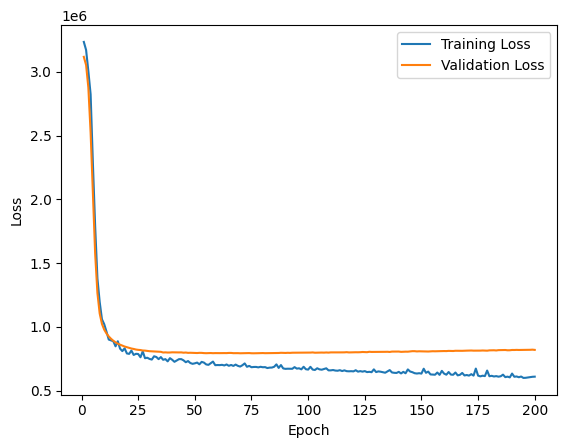

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_sparse1_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
ICA_sparse130 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse1, ICA_sparse130)

# Apply ICA to the first layer as an example
n_components_fc1 = 30  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_sparse130.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_sparse1_30 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_sparse1_30.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_sparse1_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131808.2335, Average MAE: 1499.1225


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3214170.048, MAE Loss (Train): 1521.159
Validation Loss: 3128444.173, Validation MAE: 1497.910
Epoch [2/200], MSE Loss (Train): 3228342.964, MAE Loss (Train): 1524.543
Validation Loss: 3096426.365, Validation MAE: 1487.628
Epoch [3/200], MSE Loss (Train): 3103320.214, MAE Loss (Train): 1494.501
Validation Loss: 3003812.442, Validation MAE: 1457.646
Epoch [4/200], MSE Loss (Train): 2957410.685, MAE Loss (Train): 1447.771
Validation Loss: 2806148.635, Validation MAE: 1391.789
Epoch [5/200], MSE Loss (Train): 2736700.394, MAE Loss (Train): 1364.940
Validation Loss: 2481417.452, Validation MAE: 1275.185
Epoch [6/200], MSE Loss (Train): 2316523.635, MAE Loss (Train): 1213.002
Validation Loss: 2066246.529, Validation MAE: 1107.280
Epoch [7/200], MSE Loss (Train): 1846735.624, MAE Loss (Train): 1021.512
Validation Loss: 1652128.308, Validation MAE: 922.880
Epoch [8/200], MSE Loss (Train): 1474708.492, MAE Loss (Train): 864.389
Validation Loss: 1338266.740, Val

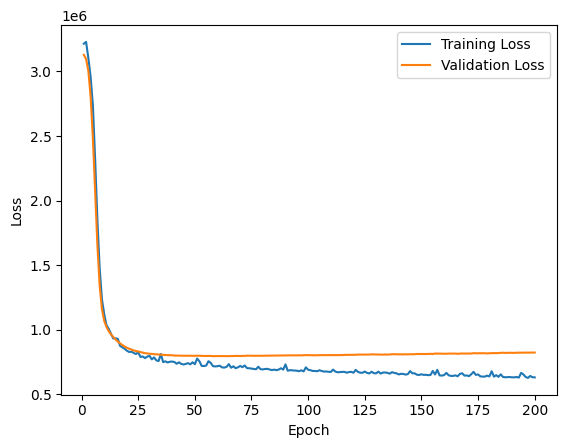

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_sparse1_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
ICA_sparse110 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse1, ICA_sparse110)

# Apply ICA to the first layer as an example
n_components_fc1 = 10  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_sparse110.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_sparse1_10 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_sparse1_10.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_sparse1_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132229.5208, Average MAE: 1499.3034


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3169545.752, MAE Loss (Train): 1515.531
Validation Loss: 3134079.904, Validation MAE: 1499.741
Epoch [2/200], MSE Loss (Train): 3227385.981, MAE Loss (Train): 1523.410
Validation Loss: 3123441.212, Validation MAE: 1496.229
Epoch [3/200], MSE Loss (Train): 3174645.274, MAE Loss (Train): 1511.954
Validation Loss: 3095706.846, Validation MAE: 1487.151
Epoch [4/200], MSE Loss (Train): 3097190.224, MAE Loss (Train): 1491.860
Validation Loss: 3033514.558, Validation MAE: 1466.540
Epoch [5/200], MSE Loss (Train): 3001670.276, MAE Loss (Train): 1462.706
Validation Loss: 2920672.615, Validation MAE: 1428.607
Epoch [6/200], MSE Loss (Train): 2855663.012, MAE Loss (Train): 1412.868
Validation Loss: 2748028.721, Validation MAE: 1368.671
Epoch [7/200], MSE Loss (Train): 2656431.099, MAE Loss (Train): 1341.764
Validation Loss: 2509130.192, Validation MAE: 1280.608
Epoch [8/200], MSE Loss (Train): 2377883.536, MAE Loss (Train): 1238.734
Validation Loss: 2218925.288, V

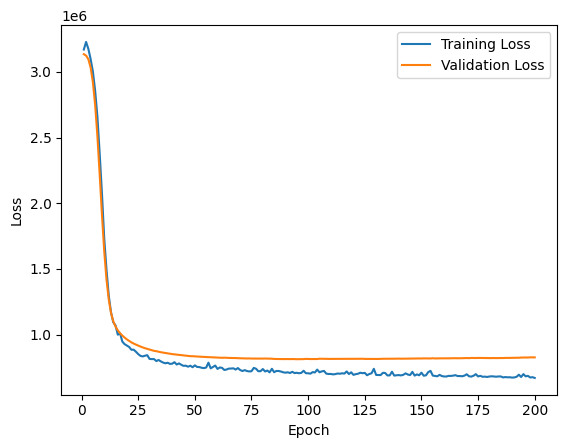

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_sparse1_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### ICA on the Pruned Model, `pruned_sparse2`, with Pruning Amount=0.7

###### no_components = 50

In [ ]:
# create copy of the model
ICA_sparse2 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse2, ICA_sparse2)

In [ ]:
# Apply ICA to the first layer as an example
n_components_fc1 = 50  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_sparse2.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_sparse2_50 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_sparse2_50.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_sparse2_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131662.1608, Average MAE: 1499.0512


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3167399.762, MAE Loss (Train): 1514.945
Validation Loss: 3117655.038, Validation MAE: 1494.420
Epoch [2/200], MSE Loss (Train): 3110021.925, MAE Loss (Train): 1497.466
Validation Loss: 3046368.423, Validation MAE: 1471.839
Epoch [3/200], MSE Loss (Train): 2997366.716, MAE Loss (Train): 1462.246
Validation Loss: 2843100.250, Validation MAE: 1405.822
Epoch [4/200], MSE Loss (Train): 2675247.627, MAE Loss (Train): 1356.085
Validation Loss: 2451043.010, Validation MAE: 1267.120
Epoch [5/200], MSE Loss (Train): 2183557.504, MAE Loss (Train): 1170.393
Validation Loss: 1929203.683, Validation MAE: 1053.611
Epoch [6/200], MSE Loss (Train): 1710539.918, MAE Loss (Train): 967.769
Validation Loss: 1471581.221, Validation MAE: 856.058
Epoch [7/200], MSE Loss (Train): 1318972.457, MAE Loss (Train): 817.986
Validation Loss: 1198849.620, Validation MAE: 753.597
Epoch [8/200], MSE Loss (Train): 1120713.728, MAE Loss (Train): 741.708
Validation Loss: 1064695.423, Valida

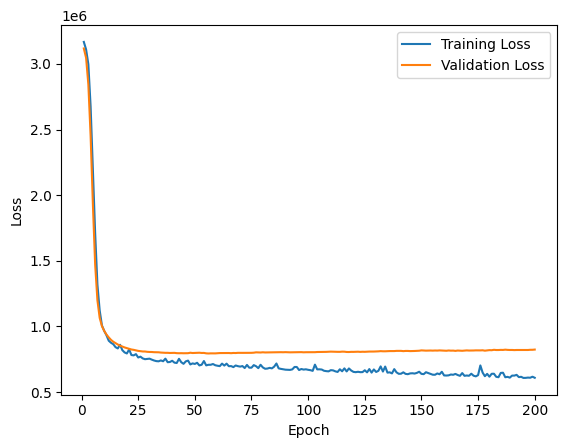

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_sparse2_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
ICA_sparse230 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse2, ICA_sparse230)

# Apply ICA to the first layer as an example
n_components_fc1 = 30  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_sparse230.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_sparse2_30 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_sparse2_30.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_sparse2_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130739.7567, Average MAE: 1498.7743


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3180267.721, MAE Loss (Train): 1520.159
Validation Loss: 3124166.442, Validation MAE: 1496.499
Epoch [2/200], MSE Loss (Train): 3156883.582, MAE Loss (Train): 1512.610
Validation Loss: 3078186.577, Validation MAE: 1481.670
Epoch [3/200], MSE Loss (Train): 3069510.839, MAE Loss (Train): 1483.744
Validation Loss: 2948138.019, Validation MAE: 1439.272
Epoch [4/200], MSE Loss (Train): 2890398.904, MAE Loss (Train): 1423.099
Validation Loss: 2685400.212, Validation MAE: 1350.149
Epoch [5/200], MSE Loss (Train): 2495863.373, MAE Loss (Train): 1287.334
Validation Loss: 2286777.548, Validation MAE: 1200.514
Epoch [6/200], MSE Loss (Train): 2080838.425, MAE Loss (Train): 1120.372
Validation Loss: 1829893.962, Validation MAE: 1005.970
Epoch [7/200], MSE Loss (Train): 1614287.846, MAE Loss (Train): 925.913
Validation Loss: 1436116.038, Validation MAE: 830.849
Epoch [8/200], MSE Loss (Train): 1283769.553, MAE Loss (Train): 790.765
Validation Loss: 1187309.736, Vali

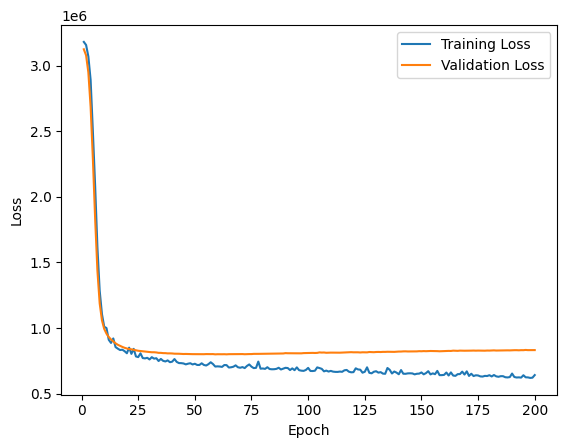

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_sparse2_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
ICA_sparse210 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse2, ICA_sparse210)

# Apply ICA to the first layer as an example
n_components_fc1 = 10  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_sparse210.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_sparse2_10 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_sparse2_10.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_sparse2_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131495.8704, Average MAE: 1499.0358


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3155910.815, MAE Loss (Train): 1512.735
Validation Loss: 3133199.596, Validation MAE: 1499.412
Epoch [2/200], MSE Loss (Train): 3217691.553, MAE Loss (Train): 1520.781
Validation Loss: 3117823.115, Validation MAE: 1494.217
Epoch [3/200], MSE Loss (Train): 3209071.837, MAE Loss (Train): 1522.823
Validation Loss: 3075960.827, Validation MAE: 1480.020
Epoch [4/200], MSE Loss (Train): 3118846.666, MAE Loss (Train): 1490.349
Validation Loss: 2987426.673, Validation MAE: 1449.753
Epoch [5/200], MSE Loss (Train): 2954066.192, MAE Loss (Train): 1444.708
Validation Loss: 2837092.365, Validation MAE: 1397.344
Epoch [6/200], MSE Loss (Train): 2805902.964, MAE Loss (Train): 1383.507
Validation Loss: 2616784.067, Validation MAE: 1316.745
Epoch [7/200], MSE Loss (Train): 2556591.214, MAE Loss (Train): 1290.910
Validation Loss: 2336795.875, Validation MAE: 1206.414
Epoch [8/200], MSE Loss (Train): 2222104.781, MAE Loss (Train): 1163.064
Validation Loss: 2026158.433, V

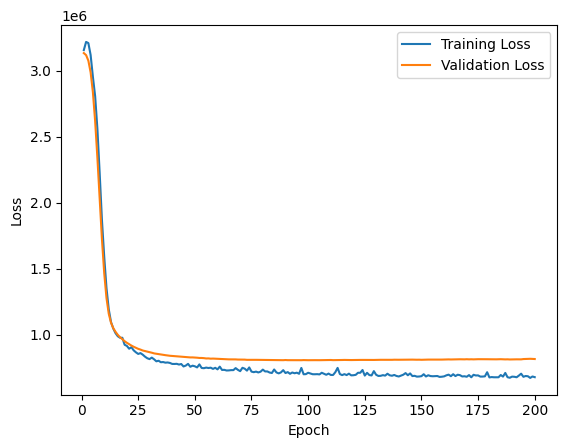

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_sparse2_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### ICA on the Pruned Model, `pruned_sparse3`, with Pruning Amount=0.8

###### no_components = 50

In [ ]:
# create copy of the model
ICA_sparse3 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse3, ICA_sparse3)

In [ ]:
# Apply ICA to the first layer as an example
n_components_fc1 = 50  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_sparse3.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_sparse3_50 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_sparse3_50.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_sparse3_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130283.0685, Average MAE: 1498.6473


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3149776.841, MAE Loss (Train): 1510.859
Validation Loss: 3115413.269, Validation MAE: 1493.819
Epoch [2/200], MSE Loss (Train): 3165975.668, MAE Loss (Train): 1507.635
Validation Loss: 3046796.442, Validation MAE: 1472.064
Epoch [3/200], MSE Loss (Train): 2996951.875, MAE Loss (Train): 1460.696
Validation Loss: 2867550.385, Validation MAE: 1414.293
Epoch [4/200], MSE Loss (Train): 2763564.697, MAE Loss (Train): 1381.729
Validation Loss: 2526243.587, Validation MAE: 1296.364
Epoch [5/200], MSE Loss (Train): 2363245.901, MAE Loss (Train): 1228.257
Validation Loss: 2052971.298, Validation MAE: 1109.484
Epoch [6/200], MSE Loss (Train): 1825674.315, MAE Loss (Train): 1018.878
Validation Loss: 1596905.899, Validation MAE: 911.624
Epoch [7/200], MSE Loss (Train): 1438313.787, MAE Loss (Train): 862.320
Validation Loss: 1280393.534, Validation MAE: 780.324
Epoch [8/200], MSE Loss (Train): 1223105.722, MAE Loss (Train): 779.824
Validation Loss: 1116594.601, Valid

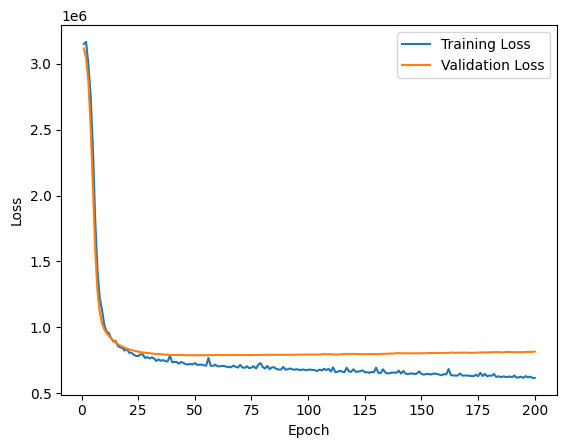

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_sparse3_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
ICA_sparse330 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse3, ICA_sparse330)

# Apply ICA to the first layer as an example
n_components_fc1 = 30  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_sparse330.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_sparse3_30 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_sparse3_30.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_sparse3_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3136346.4236, Average MAE: 1500.6602


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3158674.404, MAE Loss (Train): 1513.763
Validation Loss: 3133790.808, Validation MAE: 1499.710
Epoch [2/200], MSE Loss (Train): 3223625.736, MAE Loss (Train): 1526.255
Validation Loss: 3112674.404, Validation MAE: 1492.906
Epoch [3/200], MSE Loss (Train): 3116445.572, MAE Loss (Train): 1500.332
Validation Loss: 3048567.750, Validation MAE: 1472.150
Epoch [4/200], MSE Loss (Train): 3067810.548, MAE Loss (Train): 1479.942
Validation Loss: 2891143.923, Validation MAE: 1420.386
Epoch [5/200], MSE Loss (Train): 2776301.028, MAE Loss (Train): 1386.451
Validation Loss: 2604089.625, Validation MAE: 1321.159
Epoch [6/200], MSE Loss (Train): 2481175.837, MAE Loss (Train): 1276.215
Validation Loss: 2202481.394, Validation MAE: 1166.683
Epoch [7/200], MSE Loss (Train): 2001105.200, MAE Loss (Train): 1083.920
Validation Loss: 1758734.692, Validation MAE: 972.560
Epoch [8/200], MSE Loss (Train): 1586548.938, MAE Loss (Train): 909.776
Validation Loss: 1390326.976, Val

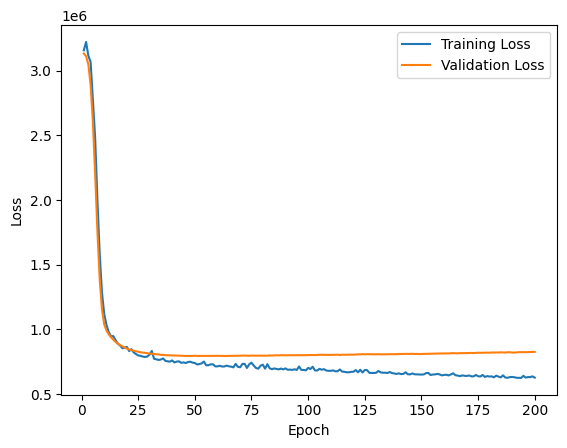

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_sparse3_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
ICA_sparse310 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse3, ICA_sparse310)

# Apply ICA to the first layer as an example
n_components_fc1 = 10  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_sparse310.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_sparse3_10 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_sparse3_10.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_sparse3_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132060.5434, Average MAE: 1499.1879


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3169346.906, MAE Loss (Train): 1516.277
Validation Loss: 3133466.865, Validation MAE: 1499.528
Epoch [2/200], MSE Loss (Train): 3146777.387, MAE Loss (Train): 1508.369
Validation Loss: 3121295.385, Validation MAE: 1495.591
Epoch [3/200], MSE Loss (Train): 3124273.209, MAE Loss (Train): 1502.134
Validation Loss: 3088261.942, Validation MAE: 1485.045
Epoch [4/200], MSE Loss (Train): 3096624.428, MAE Loss (Train): 1493.863
Validation Loss: 3014175.865, Validation MAE: 1461.418
Epoch [5/200], MSE Loss (Train): 2976832.998, MAE Loss (Train): 1455.613
Validation Loss: 2882218.385, Validation MAE: 1418.685
Epoch [6/200], MSE Loss (Train): 2810967.293, MAE Loss (Train): 1402.596
Validation Loss: 2683361.981, Validation MAE: 1351.612
Epoch [7/200], MSE Loss (Train): 2573941.918, MAE Loss (Train): 1319.847
Validation Loss: 2424934.596, Validation MAE: 1257.851
Epoch [8/200], MSE Loss (Train): 2326736.796, MAE Loss (Train): 1225.362
Validation Loss: 2134413.125, V

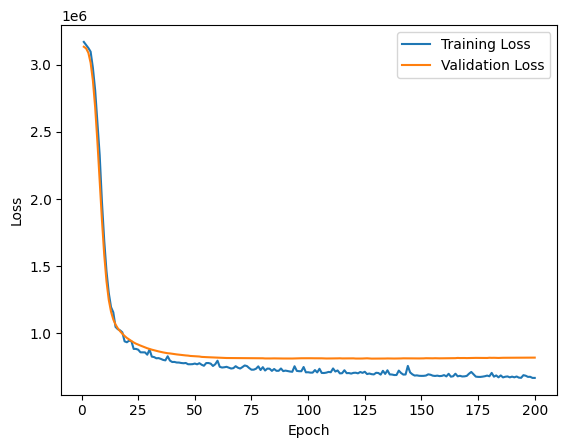

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_sparse3_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### ICA on the Pruned Model, `pruned_sparse4`, with Pruning Amount=0.9

###### no_components = 50

In [ ]:
# create copy of the model
ICA_sparse4 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse4, ICA_sparse4)

In [ ]:
# Apply ICA to the first layer as an example
n_components_fc1 = 50  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_sparse4.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_sparse4_50 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_sparse4_50.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_sparse4_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131280.9230, Average MAE: 1498.9352


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3169577.721, MAE Loss (Train): 1517.456
Validation Loss: 3119928.615, Validation MAE: 1495.198
Epoch [2/200], MSE Loss (Train): 3146317.909, MAE Loss (Train): 1506.359
Validation Loss: 3056981.769, Validation MAE: 1475.143
Epoch [3/200], MSE Loss (Train): 3010332.938, MAE Loss (Train): 1464.329
Validation Loss: 2877964.404, Validation MAE: 1417.151
Epoch [4/200], MSE Loss (Train): 2800299.190, MAE Loss (Train): 1388.566
Validation Loss: 2514033.500, Validation MAE: 1290.336
Epoch [5/200], MSE Loss (Train): 2310083.700, MAE Loss (Train): 1209.962
Validation Loss: 2000459.596, Validation MAE: 1084.092
Epoch [6/200], MSE Loss (Train): 1814561.990, MAE Loss (Train): 995.919
Validation Loss: 1509787.139, Validation MAE: 867.099
Epoch [7/200], MSE Loss (Train): 1349021.058, MAE Loss (Train): 815.710
Validation Loss: 1192541.995, Validation MAE: 741.203
Epoch [8/200], MSE Loss (Train): 1126427.704, MAE Loss (Train): 739.433
Validation Loss: 1047396.327, Valida

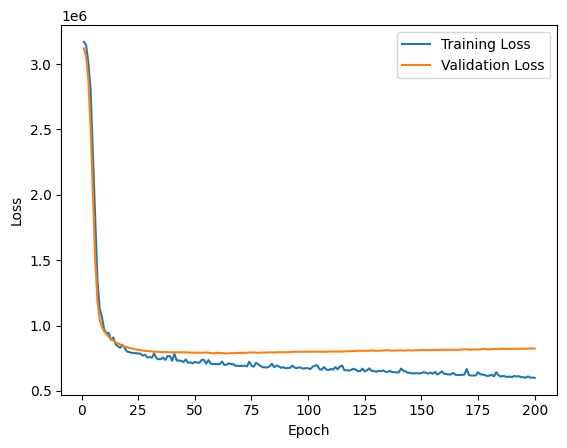

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_sparse4_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
ICA_sparse430 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse4, ICA_sparse430)

# Apply ICA to the first layer as an example
n_components_fc1 = 30  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_sparse430.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_sparse4_30 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_sparse4_30.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_sparse4_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130317.9811, Average MAE: 1498.6633


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3174122.618, MAE Loss (Train): 1516.381
Validation Loss: 3125362.462, Validation MAE: 1496.895
Epoch [2/200], MSE Loss (Train): 3162001.493, MAE Loss (Train): 1510.440
Validation Loss: 3091145.577, Validation MAE: 1485.765
Epoch [3/200], MSE Loss (Train): 3125526.683, MAE Loss (Train): 1499.534
Validation Loss: 2996424.788, Validation MAE: 1455.056
Epoch [4/200], MSE Loss (Train): 2951389.171, MAE Loss (Train): 1443.903
Validation Loss: 2797268.846, Validation MAE: 1388.892
Epoch [5/200], MSE Loss (Train): 2678457.947, MAE Loss (Train): 1352.899
Validation Loss: 2475233.038, Validation MAE: 1274.196
Epoch [6/200], MSE Loss (Train): 2357165.168, MAE Loss (Train): 1224.625
Validation Loss: 2068336.769, Validation MAE: 1110.506
Epoch [7/200], MSE Loss (Train): 1870809.046, MAE Loss (Train): 1031.554
Validation Loss: 1668661.452, Validation MAE: 936.877
Epoch [8/200], MSE Loss (Train): 1500653.304, MAE Loss (Train): 878.657
Validation Loss: 1365755.245, Val

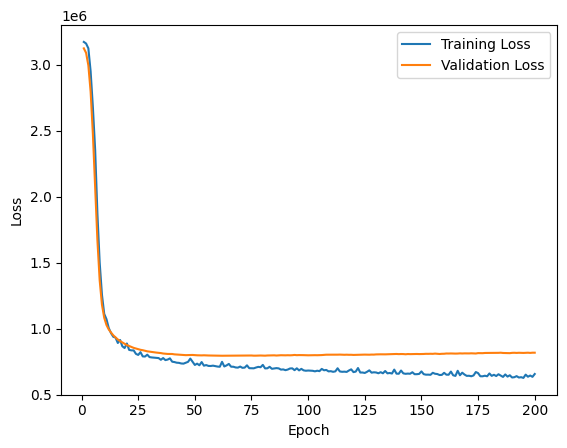

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_sparse4_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
ICA_sparse410 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse4, ICA_sparse410)

# Apply ICA to the first layer as an example
n_components_fc1 = 10  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_sparse410.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_sparse4_10 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_sparse4_10.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_sparse4_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3131103.1247, Average MAE: 1498.8972


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3279563.594, MAE Loss (Train): 1536.891
Validation Loss: 3132471.462, Validation MAE: 1499.123
Epoch [2/200], MSE Loss (Train): 3247612.221, MAE Loss (Train): 1529.225
Validation Loss: 3118085.269, Validation MAE: 1494.256
Epoch [3/200], MSE Loss (Train): 3138530.111, MAE Loss (Train): 1505.428
Validation Loss: 3078969.808, Validation MAE: 1481.234
Epoch [4/200], MSE Loss (Train): 3213712.166, MAE Loss (Train): 1509.209
Validation Loss: 2990612.096, Validation MAE: 1451.945
Epoch [5/200], MSE Loss (Train): 2939205.498, MAE Loss (Train): 1440.203
Validation Loss: 2833449.788, Validation MAE: 1398.829
Epoch [6/200], MSE Loss (Train): 2741545.118, MAE Loss (Train): 1371.905
Validation Loss: 2595579.731, Validation MAE: 1314.023
Epoch [7/200], MSE Loss (Train): 2442429.351, MAE Loss (Train): 1261.553
Validation Loss: 2292291.952, Validation MAE: 1195.953
Epoch [8/200], MSE Loss (Train): 2120844.046, MAE Loss (Train): 1133.698
Validation Loss: 1972678.144, V

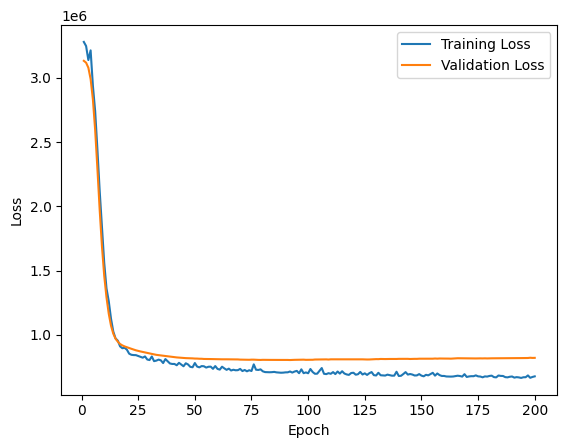

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_sparse4_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

#### ICA on the Pruned Model, `pruned_sparse5`, with Pruning Amount=0.95

###### no_components = 50

In [ ]:
# create copy of the model
ICA_sparse5 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse5, ICA_sparse5)

In [ ]:
# Apply ICA to the first layer as an example
n_components_fc1 = 50  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_sparse5.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_sparse5_50 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_sparse5_50.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_sparse5_50, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Average Loss: 3131056.3075, Average MAE: 1498.8912


Epoch [1/200], MSE Loss (Train): 3227836.697, MAE Loss (Train): 1523.357
Validation Loss: 3114163.077, Validation MAE: 1493.263
Epoch [2/200], MSE Loss (Train): 3120091.784, MAE Loss (Train): 1501.899
Validation Loss: 3031708.385, Validation MAE: 1466.867
Epoch [3/200], MSE Loss (Train): 2969987.839, MAE Loss (Train): 1452.437
Validation Loss: 2814975.673, Validation MAE: 1396.048
Epoch [4/200], MSE Loss (Train): 2647683.017, MAE Loss (Train): 1339.750
Validation Loss: 2419081.135, Validation MAE: 1254.385
Epoch [5/200], MSE Loss (Train): 2194474.666, MAE Loss (Train): 1167.645
Validation Loss: 1900055.413, Validation MAE: 1038.485
Epoch [6/200], MSE Loss (Train): 1666258.996, MAE Loss (Train): 946.506
Validation Loss: 1429666.433, Validation MAE: 829.593
Epoch [7/200], MSE Loss (Train): 1289921.981, MAE Loss (Train): 793.360
Validation Loss: 1151191.553, Validation MAE: 727.110
Epoch [8/200], MSE Loss (Train): 1142409.367, MAE Loss (Train): 741.401
Validation Loss: 1033716.380, Valida

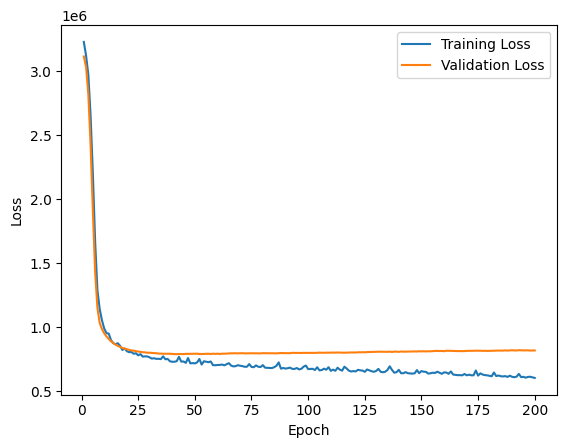

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_sparse5_50, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 30

In [ ]:
# create copy of the model
ICA_sparse530 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse5, ICA_sparse530)

# Apply ICA to the first layer as an example
n_components_fc1 = 30  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_sparse530.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_sparse5_30 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_sparse5_30.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_sparse5_30, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3132035.8594, Average MAE: 1499.2544


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3174312.399, MAE Loss (Train): 1518.064
Validation Loss: 3124257.365, Validation MAE: 1496.425
Epoch [2/200], MSE Loss (Train): 3145093.649, MAE Loss (Train): 1508.463
Validation Loss: 3083499.962, Validation MAE: 1482.762
Epoch [3/200], MSE Loss (Train): 3053648.698, MAE Loss (Train): 1478.648
Validation Loss: 2977667.327, Validation MAE: 1447.140
Epoch [4/200], MSE Loss (Train): 2924441.017, MAE Loss (Train): 1435.208
Validation Loss: 2761256.558, Validation MAE: 1371.864
Epoch [5/200], MSE Loss (Train): 2624229.812, MAE Loss (Train): 1329.097
Validation Loss: 2415609.962, Validation MAE: 1241.743
Epoch [6/200], MSE Loss (Train): 2223992.995, MAE Loss (Train): 1171.476
Validation Loss: 1982580.865, Validation MAE: 1057.825
Epoch [7/200], MSE Loss (Train): 1778307.691, MAE Loss (Train): 982.214
Validation Loss: 1564898.000, Validation MAE: 876.018
Epoch [8/200], MSE Loss (Train): 1510368.637, MAE Loss (Train): 850.204
Validation Loss: 1272578.221, Vali

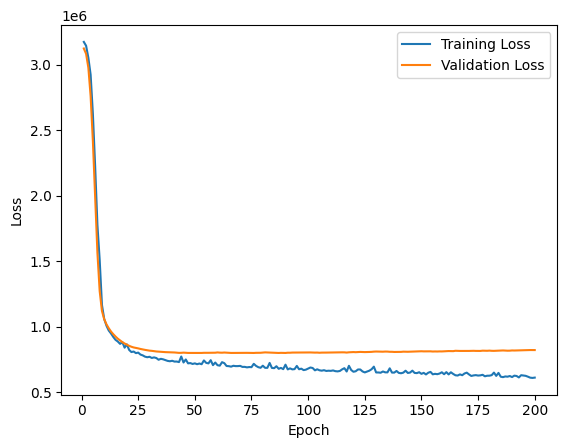

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_sparse5_30, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

##### no_components = 10

In [ ]:
# create copy of the model
ICA_sparse510 = RegressionNN(input_size, hidden_size1,
                                         hidden_size2, output_size)
transfer_pruned_weights(pruned_sparse5, ICA_sparse510)

# Apply ICA to the first layer as an example
n_components_fc1 = 10  # New dimension for fc1
transformed_fc1_weights = apply_ica_to_layer(ICA_sparse510.fc1,
                                             n_components=n_components_fc1)

# Instantiate the adjusted model
ICA_sparse5_10 = AdjustedModel()

# Update the adjusted model with ICA transformed weights for fc1
ICA_sparse5_10.fc1.weight.data = torch.from_numpy(transformed_fc1_weights).float()

# testing without training
average_loss, average_mae = evaluate_model(ICA_sparse5_10, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Average Loss: 3130873.9798, Average MAE: 1498.8395


/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_fastica.py:542: FutureWarning: Starting in v1.3, whiten='unit-variance' will be used by default.
  warnings.warn(


Epoch [1/200], MSE Loss (Train): 3170870.224, MAE Loss (Train): 1516.254
Validation Loss: 3131885.192, Validation MAE: 1499.072
Epoch [2/200], MSE Loss (Train): 3144249.688, MAE Loss (Train): 1508.821
Validation Loss: 3115372.808, Validation MAE: 1493.796
Epoch [3/200], MSE Loss (Train): 3127483.221, MAE Loss (Train): 1502.000
Validation Loss: 3072124.365, Validation MAE: 1479.972
Epoch [4/200], MSE Loss (Train): 3115821.659, MAE Loss (Train): 1492.372
Validation Loss: 2980982.423, Validation MAE: 1450.418
Epoch [5/200], MSE Loss (Train): 2934182.382, MAE Loss (Train): 1441.687
Validation Loss: 2823827.250, Validation MAE: 1397.735
Epoch [6/200], MSE Loss (Train): 2760172.346, MAE Loss (Train): 1377.628
Validation Loss: 2595237.385, Validation MAE: 1316.693
Epoch [7/200], MSE Loss (Train): 2492055.964, MAE Loss (Train): 1276.299
Validation Loss: 2307661.923, Validation MAE: 1206.531
Epoch [8/200], MSE Loss (Train): 2158158.339, MAE Loss (Train): 1143.231
Validation Loss: 1991436.038, V

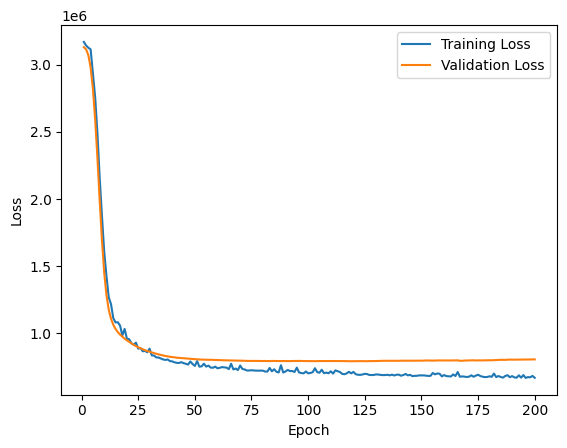

In [ ]:
# train and validate the model with PCA = 30
trained_model, training_losses, validation_losses = train_and_validate(
   model=ICA_sparse5_10, train_loader=train_loader,
   test_loader=test_loader, learning_rate=0.001, epochs=200
)

## Comparison of All Methods


### Creating and Training Smaller Networks

In this section, we will create smaller networks to match the dimensions of our compressed pruned models (PCA, SparsePCA, and ICA).  We are doing this to compare the performance of the original, smaller, and compressed network.

In [ ]:
# parameters for model
input_size = 58  # Number of input features
output_size = 1
epochs = 200
batch_size = 64
learning_rate = 0.001

Epoch [1/200], MSE Loss (Train): 3166702.010, MAE Loss (Train): 1514.986
Validation Loss: 3114290.885, Validation MAE: 1493.186
Epoch [2/200], MSE Loss (Train): 3109613.339, MAE Loss (Train): 1496.499
Validation Loss: 3045799.231, Validation MAE: 1470.883
Epoch [3/200], MSE Loss (Train): 2993416.344, MAE Loss (Train): 1459.809
Validation Loss: 2862677.077, Validation MAE: 1410.491
Epoch [4/200], MSE Loss (Train): 2780179.702, MAE Loss (Train): 1375.350
Validation Loss: 2497521.952, Validation MAE: 1281.528
Epoch [5/200], MSE Loss (Train): 2274355.952, MAE Loss (Train): 1199.864
Validation Loss: 1991797.288, Validation MAE: 1076.542
Epoch [6/200], MSE Loss (Train): 1742515.385, MAE Loss (Train): 980.722
Validation Loss: 1510159.130, Validation MAE: 861.645
Epoch [7/200], MSE Loss (Train): 1336646.118, MAE Loss (Train): 811.882
Validation Loss: 1203704.659, Validation MAE: 740.208
Epoch [8/200], MSE Loss (Train): 1114894.012, MAE Loss (Train): 725.699
Validation Loss: 1059122.793, Valida

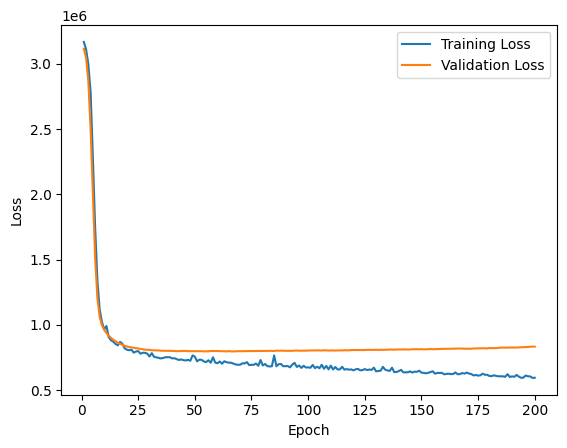

Average Loss: 833109.9506, Average MAE: 662.5665


In [ ]:
# smaller network with fc1=50 and fc2=32
small_5032 = RegressionNN(input_size, 50, 32, output_size)
# Call train_and_validate function
trained_model_5032, training_losses_5032, validation_losses_5032 = train_and_validate(
   model=small_5032, train_loader=train_loader,test_loader=test_loader,
   learning_rate=learning_rate, epochs=epochs
)
# Average Loss and MAE
average_loss, average_mae = evaluate_model(small_5032, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Epoch [1/200], MSE Loss (Train): 3157219.781, MAE Loss (Train): 1509.987
Validation Loss: 3111795.885, Validation MAE: 1492.292
Epoch [2/200], MSE Loss (Train): 3098073.738, MAE Loss (Train): 1492.811
Validation Loss: 3034525.673, Validation MAE: 1466.610
Epoch [3/200], MSE Loss (Train): 3009735.029, MAE Loss (Train): 1460.200
Validation Loss: 2837591.712, Validation MAE: 1399.978
Epoch [4/200], MSE Loss (Train): 2705693.719, MAE Loss (Train): 1356.648
Validation Loss: 2471958.125, Validation MAE: 1266.857
Epoch [5/200], MSE Loss (Train): 2243770.314, MAE Loss (Train): 1180.314
Validation Loss: 1970141.365, Validation MAE: 1058.762
Epoch [6/200], MSE Loss (Train): 1732679.424, MAE Loss (Train): 961.368
Validation Loss: 1485418.615, Validation MAE: 840.161
Epoch [7/200], MSE Loss (Train): 1323180.337, MAE Loss (Train): 791.231
Validation Loss: 1168708.755, Validation MAE: 724.756
Epoch [8/200], MSE Loss (Train): 1103735.376, MAE Loss (Train): 721.015
Validation Loss: 1027914.519, Valida

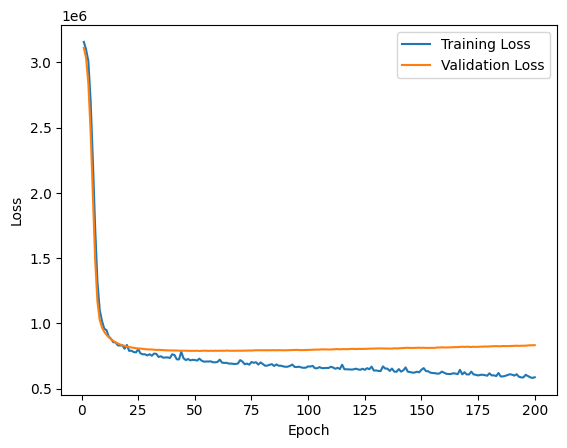

Average Loss: 834117.5542, Average MAE: 661.9798


In [ ]:
# smaller network with fc1=50 and fc2=30
small_5030 = RegressionNN(input_size, 50, 30, output_size)
# Call train_and_validate function
trained_model_5030, training_losses_5030, validation_losses_5030 = train_and_validate(
   model=small_5030, train_loader=train_loader,test_loader=test_loader,
   learning_rate=learning_rate, epochs=epochs
)
# Average Loss and MAE
average_loss, average_mae = evaluate_model(small_5030, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Epoch [1/200], MSE Loss (Train): 3161041.272, MAE Loss (Train): 1514.864
Validation Loss: 3127657.038, Validation MAE: 1497.583
Epoch [2/200], MSE Loss (Train): 3166190.909, MAE Loss (Train): 1515.419
Validation Loss: 3101656.788, Validation MAE: 1489.078
Epoch [3/200], MSE Loss (Train): 3136709.500, MAE Loss (Train): 1501.666
Validation Loss: 3043071.385, Validation MAE: 1470.050
Epoch [4/200], MSE Loss (Train): 3018556.988, MAE Loss (Train): 1468.441
Validation Loss: 2929310.462, Validation MAE: 1432.784
Epoch [5/200], MSE Loss (Train): 2887678.885, MAE Loss (Train): 1425.628
Validation Loss: 2741118.260, Validation MAE: 1369.574
Epoch [6/200], MSE Loss (Train): 2653756.940, MAE Loss (Train): 1343.528
Validation Loss: 2476321.981, Validation MAE: 1275.022
Epoch [7/200], MSE Loss (Train): 2339201.053, MAE Loss (Train): 1229.779
Validation Loss: 2159264.019, Validation MAE: 1150.722
Epoch [8/200], MSE Loss (Train): 2011675.800, MAE Loss (Train): 1089.320
Validation Loss: 1828561.779, V

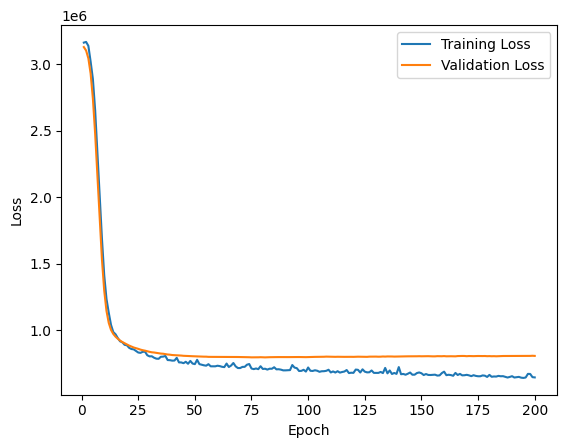

Average Loss: 809478.0436, Average MAE: 650.0939


In [ ]:
# smaller network with fc1=50 and fc2=10
small_5010 = RegressionNN(input_size, 50, 10, output_size)
# Call train_and_validate function
trained_model_5010, training_losses_5010, validation_losses_5010 = train_and_validate(
   model=small_5010, train_loader=train_loader,test_loader=test_loader,
   learning_rate=learning_rate, epochs=epochs
)
# Average Loss and MAE
average_loss, average_mae = evaluate_model(small_5010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Epoch [1/200], MSE Loss (Train): 3179737.154, MAE Loss (Train): 1517.473
Validation Loss: 3131368.288, Validation MAE: 1498.911
Epoch [2/200], MSE Loss (Train): 3191477.543, MAE Loss (Train): 1514.475
Validation Loss: 3111425.135, Validation MAE: 1492.611
Epoch [3/200], MSE Loss (Train): 3141199.462, MAE Loss (Train): 1505.886
Validation Loss: 3066841.346, Validation MAE: 1478.489
Epoch [4/200], MSE Loss (Train): 3121888.892, MAE Loss (Train): 1496.084
Validation Loss: 2978819.981, Validation MAE: 1450.090
Epoch [5/200], MSE Loss (Train): 3009629.776, MAE Loss (Train): 1453.969
Validation Loss: 2828619.606, Validation MAE: 1399.845
Epoch [6/200], MSE Loss (Train): 2775426.127, MAE Loss (Train): 1384.830
Validation Loss: 2610212.788, Validation MAE: 1322.707
Epoch [7/200], MSE Loss (Train): 2488650.029, MAE Loss (Train): 1282.564
Validation Loss: 2334745.827, Validation MAE: 1217.454
Epoch [8/200], MSE Loss (Train): 2187224.220, MAE Loss (Train): 1160.362
Validation Loss: 2032002.058, V

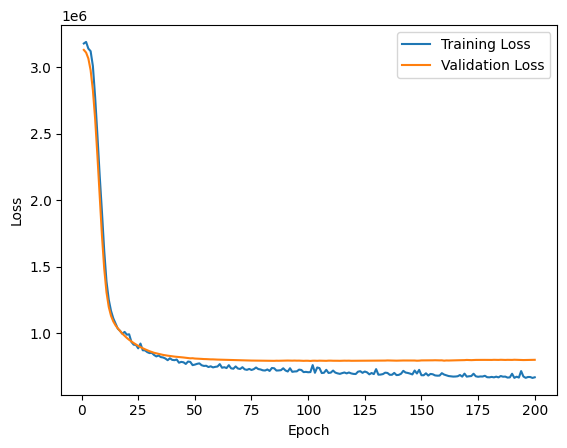

Average Loss: 800548.1035, Average MAE: 643.4436


In [ ]:
# smaller network with fc1=50 and fc2=5
small_505 = RegressionNN(input_size, 50, 5, output_size)
# Call train_and_validate function
trained_model_505, training_losses_505, validation_losses_505 = train_and_validate(
   model=small_505, train_loader=train_loader,test_loader=test_loader,
   learning_rate=learning_rate, epochs=epochs
)
# Average Loss and MAE
average_loss, average_mae = evaluate_model(small_505, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Epoch [1/200], MSE Loss (Train): 3227786.293, MAE Loss (Train): 1527.579
Validation Loss: 3124272.904, Validation MAE: 1496.593
Epoch [2/200], MSE Loss (Train): 3130720.899, MAE Loss (Train): 1501.536
Validation Loss: 3084429.000, Validation MAE: 1483.744
Epoch [3/200], MSE Loss (Train): 3120802.668, MAE Loss (Train): 1495.344
Validation Loss: 2981211.942, Validation MAE: 1449.923
Epoch [4/200], MSE Loss (Train): 2967361.639, MAE Loss (Train): 1442.783
Validation Loss: 2782109.048, Validation MAE: 1382.188
Epoch [5/200], MSE Loss (Train): 2667571.810, MAE Loss (Train): 1345.940
Validation Loss: 2479063.558, Validation MAE: 1271.264
Epoch [6/200], MSE Loss (Train): 2359665.938, MAE Loss (Train): 1213.461
Validation Loss: 2103550.740, Validation MAE: 1117.659
Epoch [7/200], MSE Loss (Train): 1896339.264, MAE Loss (Train): 1036.678
Validation Loss: 1717230.096, Validation MAE: 947.057
Epoch [8/200], MSE Loss (Train): 1541294.363, MAE Loss (Train): 888.113
Validation Loss: 1414827.365, Val

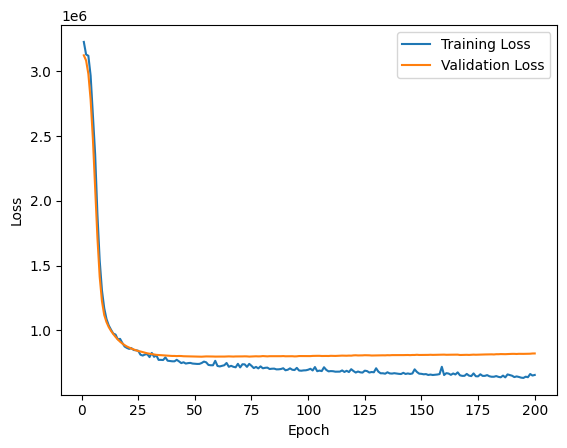

Average Loss: 823324.9965, Average MAE: 655.5545


In [ ]:
# smaller network with fc1=30 and fc2=32
small_3032 = RegressionNN(input_size, 30, 32, output_size)
# Call train_and_validate function
trained_model_3032, training_losses_3032, validation_losses_3032 = train_and_validate(
   model=small_3032, train_loader=train_loader,test_loader=test_loader,
   learning_rate=learning_rate, epochs=epochs
)
# Average Loss and MAE
average_loss, average_mae = evaluate_model(small_3032, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Epoch [1/200], MSE Loss (Train): 3159261.911, MAE Loss (Train): 1512.886
Validation Loss: 3136738.712, Validation MAE: 1500.626
Epoch [2/200], MSE Loss (Train): 3167539.637, MAE Loss (Train): 1512.797
Validation Loss: 3132219.519, Validation MAE: 1499.150
Epoch [3/200], MSE Loss (Train): 3198105.858, MAE Loss (Train): 1521.695
Validation Loss: 3121152.481, Validation MAE: 1495.562
Epoch [4/200], MSE Loss (Train): 3159799.351, MAE Loss (Train): 1512.589
Validation Loss: 3096042.635, Validation MAE: 1487.428
Epoch [5/200], MSE Loss (Train): 3147785.697, MAE Loss (Train): 1503.816
Validation Loss: 3043853.442, Validation MAE: 1470.342
Epoch [6/200], MSE Loss (Train): 3042044.065, MAE Loss (Train): 1476.304
Validation Loss: 2947598.212, Validation MAE: 1438.303
Epoch [7/200], MSE Loss (Train): 2985530.611, MAE Loss (Train): 1446.504
Validation Loss: 2800155.904, Validation MAE: 1387.814
Epoch [8/200], MSE Loss (Train): 2742065.454, MAE Loss (Train): 1370.891
Validation Loss: 2601037.317, V

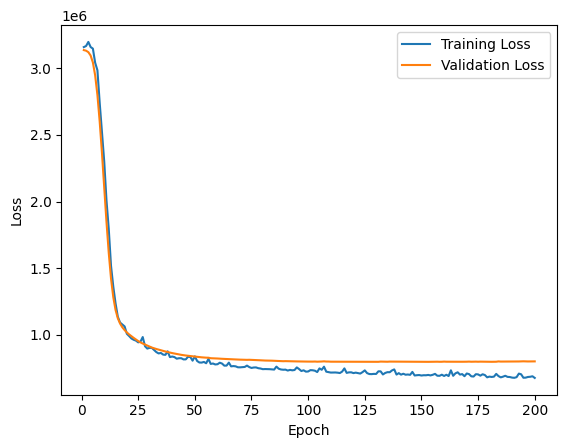

Average Loss: 801533.5384, Average MAE: 646.7047


In [ ]:
# smaller network with fc1=30 and fc2=10
small_3010 = RegressionNN(input_size, 30, 10, output_size)
# Call train_and_validate function
trained_model_3010, training_losses_3010, validation_losses_3010 = train_and_validate(
   model=small_3010, train_loader=train_loader,test_loader=test_loader,
   learning_rate=learning_rate, epochs=epochs
)
# Average Loss and MAE
average_loss, average_mae = evaluate_model(small_3010, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Epoch [1/200], MSE Loss (Train): 3179064.812, MAE Loss (Train): 1518.187
Validation Loss: 3132985.827, Validation MAE: 1499.254
Epoch [2/200], MSE Loss (Train): 3154748.096, MAE Loss (Train): 1511.721
Validation Loss: 3123757.365, Validation MAE: 1496.048
Epoch [3/200], MSE Loss (Train): 3209410.788, MAE Loss (Train): 1520.778
Validation Loss: 3105380.923, Validation MAE: 1489.734
Epoch [4/200], MSE Loss (Train): 3158381.697, MAE Loss (Train): 1503.367
Validation Loss: 3072474.769, Validation MAE: 1478.394
Epoch [5/200], MSE Loss (Train): 3116596.356, MAE Loss (Train): 1493.734
Validation Loss: 3016695.769, Validation MAE: 1459.295
Epoch [6/200], MSE Loss (Train): 3017501.072, MAE Loss (Train): 1464.844
Validation Loss: 2931341.769, Validation MAE: 1429.982
Epoch [7/200], MSE Loss (Train): 3006026.017, MAE Loss (Train): 1441.416
Validation Loss: 2809756.923, Validation MAE: 1387.518
Epoch [8/200], MSE Loss (Train): 2764207.519, MAE Loss (Train): 1377.269
Validation Loss: 2650116.885, V

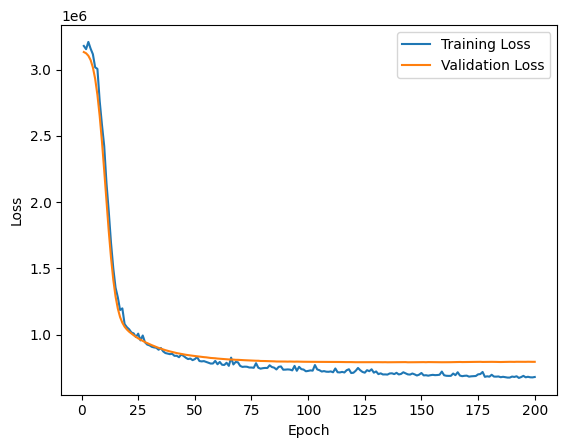

Average Loss: 795675.1247, Average MAE: 639.6209


In [ ]:
# smaller network with fc1=30 and fc2=5
small_305 = RegressionNN(input_size, 30, 5, output_size)
# Call train_and_validate function
trained_model_305, training_losses_305, validation_losses_305 = train_and_validate(
   model=small_305, train_loader=train_loader,test_loader=test_loader,
   learning_rate=learning_rate, epochs=epochs
)
# Average Loss and MAE
average_loss, average_mae = evaluate_model(small_305, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Epoch [1/200], MSE Loss (Train): 3246489.139, MAE Loss (Train): 1530.822
Validation Loss: 3132879.769, Validation MAE: 1499.319
Epoch [2/200], MSE Loss (Train): 3144109.837, MAE Loss (Train): 1507.684
Validation Loss: 3118473.827, Validation MAE: 1494.539
Epoch [3/200], MSE Loss (Train): 3130635.808, MAE Loss (Train): 1502.781
Validation Loss: 3080654.250, Validation MAE: 1482.185
Epoch [4/200], MSE Loss (Train): 3087481.438, MAE Loss (Train): 1489.396
Validation Loss: 2997316.250, Validation MAE: 1454.944
Epoch [5/200], MSE Loss (Train): 2944768.382, MAE Loss (Train): 1443.690
Validation Loss: 2848804.231, Validation MAE: 1405.446
Epoch [6/200], MSE Loss (Train): 2786016.880, MAE Loss (Train): 1386.874
Validation Loss: 2629805.019, Validation MAE: 1328.618
Epoch [7/200], MSE Loss (Train): 2528289.868, MAE Loss (Train): 1293.679
Validation Loss: 2352905.760, Validation MAE: 1223.578
Epoch [8/200], MSE Loss (Train): 2199622.647, MAE Loss (Train): 1171.364
Validation Loss: 2048913.567, V

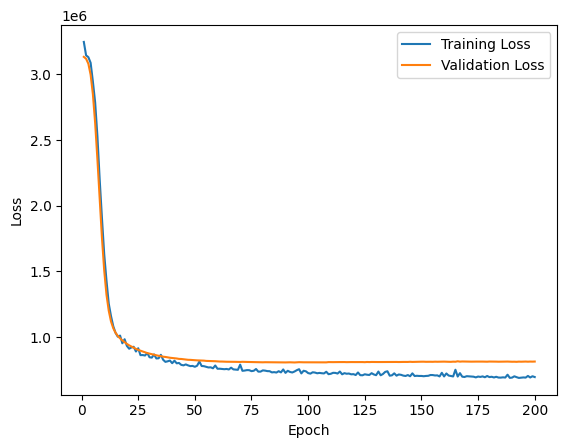

Average Loss: 815140.7023, Average MAE: 658.8367


In [ ]:
# smaller network with fc1=10 and fc2=32
small_1032 = RegressionNN(input_size, 10, 32, output_size)
# Call train_and_validate function
trained_model_1032, training_losses_1032, validation_losses_1032 = train_and_validate(
   model=small_1032, train_loader=train_loader,test_loader=test_loader,
   learning_rate=learning_rate, epochs=epochs
)
# Average Loss and MAE
average_loss, average_mae = evaluate_model(small_1032, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

Epoch [1/200], MSE Loss (Train): 3173484.822, MAE Loss (Train): 1515.795
Validation Loss: 3133318.212, Validation MAE: 1499.633
Epoch [2/200], MSE Loss (Train): 3153527.353, MAE Loss (Train): 1511.659
Validation Loss: 3127148.423, Validation MAE: 1497.776
Epoch [3/200], MSE Loss (Train): 3165338.841, MAE Loss (Train): 1514.579
Validation Loss: 3118403.692, Validation MAE: 1495.156
Epoch [4/200], MSE Loss (Train): 3174610.731, MAE Loss (Train): 1511.394
Validation Loss: 3105362.827, Validation MAE: 1491.237
Epoch [5/200], MSE Loss (Train): 3155816.962, MAE Loss (Train): 1510.722
Validation Loss: 3086097.500, Validation MAE: 1485.350
Epoch [6/200], MSE Loss (Train): 3214623.519, MAE Loss (Train): 1516.635
Validation Loss: 3058171.385, Validation MAE: 1476.643
Epoch [7/200], MSE Loss (Train): 3107960.380, MAE Loss (Train): 1495.381
Validation Loss: 3019558.077, Validation MAE: 1464.380
Epoch [8/200], MSE Loss (Train): 3035328.327, MAE Loss (Train): 1475.531
Validation Loss: 2969482.577, V

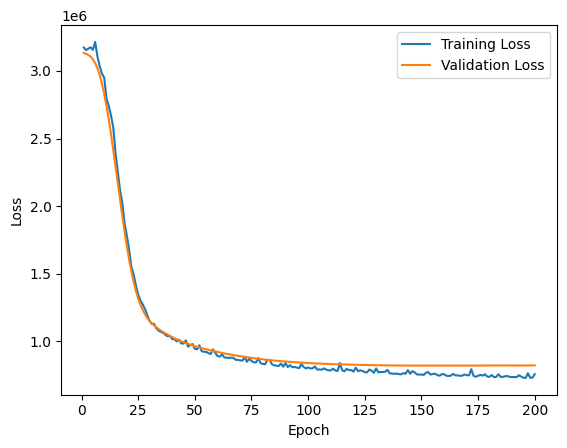

Average Loss: 823995.6465, Average MAE: 647.2140


In [ ]:
# smaller network with fc1=10 and fc2=5
small_105 = RegressionNN(input_size, 10, 5, output_size)
# Call train_and_validate function
trained_model_105, training_losses_105, validation_losses_105 = train_and_validate(
   model=small_105, train_loader=train_loader,test_loader=test_loader,
   learning_rate=learning_rate, epochs=epochs
)
# Average Loss and MAE
average_loss, average_mae = evaluate_model(small_105, test_loader, device)
print(f'Average Loss: {average_loss:.4f}, Average MAE: {average_mae:.4f}')

### Calculating the MSE and MAE losses

#### Original, Local, and Locally Compressed (PCA, SparsePCA, ICA) Pruned Models

In [ ]:
# checking local models that have 0.6 pruning amount
local1_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "Local Pruned": pruned_local1,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local1_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local1_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_local1_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_local1_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_local1_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_local1_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_local1_105,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_l1_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_l1_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_l1_10,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_l1_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_l1_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_l1_10,

}

results_local1 = {}

for name, model in local1_models.items():
    loss, mae = evaluate_model(model, test_loader, device)
    results_local1[name] = {"MSE Loss": loss, "MAE": mae}
    print(f"{name} - MSE Loss: {loss:.4f}, MAE: {mae:.4f}")

Original - MSE Loss: 839745.2437, MAE: 665.5272
Smaller Network - fc1_out = 50 and fc2_out = 30 - MSE Loss: 834117.5542, MAE: 661.9798
Smaller Network - fc1_out = 50 and fc2_out = 32 - MSE Loss: 833109.9506, MAE: 662.5665
Smaller Network - fc1_out = 50 and fc2_out = 10 - MSE Loss: 809478.0436, MAE: 650.0939
Smaller Network - fc1_out = 50 and fc2_out = 5 - MSE Loss: 800548.1035, MAE: 643.4436
Smaller Network - fc1_out = 30 and fc2_out = 32 - MSE Loss: 823324.9965, MAE: 655.5545
Smaller Network - fc1_out = 30 and fc2_out = 10 - MSE Loss: 801533.5384, MAE: 646.7047
Smaller Network - fc1_out = 30 and fc2_out = 5 - MSE Loss: 795675.1247, MAE: 639.6209
Smaller Network - fc1_out = 10 and fc2_out = 32 - MSE Loss: 815140.7023, MAE: 658.8367
Smaller Network - fc1_out = 10 and fc2_out = 5 - MSE Loss: 823995.6465, MAE: 647.2140
Local Pruned - MSE Loss: 3508478.1210, MAE: 1616.2023
PCA Local Compressed - fc1_out = 50 and fc2_out = 30 - MSE Loss: 835103.9181, MAE: 667.5661
PCA Local Compressed - fc1

In [ ]:
# checking local models that have 0.7 pruning amount
local2_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "Local Pruned": pruned_local2,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local2_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local2_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_local2_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_local2_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_local2_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_local2_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_local2_105,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_l2_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_l2_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_l2_10,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_l2_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_l2_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_l2_10,

}

results_local2 = {}

for name, model in local2_models.items():
    loss, mae = evaluate_model(model, test_loader, device)
    results_local2[name] = {"MSE Loss": loss, "MAE": mae}
    print(f"{name} - MSE Loss: {loss:.4f}, MAE: {mae:.4f}")

Original - MSE Loss: 811500.7557, MAE: 645.3410
Smaller Network - fc1_out = 50 and fc2_out = 30 - MSE Loss: 834117.5542, MAE: 661.9798
Smaller Network - fc1_out = 50 and fc2_out = 32 - MSE Loss: 833109.9506, MAE: 662.5665
Smaller Network - fc1_out = 50 and fc2_out = 10 - MSE Loss: 809478.0436, MAE: 650.0939
Smaller Network - fc1_out = 50 and fc2_out = 5 - MSE Loss: 800548.1035, MAE: 643.4436
Smaller Network - fc1_out = 30 and fc2_out = 32 - MSE Loss: 823324.9965, MAE: 655.5545
Smaller Network - fc1_out = 30 and fc2_out = 10 - MSE Loss: 801533.5384, MAE: 646.7047
Smaller Network - fc1_out = 30 and fc2_out = 5 - MSE Loss: 795675.1247, MAE: 639.6209
Smaller Network - fc1_out = 10 and fc2_out = 32 - MSE Loss: 815140.7023, MAE: 658.8367
Smaller Network - fc1_out = 10 and fc2_out = 5 - MSE Loss: 823995.6465, MAE: 647.2140
Local Pruned - MSE Loss: 3465965.0532, MAE: 1606.1927
PCA Local Compressed - fc1_out = 50 and fc2_out = 30 - MSE Loss: 830670.2998, MAE: 664.2486
PCA Local Compressed - fc1

In [ ]:
# checking local models that have 0.8 pruning amount
local3_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "Local Pruned": pruned_local3,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local3_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local3_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_local3_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_local3_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_local3_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_local3_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_local3_105,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_l3_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_l3_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_l3_10,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_l3_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_l3_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_l3_10,

}

results_local3 = {}

for name, model in local3_models.items():
    loss, mae = evaluate_model(model, test_loader, device)
    results_local3[name] = {"MSE Loss": loss, "MAE": mae}
    print(f"{name} - MSE Loss: {loss:.4f}, MAE: {mae:.4f}")

Original - MSE Loss: 827814.8397, MAE: 653.2763
Smaller Network - fc1_out = 50 and fc2_out = 30 - MSE Loss: 834117.5542, MAE: 661.9798
Smaller Network - fc1_out = 50 and fc2_out = 32 - MSE Loss: 833109.9506, MAE: 662.5665
Smaller Network - fc1_out = 50 and fc2_out = 10 - MSE Loss: 809478.0436, MAE: 650.0939
Smaller Network - fc1_out = 50 and fc2_out = 5 - MSE Loss: 800548.1035, MAE: 643.4436
Smaller Network - fc1_out = 30 and fc2_out = 32 - MSE Loss: 823324.9965, MAE: 655.5545
Smaller Network - fc1_out = 30 and fc2_out = 10 - MSE Loss: 801533.5384, MAE: 646.7047
Smaller Network - fc1_out = 30 and fc2_out = 5 - MSE Loss: 795675.1247, MAE: 639.6209
Smaller Network - fc1_out = 10 and fc2_out = 32 - MSE Loss: 815140.7023, MAE: 658.8367
Smaller Network - fc1_out = 10 and fc2_out = 5 - MSE Loss: 823995.6465, MAE: 647.2140
Local Pruned - MSE Loss: 3266987.1693, MAE: 1544.2545
PCA Local Compressed - fc1_out = 50 and fc2_out = 30 - MSE Loss: 836992.1661, MAE: 660.3567
PCA Local Compressed - fc1

In [ ]:
# checking local models that have 0.9 pruning amount
local4_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "Local Pruned": pruned_local4,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local4_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local4_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_local4_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_local4_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_local4_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_local4_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_local4_105,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_l4_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_l4_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_l4_10,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_l4_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_l4_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_l4_10,

}

results_local4 = {}

for name, model in local4_models.items():
    loss, mae = evaluate_model(model, test_loader, device)
    results_local4[name] = {"MSE Loss": loss, "MAE": mae}
    print(f"{name} - MSE Loss: {loss:.4f}, MAE: {mae:.4f}")

Original - MSE Loss: 811797.8914, MAE: 650.9886
Smaller Network - fc1_out = 50 and fc2_out = 30 - MSE Loss: 834117.5542, MAE: 661.9798
Smaller Network - fc1_out = 50 and fc2_out = 32 - MSE Loss: 833109.9506, MAE: 662.5665
Smaller Network - fc1_out = 50 and fc2_out = 10 - MSE Loss: 809478.0436, MAE: 650.0939
Smaller Network - fc1_out = 50 and fc2_out = 5 - MSE Loss: 800548.1035, MAE: 643.4436
Smaller Network - fc1_out = 30 and fc2_out = 32 - MSE Loss: 823324.9965, MAE: 655.5545
Smaller Network - fc1_out = 30 and fc2_out = 10 - MSE Loss: 801533.5384, MAE: 646.7047
Smaller Network - fc1_out = 30 and fc2_out = 5 - MSE Loss: 795675.1247, MAE: 639.6209
Smaller Network - fc1_out = 10 and fc2_out = 32 - MSE Loss: 815140.7023, MAE: 658.8367
Smaller Network - fc1_out = 10 and fc2_out = 5 - MSE Loss: 823995.6465, MAE: 647.2140
Local Pruned - MSE Loss: 3165287.9285, MAE: 1511.0070
PCA Local Compressed - fc1_out = 50 and fc2_out = 30 - MSE Loss: 813788.2314, MAE: 654.2664
PCA Local Compressed - fc1

In [ ]:
# checking local models that have 0.95 pruning amount
local5_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "Local Pruned": pruned_local5,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local5_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local5_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_local5_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_local5_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_local5_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_local5_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_local5_105,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_l5_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_l5_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_l5_10,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_l5_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_l5_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_l5_10,

}

results_local5 = {}

for name, model in local5_models.items():
    loss, mae = evaluate_model(model, test_loader, device)
    results_local5[name] = {"MSE Loss": loss, "MAE": mae}
    print(f"{name} - MSE Loss: {loss:.4f}, MAE: {mae:.4f}")

Original - MSE Loss: 817061.9714, MAE: 648.6185
Smaller Network - fc1_out = 50 and fc2_out = 30 - MSE Loss: 834117.5542, MAE: 661.9798
Smaller Network - fc1_out = 50 and fc2_out = 32 - MSE Loss: 833109.9506, MAE: 662.5665
Smaller Network - fc1_out = 50 and fc2_out = 10 - MSE Loss: 809478.0436, MAE: 650.0939
Smaller Network - fc1_out = 50 and fc2_out = 5 - MSE Loss: 800548.1035, MAE: 643.4436
Smaller Network - fc1_out = 30 and fc2_out = 32 - MSE Loss: 823324.9965, MAE: 655.5545
Smaller Network - fc1_out = 30 and fc2_out = 10 - MSE Loss: 801533.5384, MAE: 646.7047
Smaller Network - fc1_out = 30 and fc2_out = 5 - MSE Loss: 795675.1247, MAE: 639.6209
Smaller Network - fc1_out = 10 and fc2_out = 32 - MSE Loss: 815140.7023, MAE: 658.8367
Smaller Network - fc1_out = 10 and fc2_out = 5 - MSE Loss: 823995.6465, MAE: 647.2140
Local Pruned - MSE Loss: 3134090.7622, MAE: 1499.8779
PCA Local Compressed - fc1_out = 50 and fc2_out = 30 - MSE Loss: 815573.9296, MAE: 651.2248
PCA Local Compressed - fc1

#### Original, Local, and Layer-wise Locally Compressed (PCA, SparsePCA, ICA) Pruned Models

In [ ]:
# checking layer-wise pruned models that have 0.6 pruning amount
sparse1_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "Local Pruned": pruned_sparse1,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse1_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse1_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_sparse1_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_sparse1_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_sparse1_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_sparse1_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_sparse1_105,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_sparse1_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_sparse1_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_sparse1_10,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_sparse1_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_sparse1_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_sparse1_10,

}

results_sparse1 = {}

for name, model in sparse1_models.items():
    loss, mae = evaluate_model(model, test_loader, device)
    results_sparse1[name] = {"MSE Loss": loss, "MAE": mae}
    print(f"{name} - MSE Loss: {loss:.4f}, MAE: {mae:.4f}")

Original - MSE Loss: 816931.1252, MAE: 646.1590
Smaller Network - fc1_out = 50 and fc2_out = 30 - MSE Loss: 834117.5542, MAE: 661.9798
Smaller Network - fc1_out = 50 and fc2_out = 32 - MSE Loss: 833109.9506, MAE: 662.5665
Smaller Network - fc1_out = 50 and fc2_out = 10 - MSE Loss: 809478.0436, MAE: 650.0939
Smaller Network - fc1_out = 50 and fc2_out = 5 - MSE Loss: 800548.1035, MAE: 643.4436
Smaller Network - fc1_out = 30 and fc2_out = 32 - MSE Loss: 823324.9965, MAE: 655.5545
Smaller Network - fc1_out = 30 and fc2_out = 10 - MSE Loss: 801533.5384, MAE: 646.7047
Smaller Network - fc1_out = 30 and fc2_out = 5 - MSE Loss: 795675.1247, MAE: 639.6209
Smaller Network - fc1_out = 10 and fc2_out = 32 - MSE Loss: 815140.7023, MAE: 658.8367
Smaller Network - fc1_out = 10 and fc2_out = 5 - MSE Loss: 823995.6465, MAE: 647.2140
Local Pruned - MSE Loss: 1248424.5981, MAE: 736.4736
PCA Local Compressed - fc1_out = 50 and fc2_out = 30 - MSE Loss: 823945.6192, MAE: 659.5999
PCA Local Compressed - fc1_

In [ ]:
# checking layer-wise pruned models that have 0.6 pruning amount
sparse2_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "Local Pruned": pruned_sparse2,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse2_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse2_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_sparse2_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_sparse2_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_sparse2_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_sparse2_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_sparse2_105,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_sparse2_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_sparse2_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_sparse2_10,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_sparse2_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_sparse2_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_sparse2_10,

}

results_sparse2 = {}

for name, model in sparse2_models.items():
    loss, mae = evaluate_model(model, test_loader, device)
    results_sparse2[name] = {"MSE Loss": loss, "MAE": mae}
    print(f"{name} - MSE Loss: {loss:.4f}, MAE: {mae:.4f}")

Original - MSE Loss: 826699.7835, MAE: 655.4428
Smaller Network - fc1_out = 50 and fc2_out = 30 - MSE Loss: 834117.5542, MAE: 661.9798
Smaller Network - fc1_out = 50 and fc2_out = 32 - MSE Loss: 833109.9506, MAE: 662.5665
Smaller Network - fc1_out = 50 and fc2_out = 10 - MSE Loss: 809478.0436, MAE: 650.0939
Smaller Network - fc1_out = 50 and fc2_out = 5 - MSE Loss: 800548.1035, MAE: 643.4436
Smaller Network - fc1_out = 30 and fc2_out = 32 - MSE Loss: 823324.9965, MAE: 655.5545
Smaller Network - fc1_out = 30 and fc2_out = 10 - MSE Loss: 801533.5384, MAE: 646.7047
Smaller Network - fc1_out = 30 and fc2_out = 5 - MSE Loss: 795675.1247, MAE: 639.6209
Smaller Network - fc1_out = 10 and fc2_out = 32 - MSE Loss: 815140.7023, MAE: 658.8367
Smaller Network - fc1_out = 10 and fc2_out = 5 - MSE Loss: 823995.6465, MAE: 647.2140
Local Pruned - MSE Loss: 1332383.8368, MAE: 769.9311
PCA Local Compressed - fc1_out = 50 and fc2_out = 30 - MSE Loss: 831503.5746, MAE: 661.8058
PCA Local Compressed - fc1_

In [ ]:
# checking layer-wise pruned models that have 0.7 pruning amount
sparse2_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "Local Pruned": pruned_sparse2,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse2_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse2_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_sparse2_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_sparse2_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_sparse2_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_sparse2_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_sparse2_105,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_sparse2_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_sparse2_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_sparse2_10,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_sparse2_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_sparse2_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_sparse2_10,

}

results_sparse2 = {}

for name, model in sparse2_models.items():
    loss, mae = evaluate_model(model, test_loader, device)
    results_sparse2[name] = {"MSE Loss": loss, "MAE": mae}
    print(f"{name} - MSE Loss: {loss:.4f}, MAE: {mae:.4f}")

Original - MSE Loss: 817280.7670, MAE: 645.5904
Smaller Network - fc1_out = 50 and fc2_out = 30 - MSE Loss: 834117.5542, MAE: 661.9798
Smaller Network - fc1_out = 50 and fc2_out = 32 - MSE Loss: 833109.9506, MAE: 662.5665
Smaller Network - fc1_out = 50 and fc2_out = 10 - MSE Loss: 809478.0436, MAE: 650.0939
Smaller Network - fc1_out = 50 and fc2_out = 5 - MSE Loss: 800548.1035, MAE: 643.4436
Smaller Network - fc1_out = 30 and fc2_out = 32 - MSE Loss: 823324.9965, MAE: 655.5545
Smaller Network - fc1_out = 30 and fc2_out = 10 - MSE Loss: 801533.5384, MAE: 646.7047
Smaller Network - fc1_out = 30 and fc2_out = 5 - MSE Loss: 795675.1247, MAE: 639.6209
Smaller Network - fc1_out = 10 and fc2_out = 32 - MSE Loss: 815140.7023, MAE: 658.8367
Smaller Network - fc1_out = 10 and fc2_out = 5 - MSE Loss: 823995.6465, MAE: 647.2140
Local Pruned - MSE Loss: 1332383.8368, MAE: 769.9311
PCA Local Compressed - fc1_out = 50 and fc2_out = 30 - MSE Loss: 831503.5746, MAE: 661.8058
PCA Local Compressed - fc1_

In [ ]:
# checking layer-wise pruned models that have 0.8 pruning amount
sparse3_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "Local Pruned": pruned_sparse3,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse3_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse3_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_sparse3_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_sparse3_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_sparse3_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_sparse3_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_sparse3_105,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_sparse3_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_sparse3_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_sparse3_10,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_sparse3_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_sparse3_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_sparse3_10,

}

results_sparse3 = {}

for name, model in sparse3_models.items():
    loss, mae = evaluate_model(model, test_loader, device)
    results_sparse3[name] = {"MSE Loss": loss, "MAE": mae}
    print(f"{name} - MSE Loss: {loss:.4f}, MAE: {mae:.4f}")

Original - MSE Loss: 817280.7670, MAE: 645.5904
Smaller Network - fc1_out = 50 and fc2_out = 30 - MSE Loss: 834117.5542, MAE: 661.9798
Smaller Network - fc1_out = 50 and fc2_out = 32 - MSE Loss: 833109.9506, MAE: 662.5665
Smaller Network - fc1_out = 50 and fc2_out = 10 - MSE Loss: 809478.0436, MAE: 650.0939
Smaller Network - fc1_out = 50 and fc2_out = 5 - MSE Loss: 800548.1035, MAE: 643.4436
Smaller Network - fc1_out = 30 and fc2_out = 32 - MSE Loss: 823324.9965, MAE: 655.5545
Smaller Network - fc1_out = 30 and fc2_out = 10 - MSE Loss: 801533.5384, MAE: 646.7047
Smaller Network - fc1_out = 30 and fc2_out = 5 - MSE Loss: 795675.1247, MAE: 639.6209
Smaller Network - fc1_out = 10 and fc2_out = 32 - MSE Loss: 815140.7023, MAE: 658.8367
Smaller Network - fc1_out = 10 and fc2_out = 5 - MSE Loss: 823995.6465, MAE: 647.2140
Local Pruned - MSE Loss: 1661803.9963, MAE: 924.6325
PCA Local Compressed - fc1_out = 50 and fc2_out = 30 - MSE Loss: 849239.1403, MAE: 669.6081
PCA Local Compressed - fc1_

In [ ]:
# checking layer-wise pruned models that have 0.9 pruning amount
sparse4_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "Local Pruned": pruned_sparse4,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse4_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse4_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_sparse4_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_sparse4_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_sparse4_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_sparse4_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_sparse4_105,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_sparse4_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_sparse4_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_sparse4_10,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_sparse4_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_sparse4_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_sparse4_10,

}

results_sparse4 = {}

for name, model in sparse4_models.items():
    loss, mae = evaluate_model(model, test_loader, device)
    results_sparse4[name] = {"MSE Loss": loss, "MAE": mae}
    print(f"{name} - MSE Loss: {loss:.4f}, MAE: {mae:.4f}")

Original - MSE Loss: 818642.8849, MAE: 652.8796
Smaller Network - fc1_out = 50 and fc2_out = 30 - MSE Loss: 834117.5542, MAE: 661.9798
Smaller Network - fc1_out = 50 and fc2_out = 32 - MSE Loss: 833109.9506, MAE: 662.5665
Smaller Network - fc1_out = 50 and fc2_out = 10 - MSE Loss: 809478.0436, MAE: 650.0939
Smaller Network - fc1_out = 50 and fc2_out = 5 - MSE Loss: 800548.1035, MAE: 643.4436
Smaller Network - fc1_out = 30 and fc2_out = 32 - MSE Loss: 823324.9965, MAE: 655.5545
Smaller Network - fc1_out = 30 and fc2_out = 10 - MSE Loss: 801533.5384, MAE: 646.7047
Smaller Network - fc1_out = 30 and fc2_out = 5 - MSE Loss: 795675.1247, MAE: 639.6209
Smaller Network - fc1_out = 10 and fc2_out = 32 - MSE Loss: 815140.7023, MAE: 658.8367
Smaller Network - fc1_out = 10 and fc2_out = 5 - MSE Loss: 823995.6465, MAE: 647.2140
Local Pruned - MSE Loss: 1737679.2958, MAE: 957.7866
PCA Local Compressed - fc1_out = 50 and fc2_out = 30 - MSE Loss: 847238.7720, MAE: 670.1492
PCA Local Compressed - fc1_

In [ ]:
# checking layer-wise pruned models that have 0.95 pruning amount
sparse5_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "Local Pruned": pruned_sparse5,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse5_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse5_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_sparse5_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_sparse5_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_sparse5_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_sparse5_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_sparse5_105,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_sparse5_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_sparse5_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_sparse5_10,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_sparse5_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_sparse5_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_sparse5_10,

}

results_sparse5 = {}

for name, model in sparse5_models.items():
    loss, mae = evaluate_model(model, test_loader, device)
    results_sparse5[name] = {"MSE Loss": loss, "MAE": mae}
    print(f"{name} - MSE Loss: {loss:.4f}, MAE: {mae:.4f}")

Original - MSE Loss: 821658.7845, MAE: 649.9354
Smaller Network - fc1_out = 50 and fc2_out = 30 - MSE Loss: 834117.5542, MAE: 661.9798
Smaller Network - fc1_out = 50 and fc2_out = 32 - MSE Loss: 833109.9506, MAE: 662.5665
Smaller Network - fc1_out = 50 and fc2_out = 10 - MSE Loss: 809478.0436, MAE: 650.0939
Smaller Network - fc1_out = 50 and fc2_out = 5 - MSE Loss: 800548.1035, MAE: 643.4436
Smaller Network - fc1_out = 30 and fc2_out = 32 - MSE Loss: 823324.9965, MAE: 655.5545
Smaller Network - fc1_out = 30 and fc2_out = 10 - MSE Loss: 801533.5384, MAE: 646.7047
Smaller Network - fc1_out = 30 and fc2_out = 5 - MSE Loss: 795675.1247, MAE: 639.6209
Smaller Network - fc1_out = 10 and fc2_out = 32 - MSE Loss: 815140.7023, MAE: 658.8367
Smaller Network - fc1_out = 10 and fc2_out = 5 - MSE Loss: 823995.6465, MAE: 647.2140
Local Pruned - MSE Loss: 1886206.3282, MAE: 1026.0071
PCA Local Compressed - fc1_out = 50 and fc2_out = 30 - MSE Loss: 853291.9639, MAE: 677.6382
PCA Local Compressed - fc1

### Weight Distribution in each Layer of the Models

#### Inspecting the Weight Distribution of the Original and Pruned Models

In [ ]:
# list of local and pruned models (without PCA, SparsePCA, and ICA)
local_pruneList = {
    "Original": model,
    "Local Pruned - 0.60": pruned_local1,
    "Local Pruned - 0.70": pruned_local2,
    "Local Pruned - 0.80": pruned_local3,
    "Local Pruned - 0.90": pruned_local4,
    "Local Pruned - 0.95": pruned_local5,

}

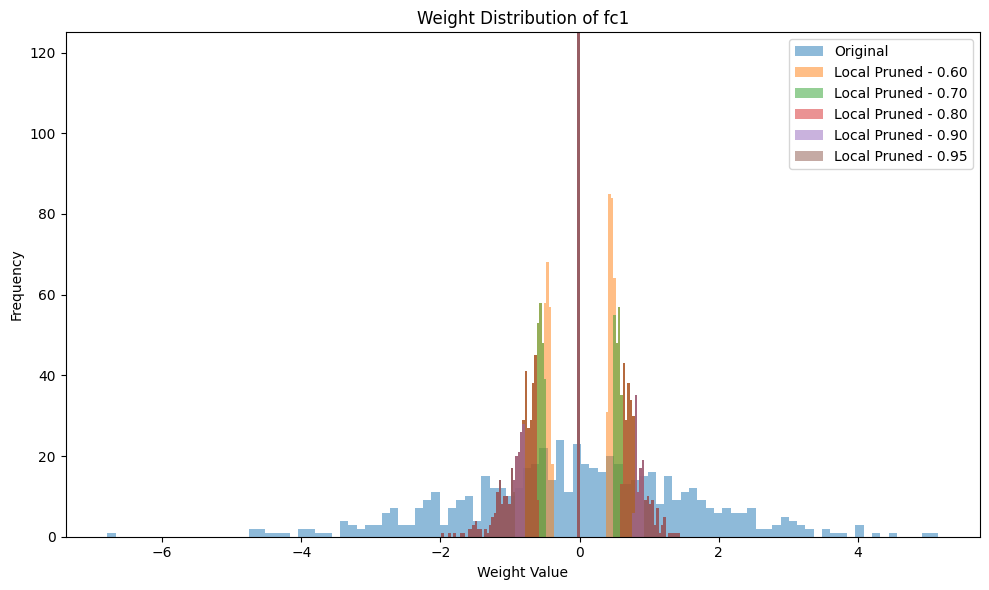

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in local_pruneList.items():
      # reference: https://stackoverflow.com/questions/44938160/saving-layer-weights-at-each-epoch-during-training-into-a-numpy-type-array-conv
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=125)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(local_pruneList.keys())

plt.tight_layout()
plt.show()

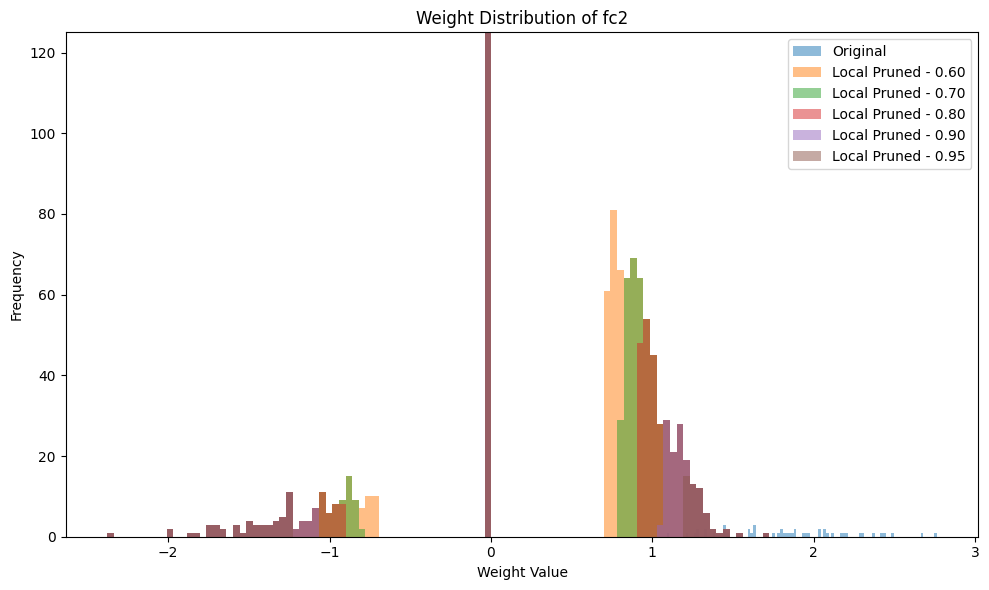

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in local_pruneList.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=125)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(local_pruneList.keys())

plt.tight_layout()
plt.show()

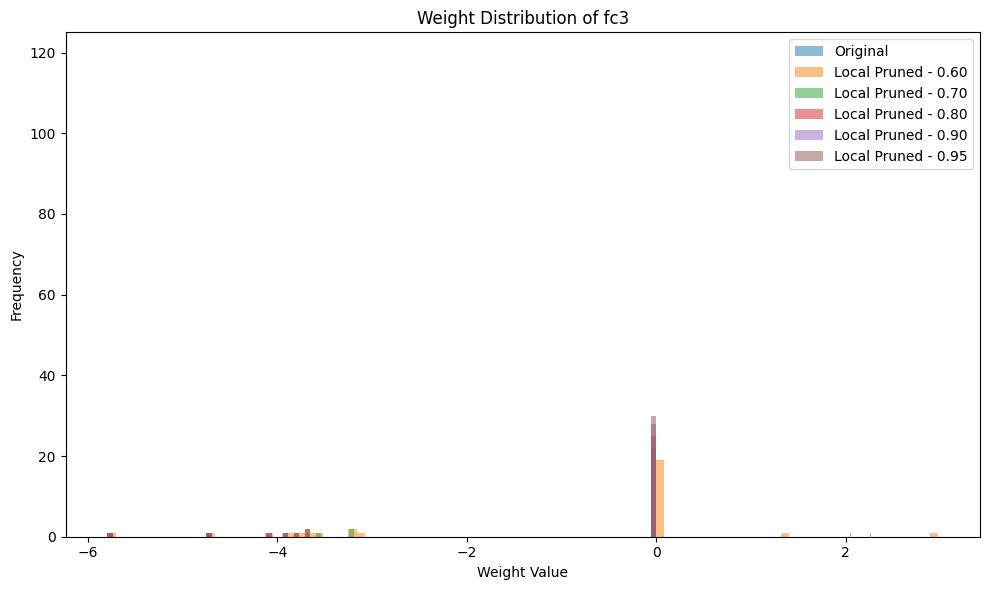

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in local_pruneList.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=125)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(local_pruneList.keys())

plt.tight_layout()
plt.show()

#### Inspecting the Weight Distribution of the Original and Smaller Models

In [ ]:
# list of local and pruned models (without PCA, SparsePCA, and ICA)
OG_small_list = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,

}

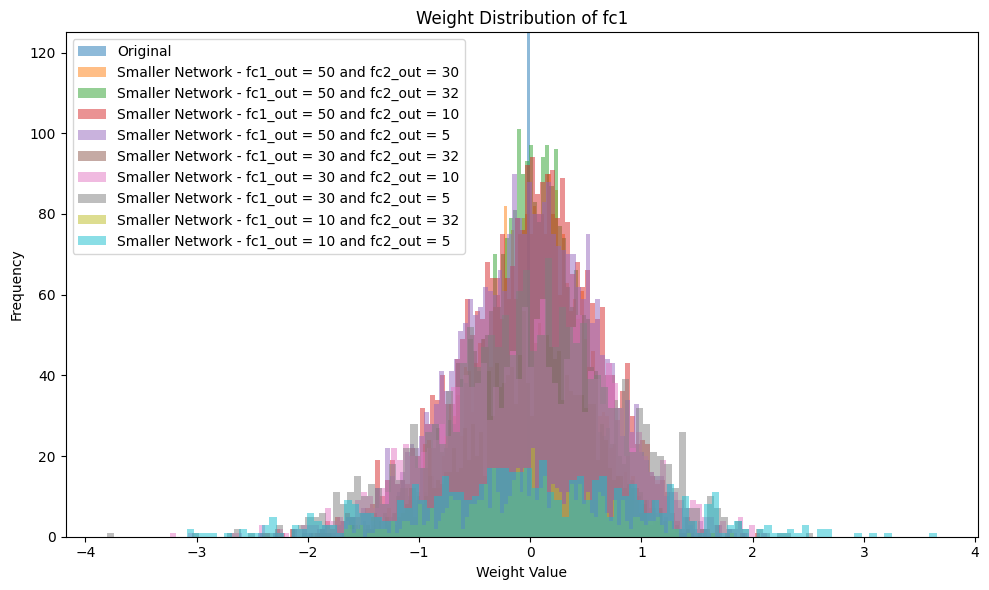

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in OG_small_list.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=125)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(OG_small_list.keys())

plt.tight_layout()
plt.show()

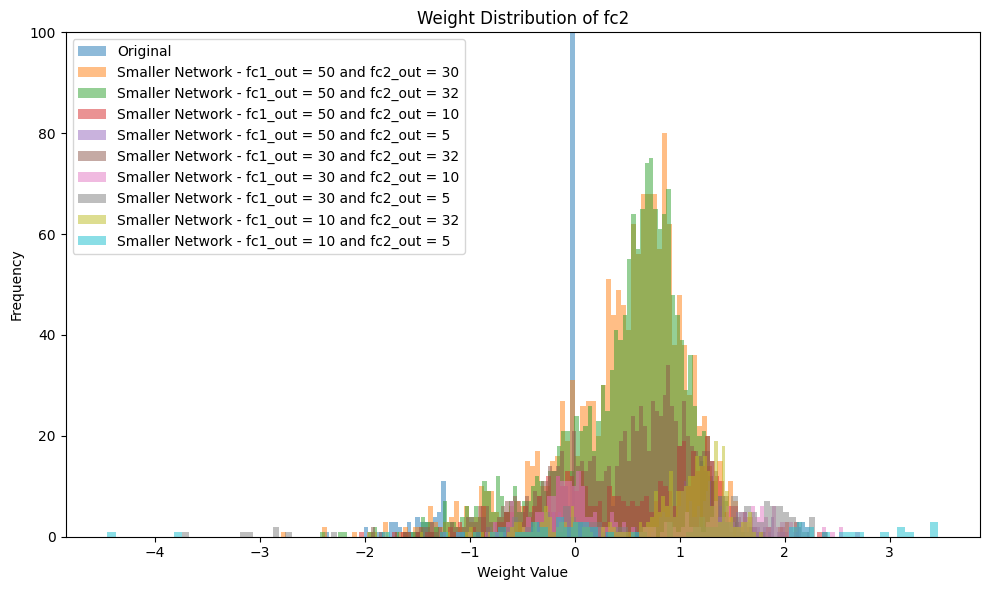

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in OG_small_list.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(OG_small_list.keys())

plt.tight_layout()
plt.show()

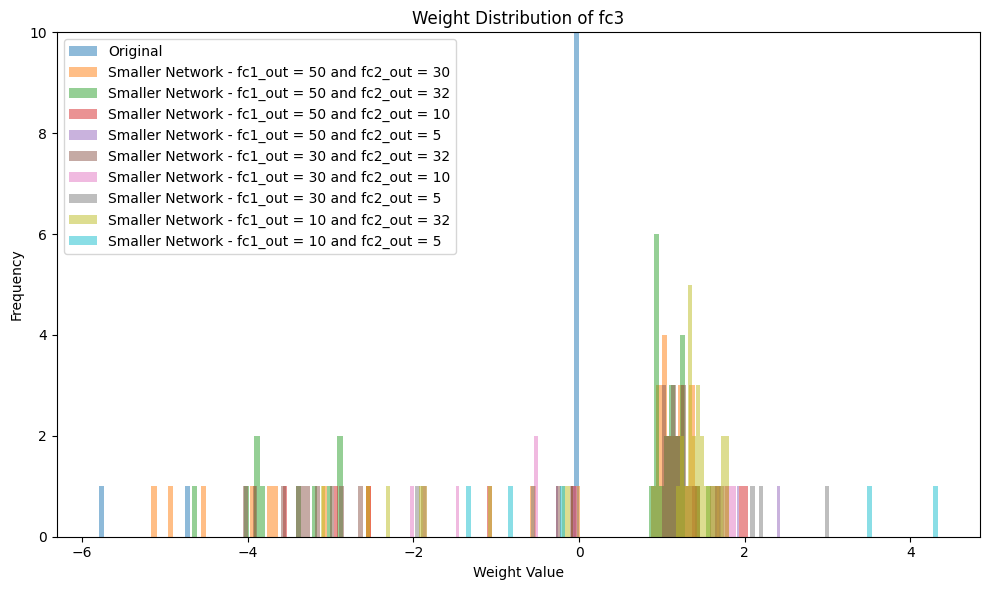

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in OG_small_list.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=10)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(OG_small_list.keys())

plt.tight_layout()
plt.show()

#### Inspecting the Weight Distribution of the PCA Pruned Models

##### PCA on Locally Pruned Models

###### Pruning Amount = 0.6

In [ ]:
# list of PCA local models
PCA_pruneList = {
    "Original": model,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local1_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local1_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_local1_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_local1_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_local1_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_local1_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_local1_105

}

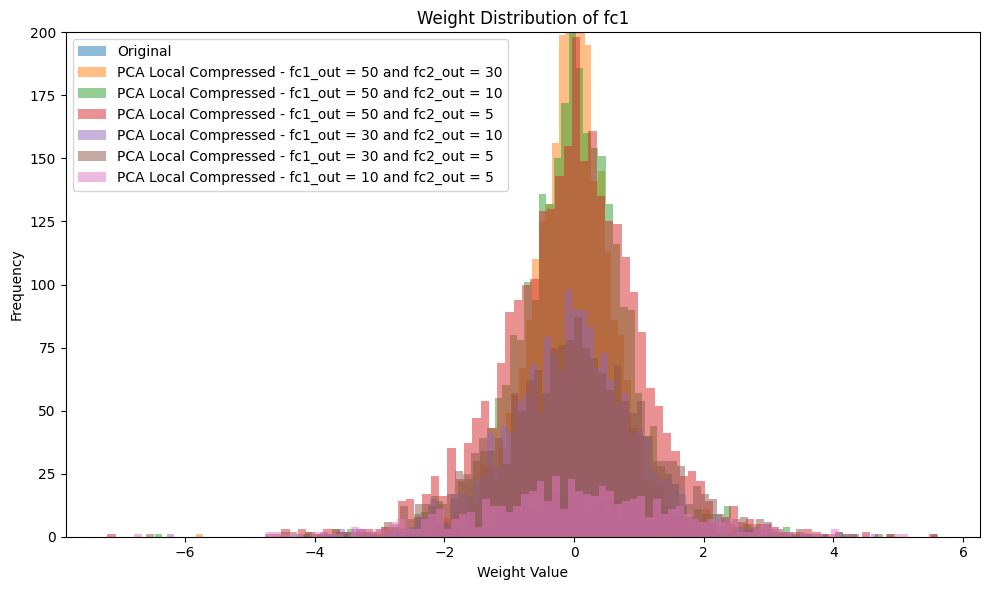

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_pruneList.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=200)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_pruneList.keys())

plt.tight_layout()
plt.show()

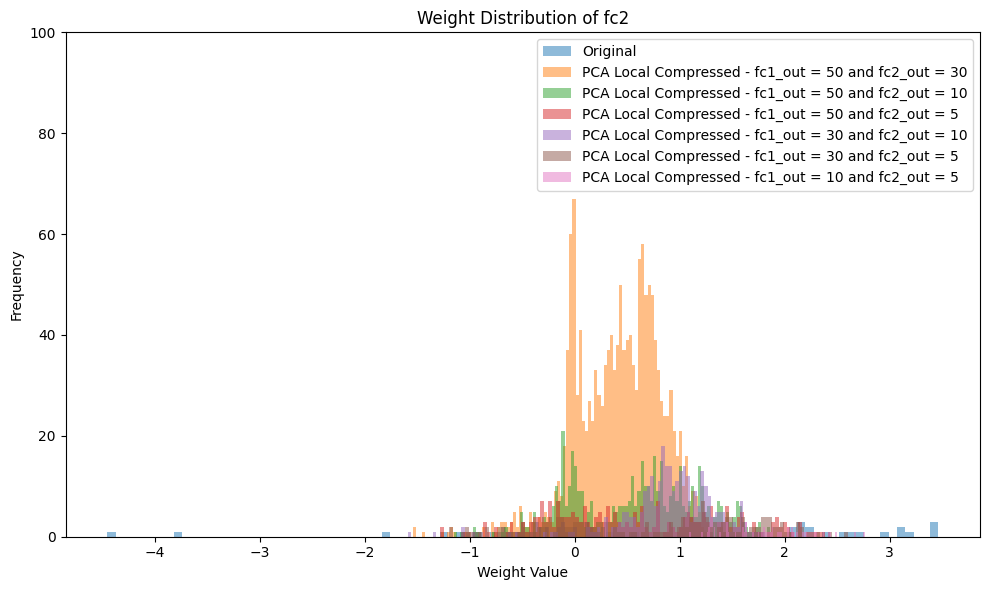

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_pruneList.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_pruneList.keys())

plt.tight_layout()
plt.show()

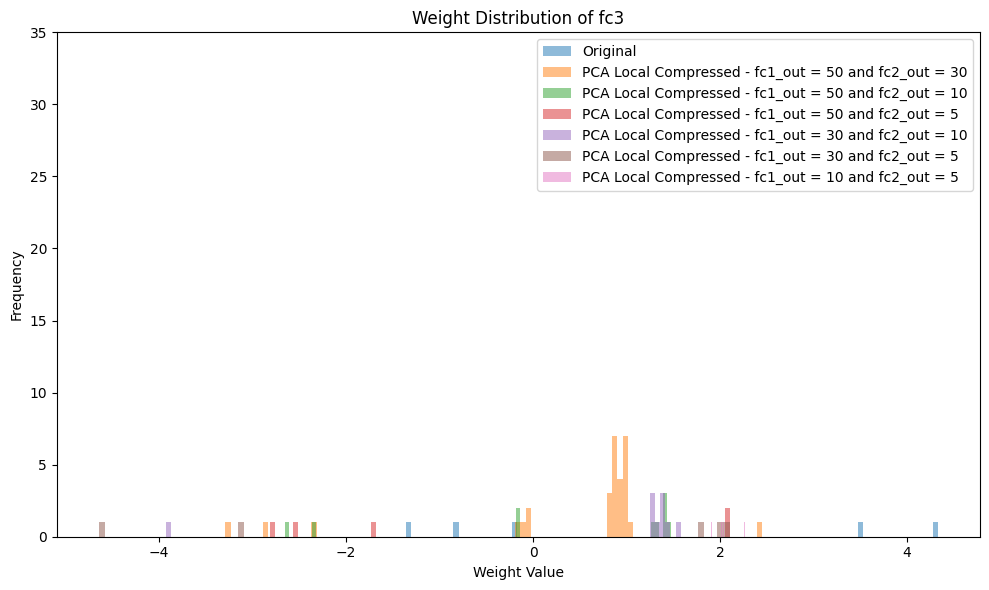

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_pruneList.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=35)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_pruneList.keys())

plt.tight_layout()
plt.show()

###### Pruning Amount = 0.7

In [ ]:
# list of PCA local models
PCA_pruneList2 = {
    "Original": model,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local2_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local2_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_local2_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_local2_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_local2_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_local2_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_local2_105

}

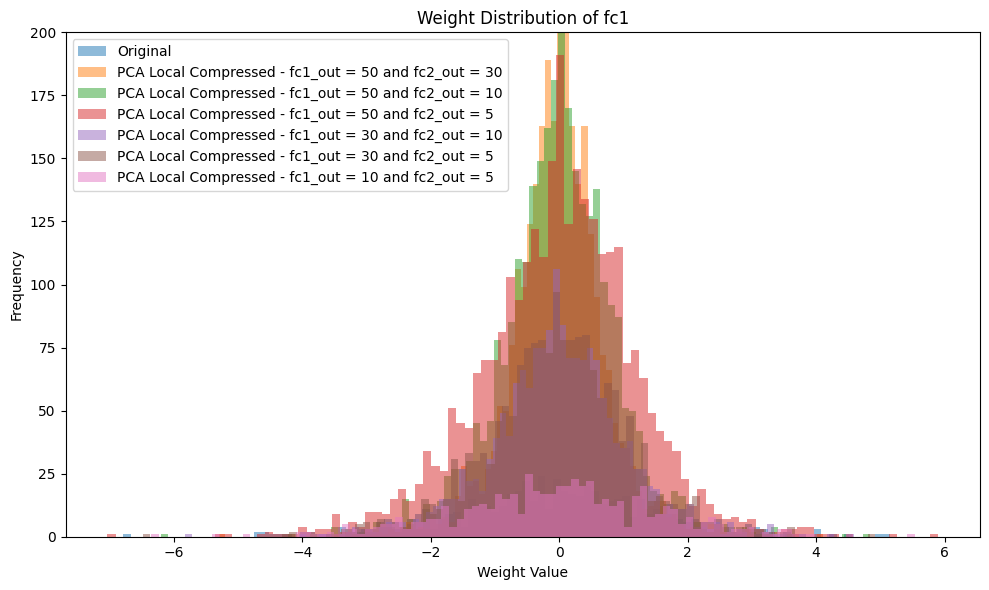

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_pruneList2.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=200)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_pruneList2.keys())

plt.tight_layout()
plt.show()

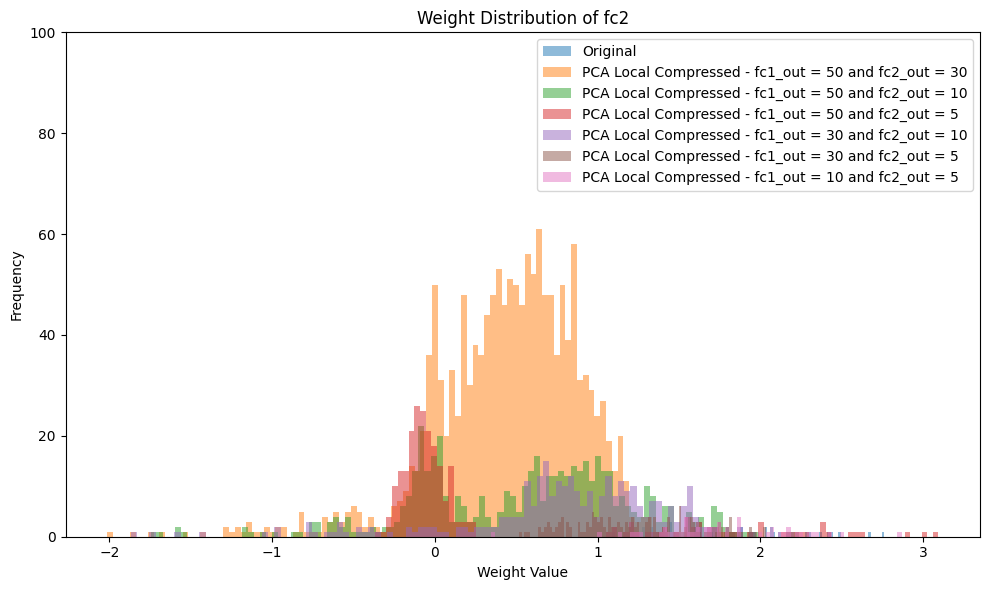

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_pruneList2.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_pruneList2.keys())

plt.tight_layout()
plt.show()

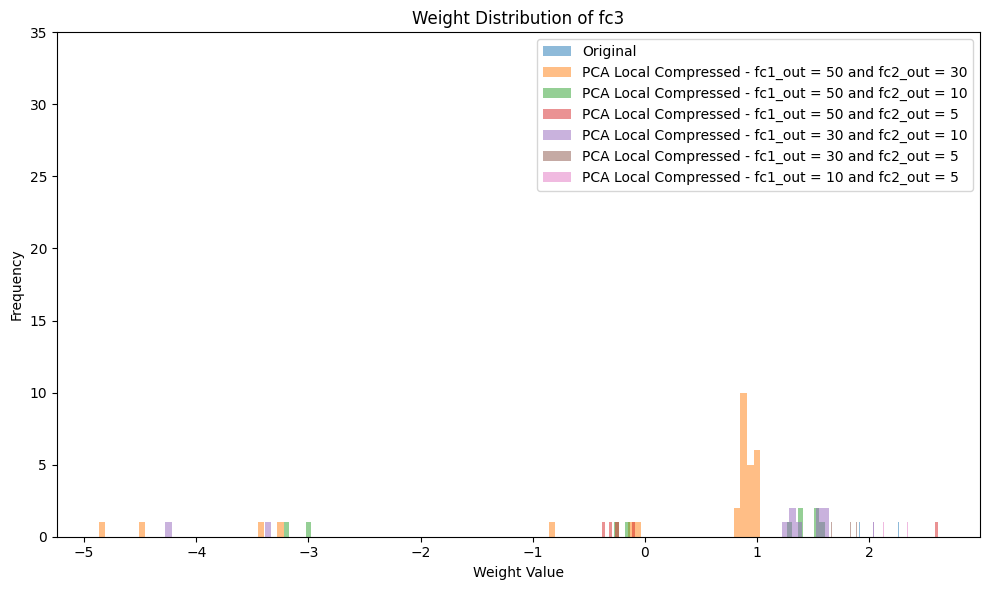

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_pruneList2.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=35)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_pruneList2.keys())

plt.tight_layout()
plt.show()

###### Pruning Amount = 0.8

In [ ]:
# list of PCA local models
PCA_pruneList3 = {
    "Original": model,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local3_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local3_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_local3_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_local3_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_local3_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_local3_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_local3_105

}

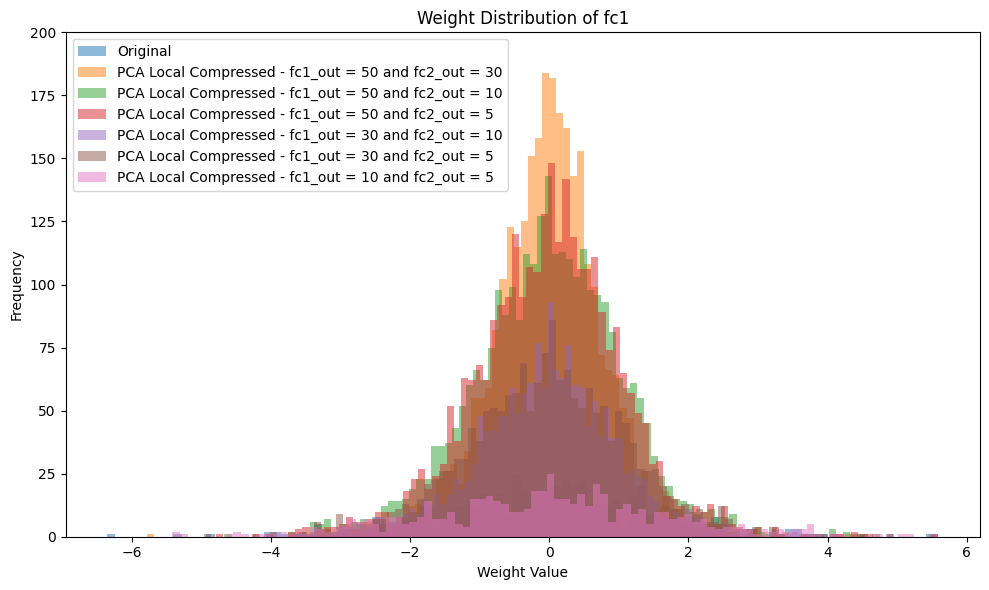

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_pruneList3.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=200)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_pruneList3.keys())

plt.tight_layout()
plt.show()

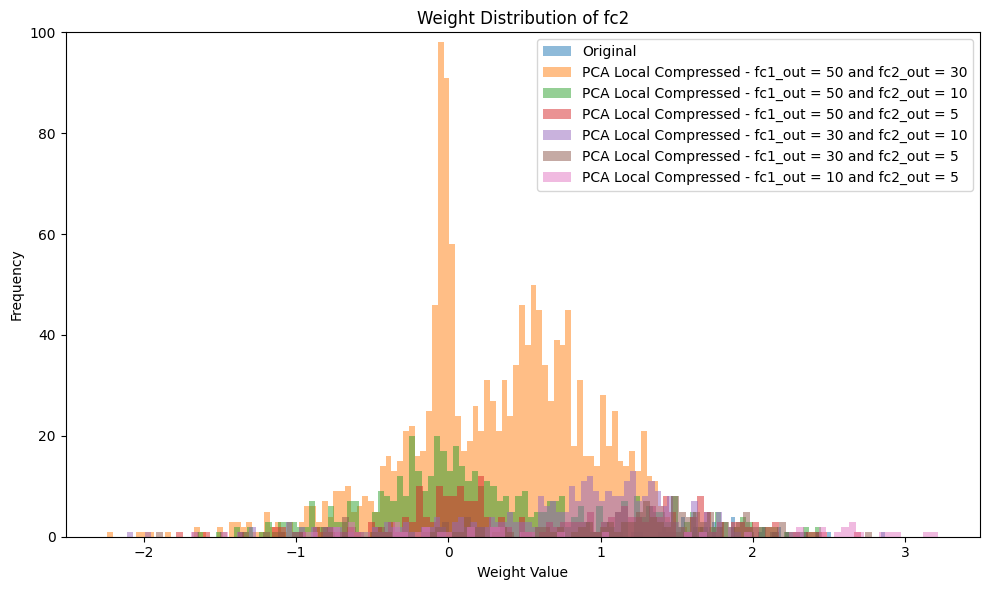

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_pruneList3.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_pruneList3.keys())

plt.tight_layout()
plt.show()

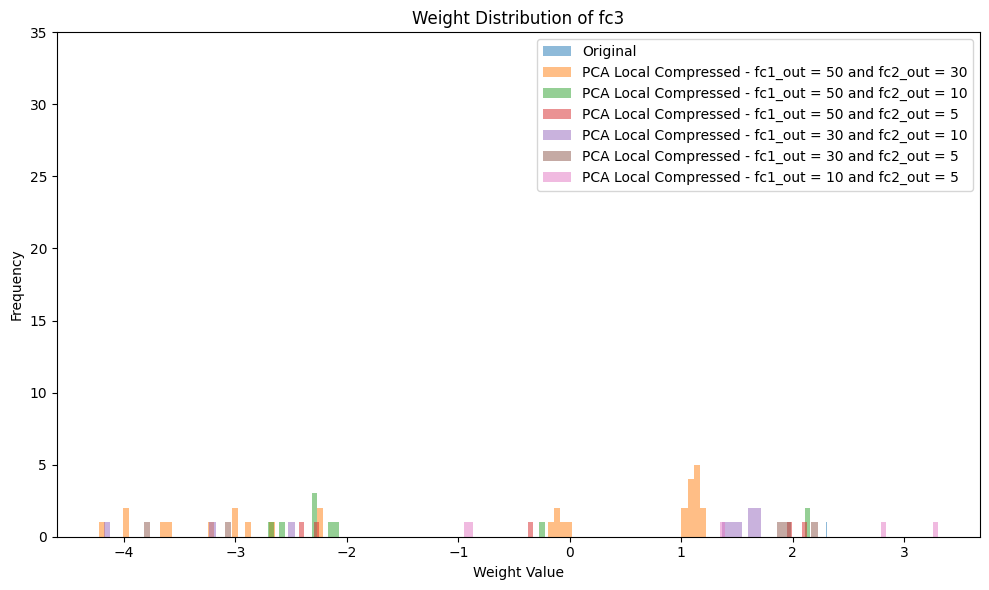

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_pruneList3.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=35)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_pruneList3.keys())

plt.tight_layout()
plt.show()

###### Pruning Amount = 0.9

In [ ]:
# list of PCA local models
PCA_pruneList4 = {
    "Original": model,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local4_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local4_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_local4_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_local4_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_local4_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_local4_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_local4_105

}

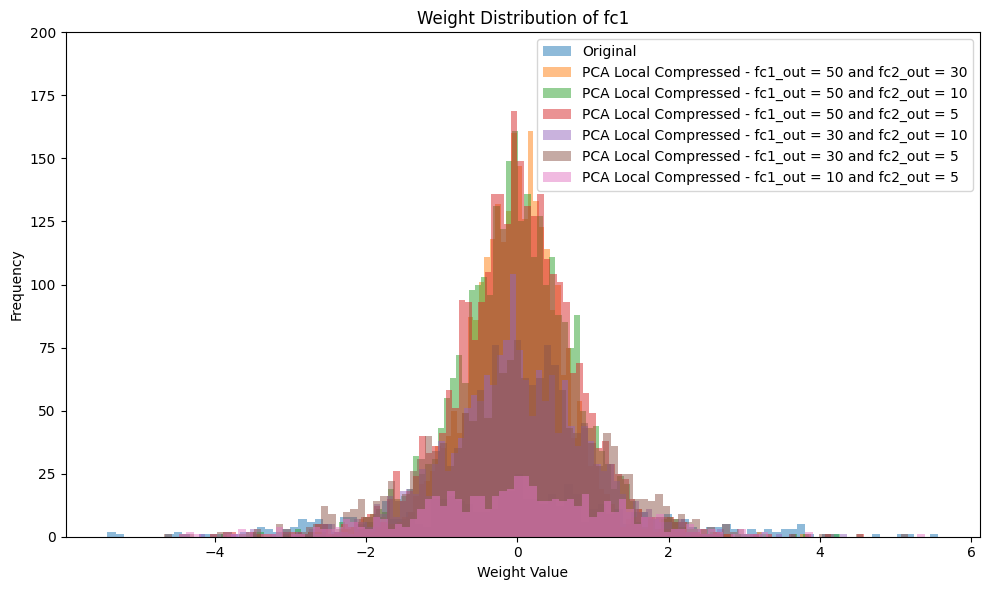

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_pruneList4.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=200)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_pruneList4.keys())

plt.tight_layout()
plt.show()

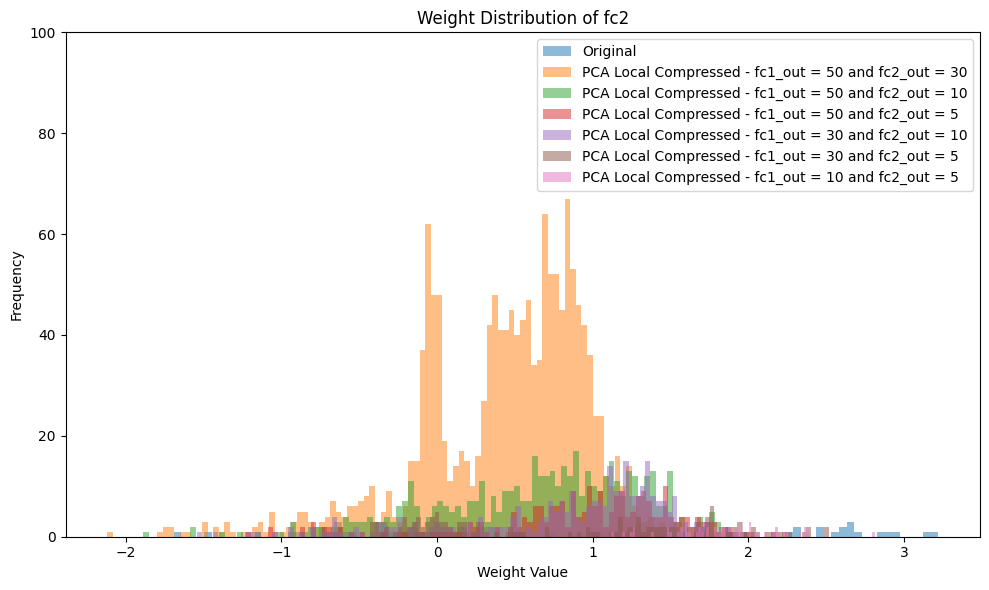

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_pruneList4.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_pruneList4.keys())

plt.tight_layout()
plt.show()

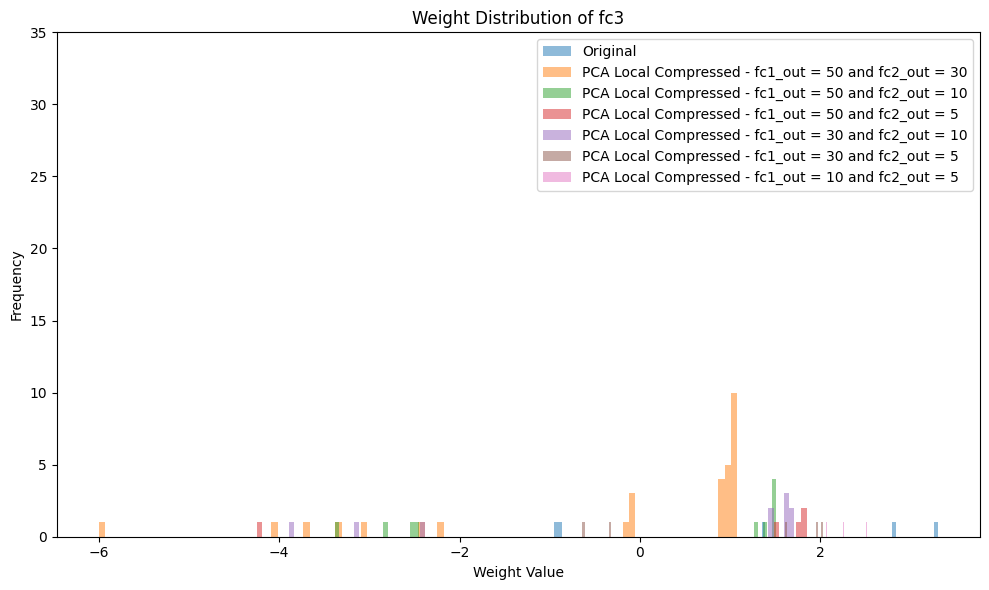

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_pruneList4.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=35)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_pruneList4.keys())

plt.tight_layout()
plt.show()

###### Pruning Amount = 0.95

In [ ]:
# list of PCA local models
PCA_pruneList5 = {
    "Original": model,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local5_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local5_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_local5_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_local5_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_local5_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_local5_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_local5_105

}

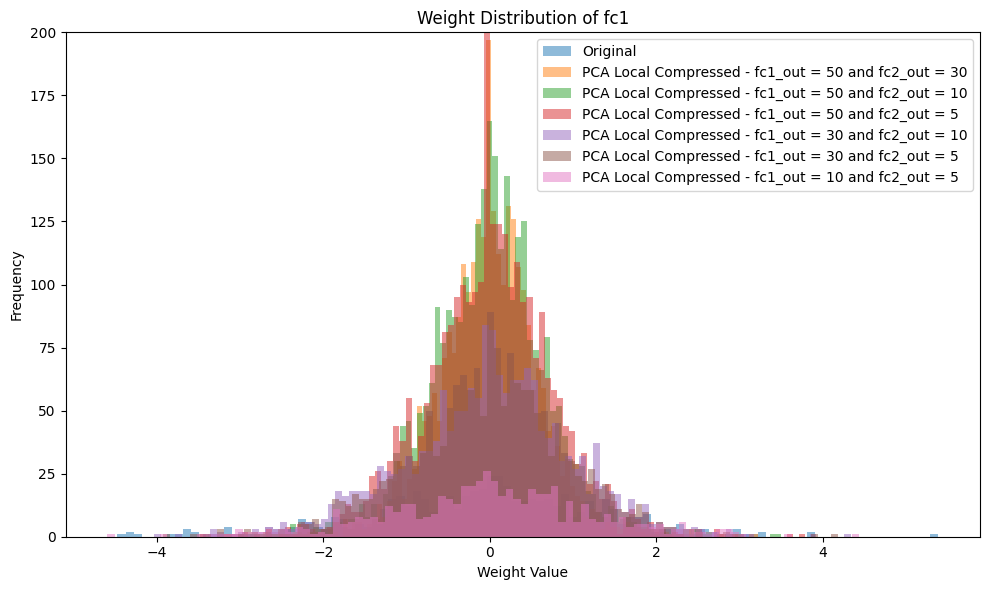

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_pruneList5.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=200)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_pruneList5.keys())

plt.tight_layout()
plt.show()

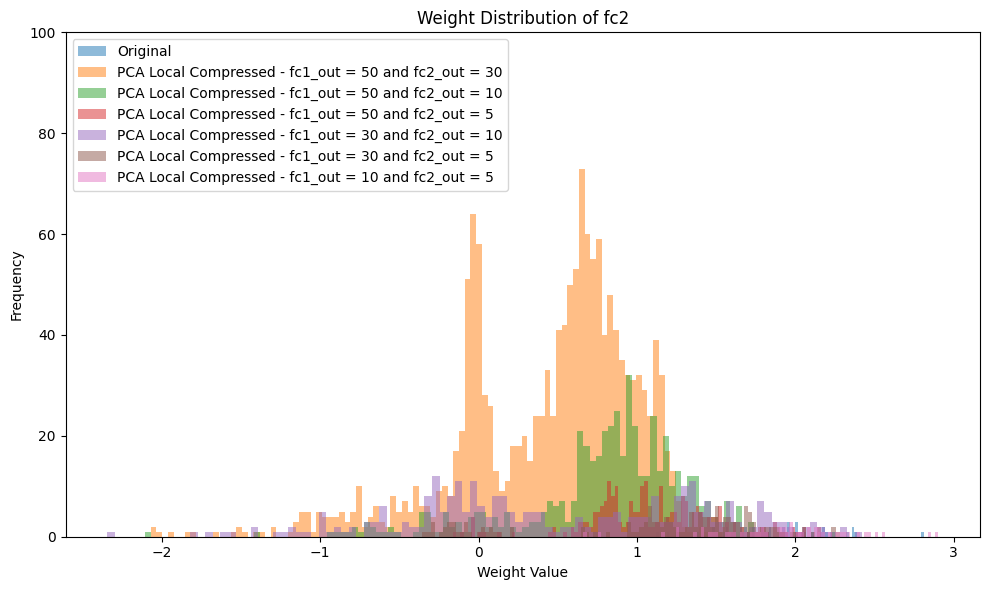

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_pruneList5.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_pruneList5.keys())

plt.tight_layout()
plt.show()

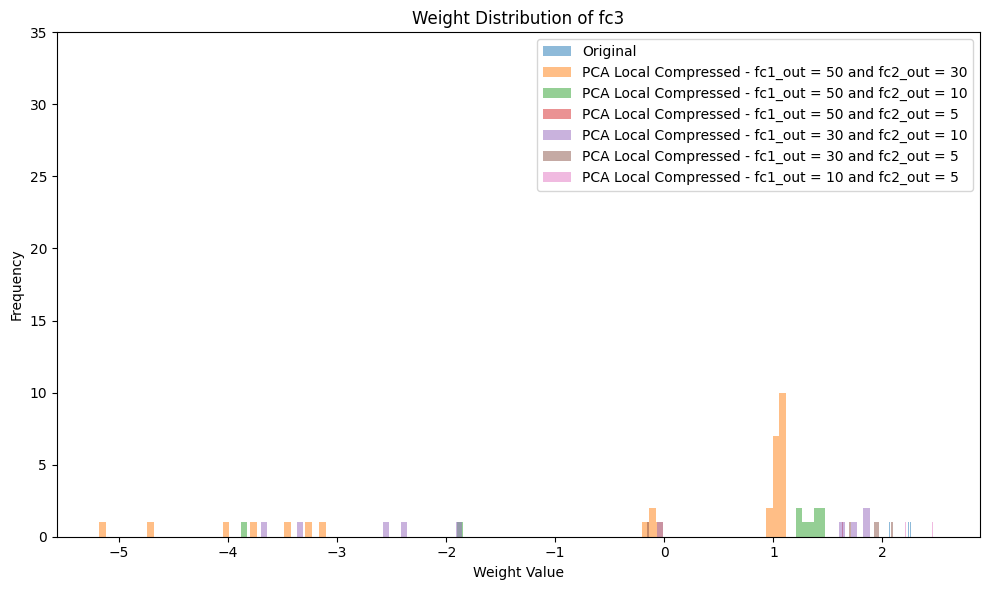

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_pruneList5.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=35)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_pruneList5.keys())

plt.tight_layout()
plt.show()

##### PCA on Layer-wise Locally Pruned Models

###### Pruning Amount = 0.6

In [ ]:
# list of PCA local models
PCA_layerwiseList = {
    "Original": model,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse1_5030,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse1_5030,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 10": PCA_sparse1_5010,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 5": PCA_sparse1_505,
    "PCA Layer-Wise Compressed - fc1_out = 30 and fc2_out = 10": PCA_sparse1_3010,
    "PCA Layer-Wise Compressed - fc1_out = 30 and fc2_out = 5": PCA_sparse1_305,
    "PCA Layer-Wise Compressed - fc1_out = 10 and fc2_out = 5": PCA_sparse1_105
}

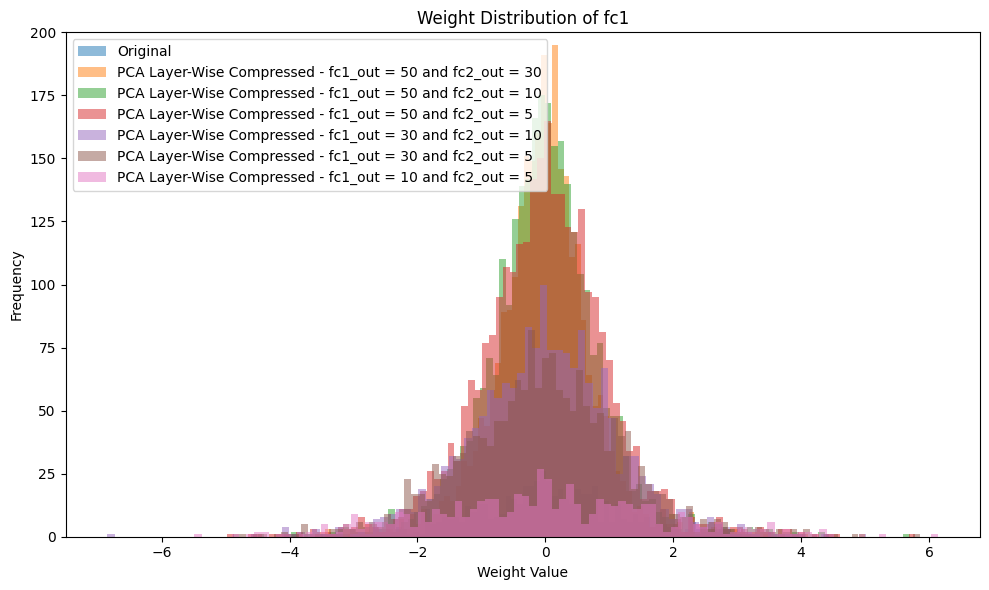

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_layerwiseList.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=200)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_layerwiseList.keys())

plt.tight_layout()
plt.show()

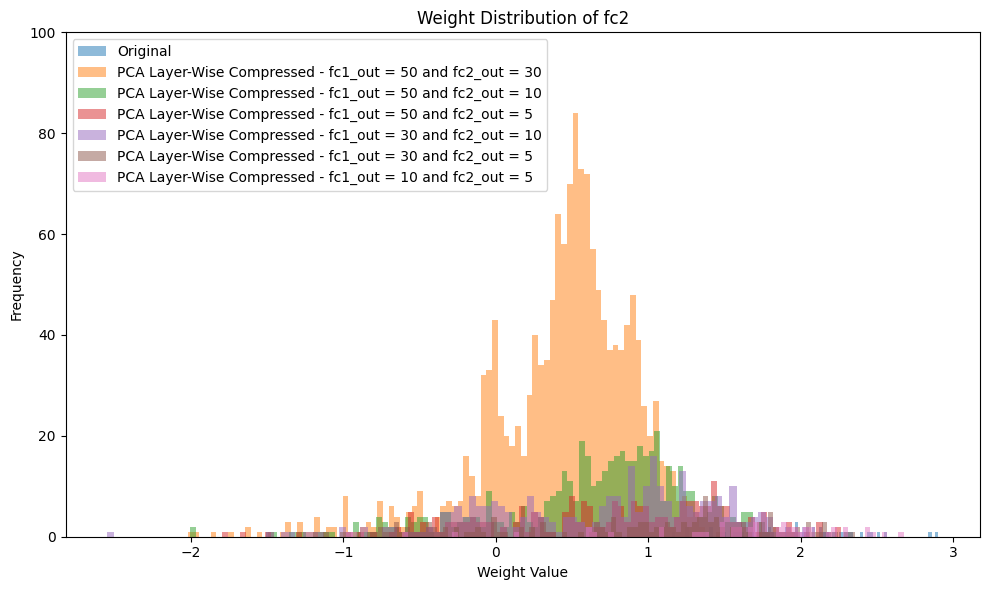

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_layerwiseList.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_layerwiseList.keys())

plt.tight_layout()
plt.show()

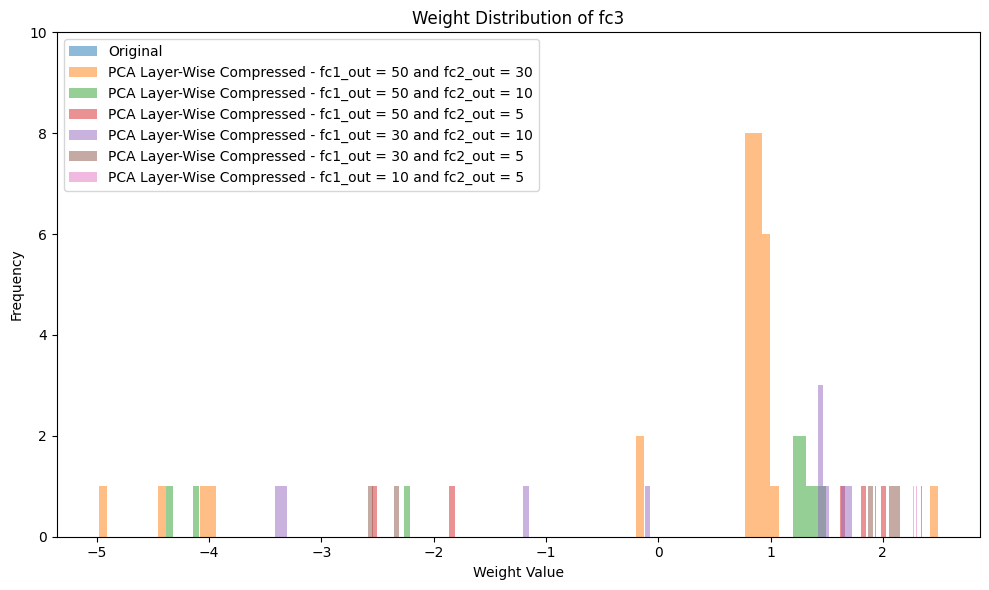

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_layerwiseList.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=10)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_layerwiseList.keys())

plt.tight_layout()
plt.show()

###### Pruning Amount = 0.7

In [ ]:
# list of PCA local models
PCA_layerwiseList2 = {
    "Original": model,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse2_5030,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse2_5030,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 10": PCA_sparse2_5010,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 5": PCA_sparse2_505,
    "PCA Layer-Wise Compressed - fc1_out = 30 and fc2_out = 10": PCA_sparse2_3010,
    "PCA Layer-Wise Compressed - fc1_out = 30 and fc2_out = 5": PCA_sparse2_305,
    "PCA Layer-Wise Compressed - fc1_out = 10 and fc2_out = 5": PCA_sparse2_105
}

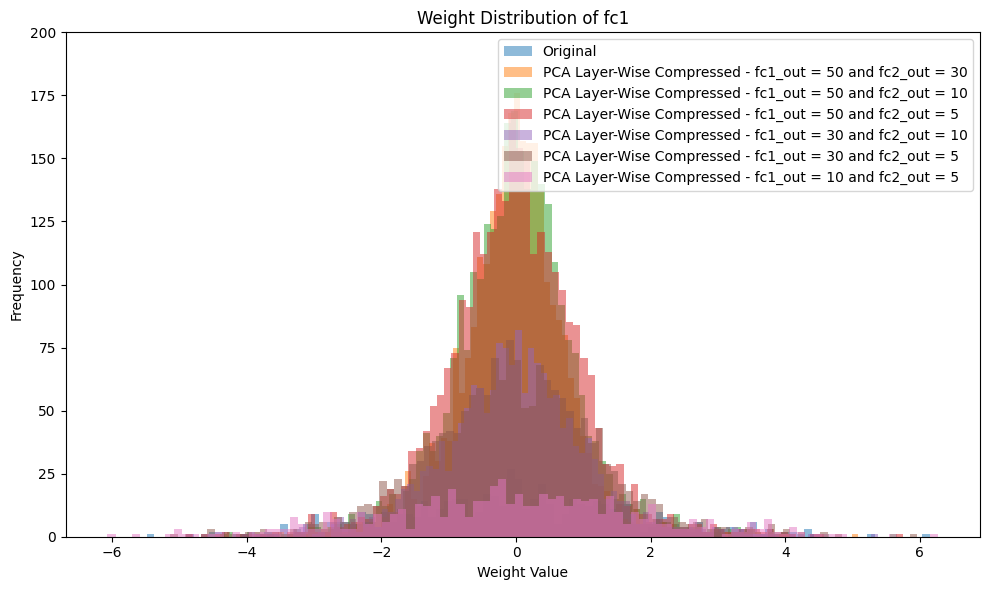

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_layerwiseList2.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=200)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_layerwiseList2.keys())

plt.tight_layout()
plt.show()

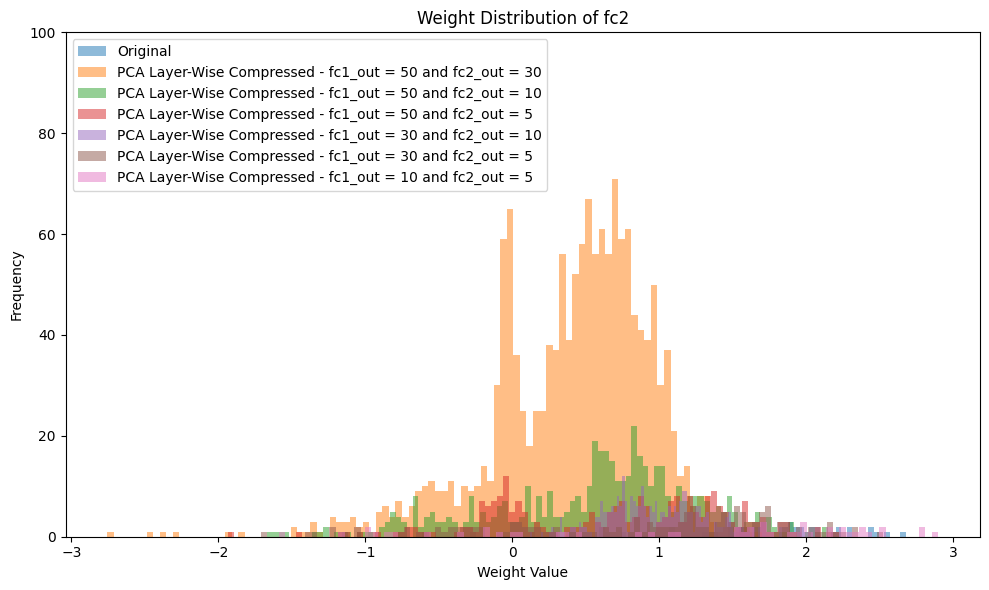

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_layerwiseList2.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_layerwiseList2.keys())

plt.tight_layout()
plt.show()

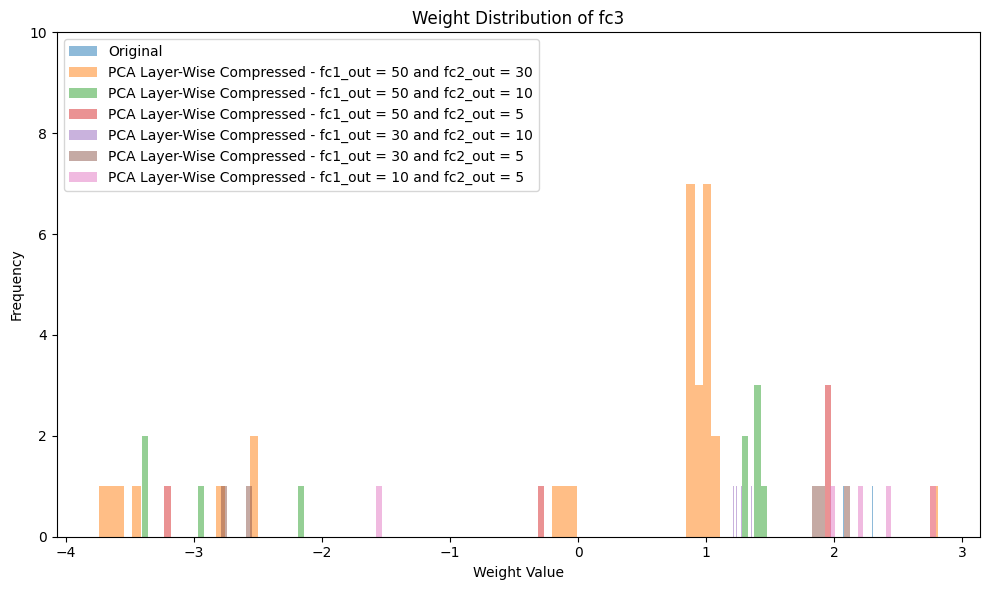

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_layerwiseList2.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=10)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_layerwiseList2.keys())

plt.tight_layout()
plt.show()

###### Pruning Amount = 0.8

In [ ]:
# list of PCA local models
PCA_layerwiseList3 = {
    "Original": model,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse3_5030,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse3_5030,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 10": PCA_sparse3_5010,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 5": PCA_sparse3_505,
    "PCA Layer-Wise Compressed - fc1_out = 30 and fc2_out = 10": PCA_sparse3_3010,
    "PCA Layer-Wise Compressed - fc1_out = 30 and fc2_out = 5": PCA_sparse3_305,
    "PCA Layer-Wise Compressed - fc1_out = 10 and fc2_out = 5": PCA_sparse3_105
}

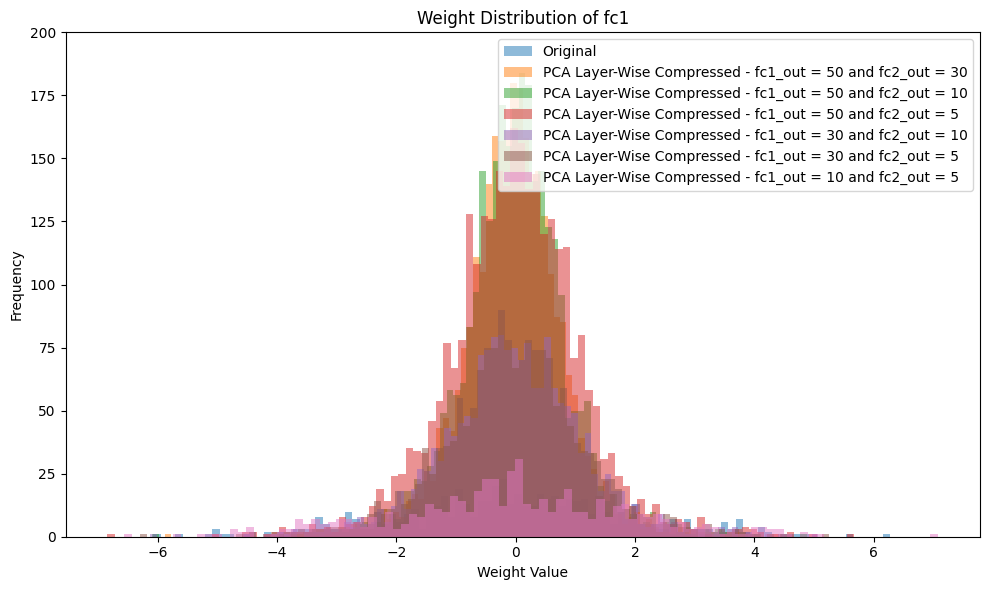

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_layerwiseList3.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=200)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_layerwiseList3.keys())

plt.tight_layout()
plt.show()

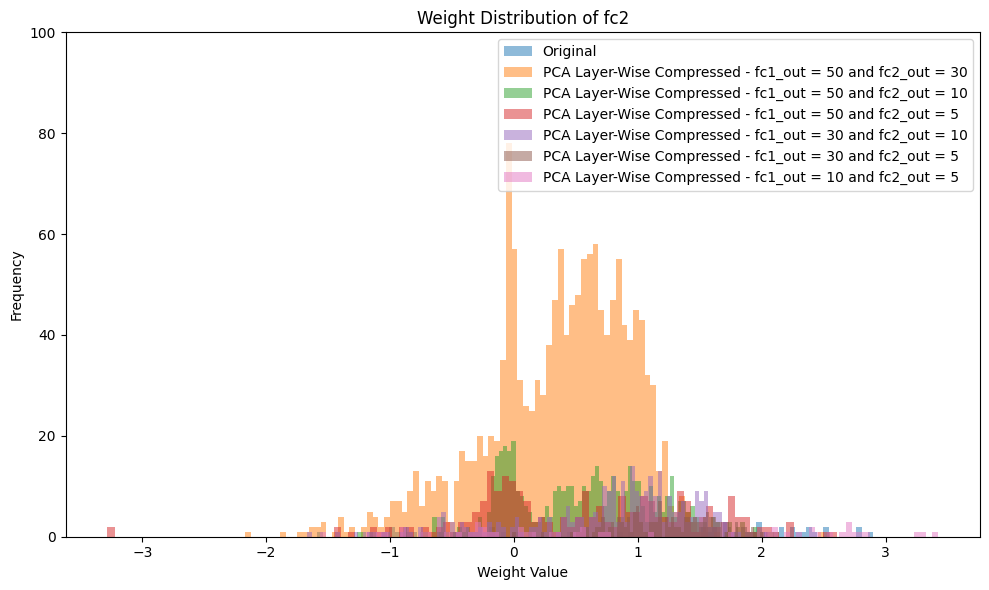

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_layerwiseList3.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_layerwiseList3.keys())

plt.tight_layout()
plt.show()

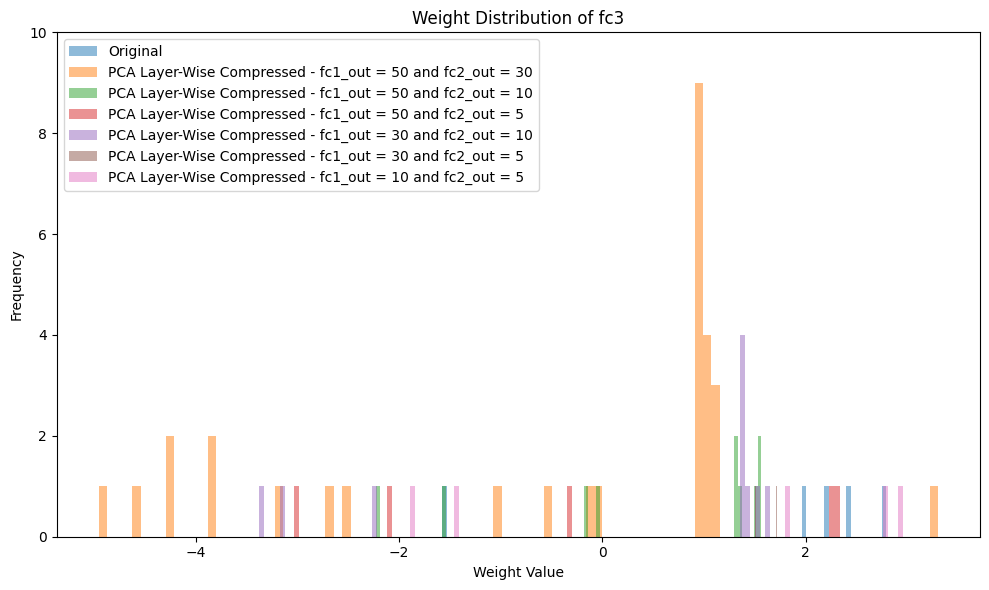

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_layerwiseList3.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=10)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_layerwiseList3.keys())

plt.tight_layout()
plt.show()

###### Pruning Amount = 0.9

In [ ]:
# list of PCA local models
PCA_layerwiseList4 = {
    "Original": model,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse4_5030,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse4_5030,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 10": PCA_sparse4_5010,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 5": PCA_sparse4_505,
    "PCA Layer-Wise Compressed - fc1_out = 30 and fc2_out = 10": PCA_sparse4_3010,
    "PCA Layer-Wise Compressed - fc1_out = 30 and fc2_out = 5": PCA_sparse4_305,
    "PCA Layer-Wise Compressed - fc1_out = 10 and fc2_out = 5": PCA_sparse4_105
}

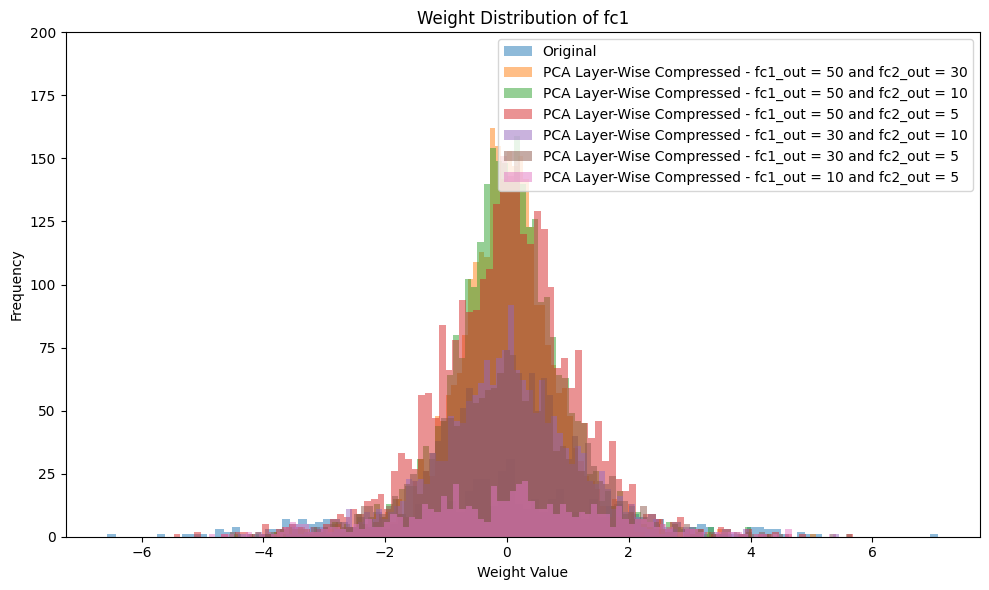

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_layerwiseList4.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=200)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_layerwiseList4.keys())

plt.tight_layout()
plt.show()

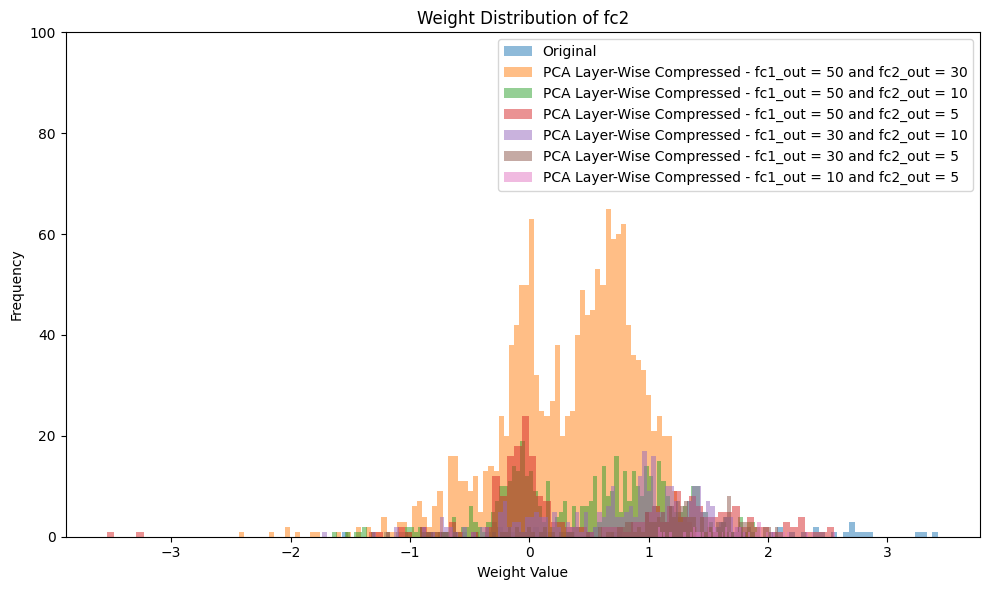

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_layerwiseList4.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_layerwiseList4.keys())

plt.tight_layout()
plt.show()

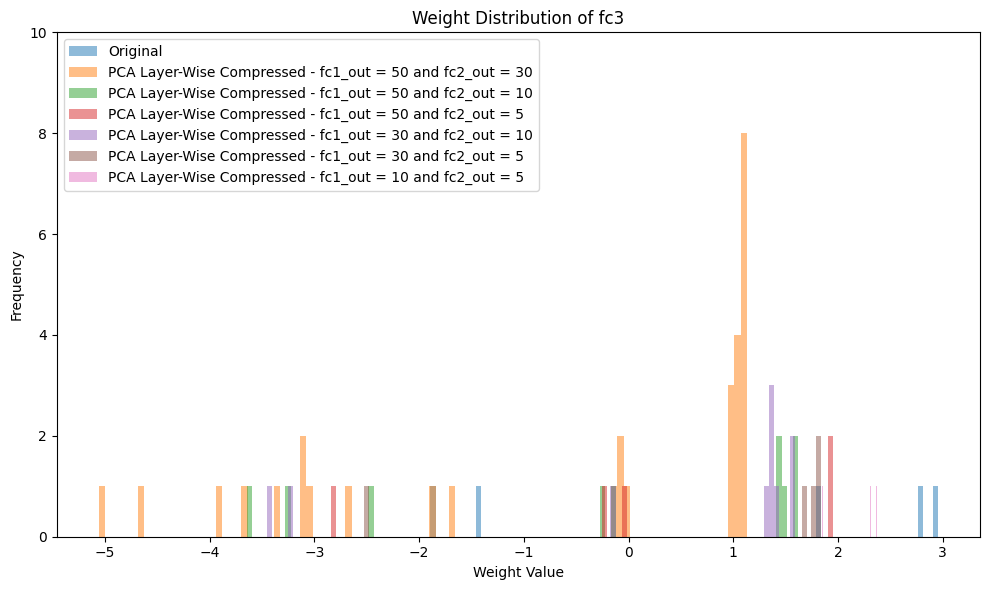

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_layerwiseList4.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=10)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_layerwiseList4.keys())

plt.tight_layout()
plt.show()

###### Pruning Amount = 0.95

In [ ]:
# list of PCA local models
PCA_layerwiseList5 = {
    "Original": model,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse5_5030,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse5_5030,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 10": PCA_sparse5_5010,
    "PCA Layer-Wise Compressed - fc1_out = 50 and fc2_out = 5": PCA_sparse5_505,
    "PCA Layer-Wise Compressed - fc1_out = 30 and fc2_out = 10": PCA_sparse5_3010,
    "PCA Layer-Wise Compressed - fc1_out = 30 and fc2_out = 5": PCA_sparse5_305,
    "PCA Layer-Wise Compressed - fc1_out = 10 and fc2_out = 5": PCA_sparse5_105
}

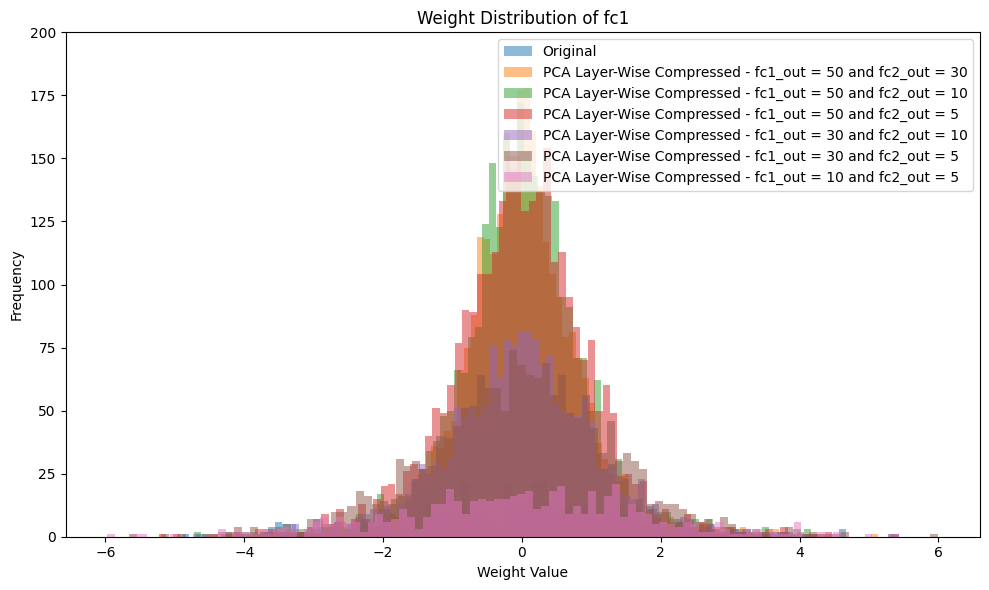

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_layerwiseList5.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=200)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_layerwiseList5.keys())

plt.tight_layout()
plt.show()

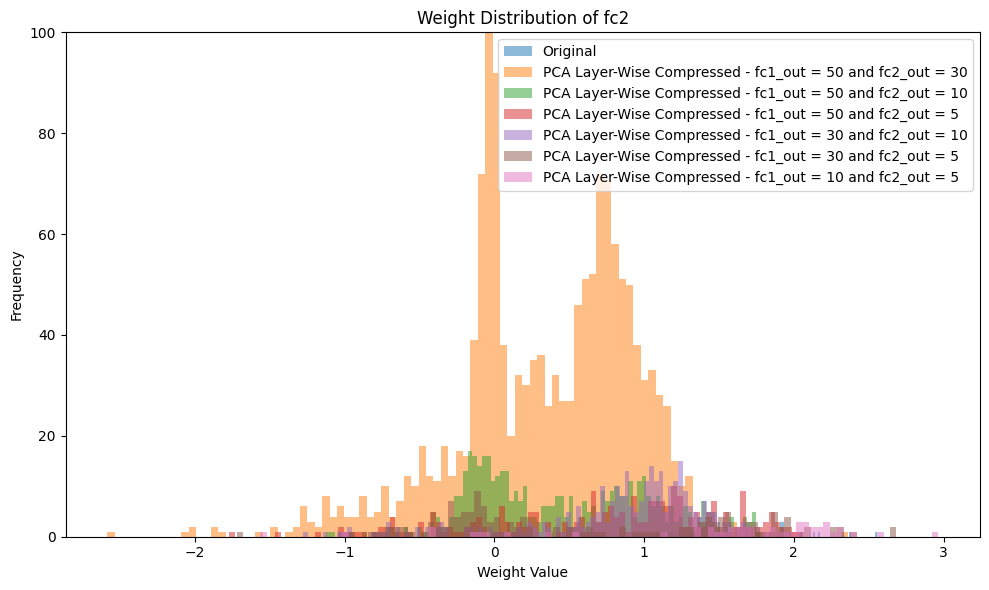

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_layerwiseList5.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_layerwiseList5.keys())

plt.tight_layout()
plt.show()

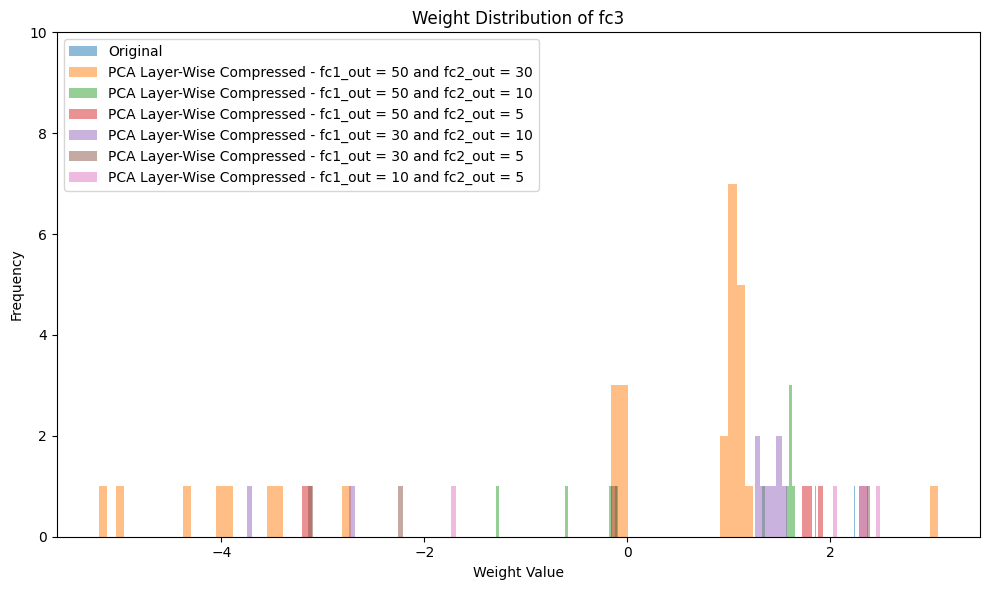

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in PCA_layerwiseList5.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=10)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(PCA_layerwiseList5.keys())

plt.tight_layout()
plt.show()

#### Inspecting the Weight Distribution of the SparsePCA Pruned Models

##### SparsePCA on Locally Pruned Models

###### Pruning Amount = 0.6

In [ ]:
# list of SparsePCA local models
SparsePCA_pruneList = {
    "Original": model,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_l1_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_l1_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_l1_10
}

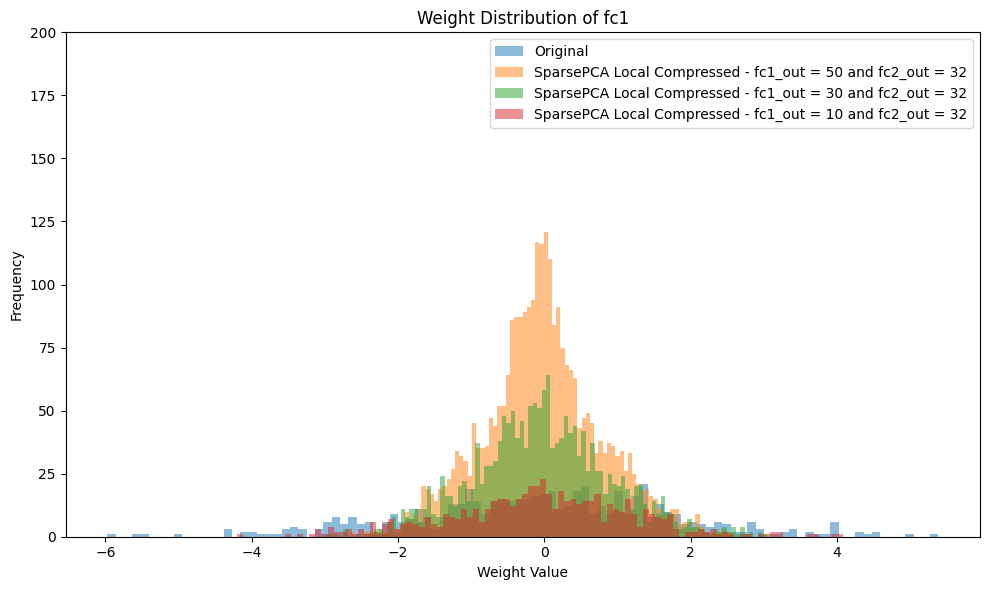

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_pruneList.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=200)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_pruneList.keys())

plt.tight_layout()
plt.show()

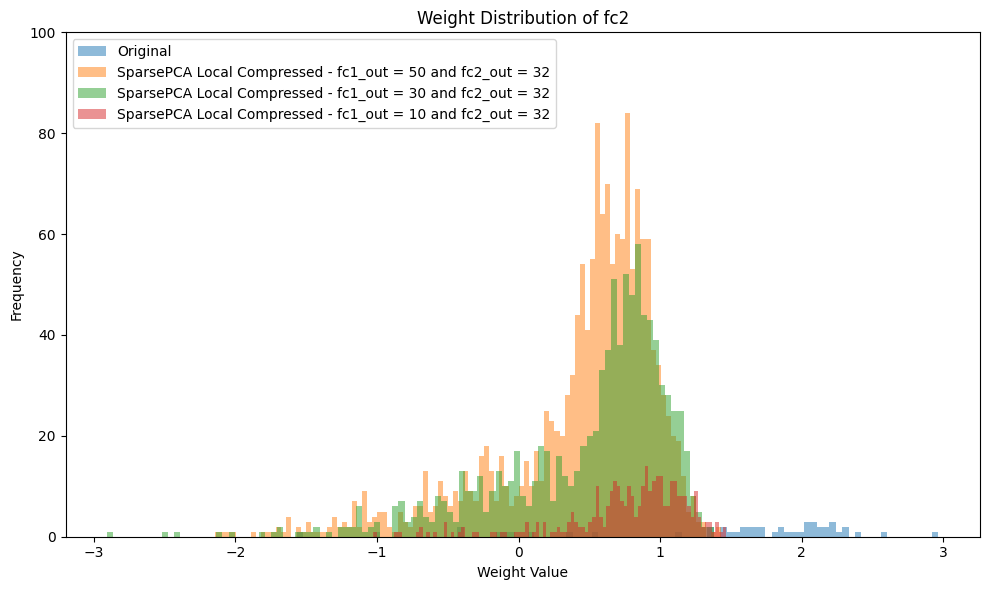

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_pruneList.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_pruneList.keys())

plt.tight_layout()
plt.show()

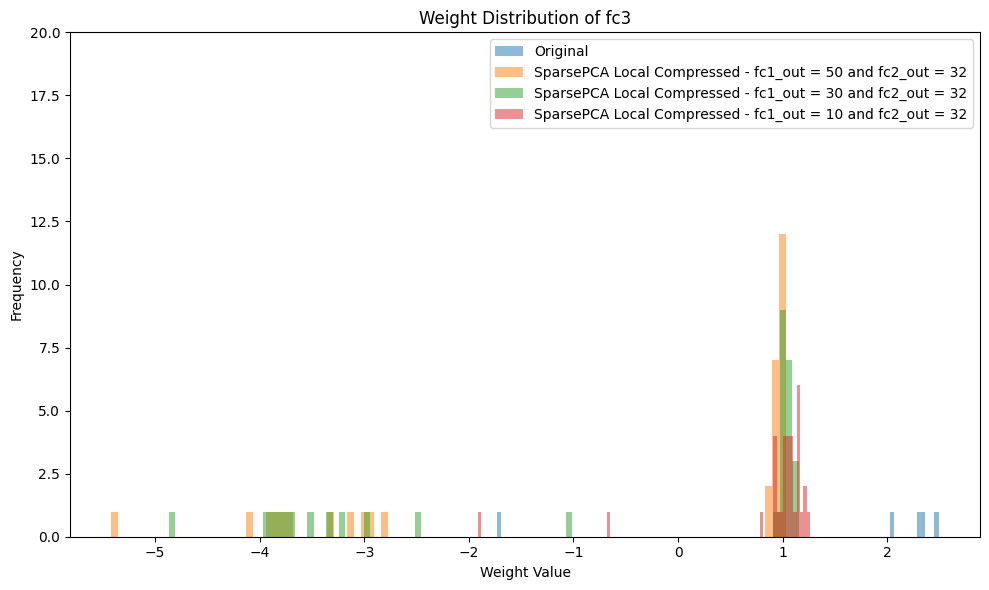

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_pruneList.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=20)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_pruneList.keys())

plt.tight_layout()
plt.show()

###### Pruning Amount = 0.7

In [ ]:
# list of SparsePCA local models
SparsePCA_pruneList2 = {
    "Original": model,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_l2_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_l2_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_l2_10
}

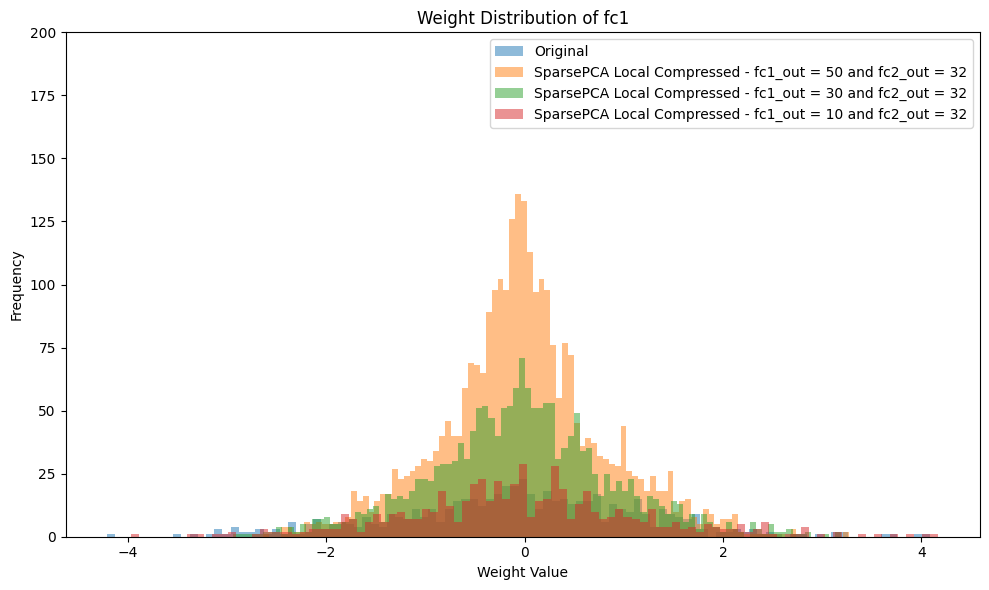

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_pruneList2.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=200)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_pruneList2.keys())

plt.tight_layout()
plt.show()

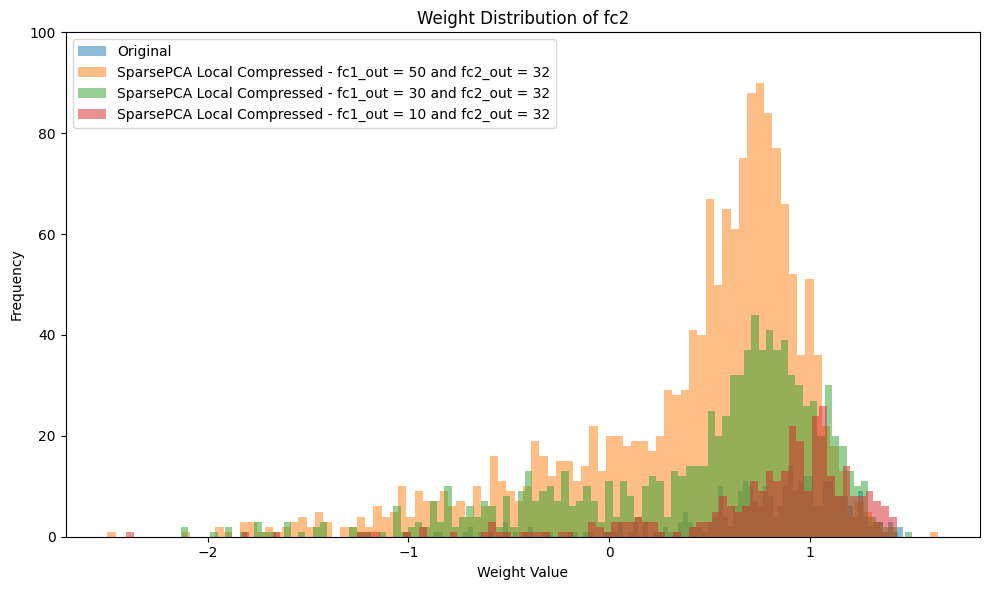

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_pruneList2.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_pruneList2.keys())

plt.tight_layout()
plt.show()

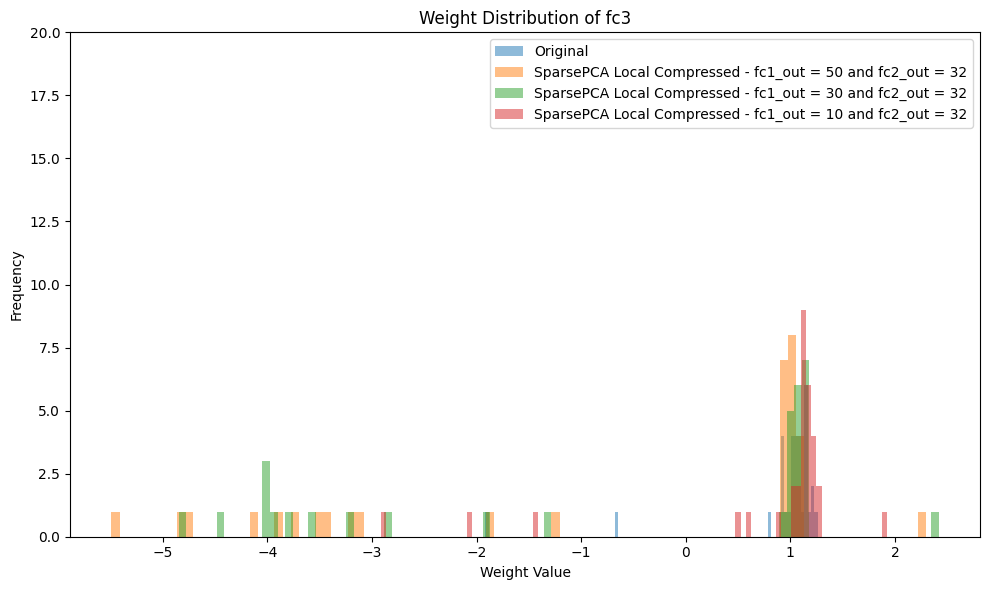

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_pruneList2.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=20)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_pruneList2.keys())

plt.tight_layout()
plt.show()

###### Pruning Amount = 0.8

In [ ]:
# list of SparsePCA local models
SparsePCA_pruneList3 = {
    "Original": model,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_l3_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_l3_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_l3_10
}

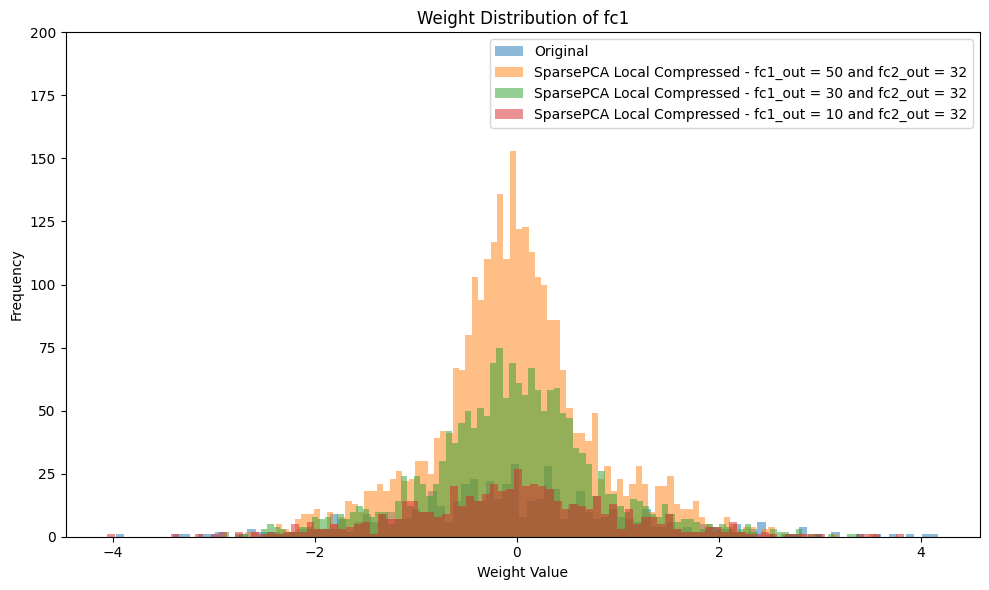

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_pruneList3.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=200)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_pruneList3.keys())

plt.tight_layout()
plt.show()

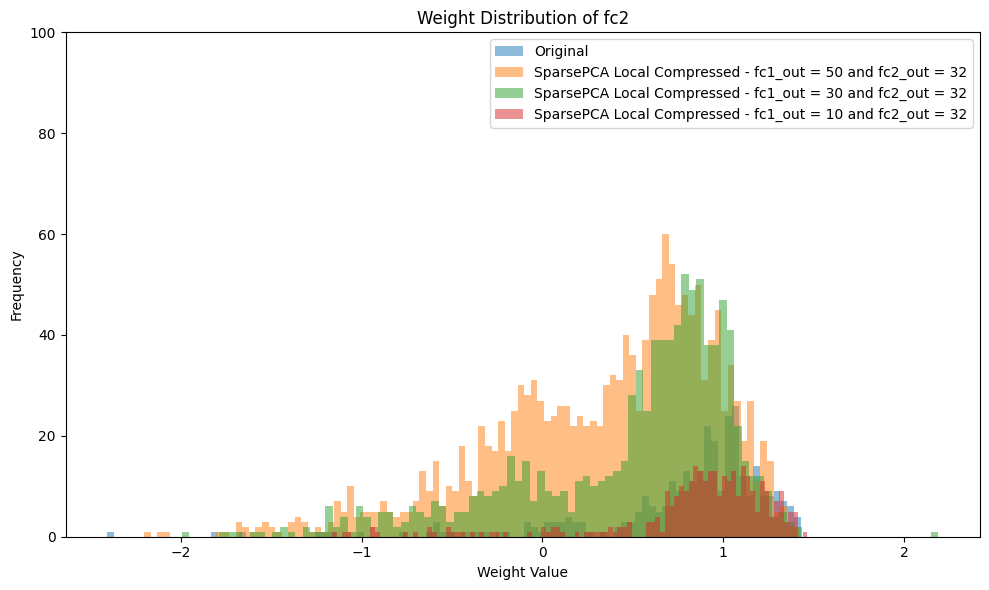

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_pruneList3.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_pruneList3.keys())

plt.tight_layout()
plt.show()

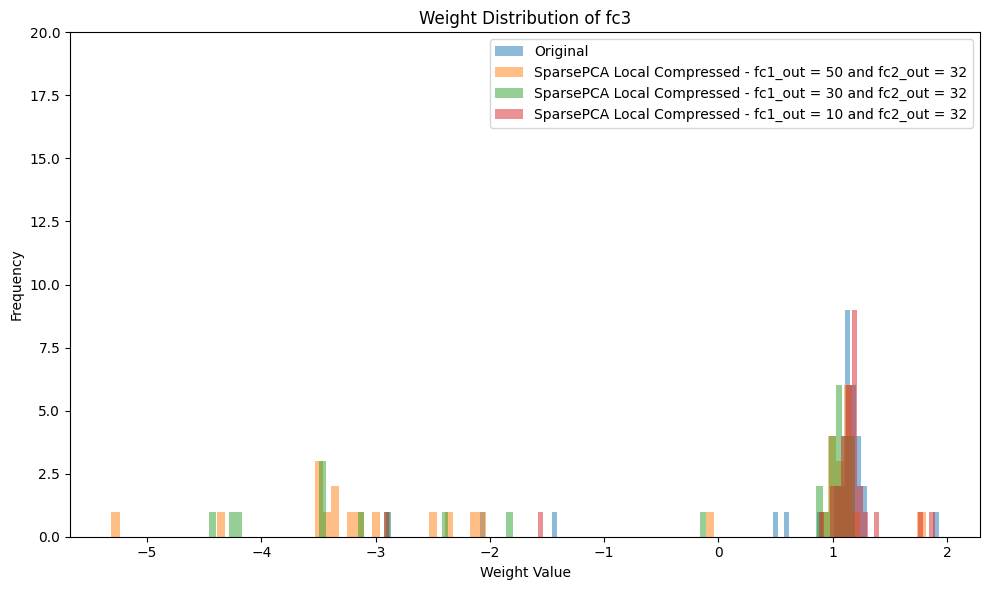

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_pruneList3.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=20)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_pruneList3.keys())

plt.tight_layout()
plt.show()

###### Pruning Amount = 0.9

In [ ]:
# list of SparsePCA local models
SparsePCA_pruneList4 = {
    "Original": model,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_l4_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_l4_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_l4_10
}

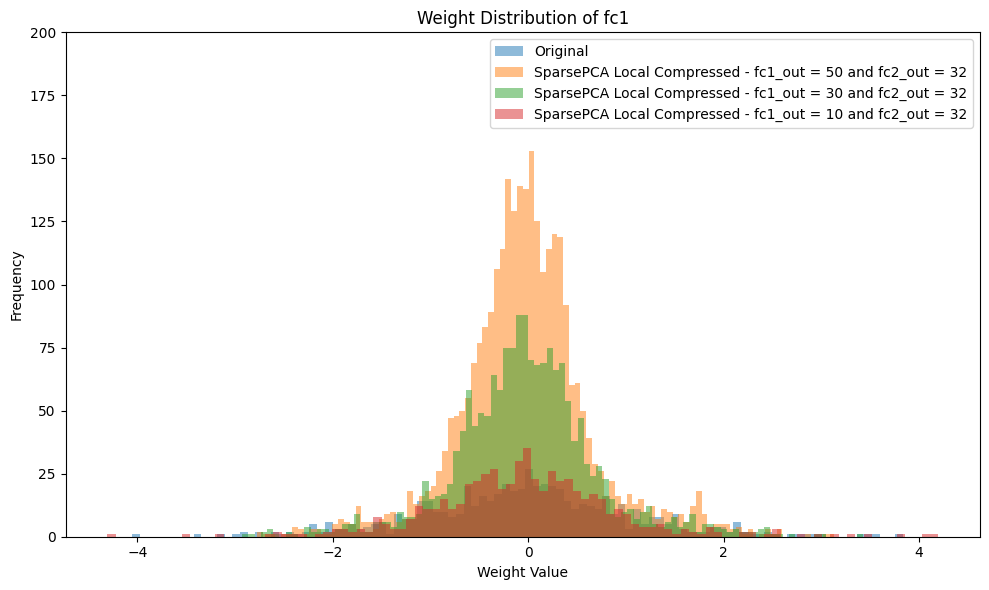

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_pruneList4.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=200)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_pruneList4.keys())

plt.tight_layout()
plt.show()

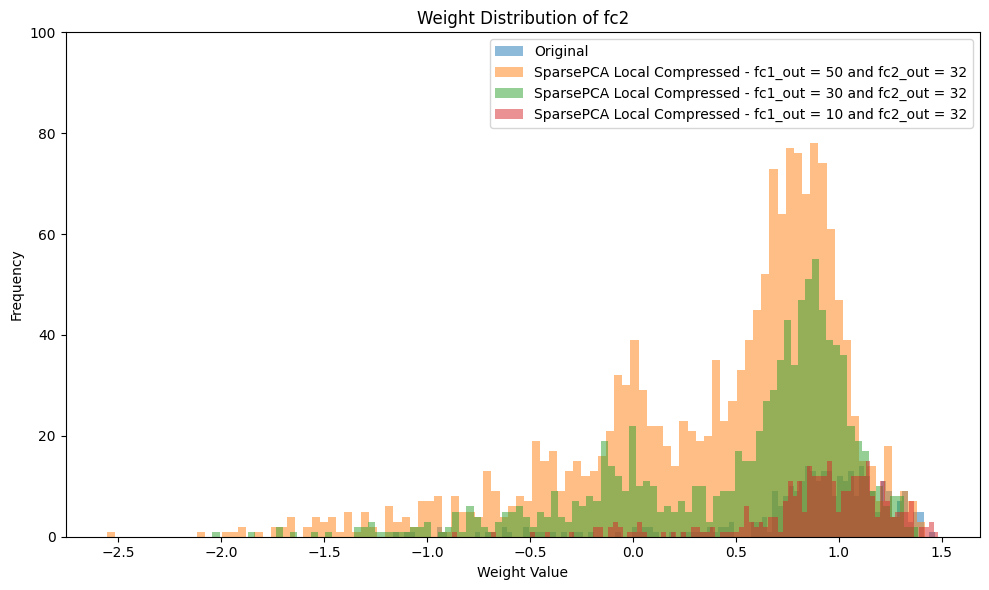

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_pruneList4.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_pruneList4.keys())

plt.tight_layout()
plt.show()

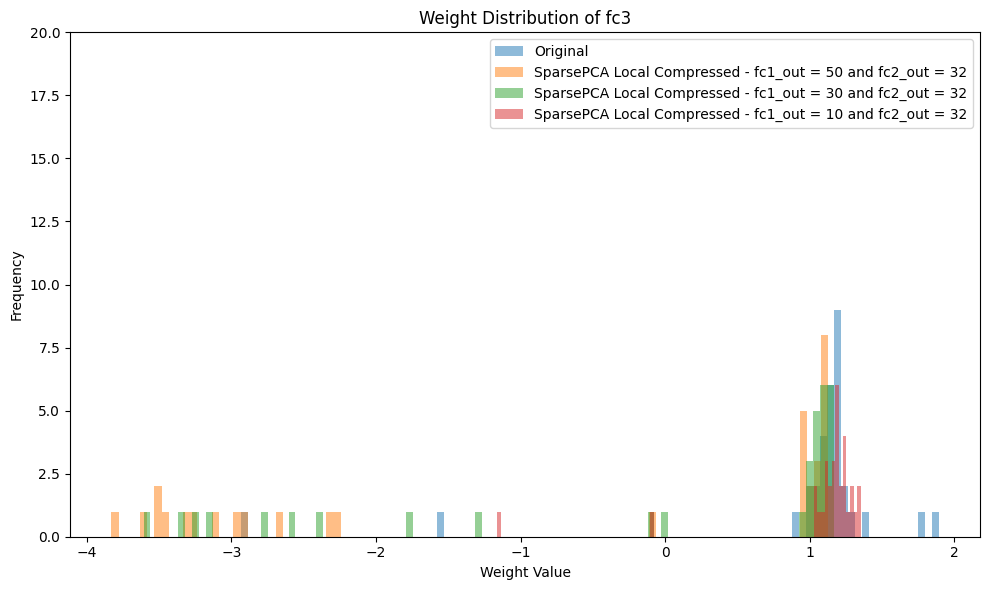

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_pruneList4.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=20)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_pruneList4.keys())

plt.tight_layout()
plt.show()

###### Pruning Amount = 0.95

In [ ]:
# list of SparsePCA local models
SparsePCA_pruneList5 = {
    "Original": model,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_l5_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_l5_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_l5_10
}

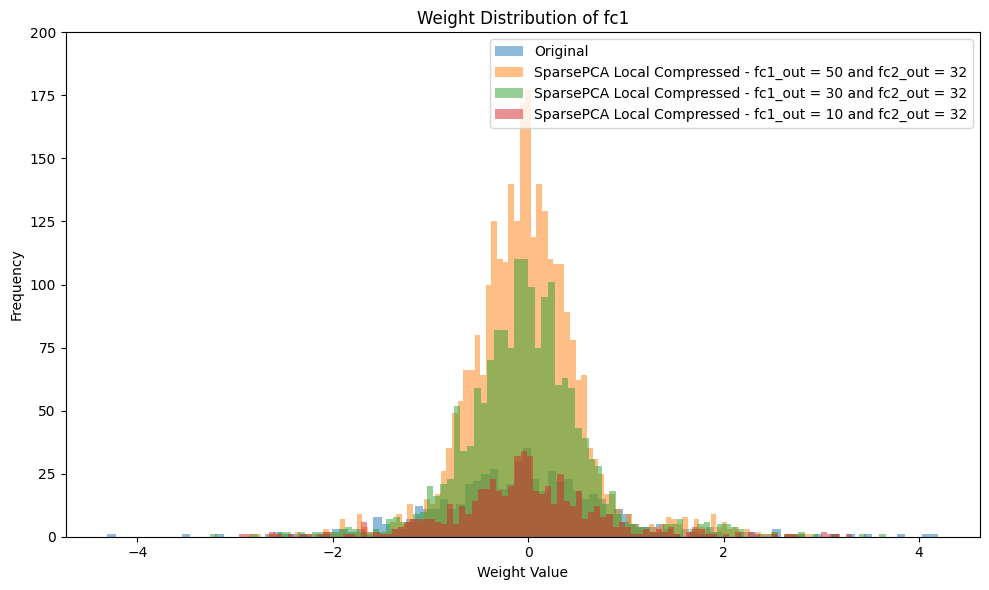

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_pruneList5.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=200)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_pruneList5.keys())

plt.tight_layout()
plt.show()

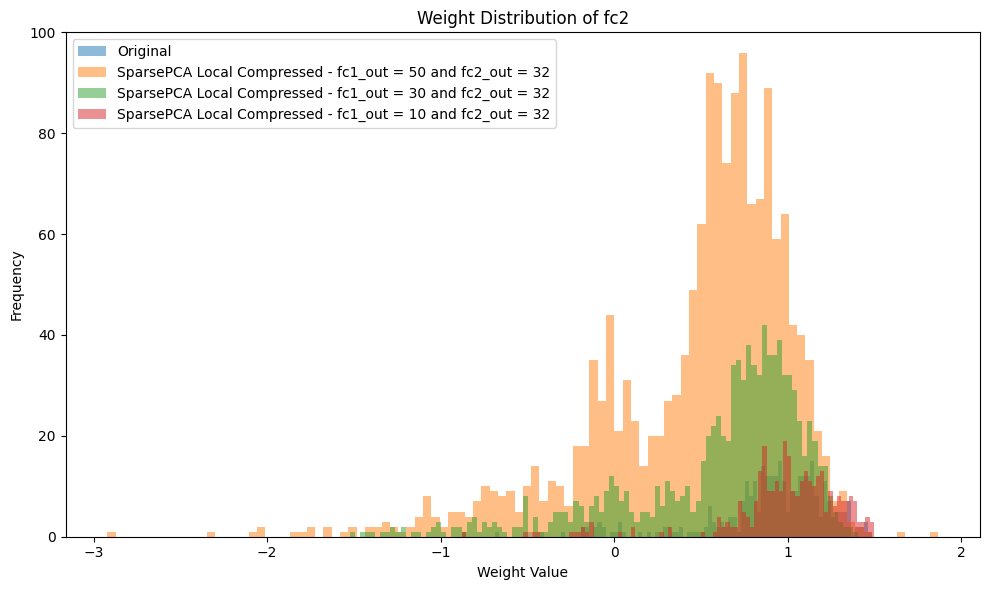

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_pruneList5.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_pruneList5.keys())

plt.tight_layout()
plt.show()

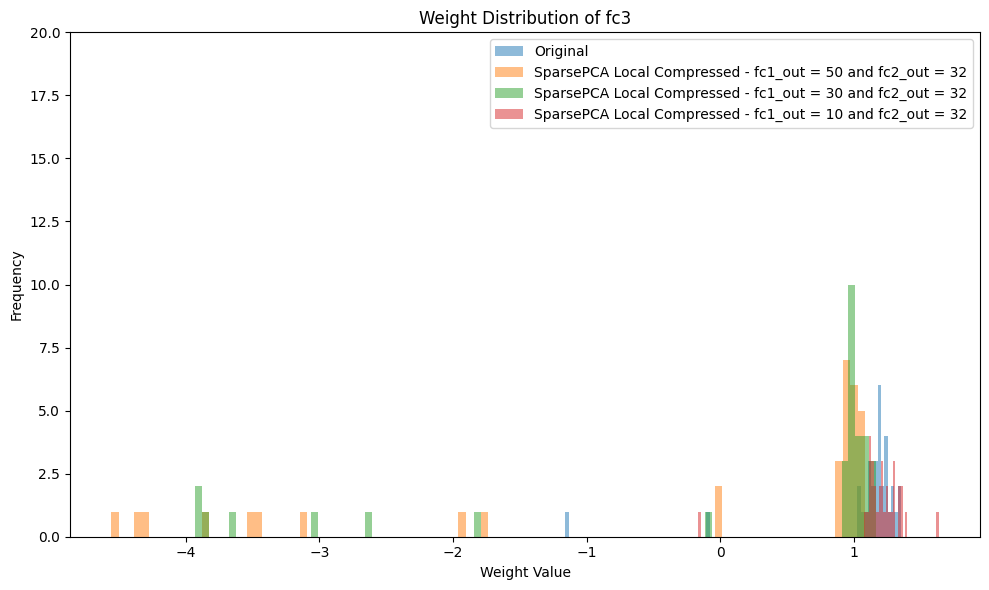

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_pruneList5.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=20)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_pruneList5.keys())

plt.tight_layout()
plt.show()

##### SparsePCA on Layer-wise Locally Pruned Models

###### Pruning Amount = 0.6

In [ ]:
# list of PCA local models
SparsePCA_spasreList = {
    "Original": model,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_sparse1_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_sparse1_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_sparse1_10
}

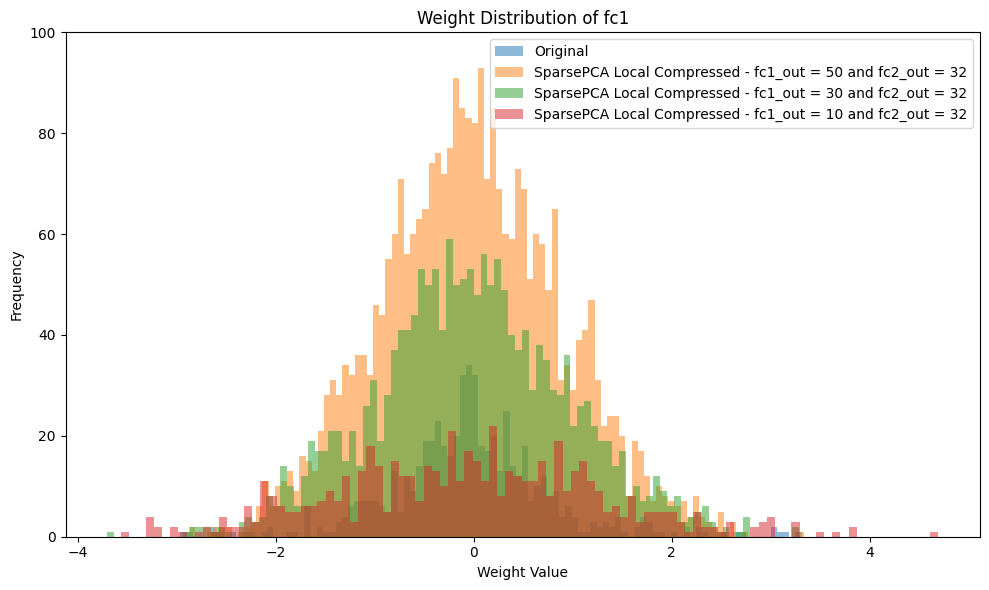

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_spasreList.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_spasreList.keys())

plt.tight_layout()
plt.show()

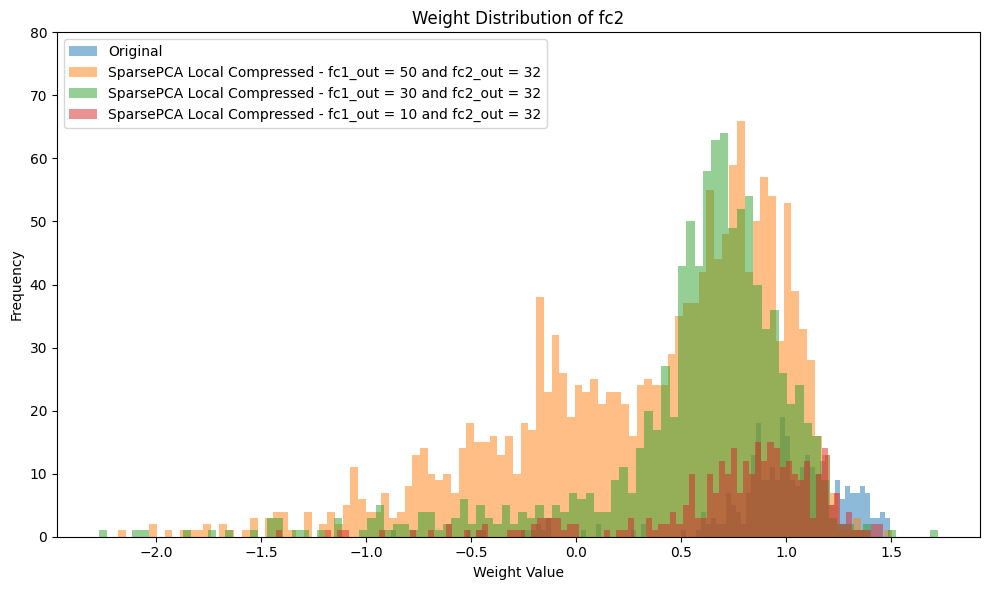

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_spasreList.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=80)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_spasreList.keys())

plt.tight_layout()
plt.show()

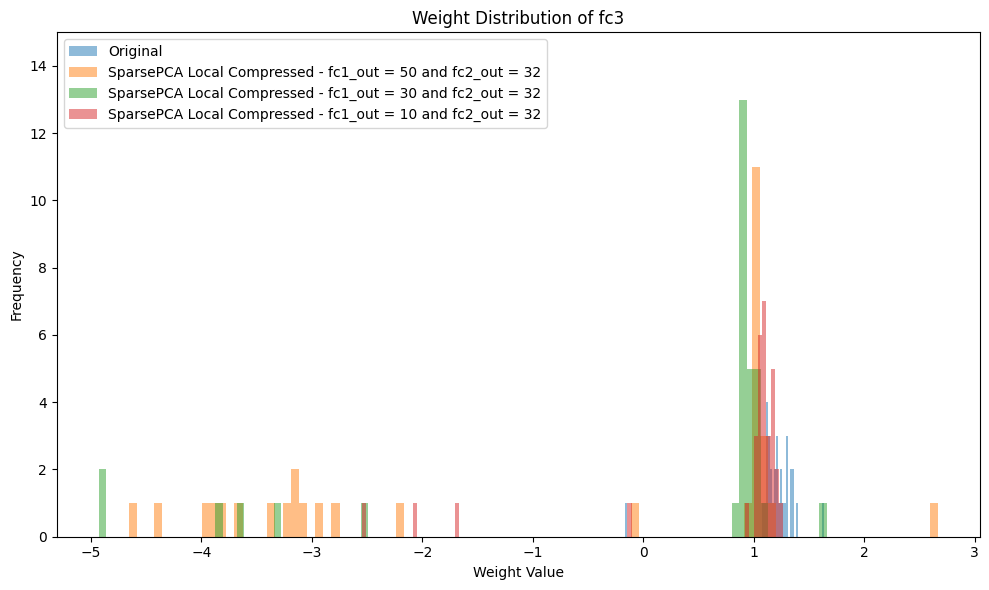

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_spasreList.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=15)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_spasreList.keys())

plt.tight_layout()
plt.show()

###### Pruning Amount = 0.7

In [ ]:
# list of PCA local models
SparsePCA_spasreList2 = {
    "Original": model,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_sparse2_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_sparse2_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_sparse2_10
}

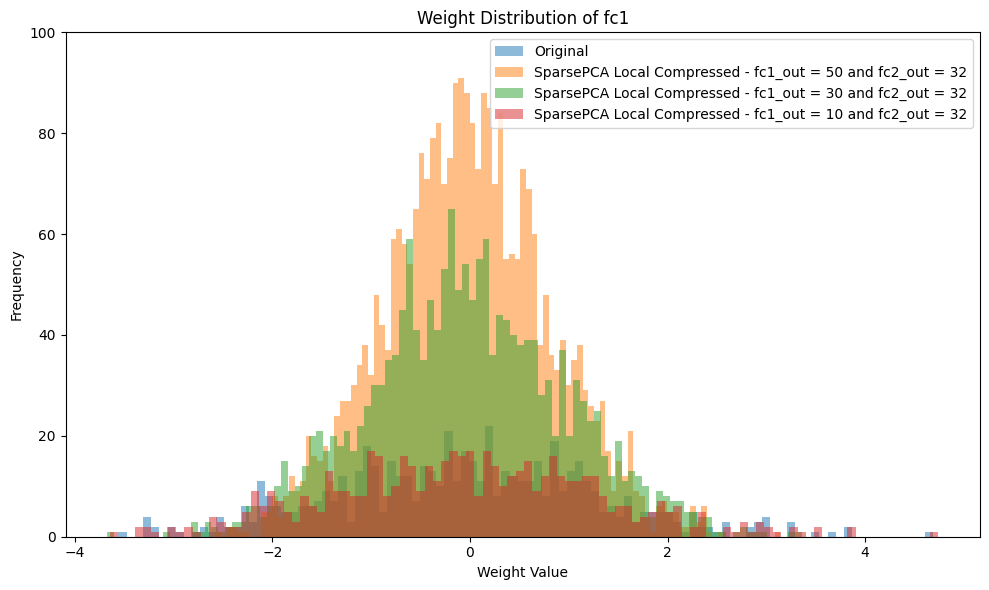

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_spasreList2.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_spasreList2.keys())

plt.tight_layout()
plt.show()

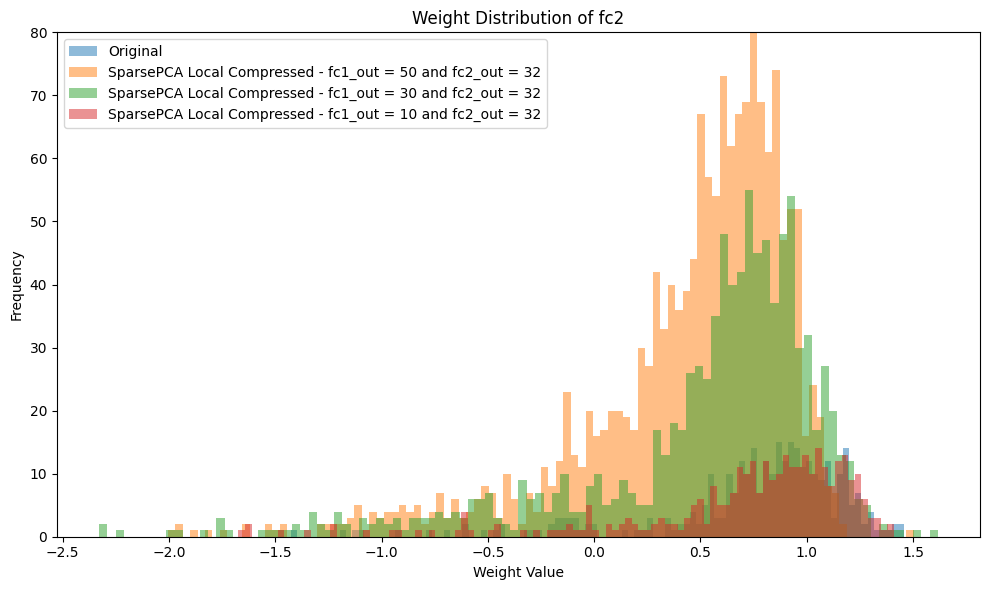

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_spasreList2.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=80)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_spasreList2.keys())

plt.tight_layout()
plt.show()

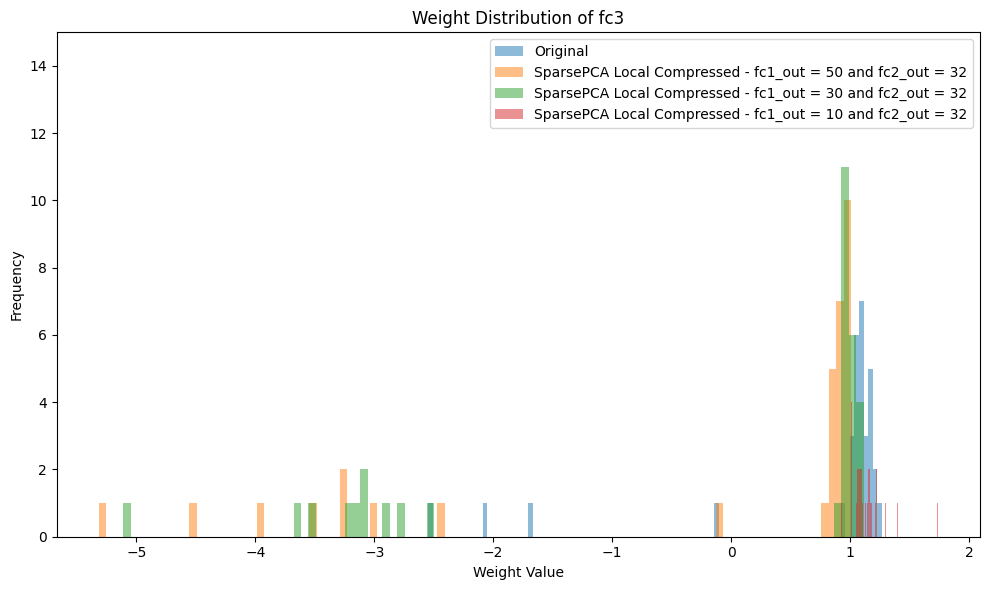

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_spasreList2.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=15)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_spasreList2.keys())

plt.tight_layout()
plt.show()

###### Pruning Amount = 0.8

In [ ]:
# list of PCA local models
SparsePCA_spasreList3 = {
    "Original": model,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_sparse3_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_sparse3_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_sparse3_10
}

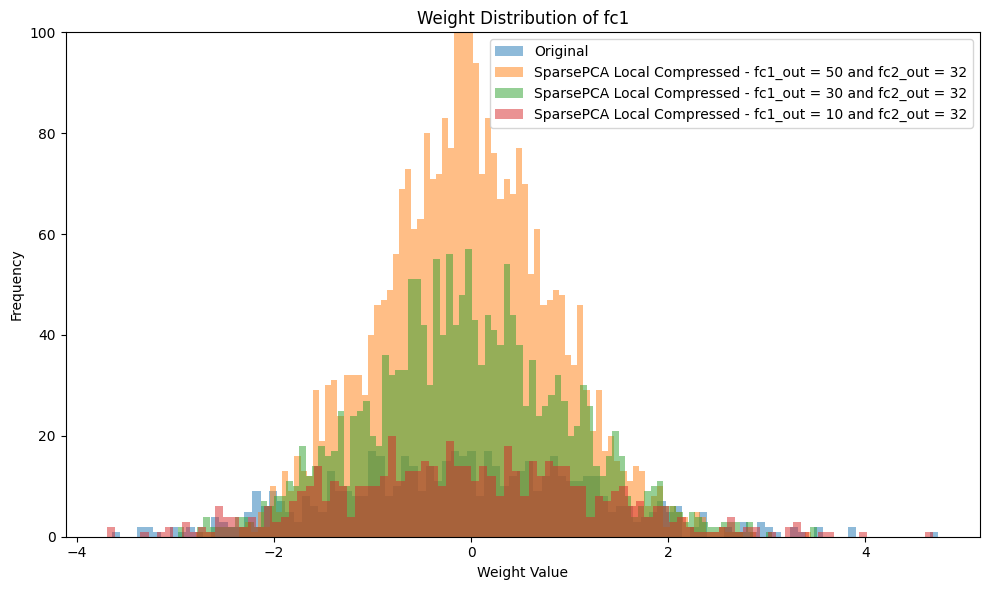

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_spasreList3.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_spasreList3.keys())

plt.tight_layout()
plt.show()

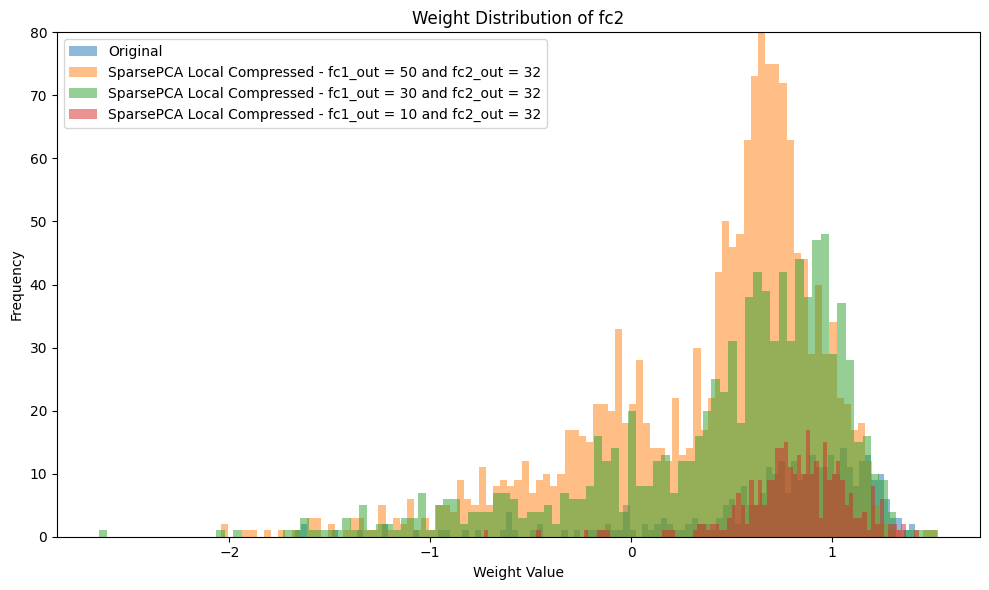

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_spasreList3.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=80)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_spasreList3.keys())

plt.tight_layout()
plt.show()

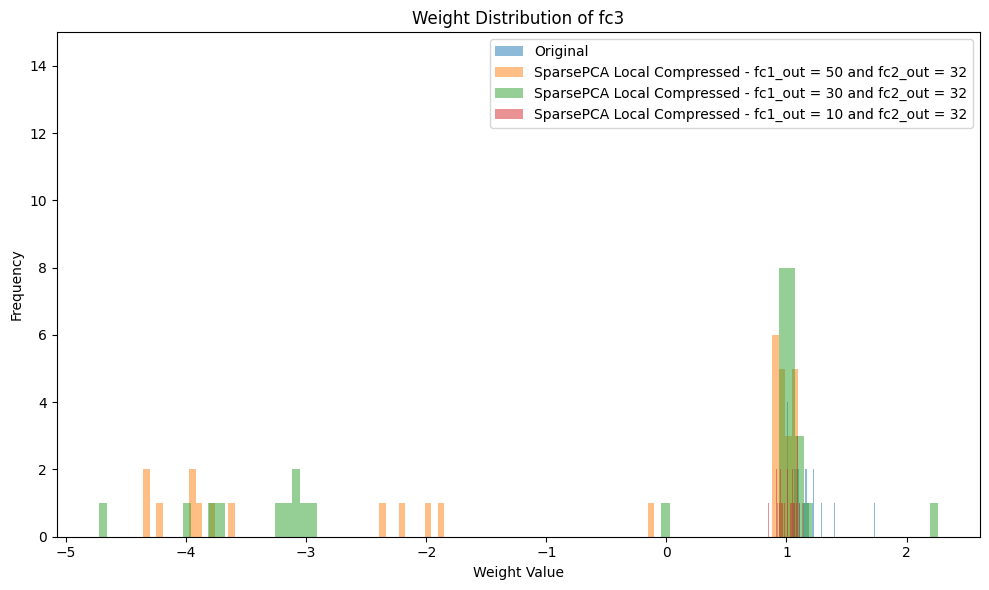

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_spasreList3.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=15)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_spasreList3.keys())

plt.tight_layout()
plt.show()

###### Pruning Amount = 0.9

In [ ]:
# list of PCA local models
SparsePCA_spasreList4 = {
    "Original": model,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_sparse4_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_sparse4_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_sparse4_10
}

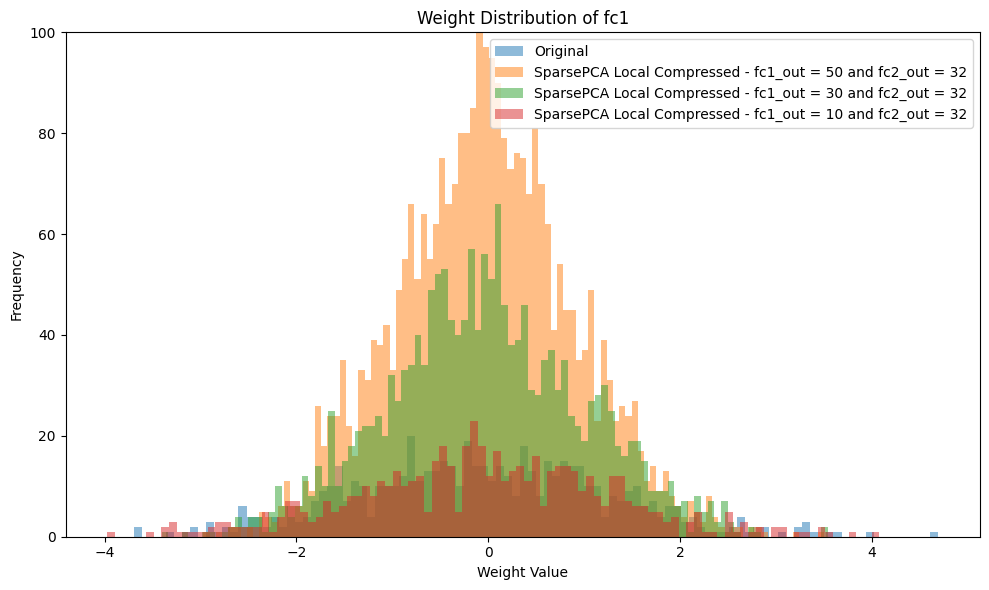

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_spasreList4.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_spasreList4.keys())

plt.tight_layout()
plt.show()

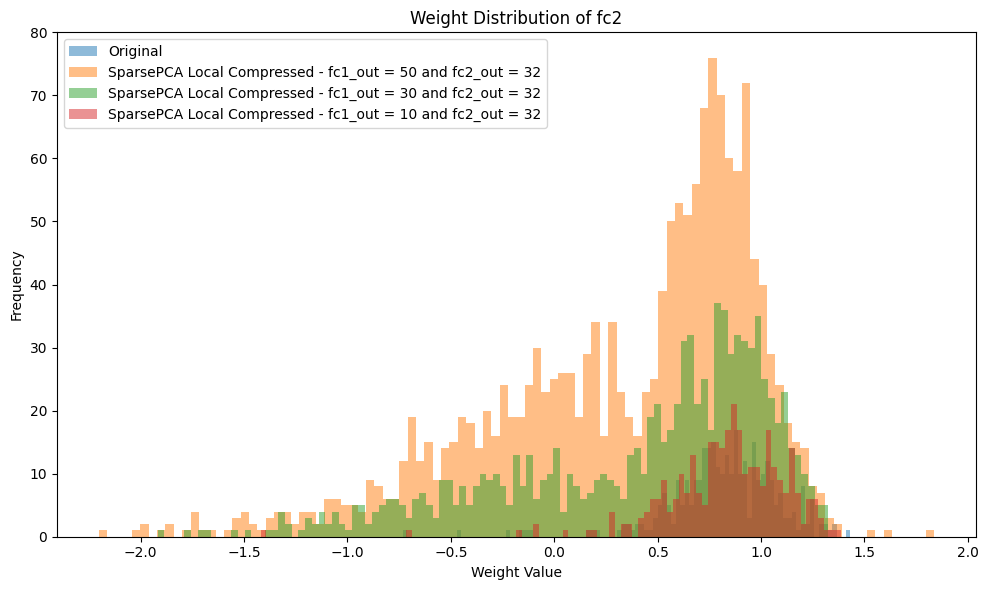

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_spasreList4.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=80)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_spasreList4.keys())

plt.tight_layout()
plt.show()

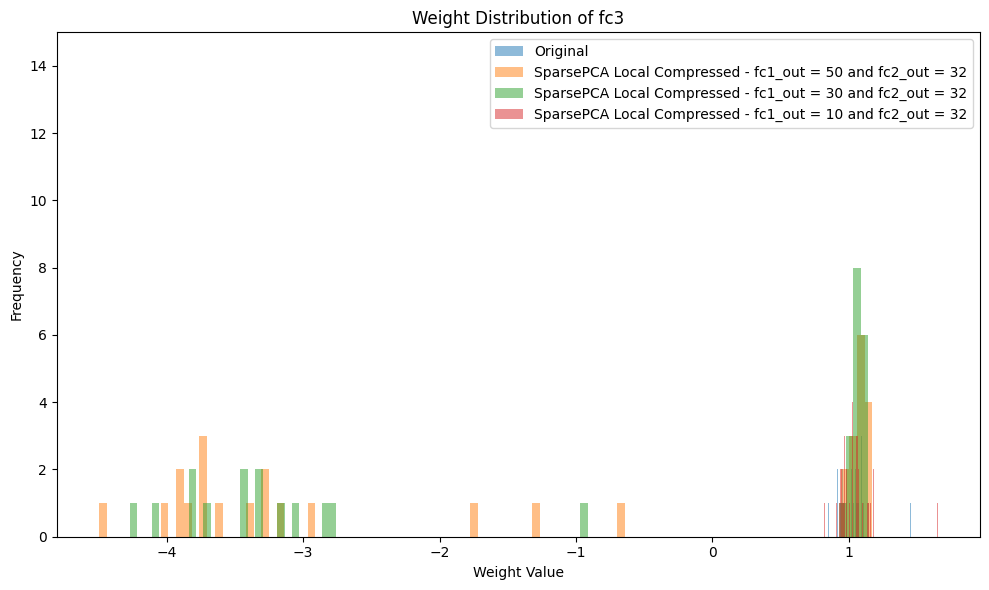

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_spasreList4.items():
        # Flatten the weight data and convert to CPU numpy array
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=15)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_spasreList4.keys())

plt.tight_layout()
plt.show()

###### Pruning Amount = 0.95

In [ ]:
# list of PCA local models
SparsePCA_spasreList5 = {
    "Original": model,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_sparse5_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_sparse5_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_sparse5_10
}

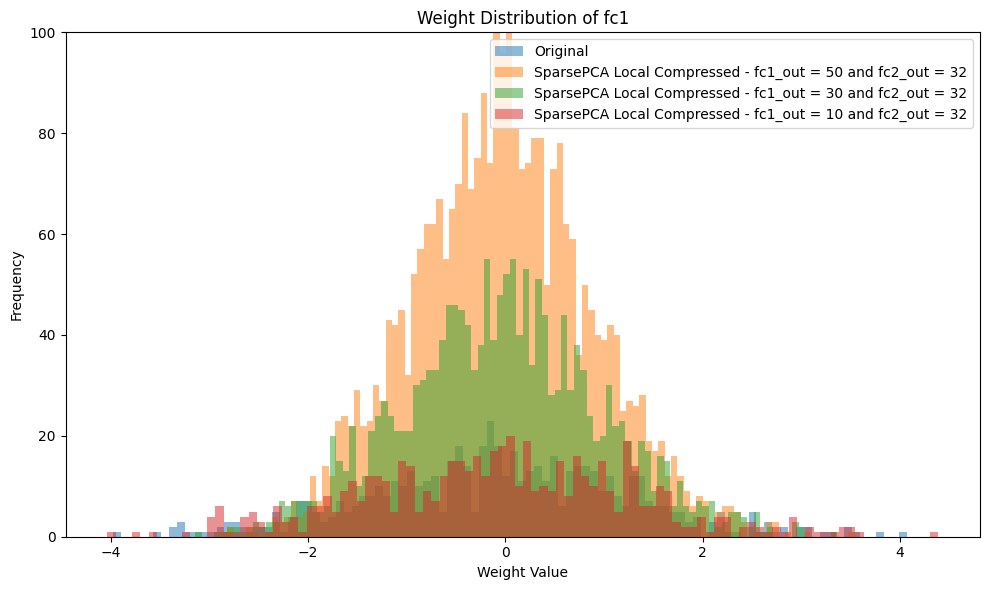

In [ ]:
# Define fc1 layers
layers = ['fc1']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_spasreList5.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc1']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=100)
ax.set_title("Weight Distribution of fc1")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_spasreList5.keys())

plt.tight_layout()
plt.show()

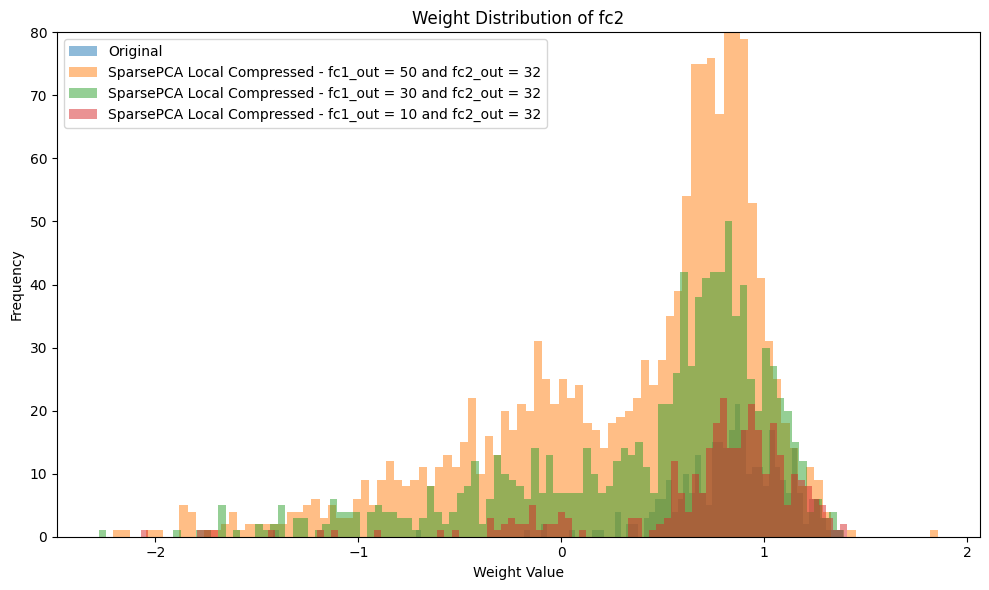

In [ ]:
# Define fc2 layers
layers = ['fc2']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_spasreList5.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc2']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=80)
ax.set_title("Weight Distribution of fc2")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_spasreList5.keys())

plt.tight_layout()
plt.show()

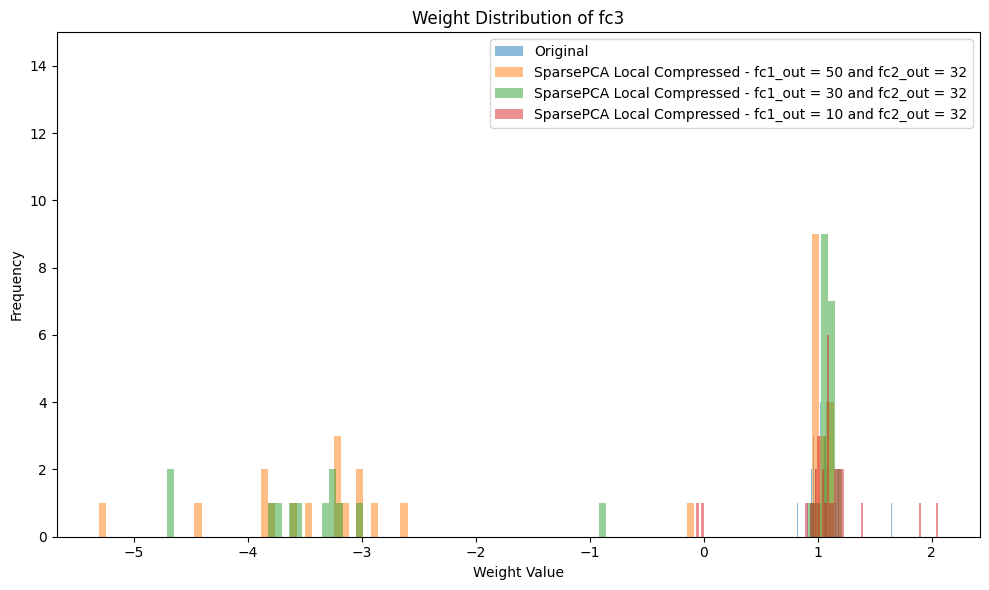

In [ ]:
# Define fc3 layers
layers = ['fc3']

weight_data = {layer: [] for layer in layers}

# Collecting weight data
for layer in layers:
    for model_name, model in SparsePCA_spasreList5.items():
        weights = getattr(model, layer).weight.data.reshape(-1).cpu().numpy()
        weight_data[layer].append(weights)

# Create subplots for each layer
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

for weights in weight_data['fc3']:
    ax.hist(weights, bins=100, alpha=0.5)
ax.set_ylim(top=15)
ax.set_title("Weight Distribution of fc3")
ax.set_xlabel("Weight Value")
ax.set_ylabel("Frequency")
ax.legend(SparsePCA_spasreList5.keys())

plt.tight_layout()
plt.show()

### Predictive Performance Plots across all the Models

#### Original, Local, and Locally Pruned Compressed (PCA, SparsePCA, ICA) Models

##### Pruning Amount = 0.6

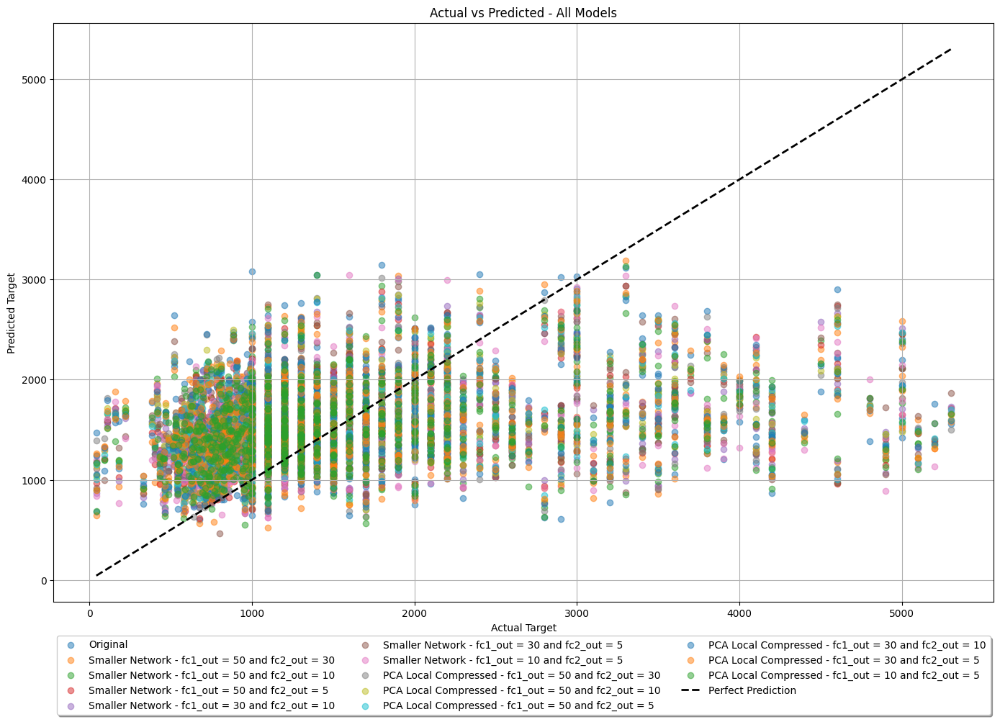

In [ ]:
# checking local models that have 0.6 pruning amount
PCA_l1_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local1_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local1_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_local1_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_local1_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_local1_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_local1_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_local1_105,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in PCA_l1_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:

            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    # reference: https://stackoverflow.com/questions/40776069/python-convert-prediction-result-into-one-hot
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

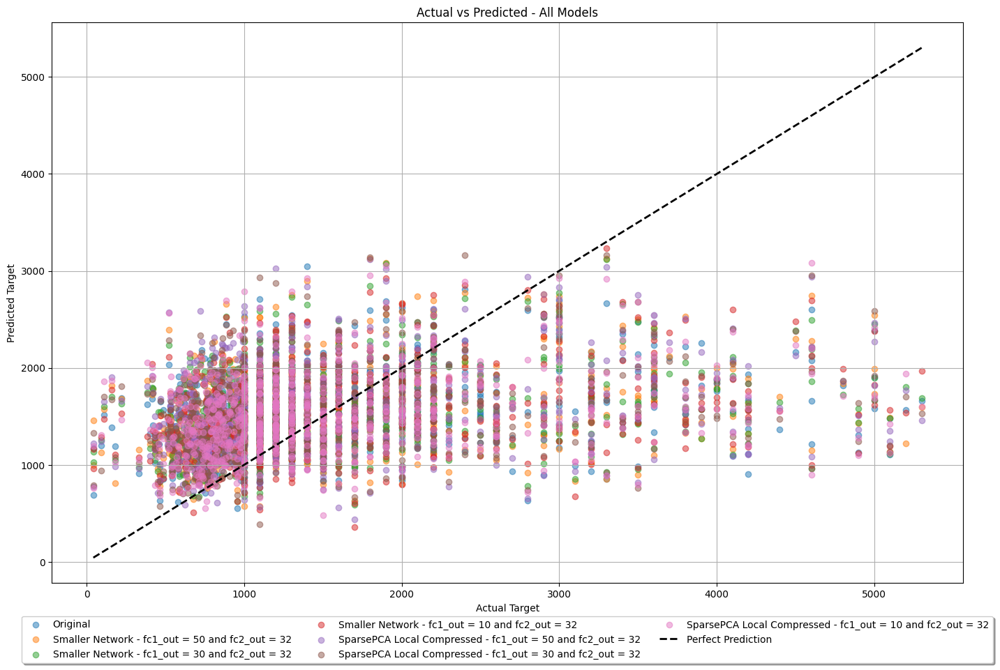

In [ ]:
# checking local models that have 0.6 pruning amount
SparsePCA_l1_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_l1_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_l1_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_l1_10,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in SparsePCA_l1_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

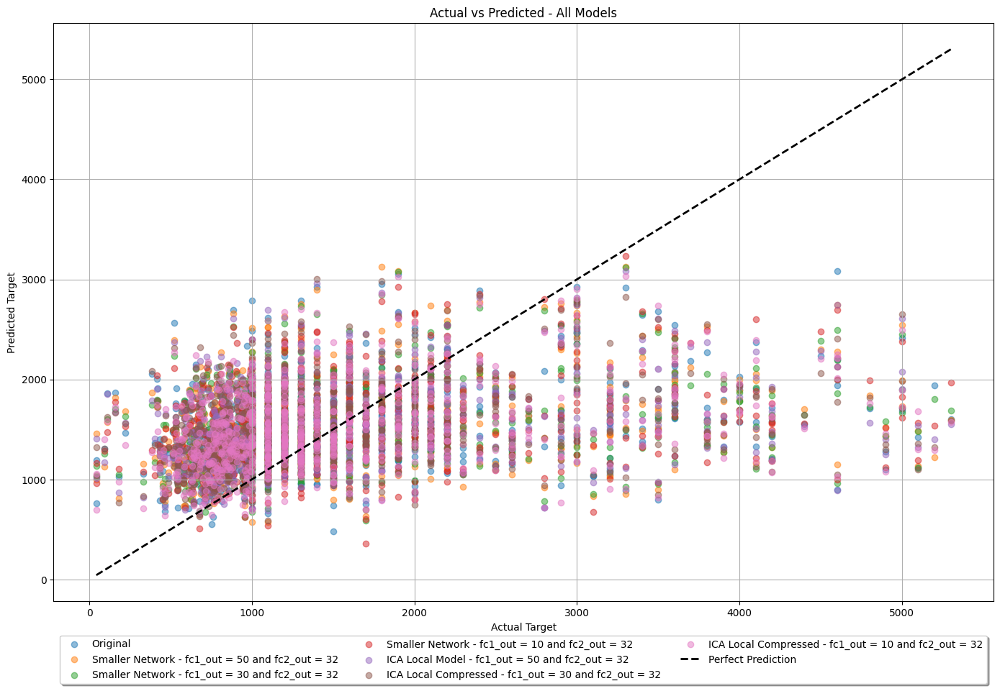

In [ ]:
# checking local models that have 0.6 pruning amount
ICA_l1_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_l1_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_l1_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_l1_10,

}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in ICA_l1_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

##### Pruning Amount = 0.7

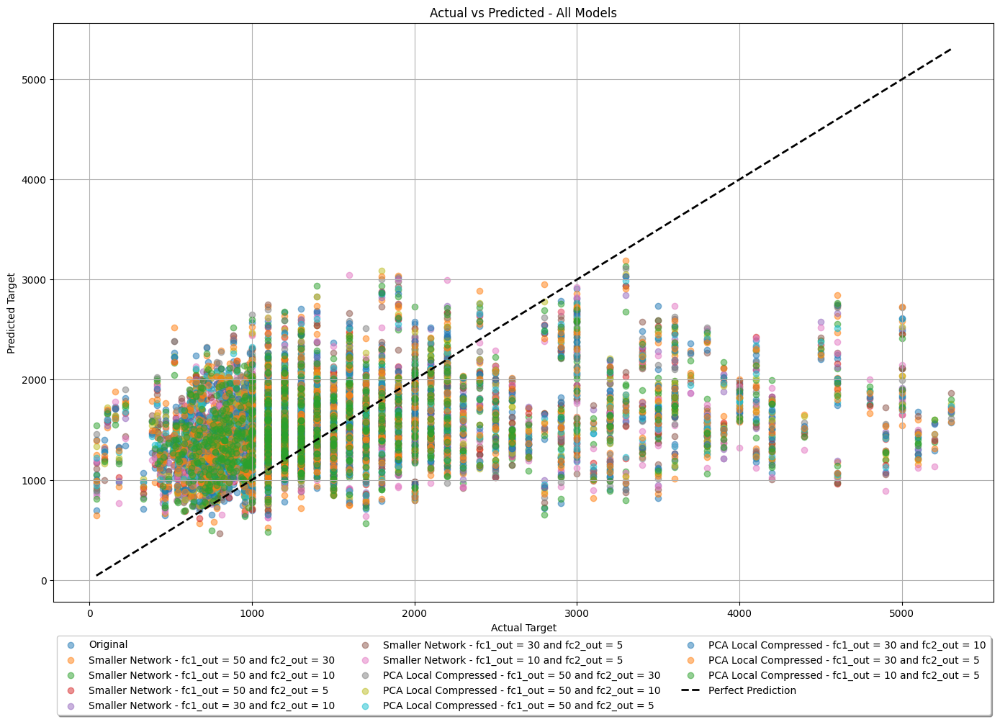

In [ ]:
# listing local models that have 0.7 pruning amount
PCA_l2_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local2_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local2_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_local2_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_local2_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_local2_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_local2_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_local2_105,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in PCA_l2_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

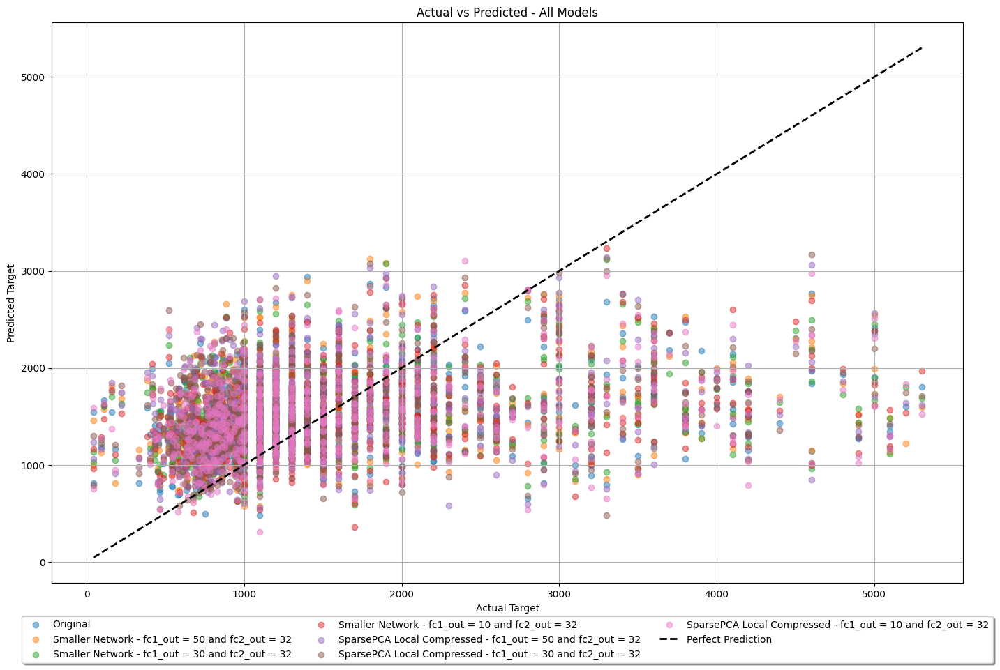

In [ ]:
# listing local models that have 0.7 pruning amount
SparsePCA_l2_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_l2_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_l2_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_l2_10,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in SparsePCA_l2_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

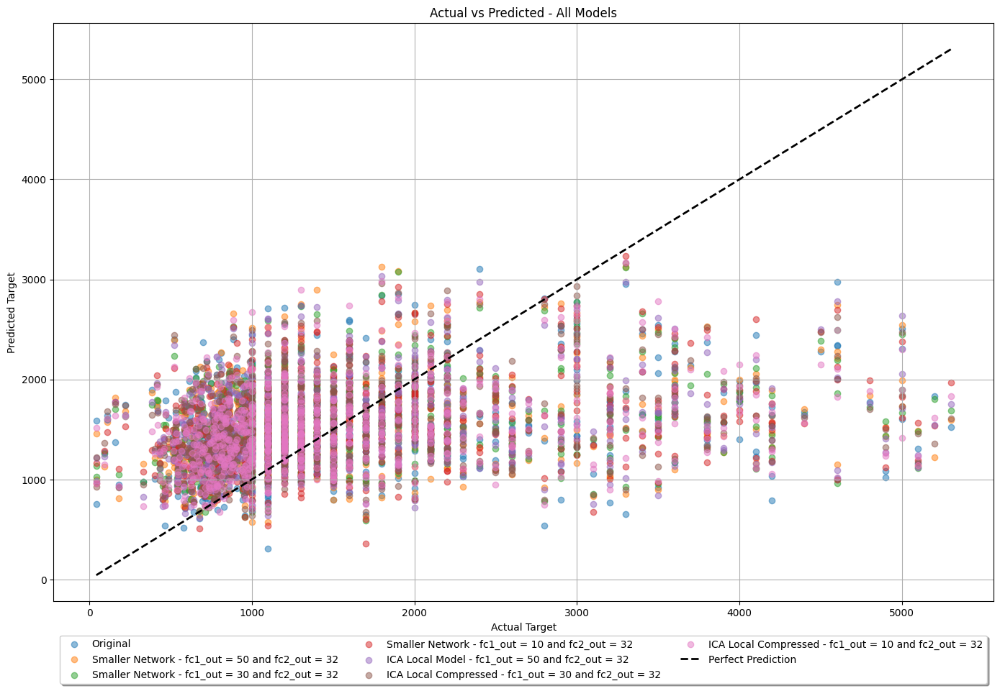

In [ ]:
# listing local models that have 0.7 pruning amount
ICA_l2_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_l2_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_l2_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_l2_10,

}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in ICA_l2_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

##### Pruning Amount = 0.8

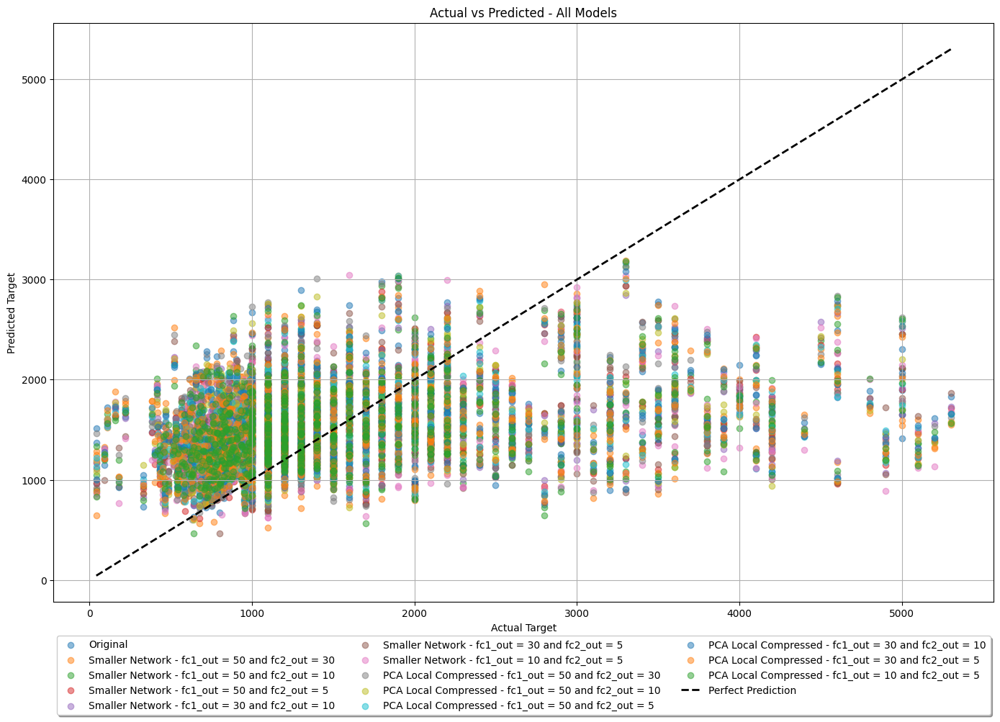

In [ ]:
# listing local models that have 0.8 pruning amount
PCA_l3_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local3_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local3_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_local3_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_local3_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_local3_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_local3_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_local3_105,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in PCA_l3_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

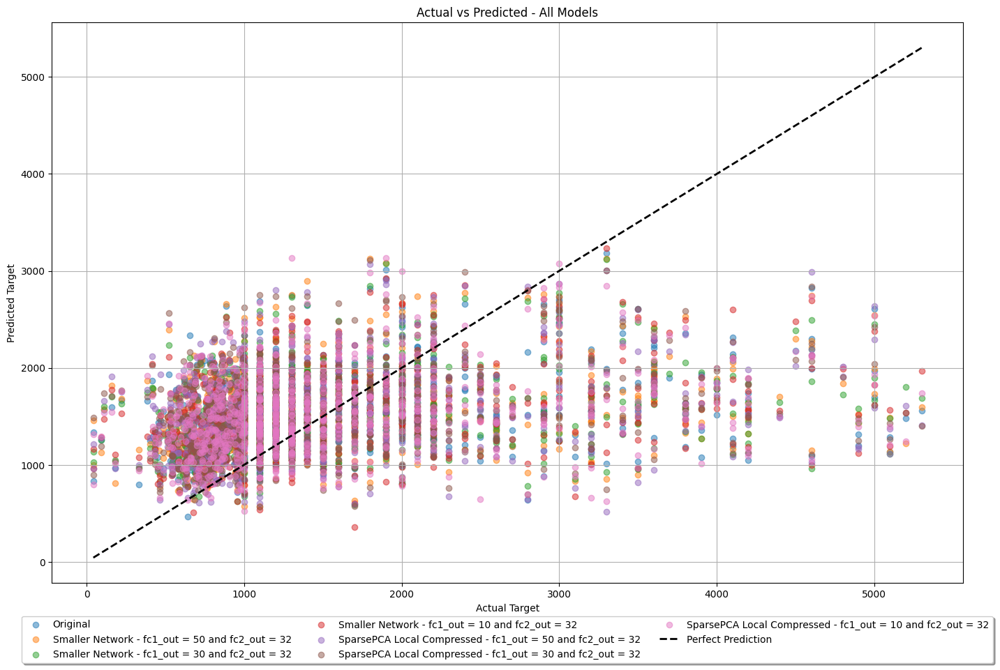

In [ ]:
# listing local models that have 0.8 pruning amoun
SparsePCA_l3_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_l3_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_l3_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_l3_10,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in SparsePCA_l3_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

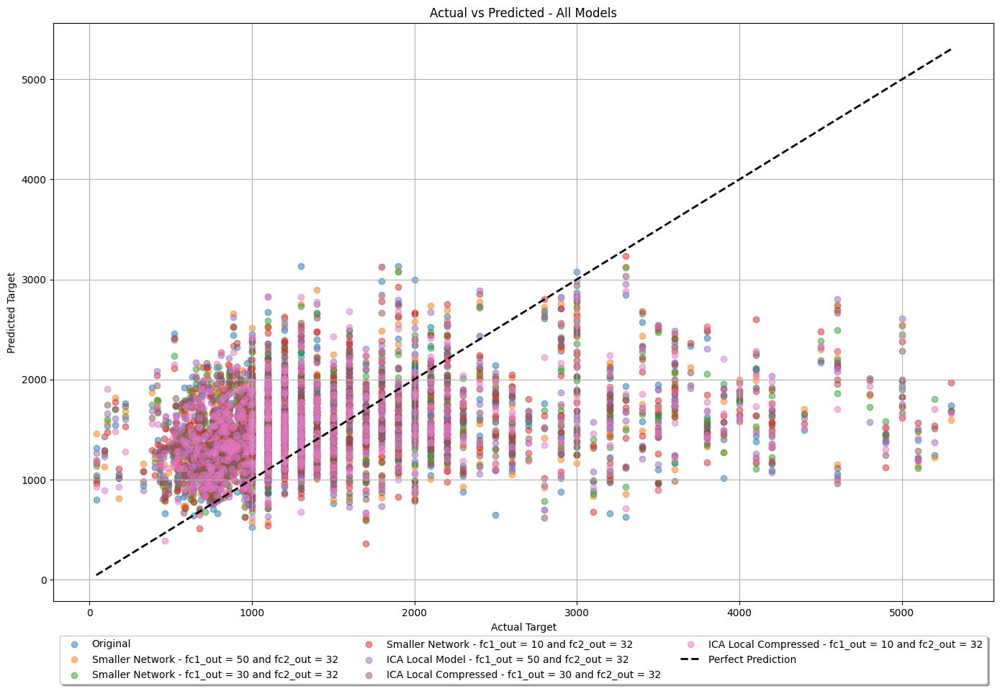

In [ ]:
# listing local models that have 0.8 pruning amoun
ICA_l3_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_l3_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_l3_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_l3_10,

}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in ICA_l3_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

##### Pruning Amount = 0.9

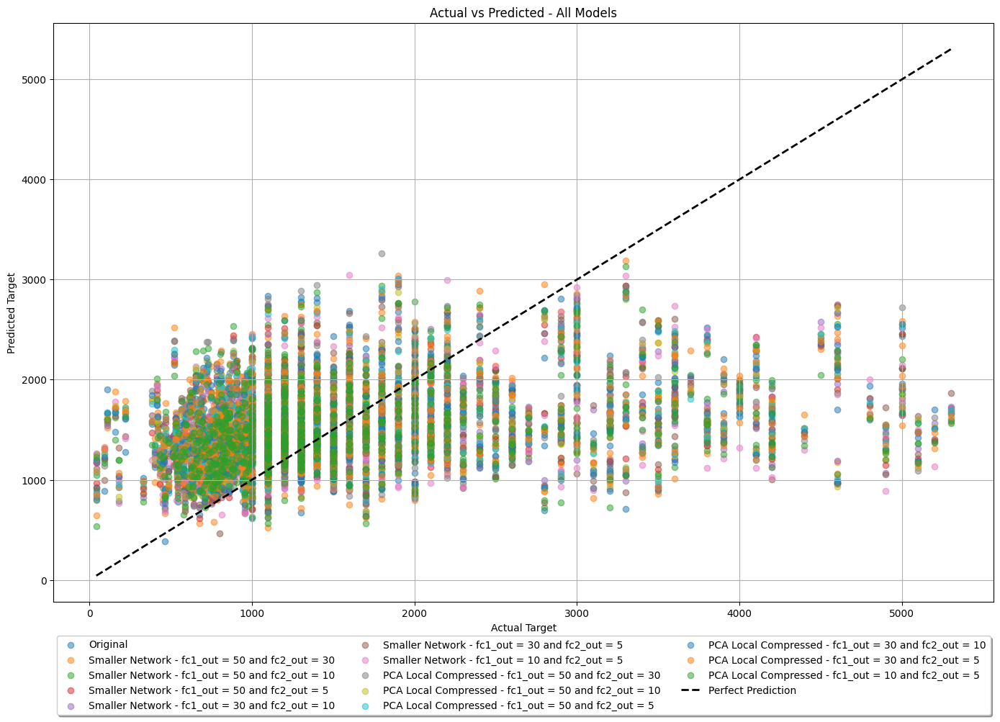

In [ ]:
# listing local models that have 0.9 pruning amoun
PCA_l4_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local4_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local4_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_local4_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_local4_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_local4_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_local4_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_local4_105,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in PCA_l4_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

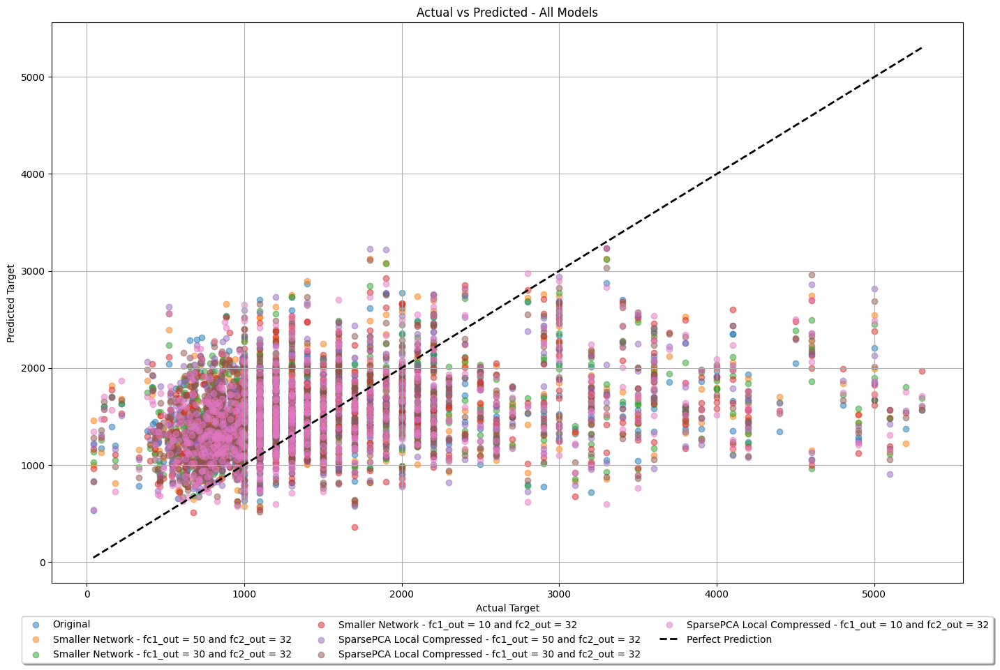

In [ ]:
# listing local models that have 0.9 pruning amount
SparsePCA_l4_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_l4_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_l4_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_l4_10,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in SparsePCA_l4_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

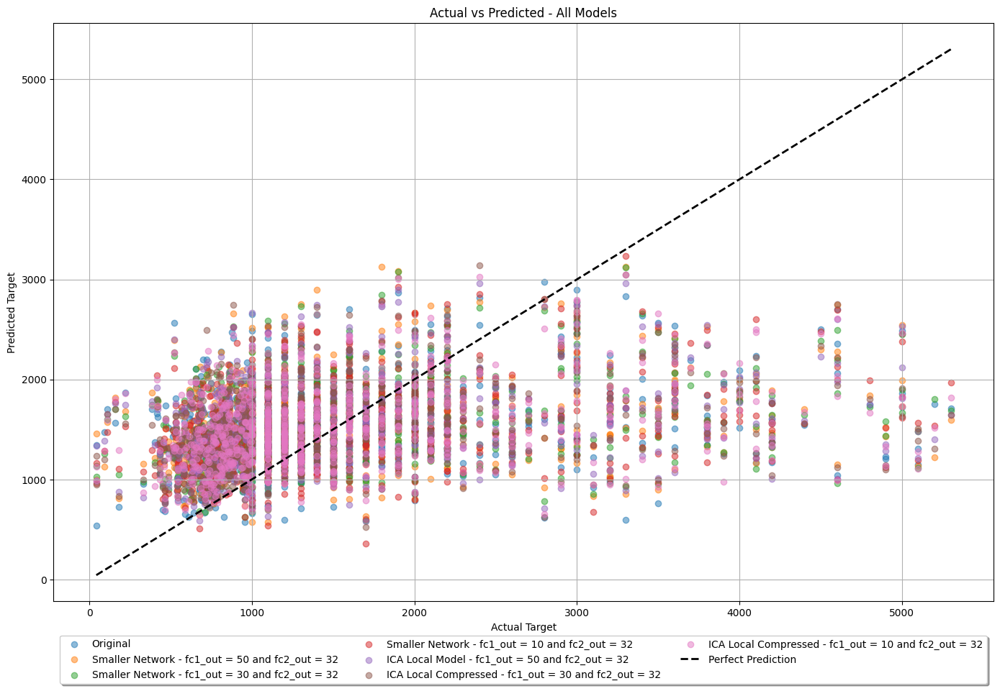

In [ ]:
# listing local models that have 0.9 pruning amount
ICA_l4_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_l4_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_l4_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_l4_10,

}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in ICA_l4_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

##### Pruning Amount = 0.95

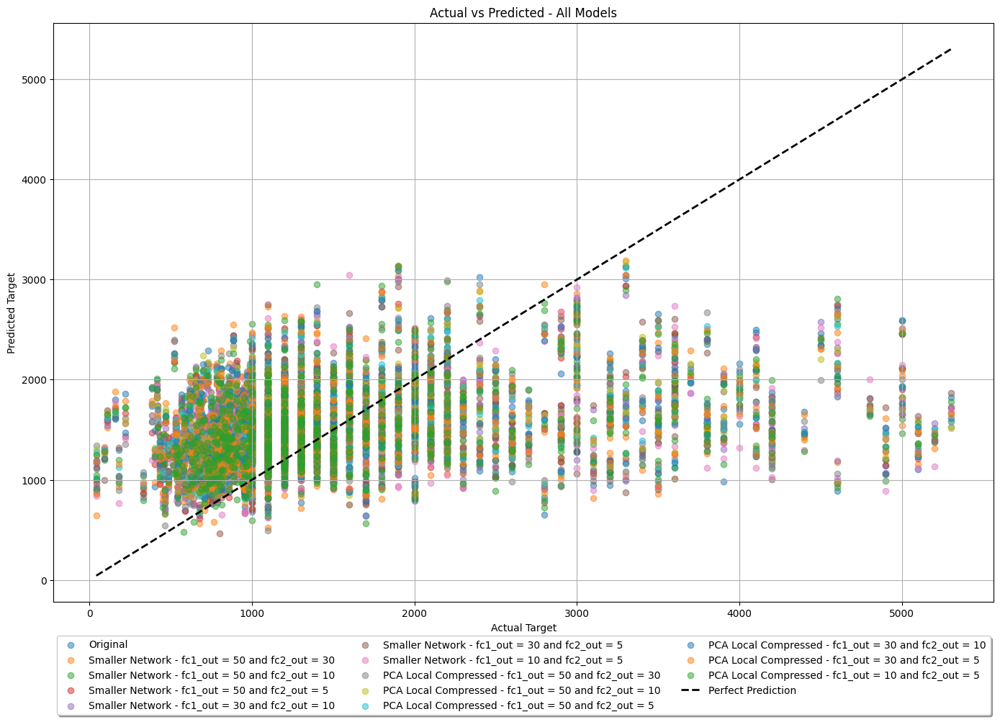

In [ ]:
# listing local models that have 0.95 pruning amoun
PCA_l5_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local5_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_local5_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_local5_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_local5_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_local5_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_local5_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_local5_105,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in PCA_l5_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

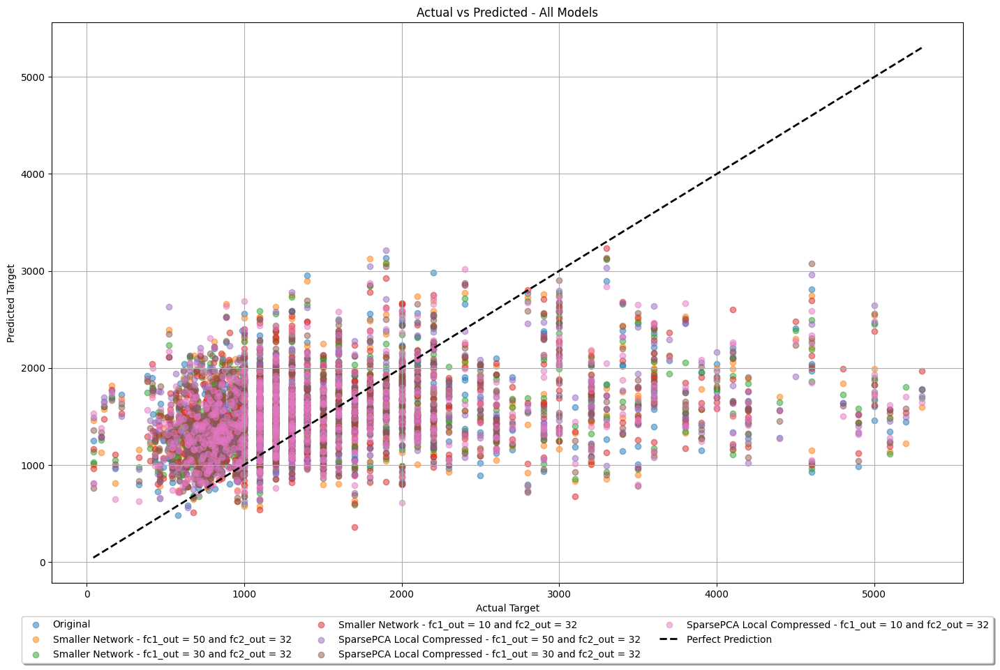

In [ ]:
# listing local models that have 0.95 pruning amount
SparsePCA_l5_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_l5_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_l5_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_l5_10,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in SparsePCA_l5_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

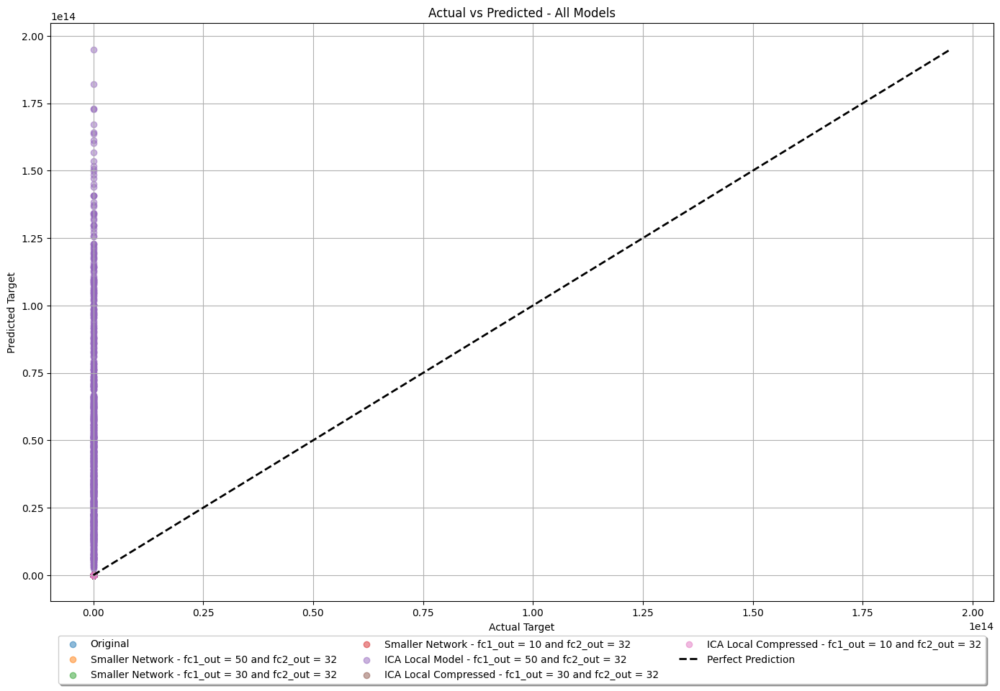

In [ ]:
# listing local models that have 0.95 pruning amount
ICA_l5_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_l5_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_l5_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_l5_10,

}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in ICA_l5_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

#### Original, Local, and Layer-Wise Pruned Compressed (PCA, SparsePCA, ICA) Models

##### Pruning Amount = 0.6

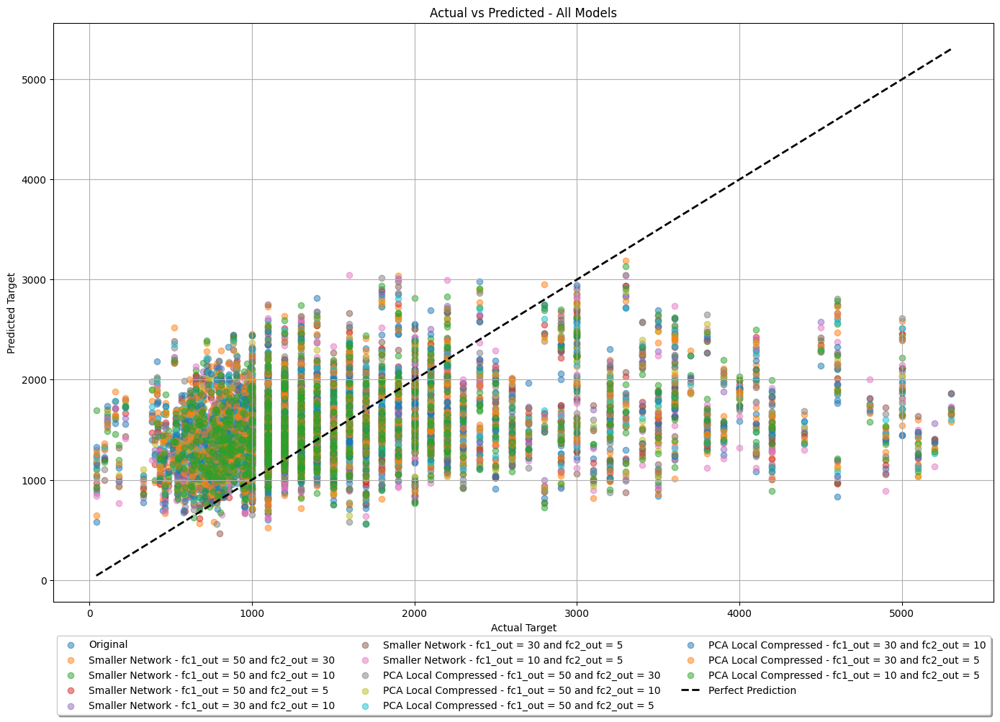

In [ ]:
# listing models that have 0.6 pruning amount
PCA_sparse1_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse1_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse1_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_sparse1_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_sparse1_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_sparse1_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_sparse1_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_sparse1_105,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in PCA_sparse1_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

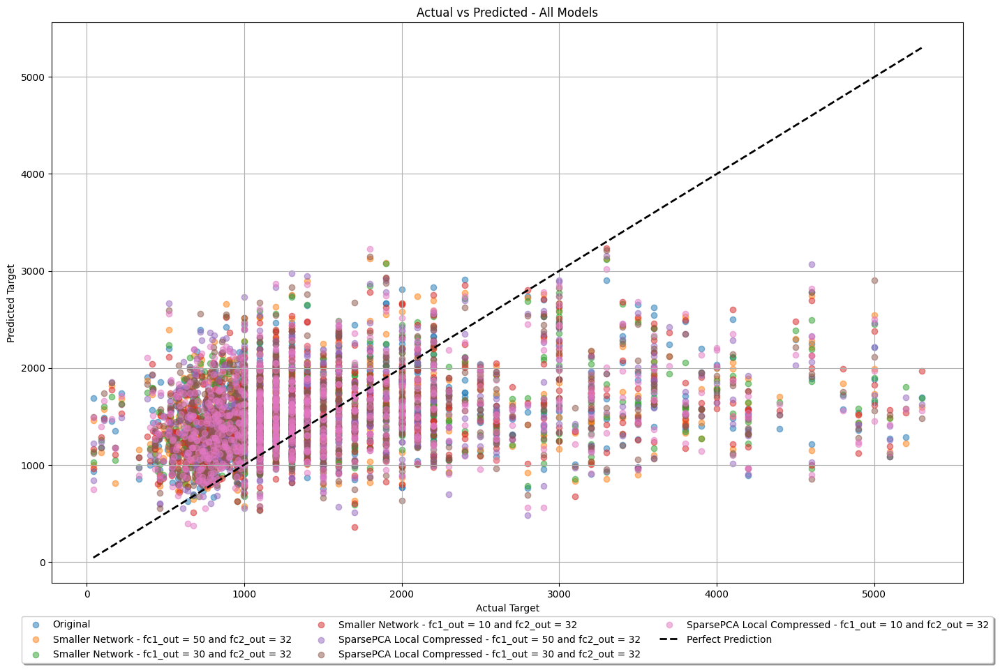

In [ ]:
# listing models that have 0.6 pruning amount
SparsePCA_sparse1_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_sparse1_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_sparse1_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_sparse1_10,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in SparsePCA_sparse1_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

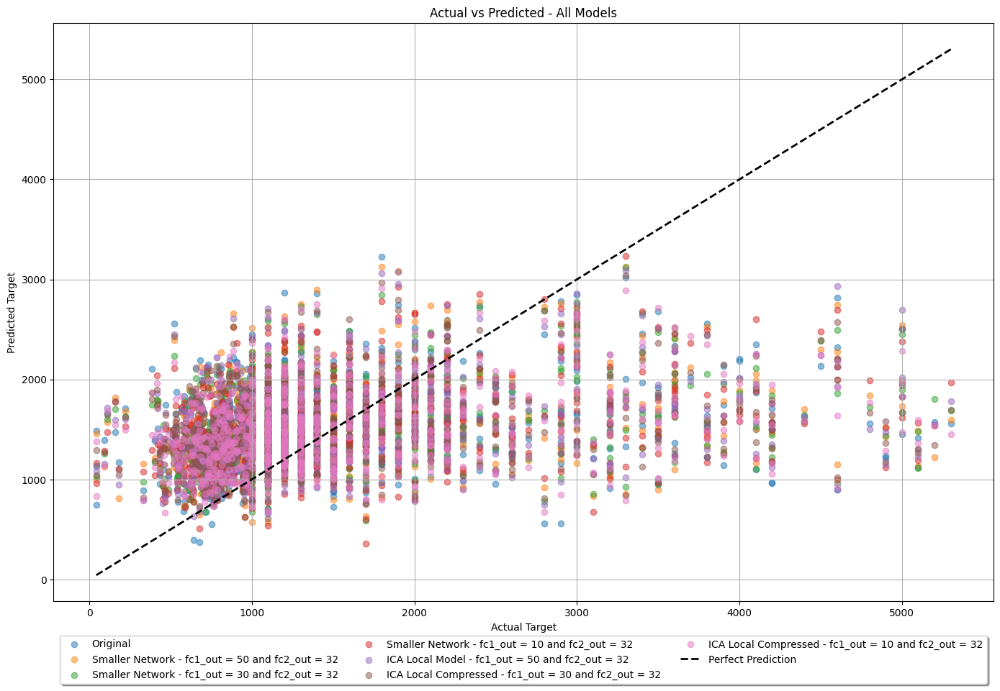

In [ ]:
# listing models that have 0.6 pruning amount
ICA_sparse1_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_sparse1_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_sparse1_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_sparse1_10,

}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in ICA_sparse1_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

##### Pruning Amount = 0.7

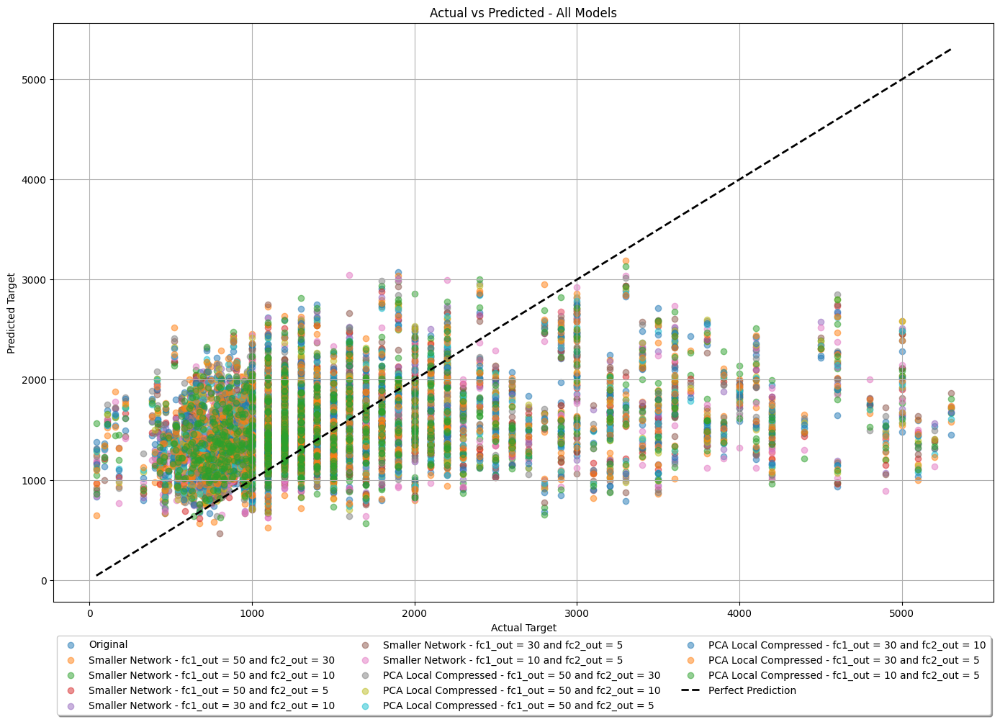

In [ ]:
# listing local models that have 0.7 pruning amount
PCA_sparse2_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse2_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse2_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_sparse2_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_sparse2_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_sparse2_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_sparse2_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_sparse2_105,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in PCA_sparse2_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

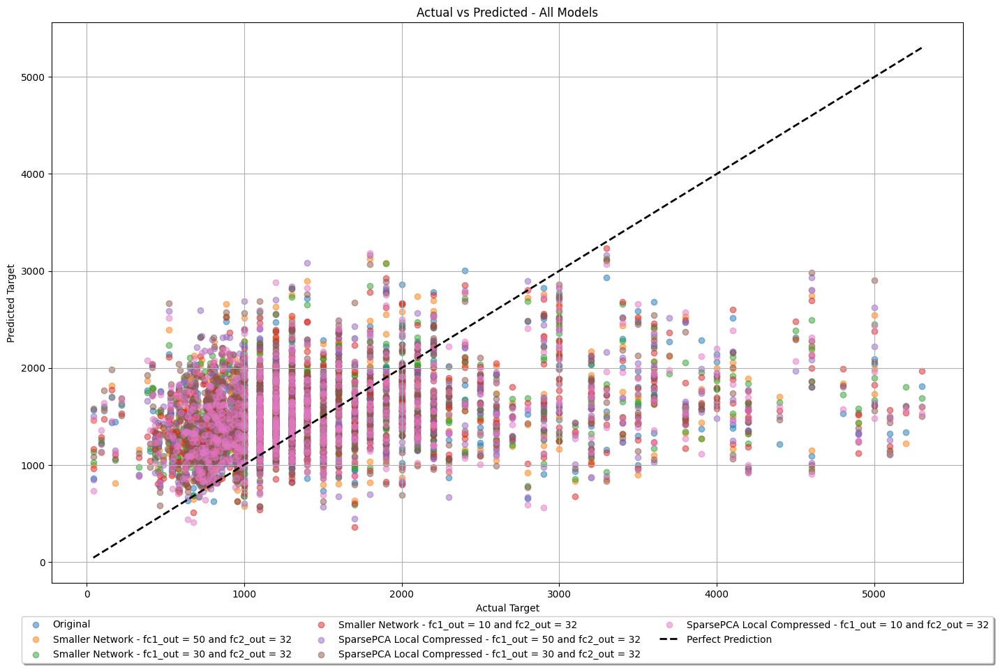

In [ ]:
# listing local models that have 0.7 pruning amount
SparsePCA_sparse2_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_sparse2_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_sparse2_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_sparse2_10,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in SparsePCA_sparse2_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

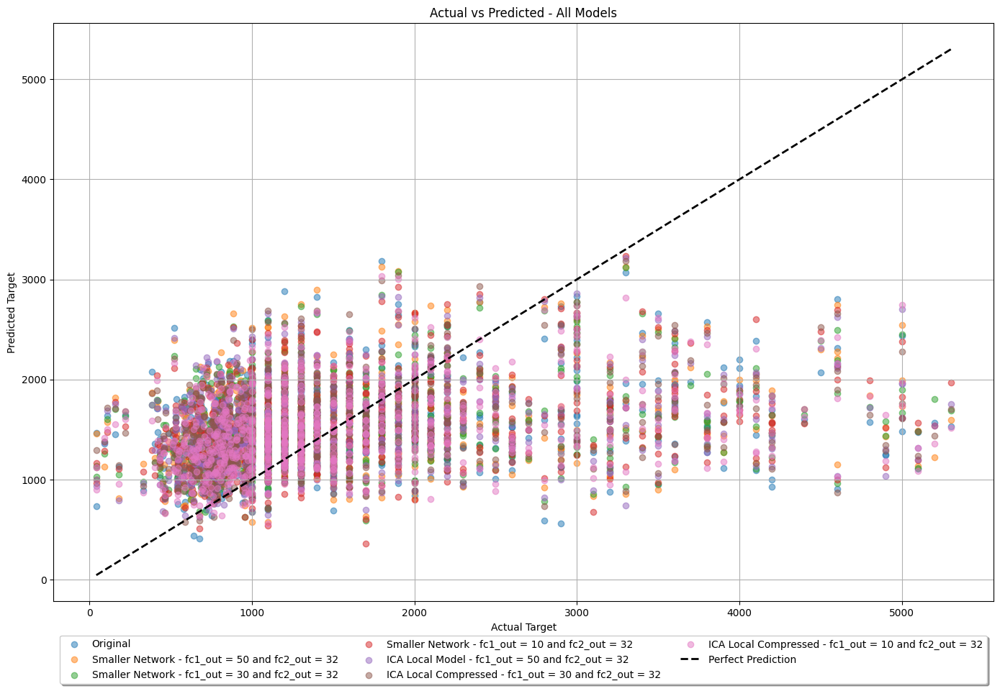

In [ ]:
# listing local models that have 0.7 pruning amount
ICA_sparse2_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_sparse2_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_sparse2_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_sparse2_10,

}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in ICA_sparse2_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

##### Pruning Amount = 0.8

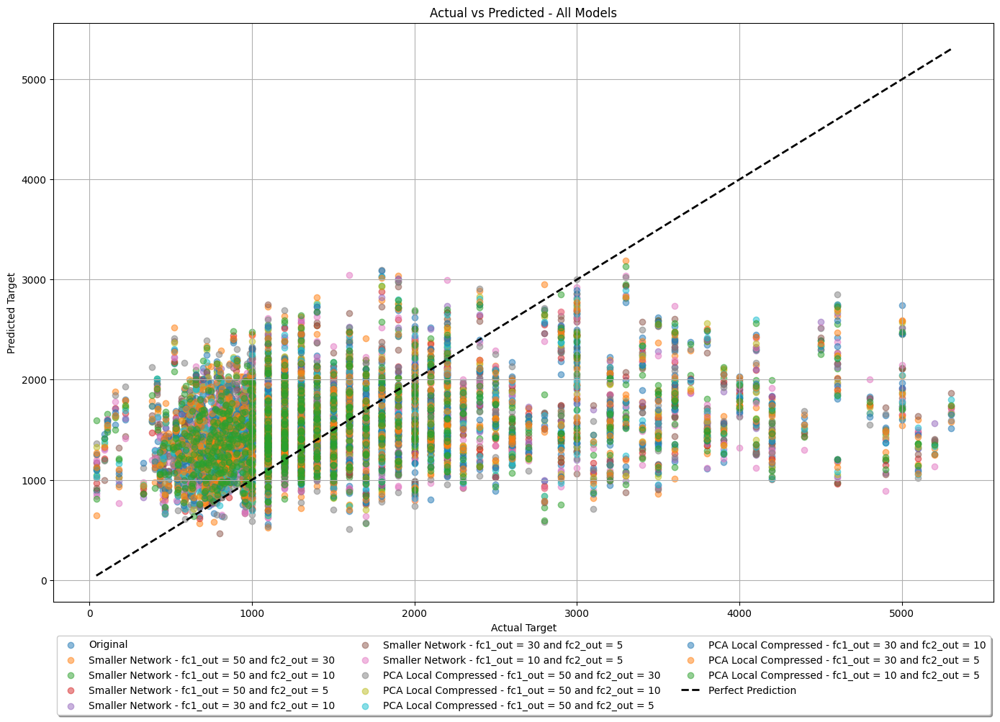

In [ ]:
# listing local models that have 0.8 pruning amount
PCA_sparse3_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse3_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse3_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_sparse3_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_sparse3_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_sparse3_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_sparse3_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_sparse3_105,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in PCA_sparse3_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

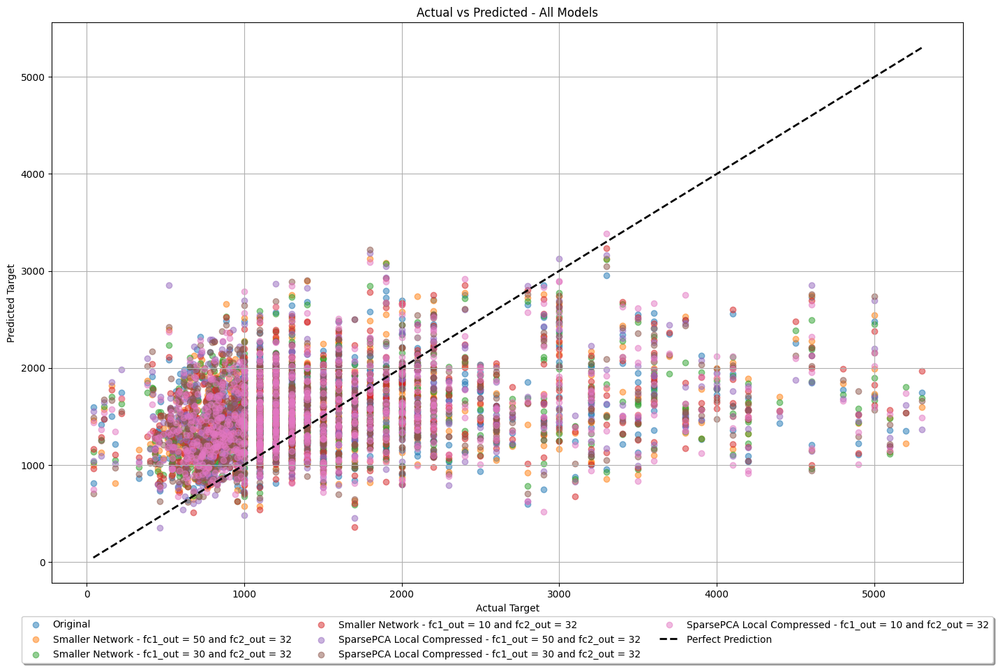

In [ ]:
# listing local models that have 0.8 pruning amount
SparsePCA_sparse3_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_sparse3_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_sparse3_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_sparse3_10,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in SparsePCA_sparse3_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

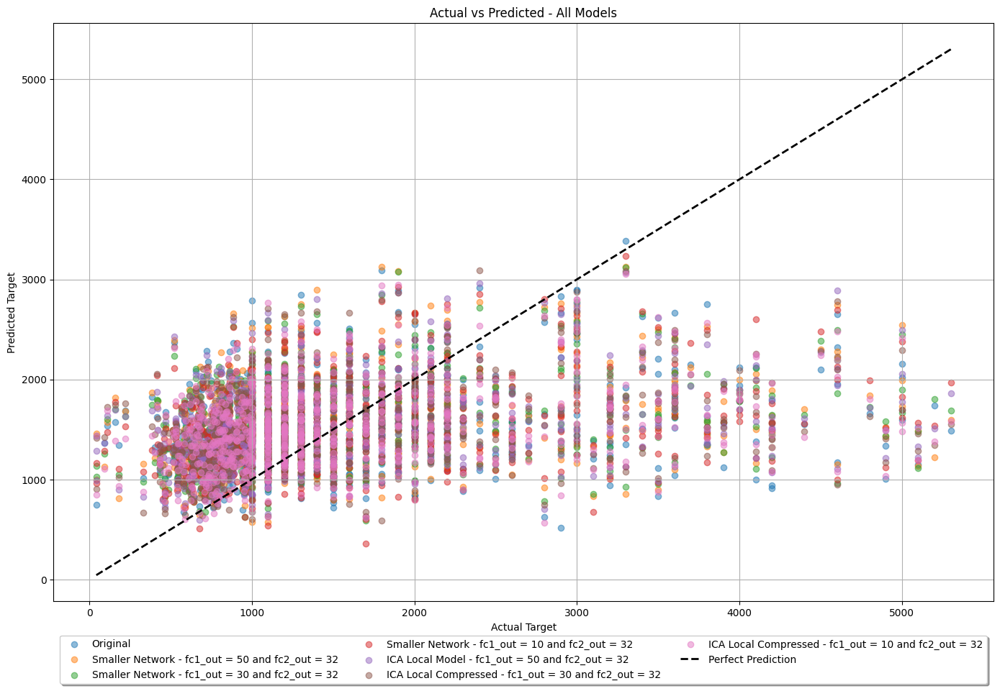

In [ ]:
# listing local models that have 0.8 pruning amount
ICA_sparse3_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_sparse3_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_sparse3_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_sparse3_10,

}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in ICA_sparse3_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

##### Pruning Amount = 0.9

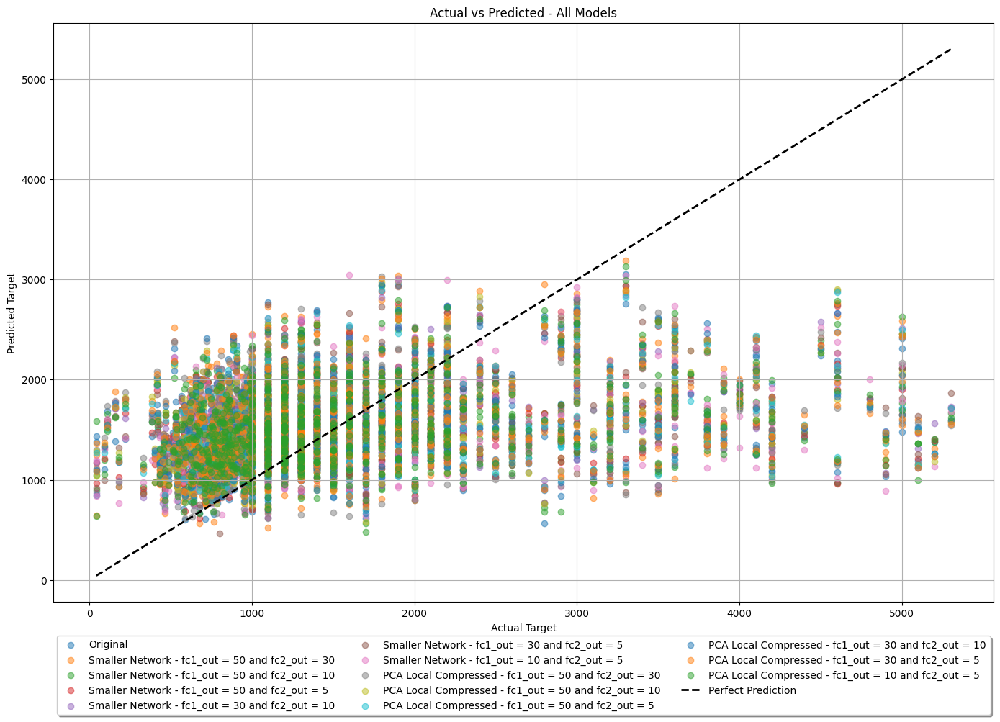

In [ ]:
# listing local models that have 0.9 pruning amount
PCA_sparse4_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse4_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse4_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_sparse4_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_sparse4_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_sparse4_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_sparse4_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_sparse4_105,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in PCA_sparse4_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

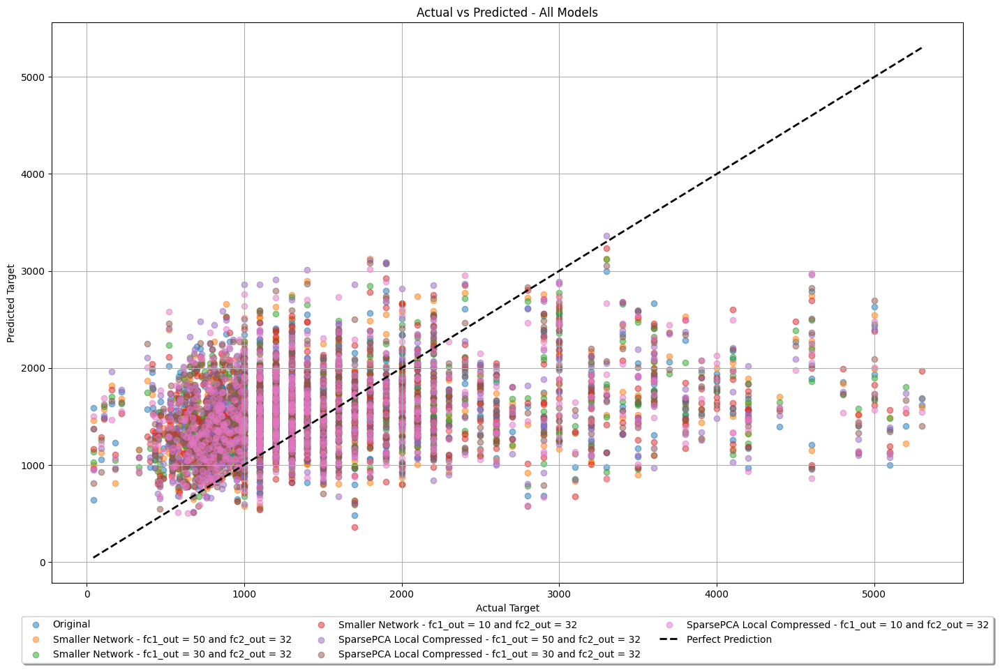

In [ ]:
# listing local models that have 0.9 pruning amount
SparsePCA_sparse4_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_sparse4_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_sparse4_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_sparse4_10,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in SparsePCA_sparse4_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

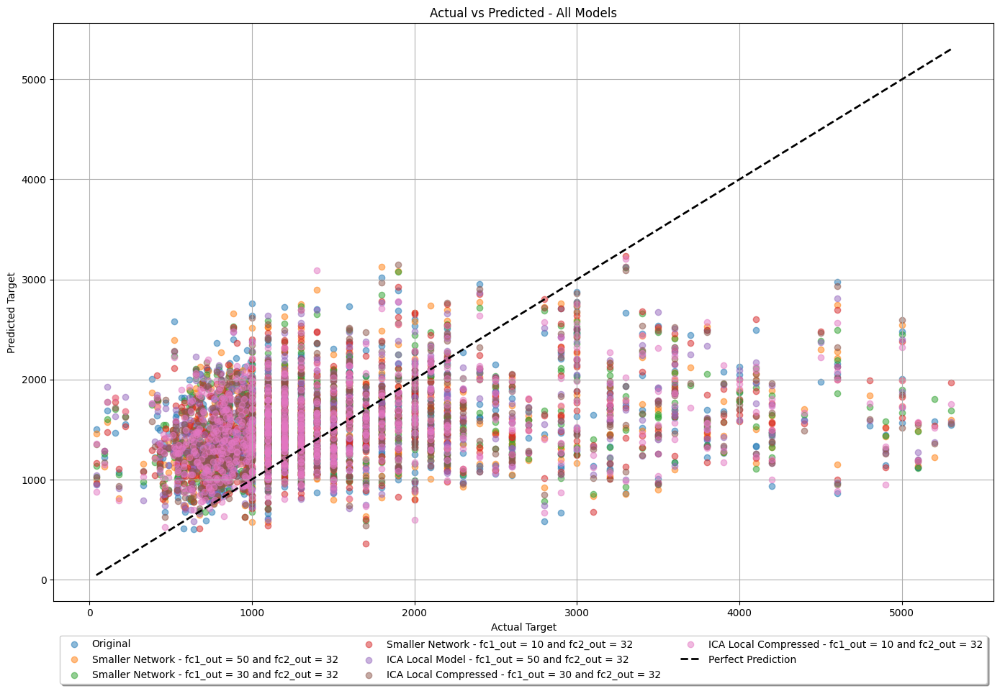

In [ ]:
# listing local models that have 0.9 pruning amount
ICA_sparse4_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_sparse4_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_sparse4_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_sparse4_10,

}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in ICA_sparse4_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

##### Pruning Amount = 0.95

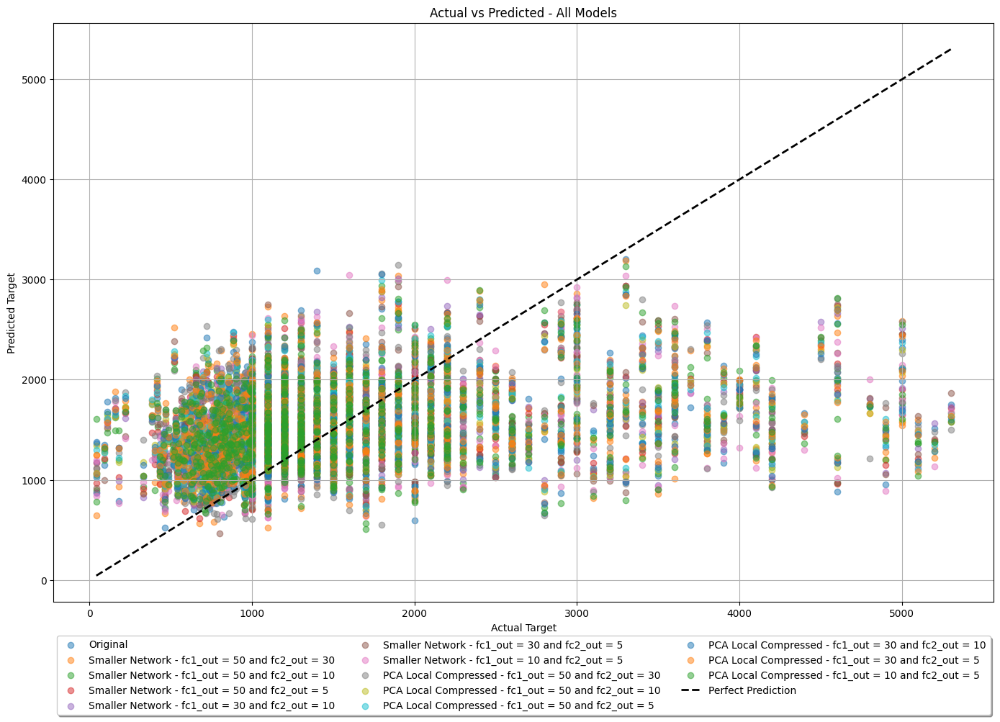

In [ ]:
# listing local models that have 0.95 pruning amount
PCA_sparse5_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 30": small_5030,
    "Smaller Network - fc1_out = 50 and fc2_out = 10": small_5010,
    "Smaller Network - fc1_out = 50 and fc2_out = 5": small_505,
    "Smaller Network - fc1_out = 30 and fc2_out = 10": small_3010,
    "Smaller Network - fc1_out = 30 and fc2_out = 5": small_305,
    "Smaller Network - fc1_out = 10 and fc2_out = 5": small_105,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse5_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 30": PCA_sparse5_5030,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 10": PCA_sparse5_5010,
    "PCA Local Compressed - fc1_out = 50 and fc2_out = 5": PCA_sparse5_505,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 10": PCA_sparse5_3010,
    "PCA Local Compressed - fc1_out = 30 and fc2_out = 5": PCA_sparse5_305,
    "PCA Local Compressed - fc1_out = 10 and fc2_out = 5": PCA_sparse5_105,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in PCA_sparse5_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

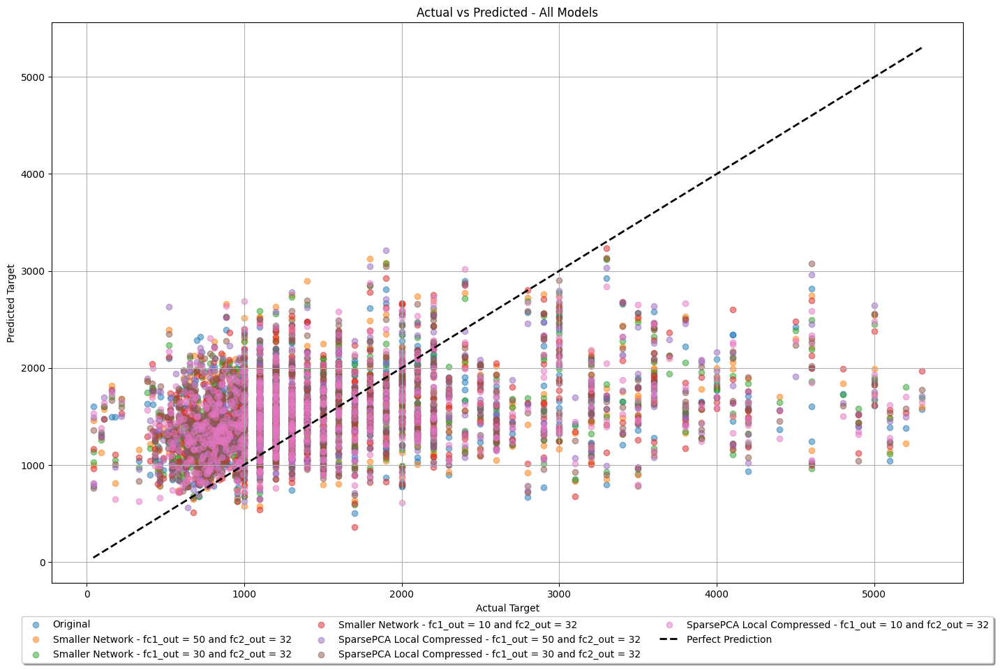

In [ ]:
# listing local models that have 0.95 pruning amount
SparsePCA_l5_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "SparsePCA Local Compressed - fc1_out = 50 and fc2_out = 32": SparsePCA_l5_50,
    "SparsePCA Local Compressed - fc1_out = 30 and fc2_out = 32": SparsePCA_l5_30,
    "SparsePCA Local Compressed - fc1_out = 10 and fc2_out = 32": SparsePCA_l5_10,
}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in SparsePCA_l5_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()

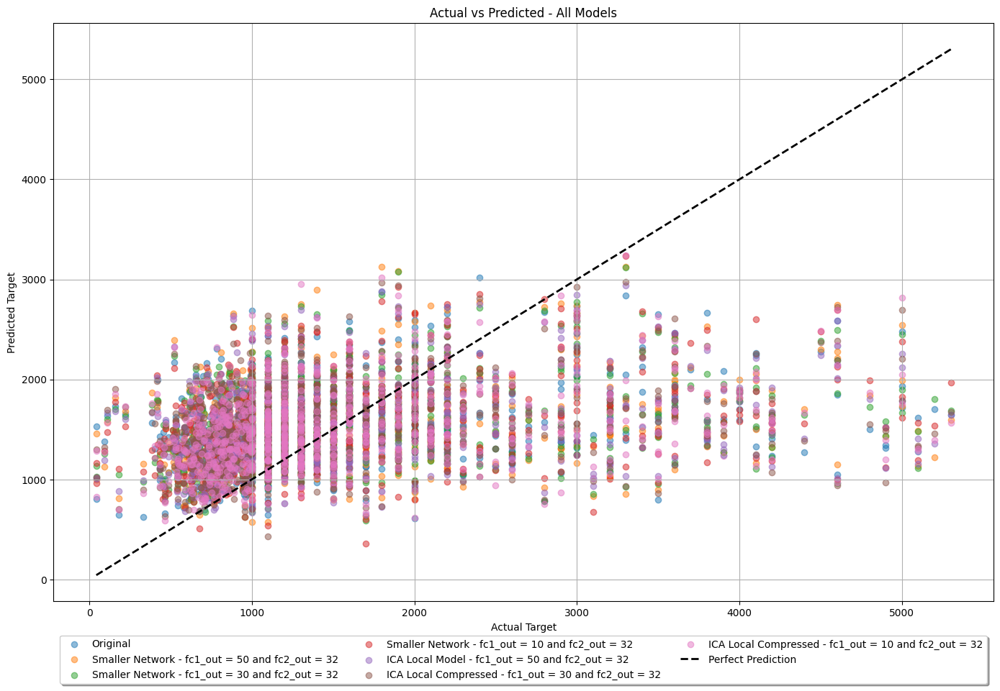

In [ ]:
# listing local models that have 0.95 pruning amount
ICA_sparse5_models = {
    "Original": model,
    "Smaller Network - fc1_out = 50 and fc2_out = 32": small_5032,
    "Smaller Network - fc1_out = 30 and fc2_out = 32": small_3032,
    "Smaller Network - fc1_out = 10 and fc2_out = 32": small_1032,
    "ICA Local Model - fc1_out = 50 and fc2_out = 32": ICA_sparse5_50,
    "ICA Local Compressed - fc1_out = 30 and fc2_out = 32": ICA_sparse5_30,
    "ICA Local Compressed - fc1_out = 10 and fc2_out = 32": ICA_sparse5_10,

}

plt.figure(figsize=(14, 10))

#plot predictions
min_val, max_val = float('inf'), -float('inf')

for model_name, model in ICA_sparse5_models.items():
    actuals = []
    predictions = []

    model.eval()

    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)

            # Store actual and predicted values for plotting
            actuals.extend(targets.cpu().numpy())
            predictions.extend(outputs.cpu().numpy())

    # Update min and max values for the perfect prediction line
    max_val = max(max_val, max(actuals), max(predictions))
    min_val = min(min_val, min(actuals), min(predictions))

    # Plot actuals vs predictions for this model
    plt.scatter(actuals, predictions, alpha=0.5, label=model_name)

# perfect prediction line
plt.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2,
         label='Perfect Prediction')

plt.title('Actual vs Predicted - All Models')
plt.xlabel('Actual Target')
plt.ylabel('Predicted Target')
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True,
           shadow=True, ncol=3)
plt.grid(True)
plt.show()